In [44]:
import pyarrow.parquet as pq
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression

In [45]:
# read files
df = pq.read_table('nanda_2years.parquet').to_pandas()

# remove the rows with NaN value in each column
df = df.dropna()
df

,ordersn,model_type_name,customer_id,is_success,start_city_name,end_city_name,start_city_id,end_city_id,order_time,plan_in_load_time
0,720223955082038,zc,270552,0,武汉,衡阳,180,201,2022-02-23 20:51:32,2022-02-24 06:00:00
1,521025558741115,zc,365879,0,临沂,北京,292,52,2022-10-25 09:18:36,2022-10-25 18:00:00
2,120905095710344,zc,357523,0,石家庄,天津,138,343,2022-09-05 15:47:42,2022-09-05 23:00:00
3,320813059219764,zc,281890,0,金华,武汉,386,180,2022-08-13 07:57:55,2022-08-13 20:00:00
4,1020629520297035,zc,124112,0,湖州,泉州,384,58,2022-06-29 08:02:17,2022-06-29 12:00:00
...,...,...,...,...,...,...,...,...,...,...
1056543,731114521750133,ka,2537,1,赣州,重庆,235,394,2023-11-14 08:51:39,2023-11-14 20:30:00
1056544,431118053172278,ka,2537,1,东莞,南宁,79,97,2023-11-18 19:41:01,2023-11-18 23:30:00
1056545,131118092905761,ka,2537,0,天津,西安,343,311,2023-11-18 21:54:07,2023-11-18 23:00:41
1056546,131118552589338,ka,2537,1,北京,成都,52,322,2023-11-18 07:29:26,2023-11-18 14:00:00


In [46]:
# convert the data of the column 'plan_in_load_time' in pd.datetime format
df['plan_in_load_time'] = pd.to_datetime(df['plan_in_load_time'])
df['plan_in_load_time'] = df['plan_in_load_time'].apply(lambda x: x.date())
df['plan_in_load_time'] = pd.to_datetime(df['plan_in_load_time'])
df

,ordersn,model_type_name,customer_id,is_success,start_city_name,end_city_name,start_city_id,end_city_id,order_time,plan_in_load_time
0,720223955082038,zc,270552,0,武汉,衡阳,180,201,2022-02-23 20:51:32,2022-02-24
1,521025558741115,zc,365879,0,临沂,北京,292,52,2022-10-25 09:18:36,2022-10-25
2,120905095710344,zc,357523,0,石家庄,天津,138,343,2022-09-05 15:47:42,2022-09-05
3,320813059219764,zc,281890,0,金华,武汉,386,180,2022-08-13 07:57:55,2022-08-13
4,1020629520297035,zc,124112,0,湖州,泉州,384,58,2022-06-29 08:02:17,2022-06-29
...,...,...,...,...,...,...,...,...,...,...
1056543,731114521750133,ka,2537,1,赣州,重庆,235,394,2023-11-14 08:51:39,2023-11-14
1056544,431118053172278,ka,2537,1,东莞,南宁,79,97,2023-11-18 19:41:01,2023-11-18
1056545,131118092905761,ka,2537,0,天津,西安,343,311,2023-11-18 21:54:07,2023-11-18
1056546,131118552589338,ka,2537,1,北京,成都,52,322,2023-11-18 07:29:26,2023-11-18


In [47]:
# generate a new dataframe which is groupby df by the columns 'start_city_id'
df_gp = df.groupby(['start_city_id'])
df_gp

14926.399999999998

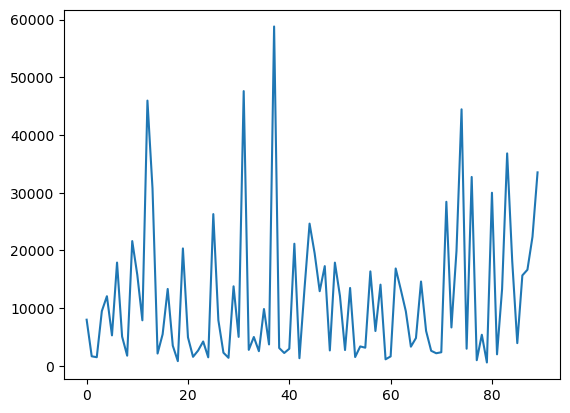

In [48]:
# CASE STUDY
# transfer the groupby object to a list of small dataframes
df_gp_list = [group for _, group in df_gp]

# plot the distribution of the length of df_gp_list
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

plt.plot([len(i) for i in df_gp_list])

# get 0.7-quartile of the length of df_gp_list
np.quantile([len(i) for i in df_gp_list], 0.7)

In [49]:
# transfer the groupby object to a list of small dataframes
df_gp_list = []
df_gp_dict = dict()


for _, group in df_gp:
    
    start_city_id = group['start_city_id'].values[0]
    print(group['start_city_id'].values[0])
    
    # rename the column 'plan_in_load_time' of group to 'y'
    group = group.rename(columns={'plan_in_load_time': 'y'})
    
    # NEW DATAFRAME
    # get the column 'y' and 'is_success' of group
    group['is_success'] = 1
    group = group[['y', 'is_success']]
    
    # group by 'y'
    group = group.groupby('y').sum()
    group = group[['is_success']]
    
    # NEW FORMAT
    # rename the column 'is_success' to 'y' and the index to 'ds'
    group = group.rename(columns={'is_success': 'y'})
    group.index.name = 'ds'
    
    # fill the missing days in group using the value 0
    group.index = pd.to_datetime(group.index)
    group = group.resample('D').sum()
    group = group.fillna(0)

    # set a new column 'ds' which is the index of group
    group['ds'] = group.index
    
    group['start_city_id'] = start_city_id
    
    # add group to df_gp_list
    df_gp_list.append(group)
    
    # add group to df_gp_dict
    group['ds'] = pd.to_datetime(group['ds'])
    df_gp_dict[start_city_id] = group
    
    print(group)

df_gp_list

37
             y         ds  start_city_id
ds                                      
2022-01-01   2 2022-01-01             37
2022-01-02   4 2022-01-02             37
2022-01-03   3 2022-01-03             37
2022-01-04   9 2022-01-04             37
2022-01-05   8 2022-01-05             37
...         ..        ...            ...
2023-11-19   3 2023-11-19             37
2023-11-20  11 2023-11-20             37
2023-11-21   8 2023-11-21             37
2023-11-22   8 2023-11-22             37
2023-11-23   2 2023-11-23             37

[692 rows x 3 columns]
40
             y         ds  start_city_id
ds                                      
2022-01-01  20 2022-01-01             40
2022-01-02   5 2022-01-02             40
2022-01-03   0 2022-01-03             40
2022-01-04   2 2022-01-04             40
2022-01-05   1 2022-01-05             40
...         ..        ...            ...
2023-11-17   5 2023-11-17             40
2023-11-18   4 2023-11-18             40
2023-11-19   1 2023-11-19  

             y         ds  start_city_id
ds                                      
2022-01-01   5 2022-01-01            139
2022-01-02   8 2022-01-02            139
2022-01-03   6 2022-01-03            139
2022-01-04  18 2022-01-04            139
2022-01-05  16 2022-01-05            139
...         ..        ...            ...
2023-11-18   3 2023-11-18            139
2023-11-19   1 2023-11-19            139
2023-11-20   2 2023-11-20            139
2023-11-21   3 2023-11-21            139
2023-11-22   3 2023-11-22            139

[691 rows x 3 columns]
140
             y         ds  start_city_id
ds                                      
2022-01-03   2 2022-01-03            140
2022-01-04   4 2022-01-04            140
2022-01-05   2 2022-01-05            140
2022-01-06  12 2022-01-06            140
2022-01-07   9 2022-01-07            140
...         ..        ...            ...
2023-11-18   3 2023-11-18            140
2023-11-19   1 2023-11-19            140
2023-11-20   2 2023-11-20    

             y         ds  start_city_id
ds                                      
2022-01-01   8 2022-01-01            229
2022-01-02  12 2022-01-02            229
2022-01-03   6 2022-01-03            229
2022-01-04  17 2022-01-04            229
2022-01-05  30 2022-01-05            229
...         ..        ...            ...
2023-11-19  11 2023-11-19            229
2023-11-20  10 2023-11-20            229
2023-11-21   4 2023-11-21            229
2023-11-22  15 2023-11-22            229
2023-11-23   2 2023-11-23            229

[692 rows x 3 columns]
230
            y         ds  start_city_id
ds                                     
2022-01-01  1 2022-01-01            230
2022-01-02  1 2022-01-02            230
2022-01-03  0 2022-01-03            230
2022-01-04  2 2022-01-04            230
2022-01-05  4 2022-01-05            230
...        ..        ...            ...
2023-11-19  2 2023-11-19            230
2023-11-20  2 2023-11-20            230
2023-11-21  1 2023-11-21            230

             y         ds  start_city_id
ds                                      
2022-01-01   8 2022-01-01            383
2022-01-02  14 2022-01-02            383
2022-01-03  19 2022-01-03            383
2022-01-04  77 2022-01-04            383
2022-01-05  81 2022-01-05            383
...         ..        ...            ...
2023-11-19  19 2023-11-19            383
2023-11-20  26 2023-11-20            383
2023-11-21  20 2023-11-21            383
2023-11-22  24 2023-11-22            383
2023-11-23   4 2023-11-23            383

[692 rows x 3 columns]
384
            y         ds  start_city_id
ds                                     
2022-01-04  1 2022-01-04            384
2022-01-05  7 2022-01-05            384
2022-01-06  2 2022-01-06            384
2022-01-07  3 2022-01-07            384
2022-01-08  1 2022-01-08            384
...        ..        ...            ...
2023-11-19  4 2023-11-19            384
2023-11-20  0 2023-11-20            384
2023-11-21  6 2023-11-21            384

[             y         ds  start_city_id
 ds                                      
 2022-01-01   2 2022-01-01             37
 2022-01-02   4 2022-01-02             37
 2022-01-03   3 2022-01-03             37
 2022-01-04   9 2022-01-04             37
 2022-01-05   8 2022-01-05             37
 ...         ..        ...            ...
 2023-11-19   3 2023-11-19             37
 2023-11-20  11 2023-11-20             37
 2023-11-21   8 2023-11-21             37
 2023-11-22   8 2023-11-22             37
 2023-11-23   2 2023-11-23             37
 
 [692 rows x 3 columns],
              y         ds  start_city_id
 ds                                      
 2022-01-01  20 2022-01-01             40
 2022-01-02   5 2022-01-02             40
 2022-01-03   0 2022-01-03             40
 2022-01-04   2 2022-01-04             40
 2022-01-05   1 2022-01-05             40
 ...         ..        ...            ...
 2023-11-17   5 2023-11-17             40
 2023-11-18   4 2023-11-18             40
 2023-1

In [50]:
df_gp_dict

{37:              y         ds  start_city_id
 ds                                      
 2022-01-01   2 2022-01-01             37
 2022-01-02   4 2022-01-02             37
 2022-01-03   3 2022-01-03             37
 2022-01-04   9 2022-01-04             37
 2022-01-05   8 2022-01-05             37
 ...         ..        ...            ...
 2023-11-19   3 2023-11-19             37
 2023-11-20  11 2023-11-20             37
 2023-11-21   8 2023-11-21             37
 2023-11-22   8 2023-11-22             37
 2023-11-23   2 2023-11-23             37
 
 [692 rows x 3 columns],
 40:              y         ds  start_city_id
 ds                                      
 2022-01-01  20 2022-01-01             40
 2022-01-02   5 2022-01-02             40
 2022-01-03   0 2022-01-03             40
 2022-01-04   2 2022-01-04             40
 2022-01-05   1 2022-01-05             40
 ...         ..        ...            ...
 2023-11-17   5 2023-11-17             40
 2023-11-18   4 2023-11-18             40

16:59:49 - cmdstanpy - INFO - Chain [1] start processing
16:59:50 - cmdstanpy - INFO - Chain [1] done processing


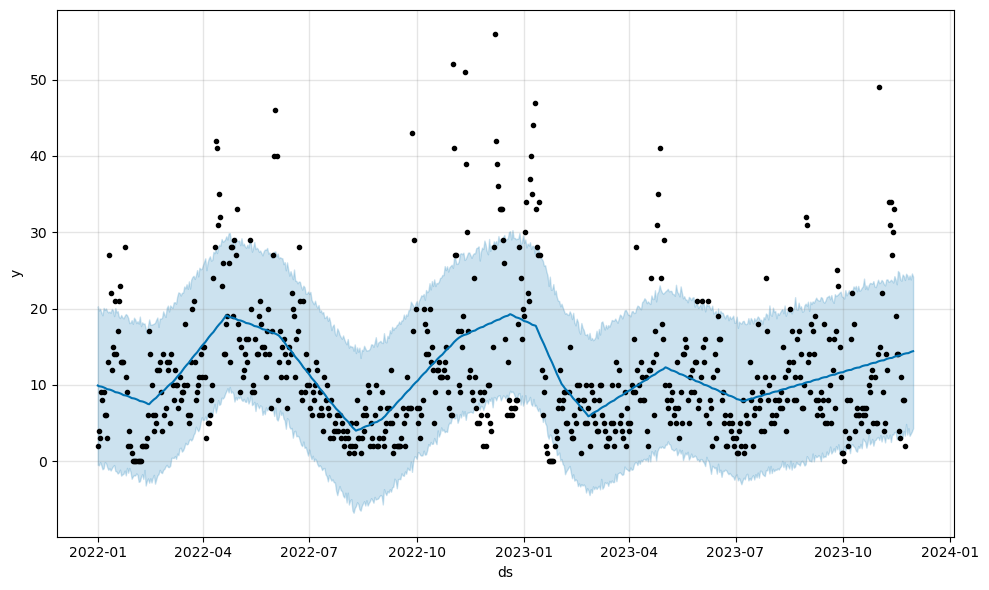

16:59:50 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  14.150372    4.302109   23.849553
695 2023-11-27  14.226438    3.307863   24.331253
696 2023-11-28  14.300626    3.583067   23.805831
697 2023-11-29  14.358918    3.880498   24.597661
698 2023-11-30  14.401449    4.290312   24.177877


16:59:50 - cmdstanpy - INFO - Chain [1] done processing


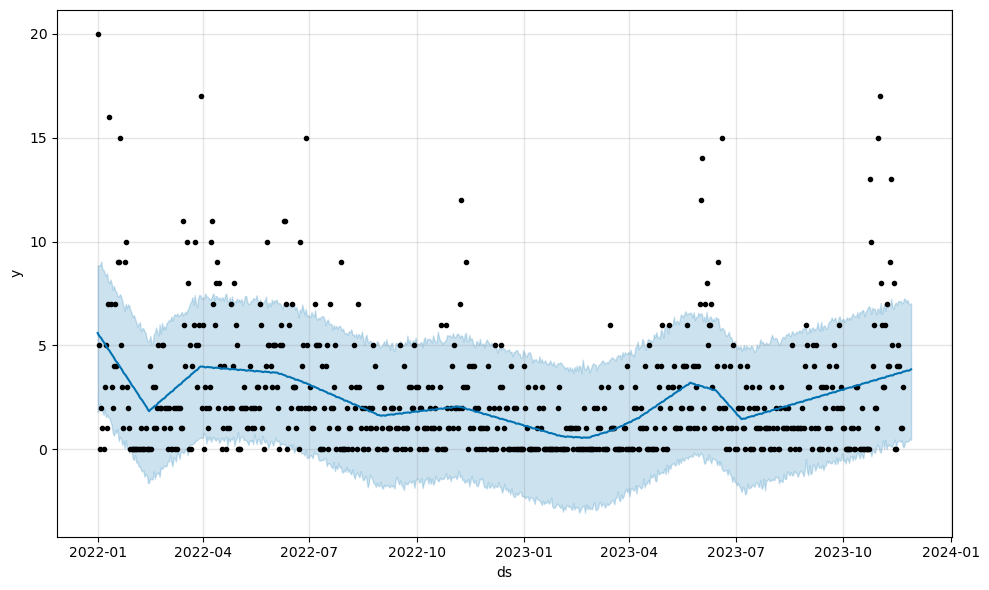

16:59:51 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
692 2023-11-24  3.775101    0.342960    7.077727
693 2023-11-25  3.788013    0.390752    7.179554
694 2023-11-26  3.774938    0.388370    7.003528
695 2023-11-27  3.804867    0.518464    6.978525
696 2023-11-28  3.846158    0.448999    7.023810


16:59:51 - cmdstanpy - INFO - Chain [1] done processing


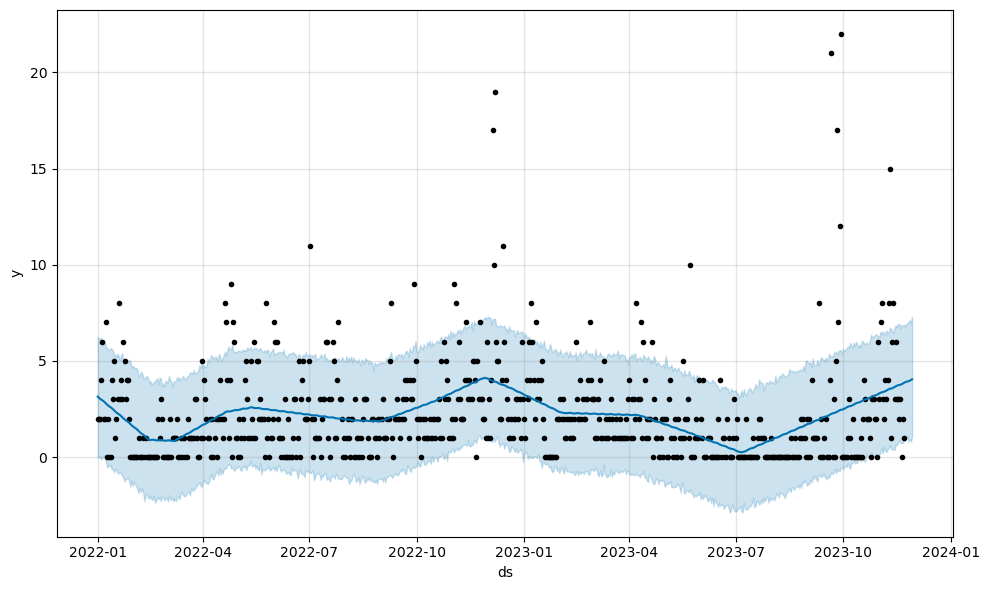

16:59:52 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
693 2023-11-25  3.928839    1.079006    6.949969
694 2023-11-26  3.947646    0.816943    7.037246
695 2023-11-27  3.973104    0.930427    7.122054
696 2023-11-28  4.004342    0.805228    6.984153
697 2023-11-29  4.046258    1.051533    7.301690


16:59:52 - cmdstanpy - INFO - Chain [1] done processing


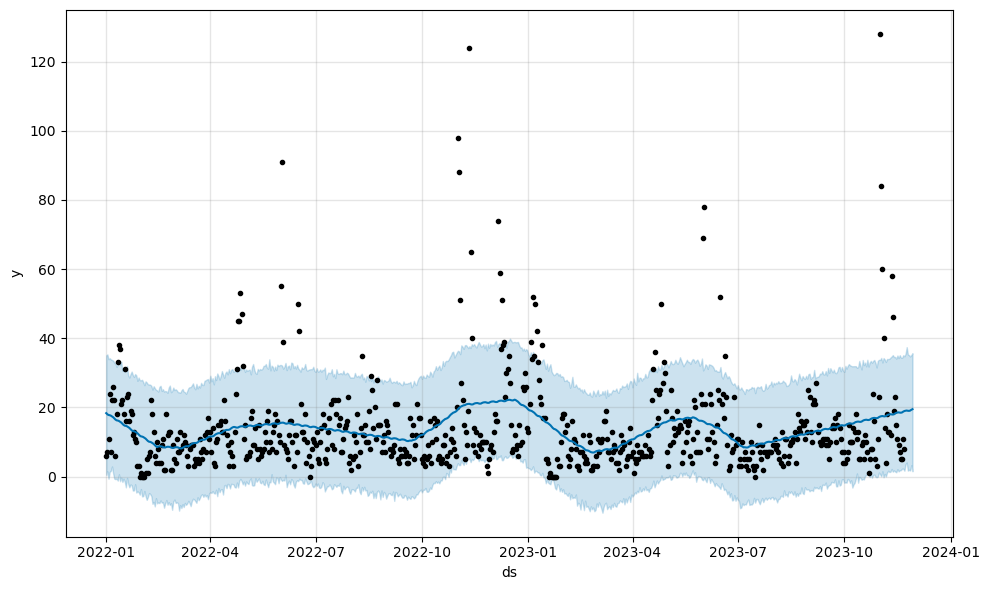

16:59:52 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
693 2023-11-25  19.019600    1.702938   35.302843
694 2023-11-26  18.993025    1.956372   35.110241
695 2023-11-27  19.073804    1.747726   34.733314
696 2023-11-28  19.309589    3.277343   35.173118
697 2023-11-29  19.476196    1.520105   35.683817


16:59:53 - cmdstanpy - INFO - Chain [1] done processing


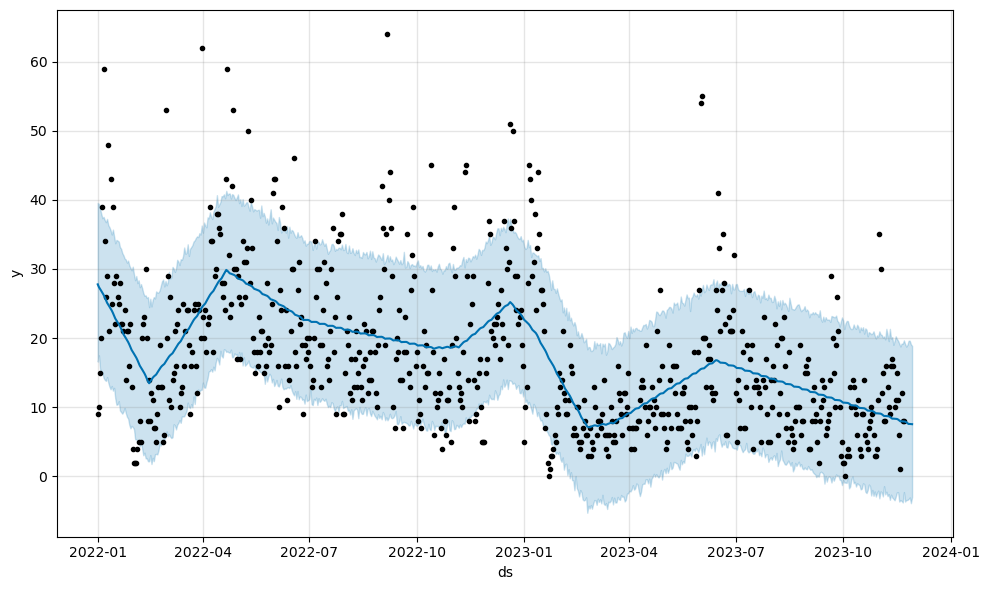

16:59:53 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
693 2023-11-25  7.703962   -3.418927   19.027699
694 2023-11-26  7.578259   -3.265802   19.627230
695 2023-11-27  7.582894   -3.048900   19.620167
696 2023-11-28  7.569058   -3.878115   19.105774
697 2023-11-29  7.550330   -2.991531   18.879546


16:59:54 - cmdstanpy - INFO - Chain [1] done processing


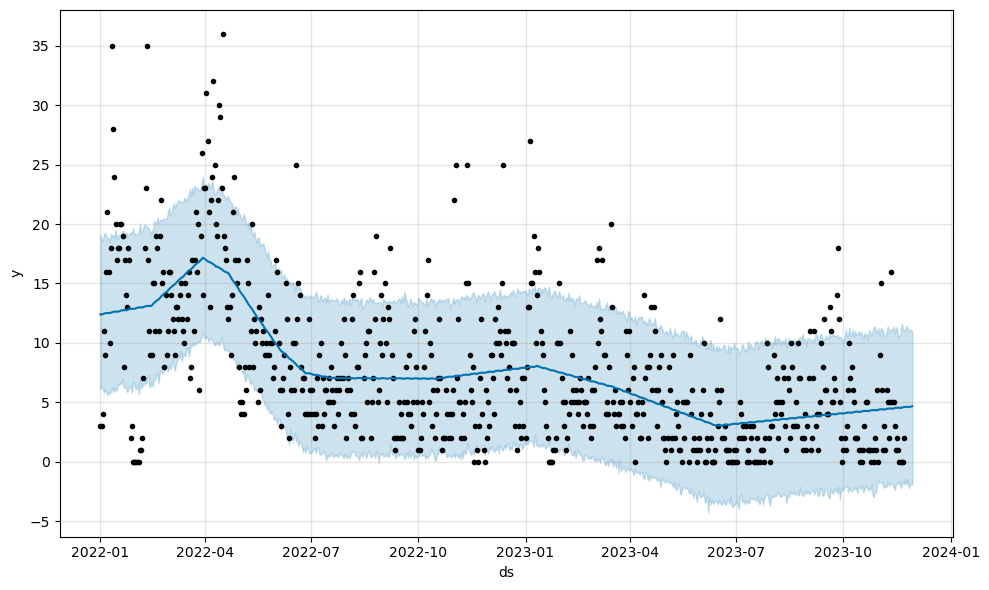

16:59:54 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
693 2023-11-25  4.609976   -1.485315   11.217936
694 2023-11-26  4.580540   -2.230497   11.078132
695 2023-11-27  4.611786   -2.006906   11.042081
696 2023-11-28  4.650493   -1.863598   11.102404
697 2023-11-29  4.669201   -1.918412   10.920780


16:59:54 - cmdstanpy - INFO - Chain [1] done processing


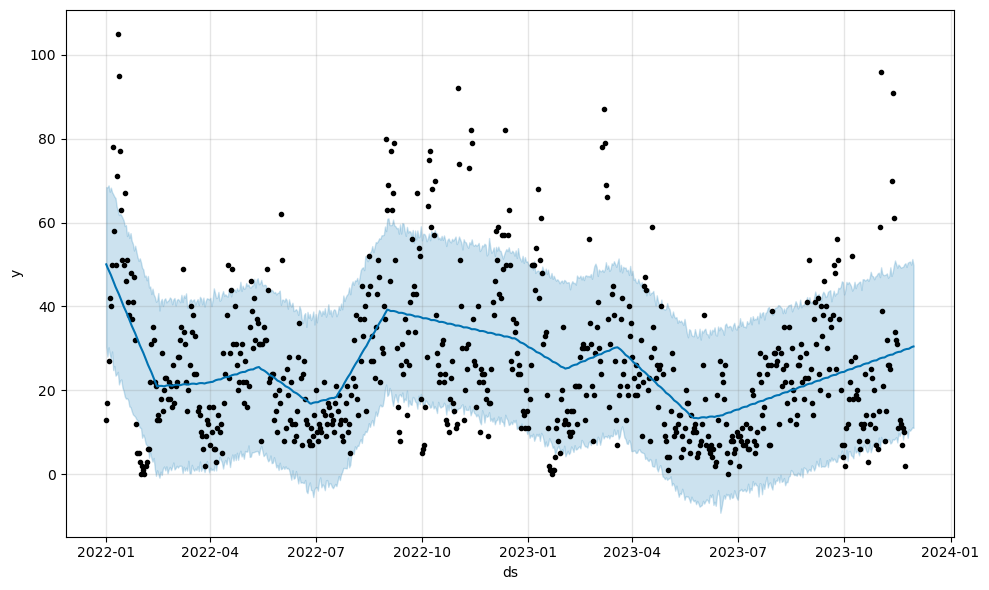

16:59:55 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  29.909133   10.727077   50.610404
695 2023-11-27  30.085543   10.359611   50.710267
696 2023-11-28  30.243384   10.735733   49.978456
697 2023-11-29  30.376616   11.176175   51.317905
698 2023-11-30  30.456827   11.024858   49.850059


16:59:55 - cmdstanpy - INFO - Chain [1] done processing


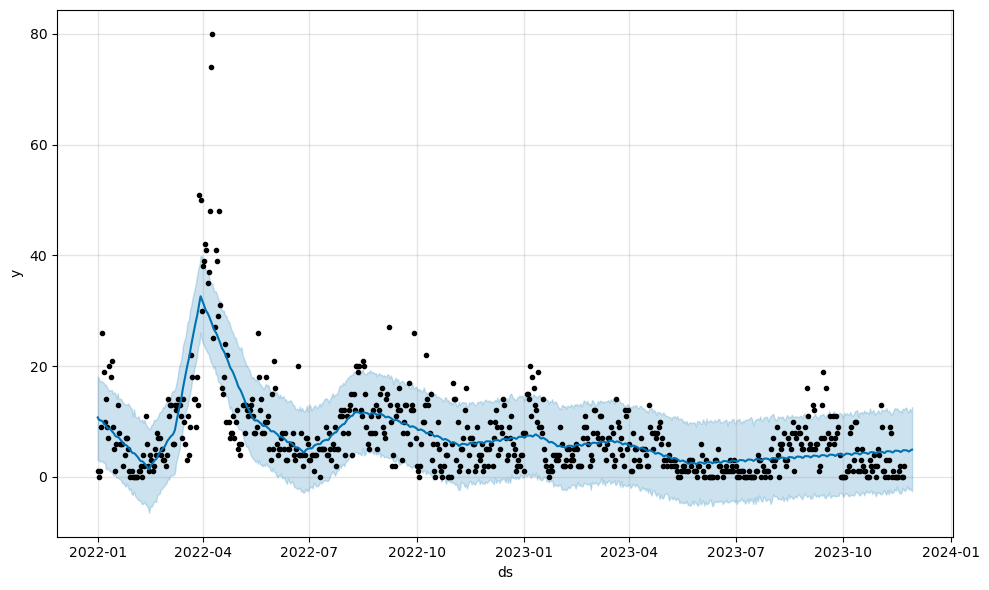

16:59:56 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
693 2023-11-25  4.746650   -1.656424   11.884027
694 2023-11-26  4.586770   -2.329816   11.639631
695 2023-11-27  4.659631   -1.981116   12.296029
696 2023-11-28  4.857622   -2.351204   11.838441
697 2023-11-29  4.927722   -2.572154   12.594371


16:59:56 - cmdstanpy - INFO - Chain [1] done processing


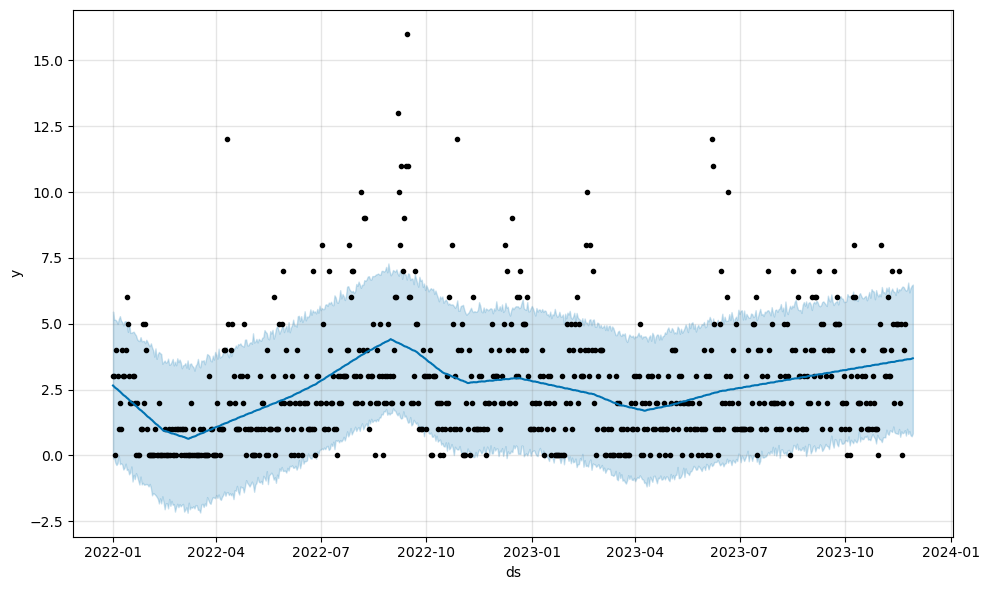

16:59:56 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
693 2023-11-25  3.650365    0.813918    6.562515
694 2023-11-26  3.653286    0.924214    6.189217
695 2023-11-27  3.656002    0.765054    6.351530
696 2023-11-28  3.671570    0.727496    6.442388
697 2023-11-29  3.687135    0.833716    6.486025


16:59:56 - cmdstanpy - INFO - Chain [1] done processing


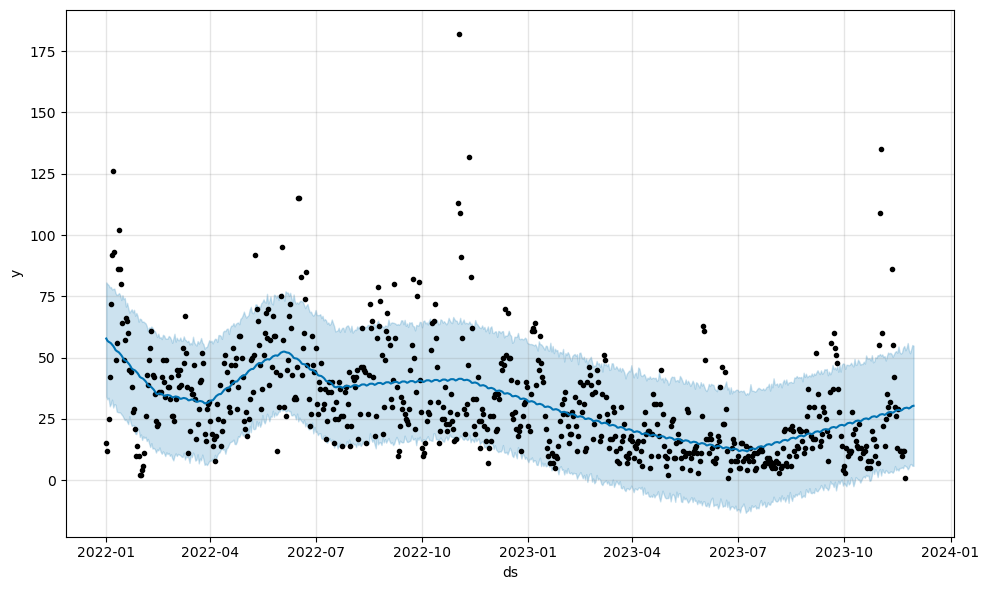

16:59:57 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  29.253437    5.163181   52.943354
695 2023-11-27  29.508120    6.406550   51.792955
696 2023-11-28  29.903426    6.623293   53.410255
697 2023-11-29  30.243214    5.909857   55.135733
698 2023-11-30  30.355086    5.843038   54.841762


16:59:57 - cmdstanpy - INFO - Chain [1] done processing


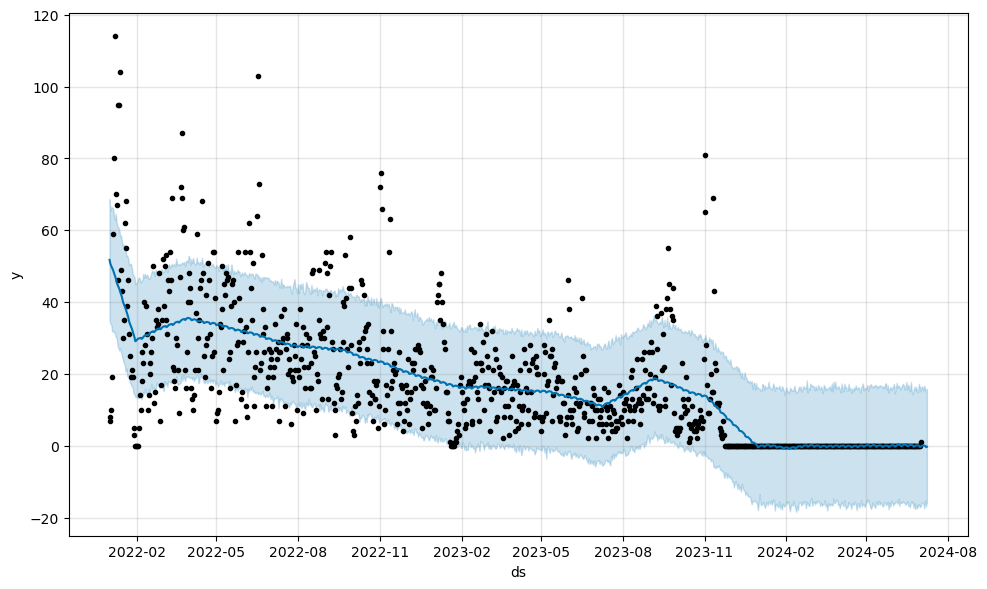

16:59:58 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
915 2024-07-04  0.043641  -16.142774   15.360243
916 2024-07-05  0.010121  -17.461923   16.698651
917 2024-07-06 -0.010695  -15.277189   15.943187
918 2024-07-07 -0.384794  -16.942083   15.106823
919 2024-07-08 -0.310005  -15.623214   15.842956


16:59:58 - cmdstanpy - INFO - Chain [1] done processing


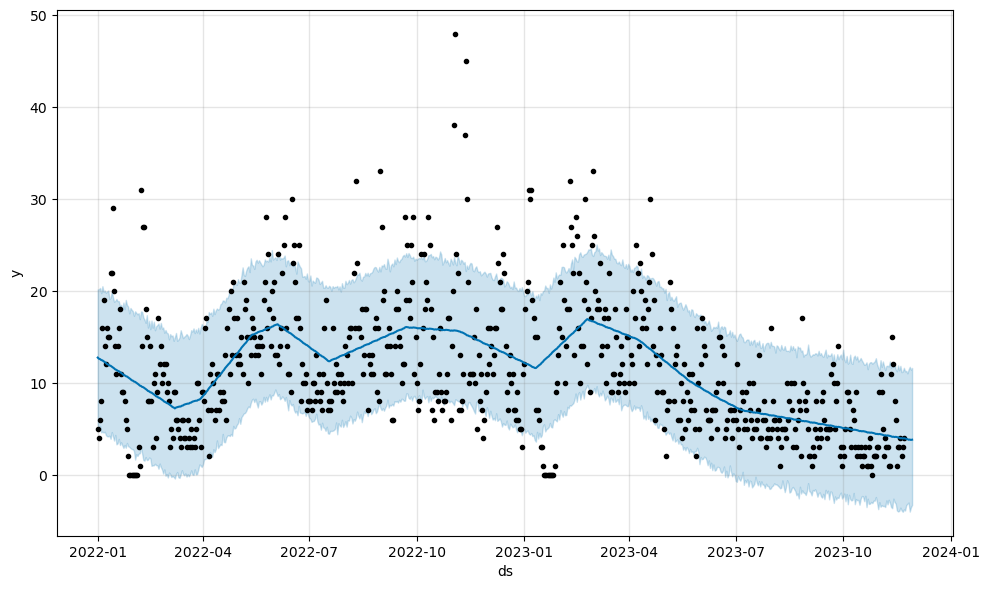

16:59:59 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
693 2023-11-25  3.872546   -3.162280   11.033944
694 2023-11-26  3.810937   -3.029236   11.453039
695 2023-11-27  3.827649   -4.015837   11.743006
696 2023-11-28  3.788783   -3.546212   11.437020
697 2023-11-29  3.813235   -3.290568   11.620723


16:59:59 - cmdstanpy - INFO - Chain [1] done processing


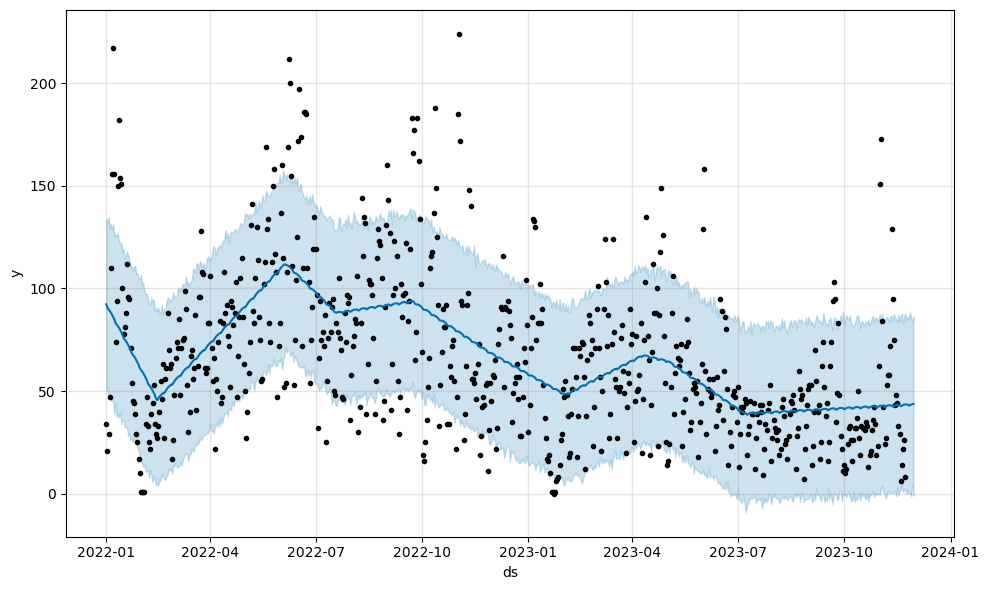

17:00:00 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  42.858148    0.355677   85.403054
695 2023-11-27  43.080574    0.184114   88.367848
696 2023-11-28  43.448043   -1.290869   85.613027
697 2023-11-29  43.683028    4.809125   84.181889
698 2023-11-30  43.753538   -0.912860   86.544822


17:00:00 - cmdstanpy - INFO - Chain [1] done processing


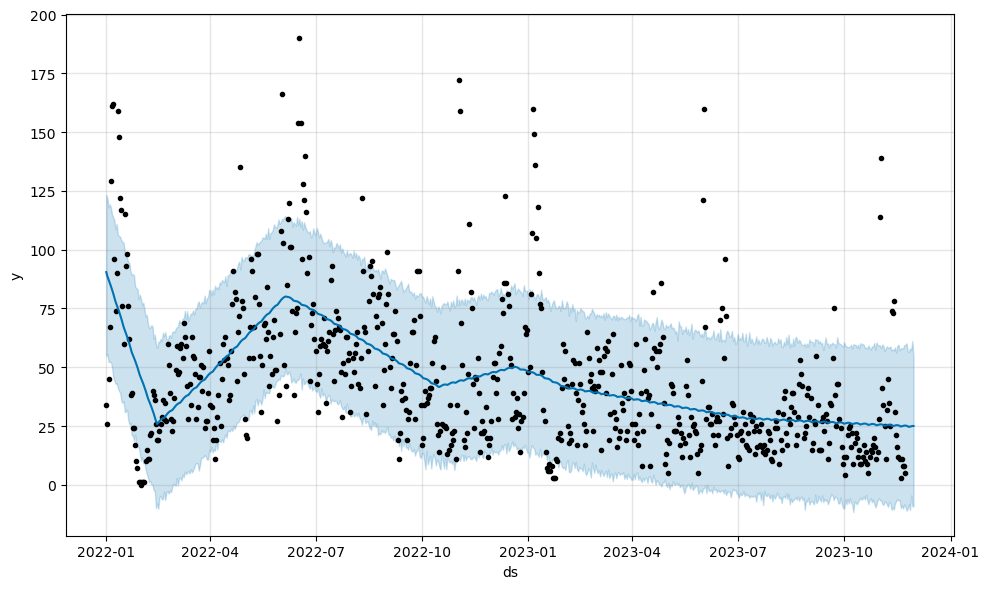

17:00:00 - cmdstanpy - INFO - Chain [1] start processing
17:00:01 - cmdstanpy - INFO - Chain [1] done processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  24.615437   -8.196477   56.446375
695 2023-11-27  24.779390  -10.759419   58.059732
696 2023-11-28  24.871148   -4.537341   57.290324
697 2023-11-29  25.028037   -9.096716   61.190174
698 2023-11-30  25.034976   -9.236120   54.279915


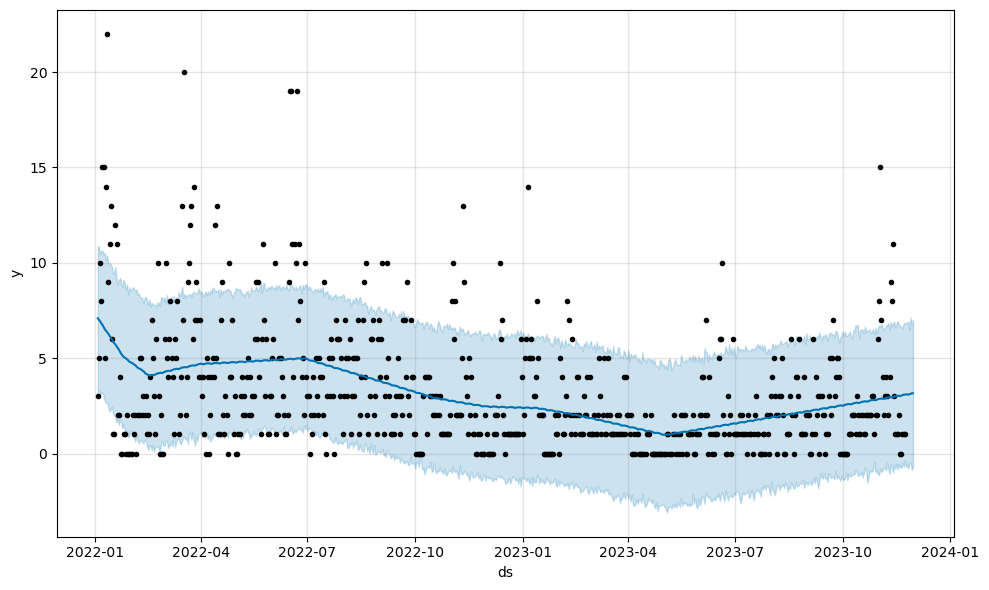

17:00:01 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
692 2023-11-26  3.083144   -0.787111    6.937621
693 2023-11-27  3.109520   -0.469233    6.481044
694 2023-11-28  3.135927   -0.472078    7.132589
695 2023-11-29  3.157600   -0.857220    6.769634
696 2023-11-30  3.158763   -0.707706    6.997390


17:00:01 - cmdstanpy - INFO - Chain [1] done processing


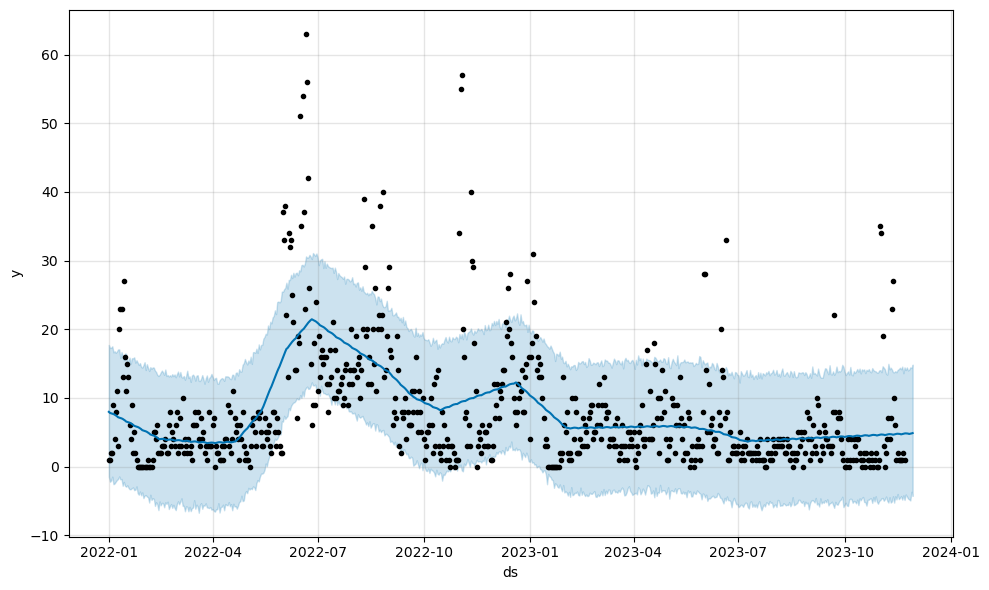

17:00:02 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
693 2023-11-25  4.796467   -4.660193   13.993029
694 2023-11-26  4.740176   -4.786241   14.102081
695 2023-11-27  4.772489   -4.946942   14.442379
696 2023-11-28  4.819910   -3.679836   14.331862
697 2023-11-29  4.865900   -4.275142   14.836461


17:00:02 - cmdstanpy - INFO - Chain [1] done processing


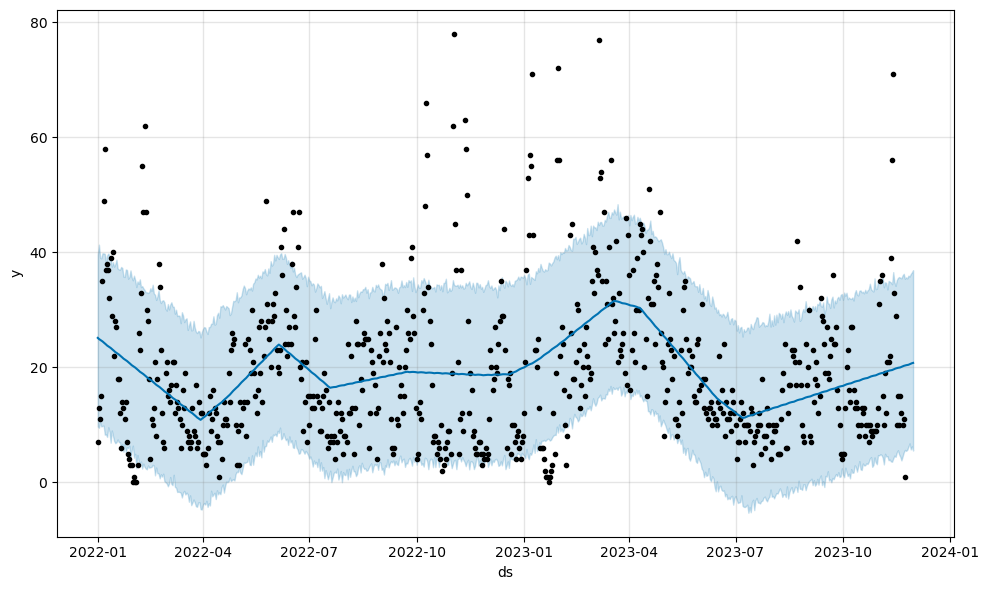

17:00:03 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  20.449532    6.217219   35.954516
695 2023-11-27  20.546403    6.774818   35.804990
696 2023-11-28  20.638293    5.723205   36.241266
697 2023-11-29  20.718955    6.243478   36.533619
698 2023-11-30  20.777492    5.526528   36.903117


17:00:03 - cmdstanpy - INFO - Chain [1] done processing


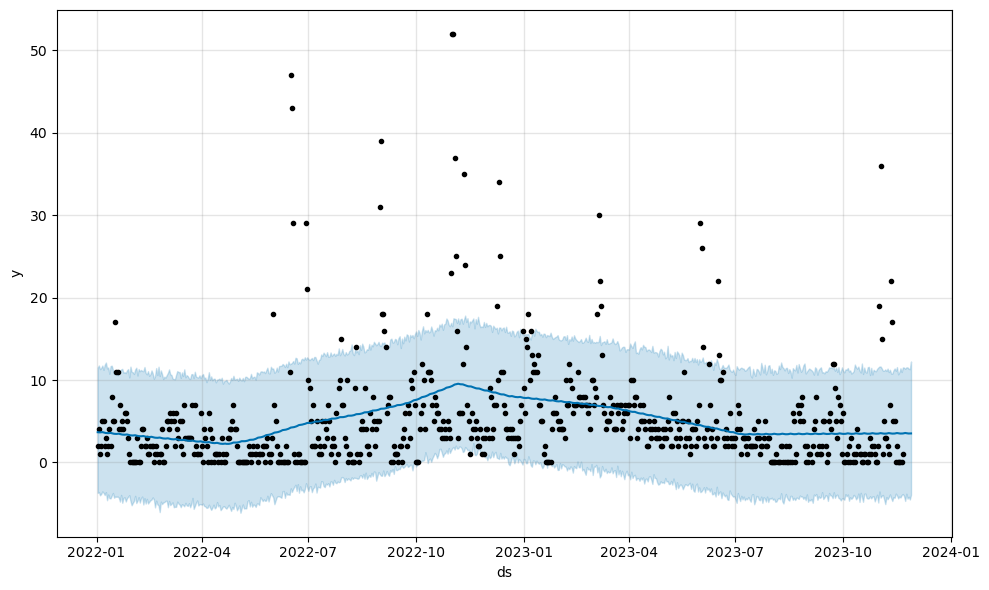

17:00:03 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
691 2023-11-24  3.560710   -3.793856   11.538692
692 2023-11-25  3.531892   -4.391872   11.539246
693 2023-11-26  3.513290   -4.158167   11.365953
694 2023-11-27  3.516080   -4.493881   11.324508
695 2023-11-28  3.522894   -3.921570   12.256924


17:00:03 - cmdstanpy - INFO - Chain [1] done processing


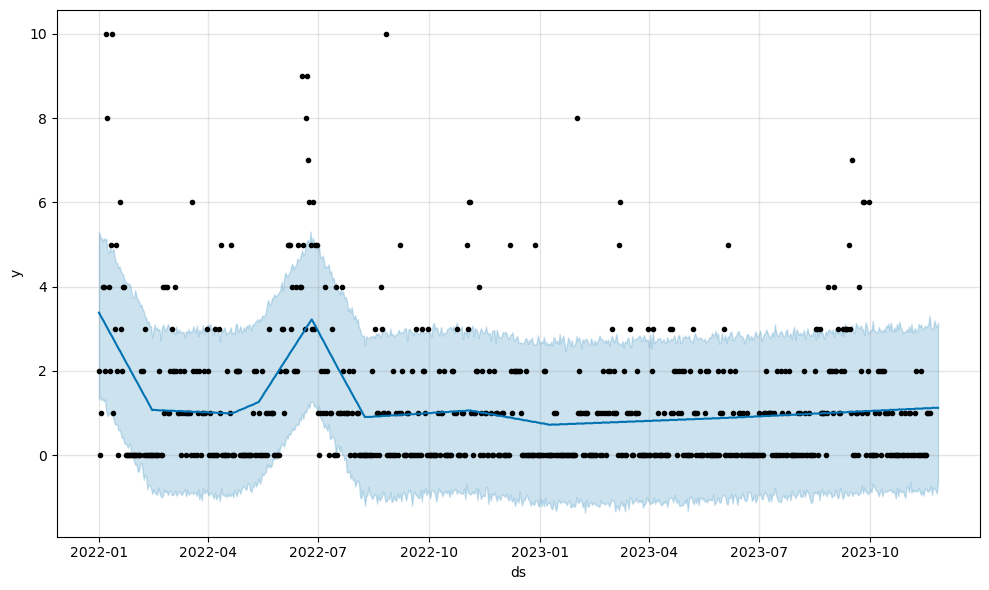

17:00:04 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
690 2023-11-22  1.127045   -0.764638    3.016327
691 2023-11-23  1.122591   -0.780672    3.197988
692 2023-11-24  1.125074   -0.836184    3.089515
693 2023-11-25  1.125232   -0.913765    3.041918
694 2023-11-26  1.122742   -0.628424    3.144492


17:00:04 - cmdstanpy - INFO - Chain [1] done processing


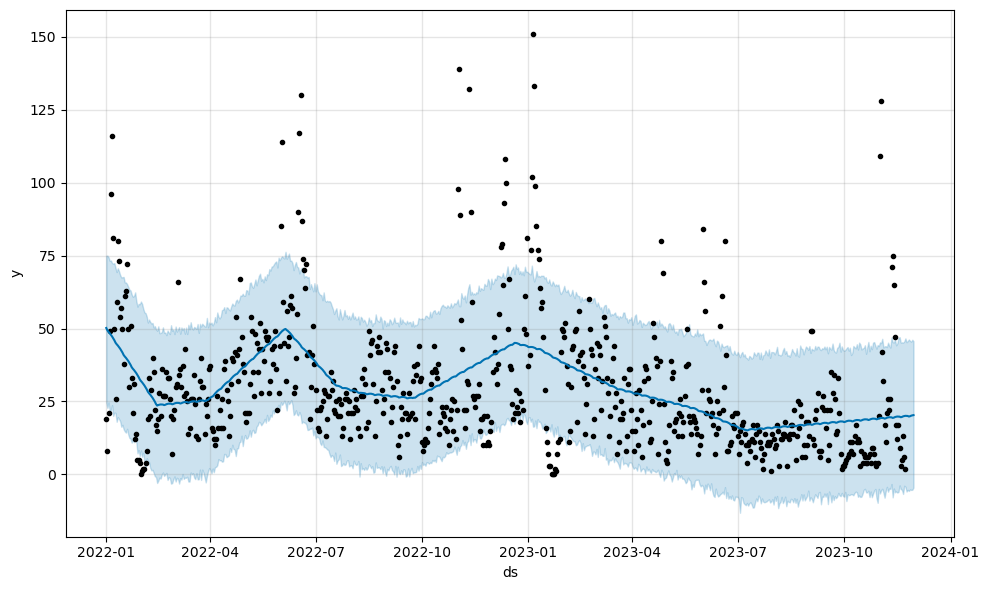

17:00:05 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  19.836528   -5.668235   46.260942
695 2023-11-27  19.938933   -5.180618   45.764645
696 2023-11-28  20.126785   -5.335821   45.516765
697 2023-11-29  20.241886   -5.259084   46.178621
698 2023-11-30  20.315462   -4.513033   45.646406


17:00:05 - cmdstanpy - INFO - Chain [1] done processing


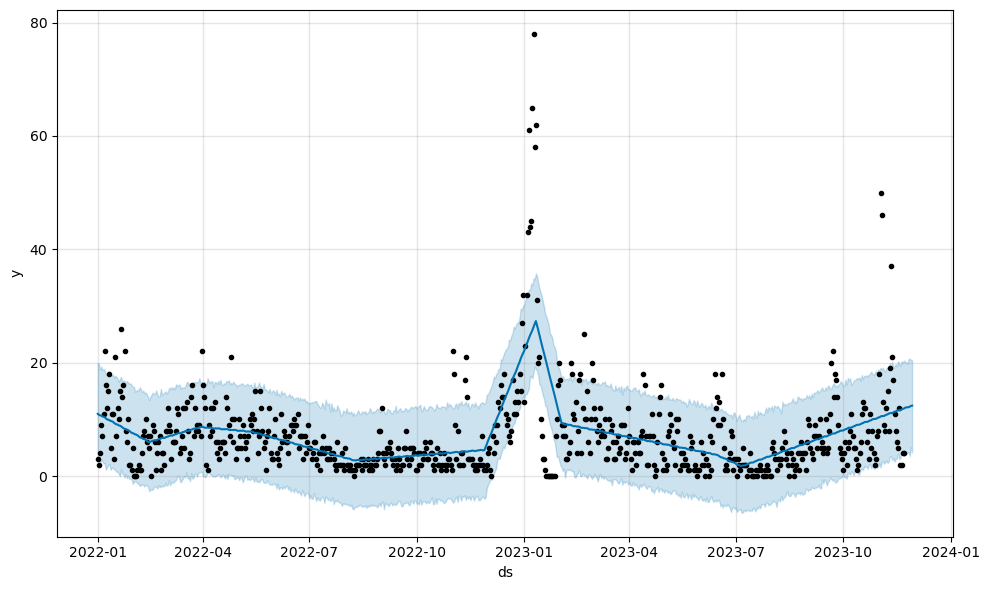

17:00:06 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
693 2023-11-25  12.154272    4.089306   19.895430
694 2023-11-26  12.156230    4.297904   20.649848
695 2023-11-27  12.273782    3.575468   20.723562
696 2023-11-28  12.383632    5.069999   20.485438
697 2023-11-29  12.436381    4.191985   20.421017


17:00:06 - cmdstanpy - INFO - Chain [1] done processing


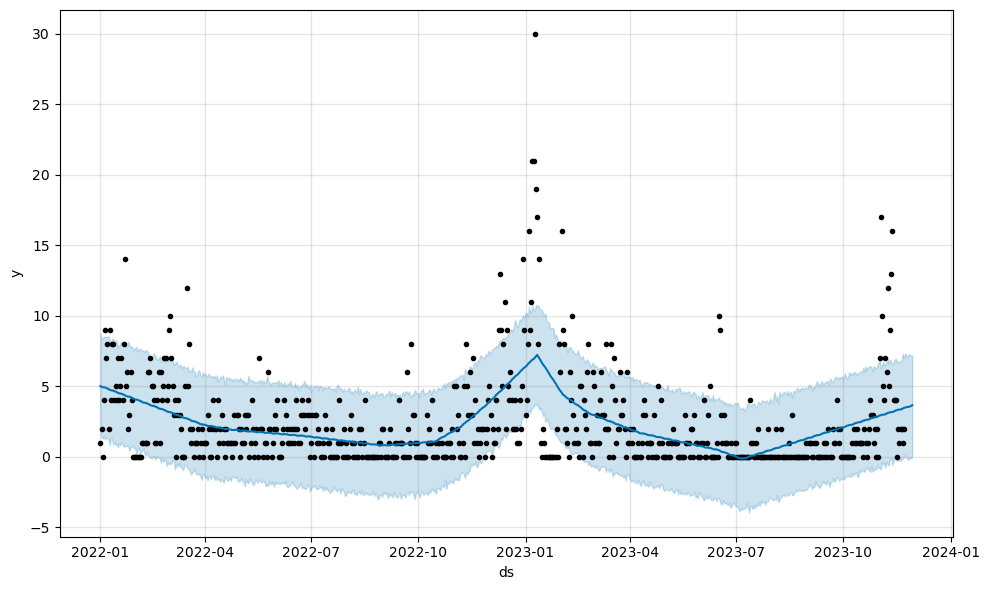

17:00:06 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
693 2023-11-25  3.530922   -0.168731    7.103694
694 2023-11-26  3.540660   -0.207104    7.284150
695 2023-11-27  3.565506   -0.021274    7.196432
696 2023-11-28  3.607793   -0.126216    7.215715
697 2023-11-29  3.660549    0.039065    7.185372


17:00:06 - cmdstanpy - INFO - Chain [1] done processing


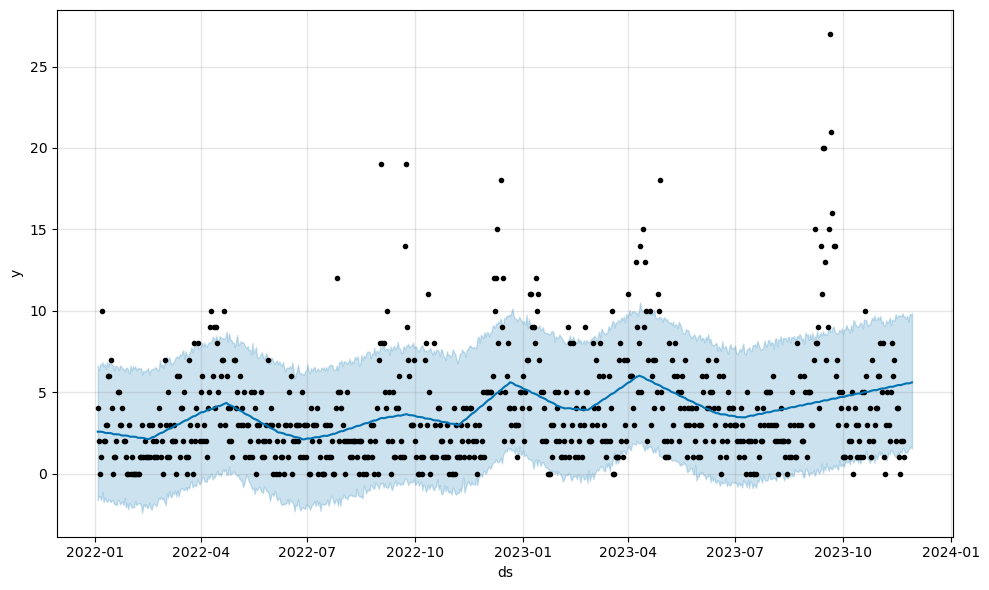

17:00:07 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
691 2023-11-25  5.544866    1.285346    9.699496
692 2023-11-26  5.534461    1.484587    9.316784
693 2023-11-27  5.546975    1.587637    9.813266
694 2023-11-28  5.574530    1.675587    9.728968
695 2023-11-29  5.599454    1.538336    9.867141


17:00:07 - cmdstanpy - INFO - Chain [1] done processing


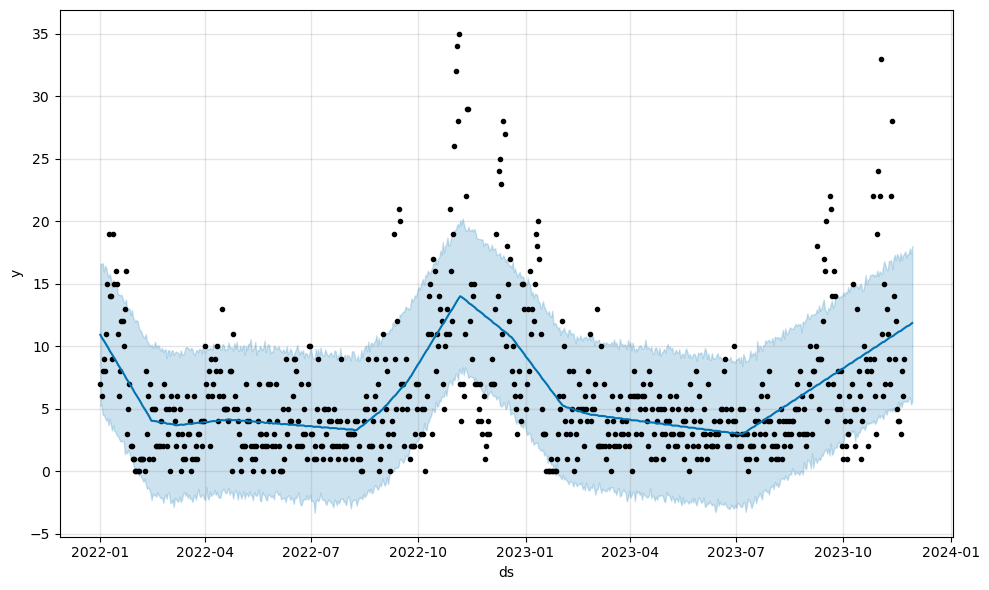

17:00:08 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
693 2023-11-25  11.633102    5.562205   17.399363
694 2023-11-26  11.659125    5.859942   17.382652
695 2023-11-27  11.724827    5.949727   17.839769
696 2023-11-28  11.806633    5.359847   17.423418
697 2023-11-29  11.875084    5.599692   18.033721


17:00:08 - cmdstanpy - INFO - Chain [1] done processing


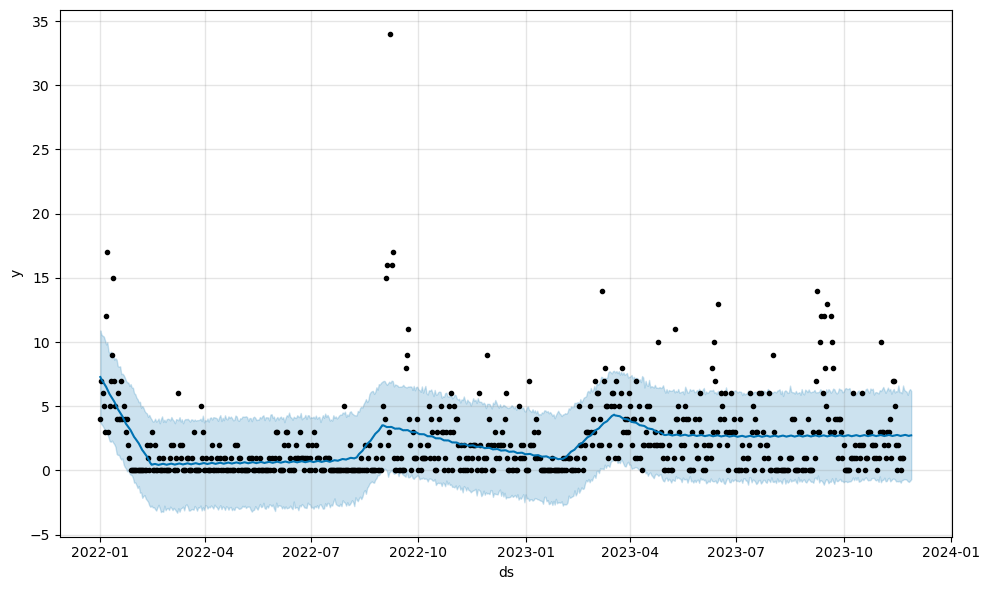

17:00:09 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
692 2023-11-24  2.745016   -0.712745    6.140510
693 2023-11-25  2.721580   -0.832234    5.893142
694 2023-11-26  2.693228   -0.889989    6.221009
695 2023-11-27  2.721947   -0.803343    6.340513
696 2023-11-28  2.736423   -0.682315    6.201168


17:00:09 - cmdstanpy - INFO - Chain [1] done processing


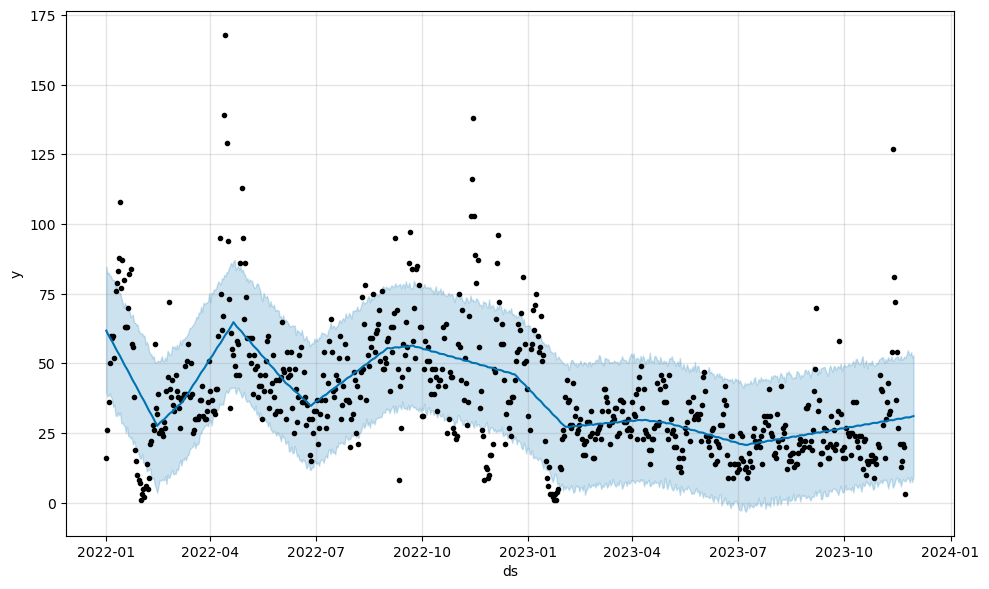

17:00:09 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  30.562822    8.316995   53.641976
695 2023-11-27  30.702928    7.297623   52.963154
696 2023-11-28  30.863795    9.416775   54.033585
697 2023-11-29  31.009108    7.400376   52.093652
698 2023-11-30  31.107323    9.530072   52.859668


17:00:09 - cmdstanpy - INFO - Chain [1] done processing


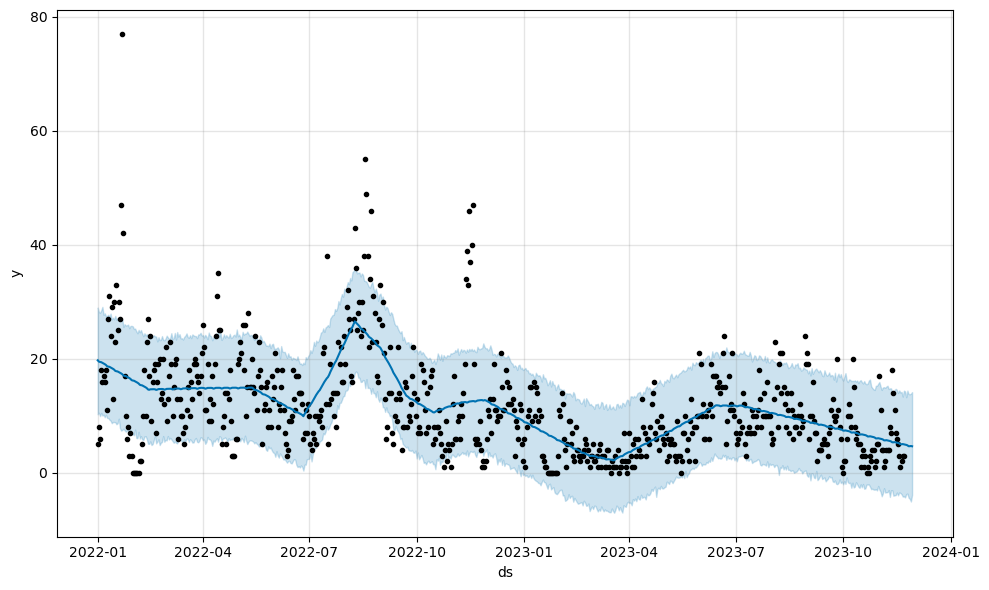

17:00:10 - cmdstanpy - INFO - Chain [1] start processing
17:00:10 - cmdstanpy - INFO - Chain [1] done processing


            ds      yhat  yhat_lower  yhat_upper
693 2023-11-25  4.816328   -3.667755   14.421427
694 2023-11-26  4.662068   -4.381164   13.814632
695 2023-11-27  4.661026   -4.569969   13.783390
696 2023-11-28  4.692504   -5.046995   13.852812
697 2023-11-29  4.649705   -3.890515   14.151150


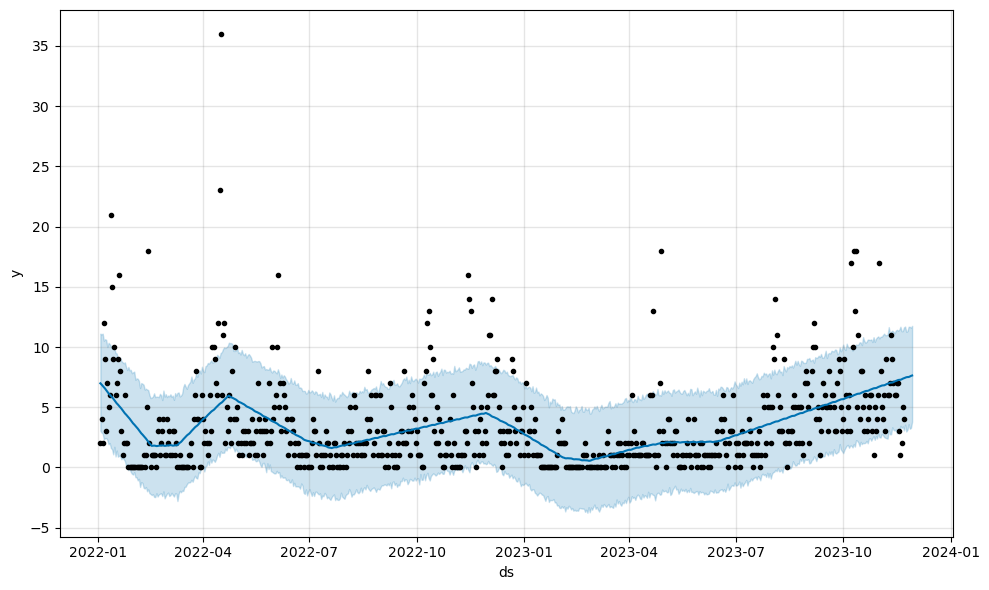

17:00:10 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
691 2023-11-25  7.505907    3.124739   11.318322
692 2023-11-26  7.510167    3.593089   11.685838
693 2023-11-27  7.547578    3.211014   11.679208
694 2023-11-28  7.602020    3.281947   11.609218
695 2023-11-29  7.636188    3.804510   11.756662


17:00:11 - cmdstanpy - INFO - Chain [1] done processing


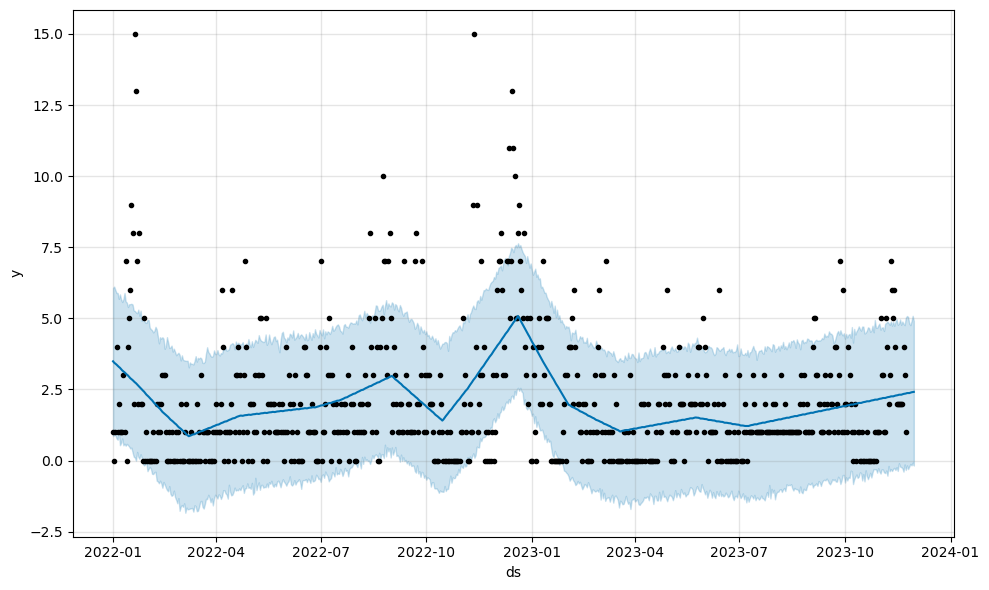

17:00:11 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
694 2023-11-26  2.373406   -0.212313    4.825951
695 2023-11-27  2.389280   -0.115702    4.763097
696 2023-11-28  2.401650   -0.168094    4.903298
697 2023-11-29  2.408778   -0.071657    5.090753
698 2023-11-30  2.416102   -0.174104    4.911488


17:00:11 - cmdstanpy - INFO - Chain [1] done processing


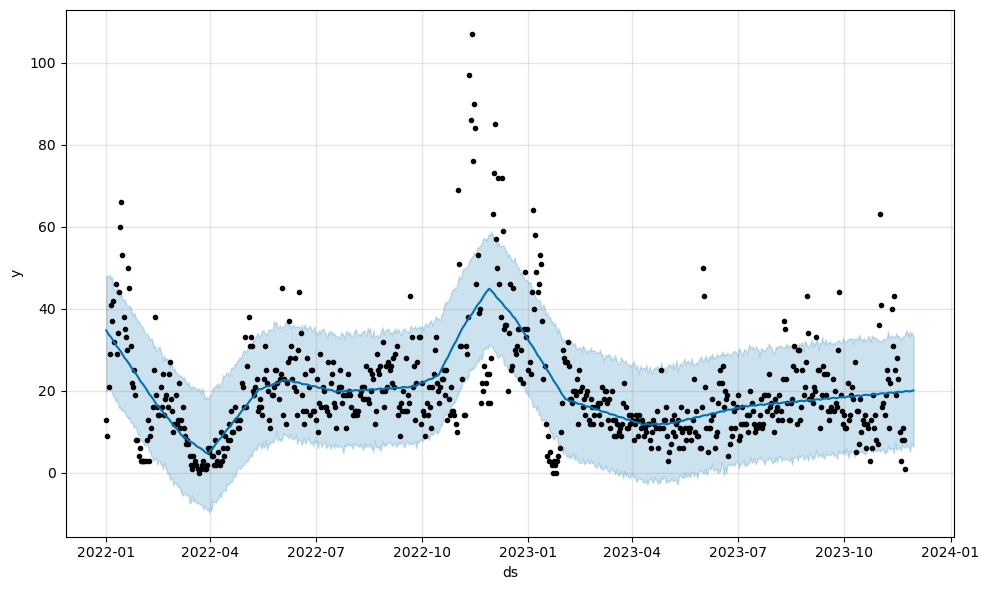

17:00:12 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  19.855668    6.126571   34.422128
695 2023-11-27  19.835291    5.126716   33.149781
696 2023-11-28  19.978829    7.358711   34.416346
697 2023-11-29  20.050701    6.723058   33.842113
698 2023-11-30  20.095827    6.375494   33.091176


17:00:12 - cmdstanpy - INFO - Chain [1] done processing


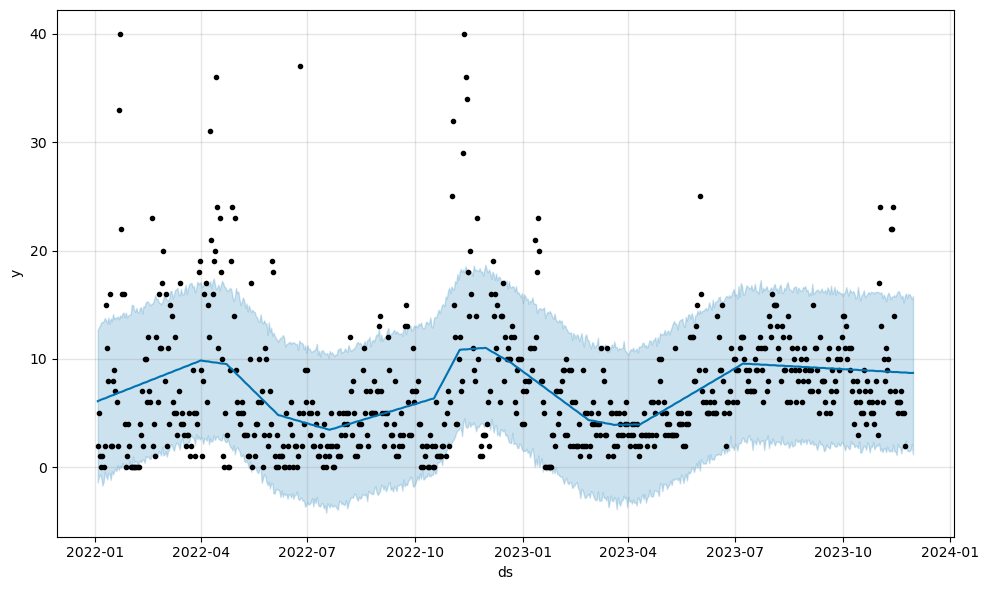

17:00:13 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
692 2023-11-26  8.712987    1.496243   15.987135
693 2023-11-27  8.708355    1.468662   15.966875
694 2023-11-28  8.711927    1.619526   15.796179
695 2023-11-29  8.706200    2.164179   15.525151
696 2023-11-30  8.714458    1.201181   15.788837


17:00:13 - cmdstanpy - INFO - Chain [1] done processing


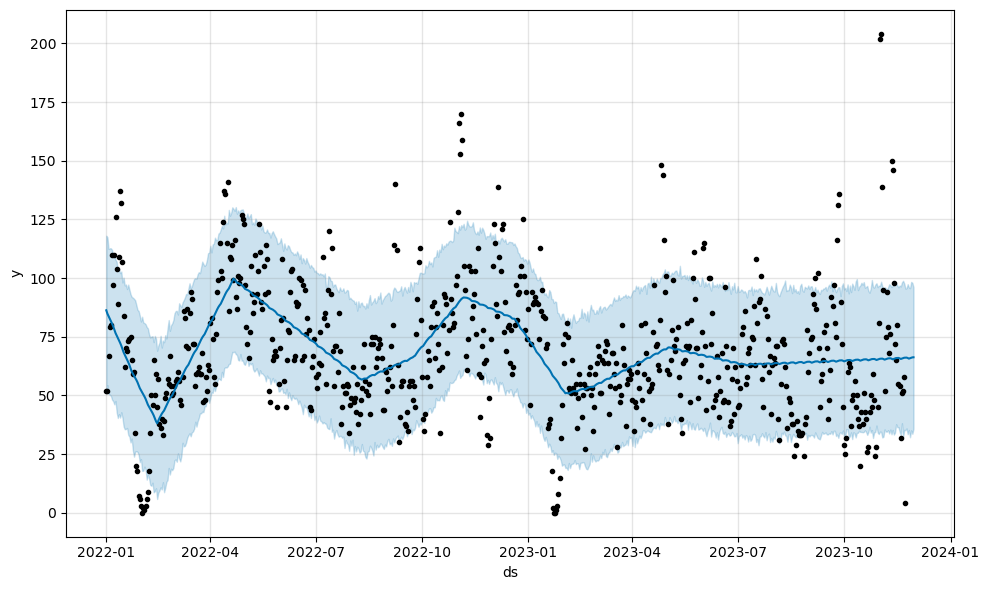

17:00:14 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  65.674220   35.258491   96.056983
695 2023-11-27  65.838652   32.175935   95.697022
696 2023-11-28  66.050993   35.128710   98.374026
697 2023-11-29  66.202069   33.641897   97.968149
698 2023-11-30  66.245777   35.809292   96.074232


17:00:14 - cmdstanpy - INFO - Chain [1] done processing


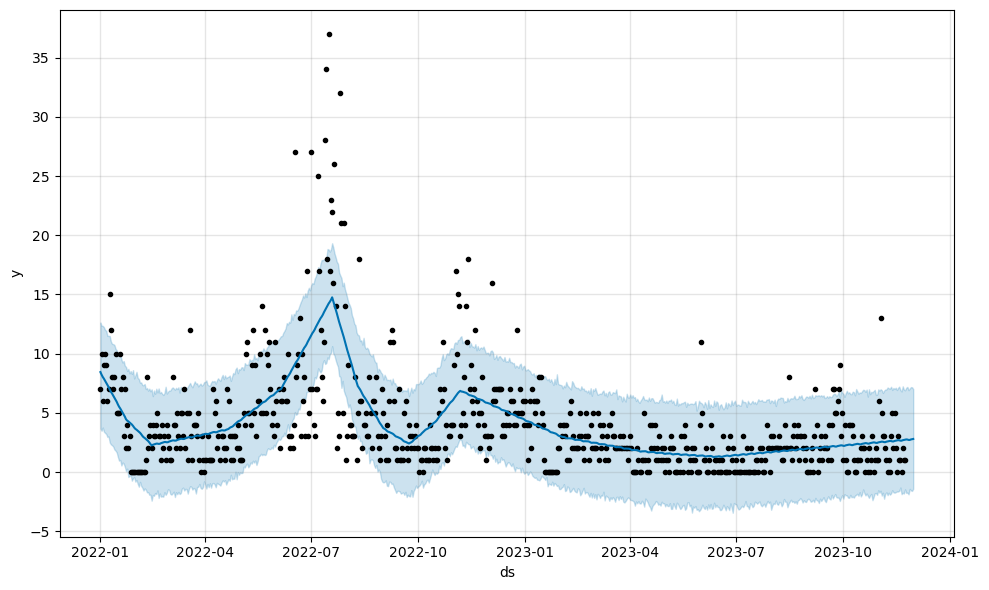

17:00:14 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
694 2023-11-26  2.709189   -1.886570    6.909829
695 2023-11-27  2.706912   -1.427726    7.053501
696 2023-11-28  2.747606   -1.556605    7.174301
697 2023-11-29  2.765617   -1.596943    7.155545
698 2023-11-30  2.790662   -1.425689    7.010608


17:00:15 - cmdstanpy - INFO - Chain [1] done processing


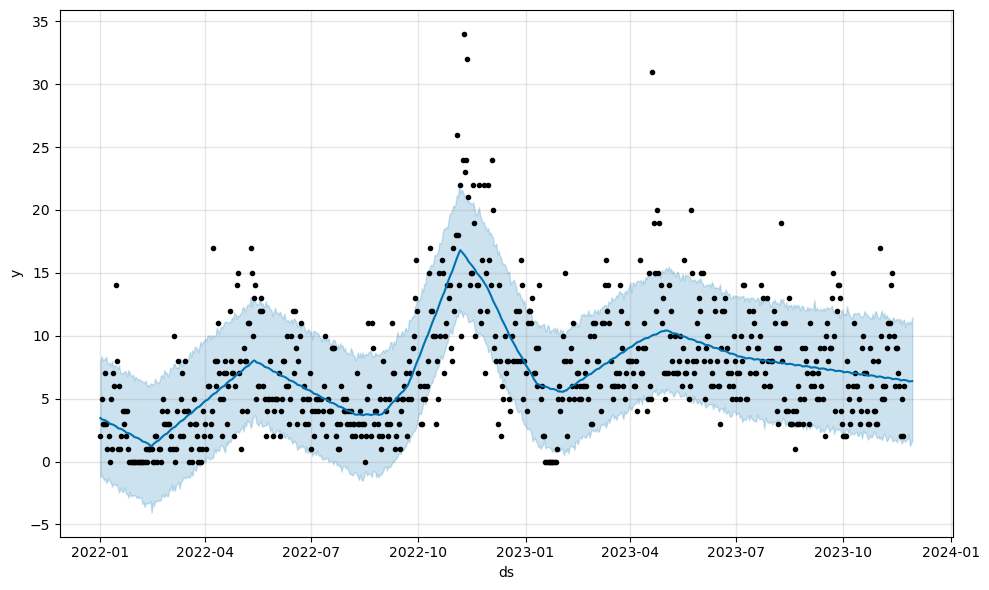

17:00:15 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
693 2023-11-25  6.426884    1.762630   11.104404
694 2023-11-26  6.362273    2.160506   10.962113
695 2023-11-27  6.369370    1.236728   11.139255
696 2023-11-28  6.385597    1.435920   10.923657
697 2023-11-29  6.393527    1.640857   11.474981


17:00:16 - cmdstanpy - INFO - Chain [1] done processing


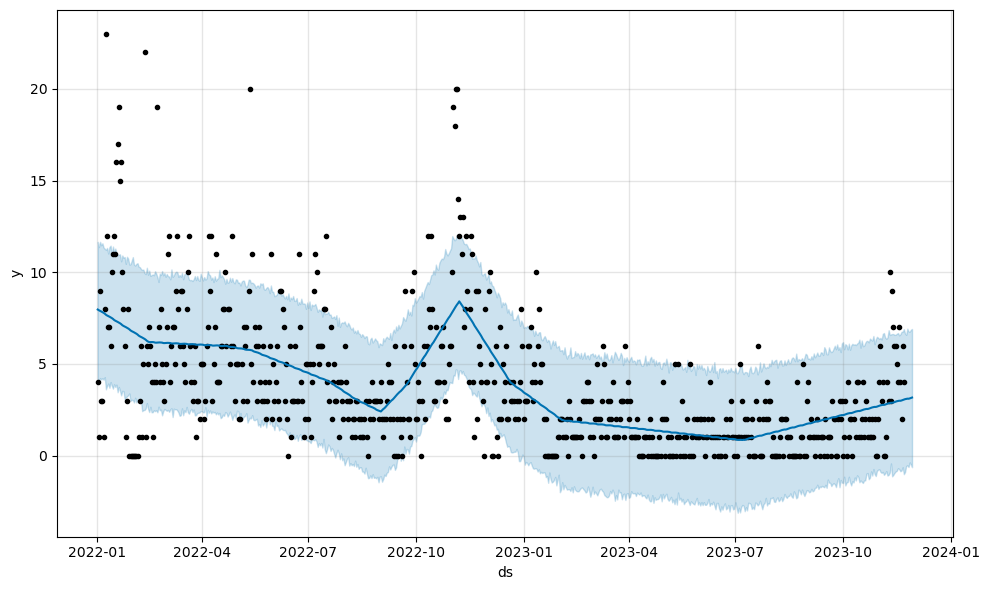

17:00:16 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
692 2023-11-25  3.100180   -0.537898    6.922644
693 2023-11-26  3.097744   -0.627256    6.764751
694 2023-11-27  3.113896   -0.378771    6.758649
695 2023-11-28  3.140587   -0.488482    6.856840
696 2023-11-29  3.161808   -0.638286    6.904433


17:00:17 - cmdstanpy - INFO - Chain [1] done processing


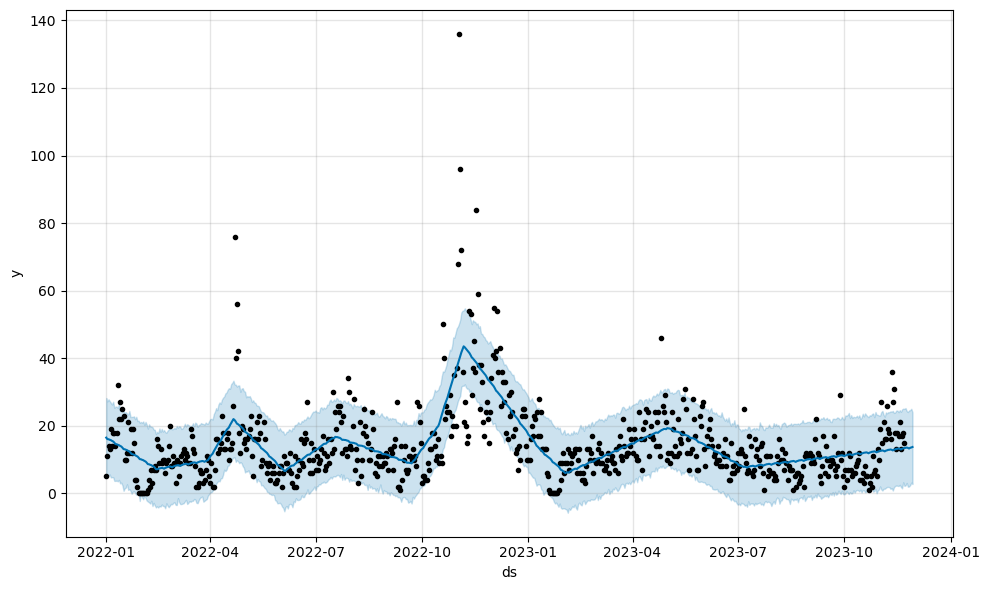

17:00:17 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
693 2023-11-25  13.451557    1.956129   24.071887
694 2023-11-26  13.271236    2.011044   24.525518
695 2023-11-27  13.478144    2.434433   24.634351
696 2023-11-28  13.577641    3.169937   25.037943
697 2023-11-29  13.718056    2.763880   23.976022


17:00:17 - cmdstanpy - INFO - Chain [1] done processing


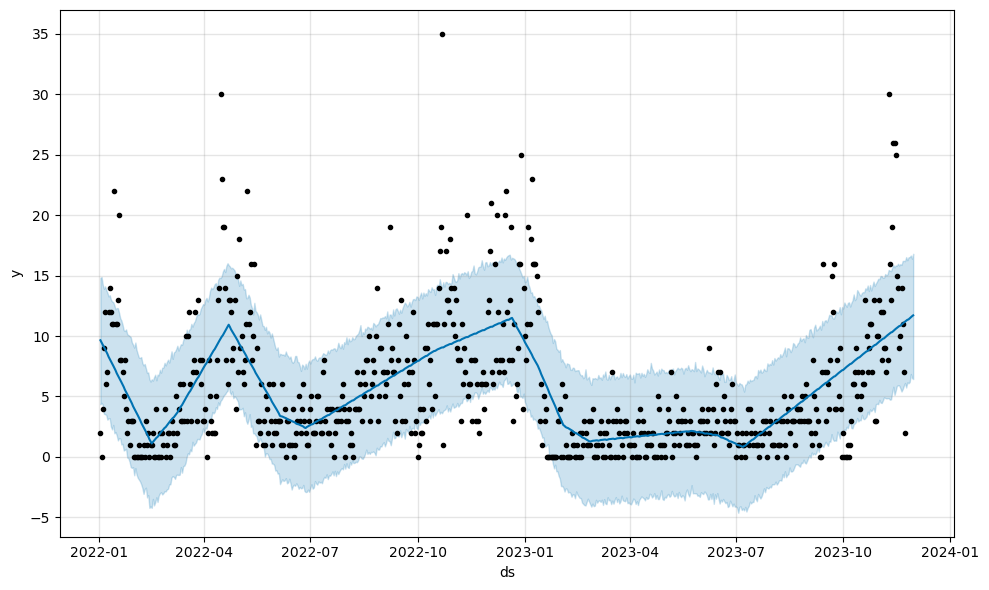

17:00:18 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
693 2023-11-26  11.376896    6.092759   16.519263
694 2023-11-27  11.465357    6.193721   16.532524
695 2023-11-28  11.565872    6.863291   16.666361
696 2023-11-29  11.639575    6.523886   16.404261
697 2023-11-30  11.714871    6.439150   16.809105


17:00:18 - cmdstanpy - INFO - Chain [1] done processing


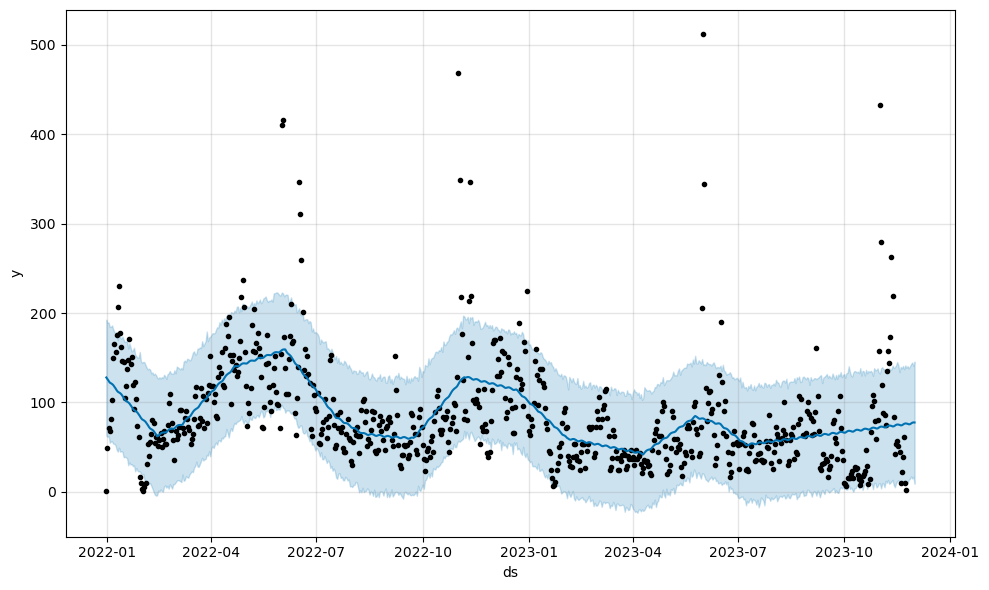

17:00:19 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
696 2023-11-27  75.607076   14.741338  140.255944
697 2023-11-28  76.435700   17.373688  142.901619
698 2023-11-29  77.280201   14.874121  144.703205
699 2023-11-30  77.702124   16.692667  140.813738
700 2023-12-01  77.580998    9.171947  145.667743


17:00:19 - cmdstanpy - INFO - Chain [1] done processing


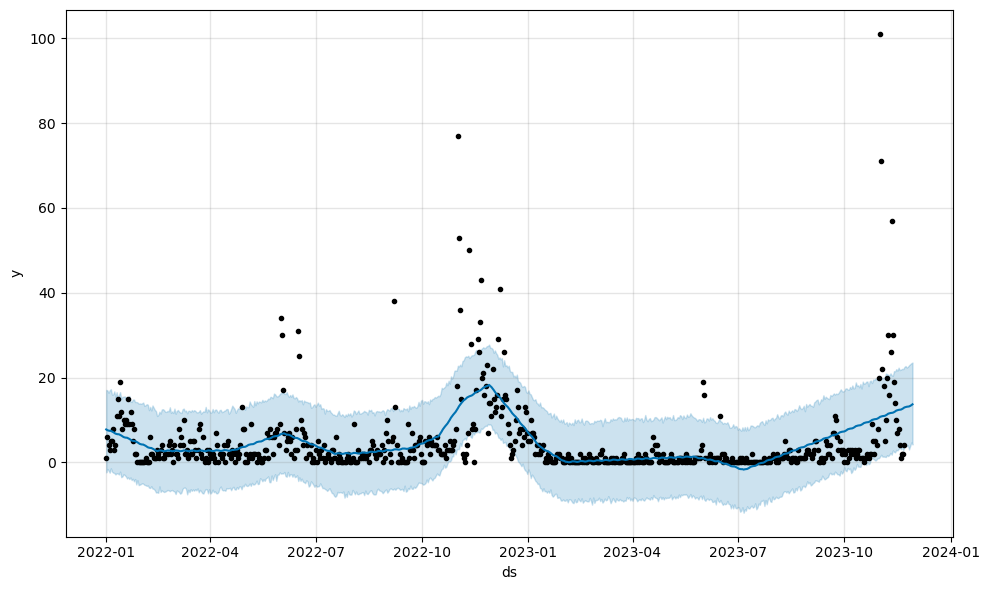

17:00:19 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
693 2023-11-25  13.158848    4.051619   22.548545
694 2023-11-26  13.201794    3.051255   22.908866
695 2023-11-27  13.333407    3.876019   23.148126
696 2023-11-28  13.498853    4.701492   23.402613
697 2023-11-29  13.704847    4.242685   23.559814


17:00:20 - cmdstanpy - INFO - Chain [1] done processing


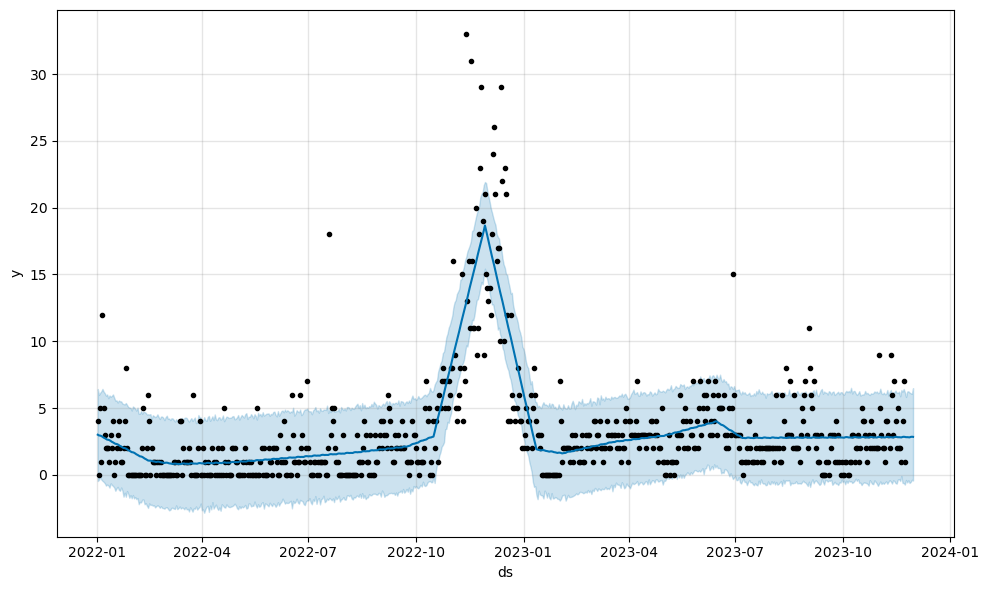

17:00:20 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
693 2023-11-26  2.816634   -0.405696    6.258582
694 2023-11-27  2.806876   -0.608692    6.156969
695 2023-11-28  2.840893   -0.523719    6.109187
696 2023-11-29  2.854707   -0.366098    6.060859
697 2023-11-30  2.844778   -0.427825    6.494251


17:00:21 - cmdstanpy - INFO - Chain [1] done processing


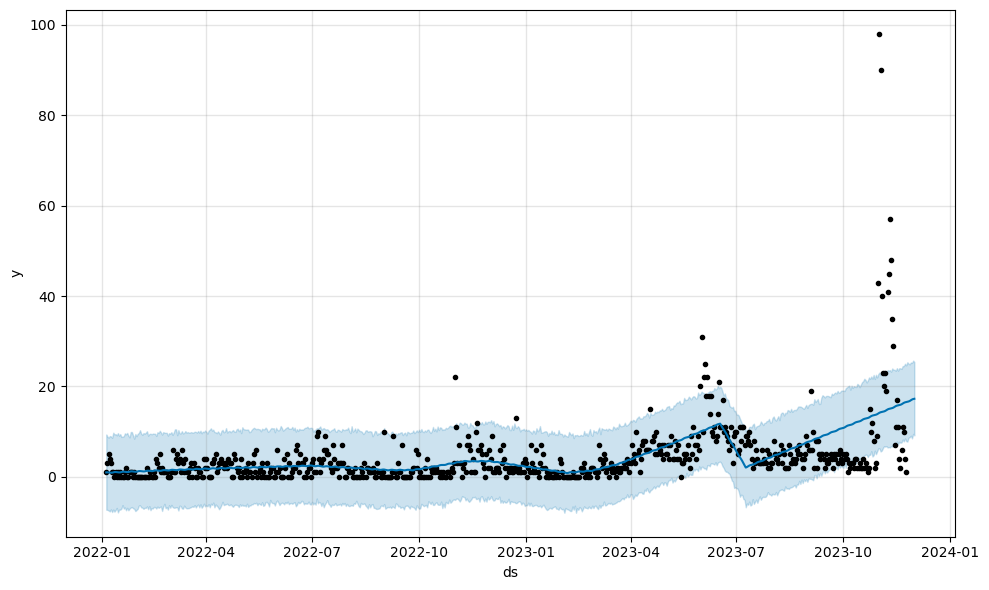

17:00:21 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
691 2023-11-27  16.792476    8.766061   24.898116
692 2023-11-28  16.963901    9.099557   25.320396
693 2023-11-29  17.116611    8.516696   25.215456
694 2023-11-30  17.225970    9.516778   25.729058
695 2023-12-01  17.280078    9.184529   25.435595


17:00:21 - cmdstanpy - INFO - Chain [1] done processing


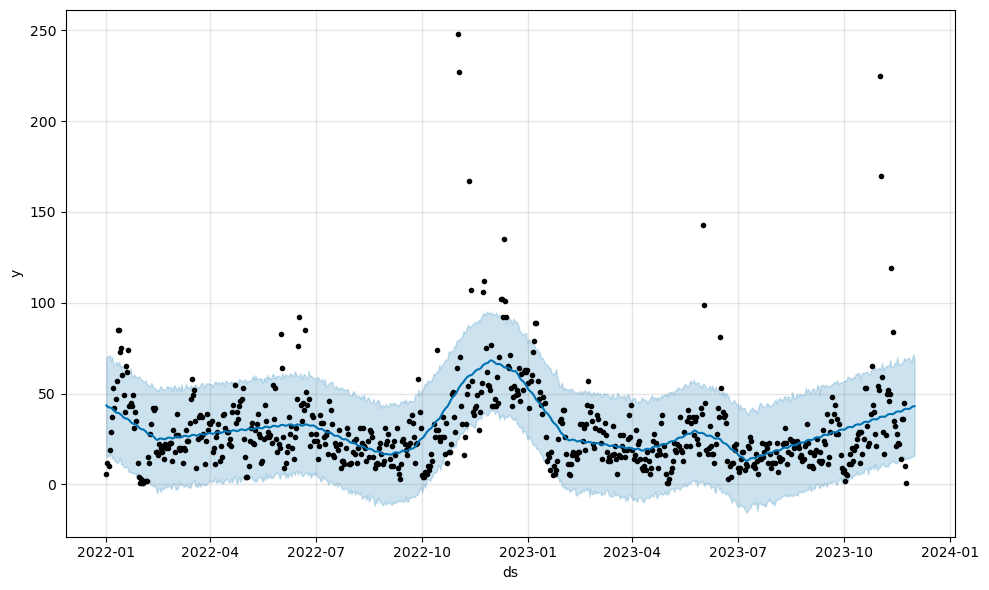

17:00:22 - cmdstanpy - INFO - Chain [1] start processing
17:00:22 - cmdstanpy - INFO - Chain [1] done processing


            ds       yhat  yhat_lower  yhat_upper
695 2023-11-27  41.779805   14.426285   68.464536
696 2023-11-28  42.220113   15.257222   67.191624
697 2023-11-29  42.796037   15.150945   69.384978
698 2023-11-30  42.916378   16.092602   71.757583
699 2023-12-01  43.079351   15.690825   69.284793


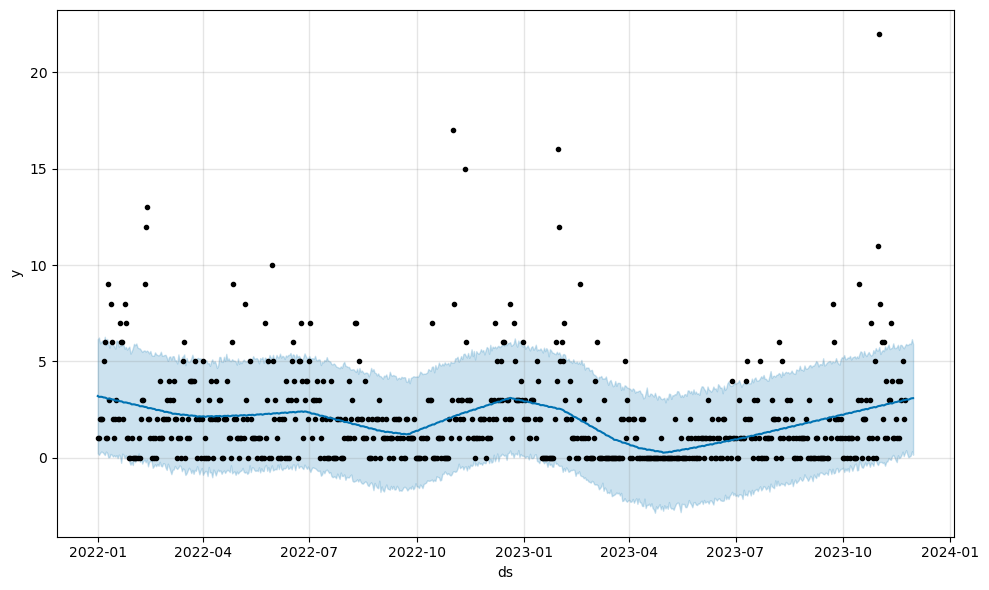

17:00:22 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
694 2023-11-26  3.005900    0.017505    5.872030
695 2023-11-27  3.038167    0.058020    5.923229
696 2023-11-28  3.065593    0.109734    5.889711
697 2023-11-29  3.081069    0.327780    6.151524
698 2023-11-30  3.085883    0.148639    5.896227


17:00:23 - cmdstanpy - INFO - Chain [1] done processing


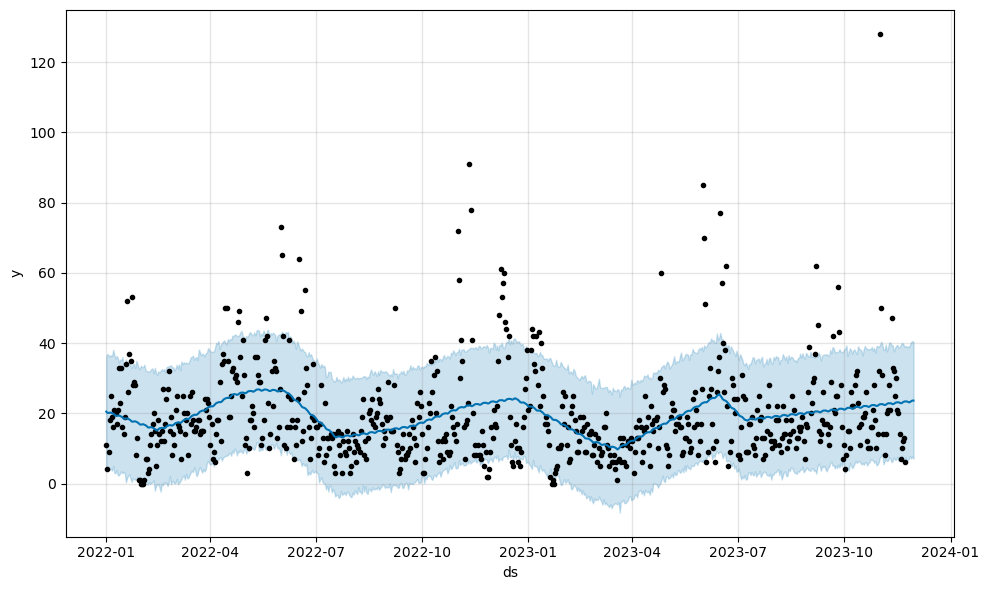

17:00:23 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  23.107925    6.984054   38.787691
695 2023-11-27  23.200777    7.833045   39.513263
696 2023-11-28  23.433726    7.105606   40.313077
697 2023-11-29  23.622073    7.701860   40.579095
698 2023-11-30  23.621566    7.114648   40.338108


17:00:23 - cmdstanpy - INFO - Chain [1] done processing


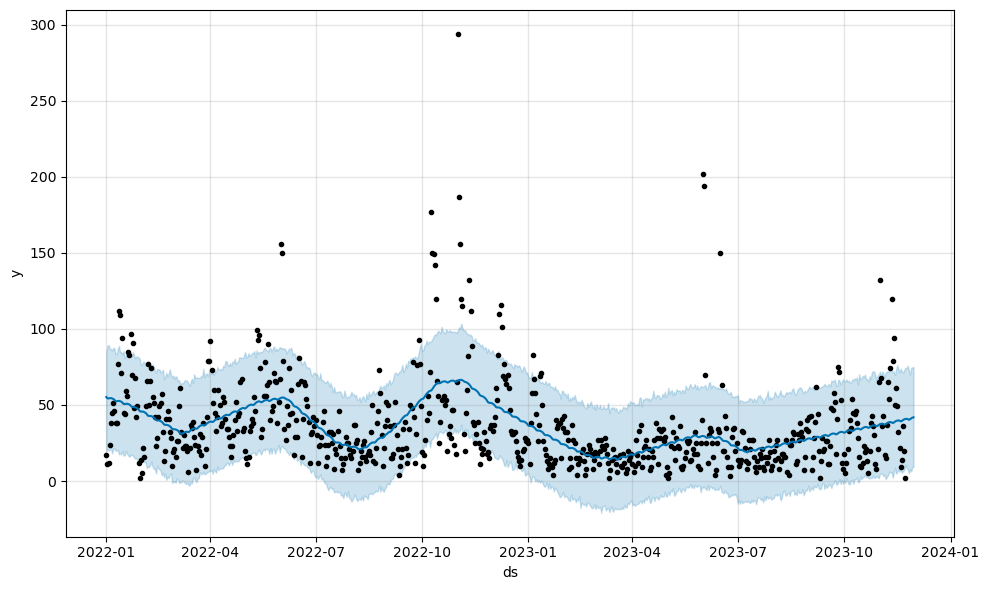

17:00:24 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  40.270793    4.991568   72.729722
695 2023-11-27  40.589955    7.646547   70.002285
696 2023-11-28  41.190030    6.319647   74.474946
697 2023-11-29  41.645644    9.292753   74.720329
698 2023-11-30  41.869231    9.087615   75.032047


17:00:24 - cmdstanpy - INFO - Chain [1] done processing


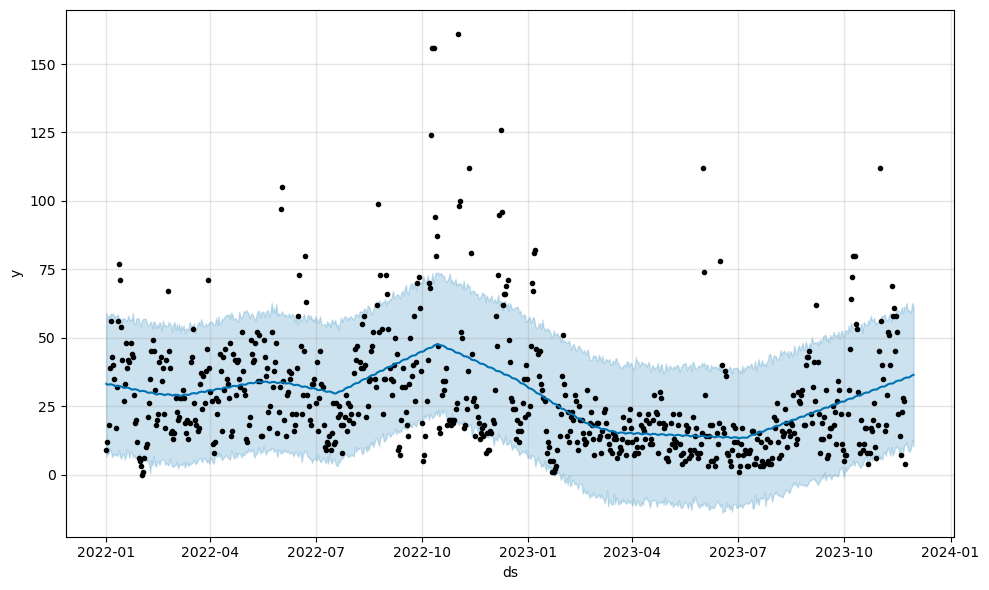

17:00:25 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  35.452671    8.331223   60.250600
695 2023-11-27  35.670497    8.658565   59.145376
696 2023-11-28  36.028801    9.686452   60.076890
697 2023-11-29  36.270262   12.492749   62.750360
698 2023-11-30  36.424202   10.415214   61.332352


17:00:25 - cmdstanpy - INFO - Chain [1] done processing


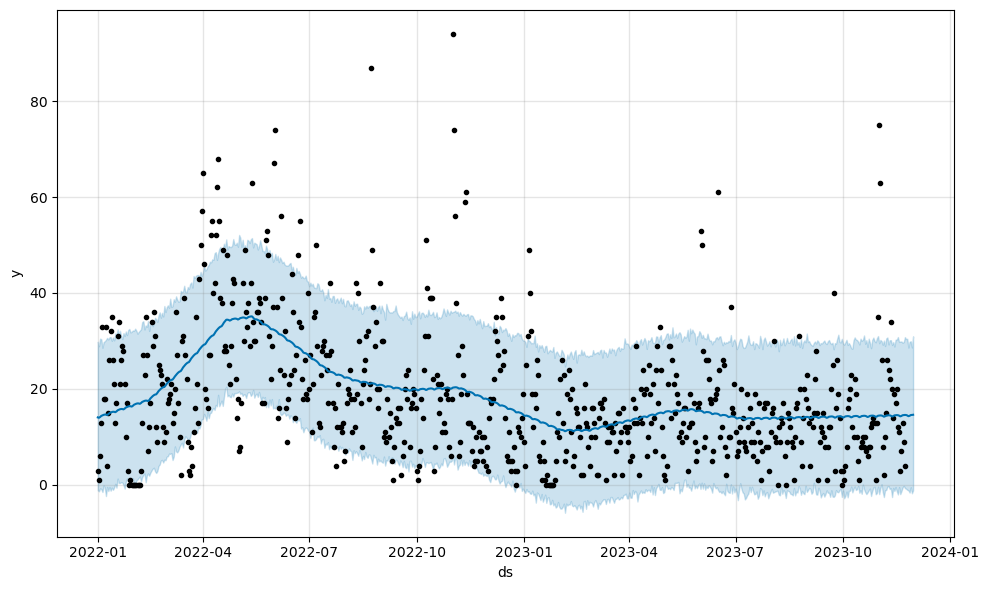

17:00:25 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  14.315734   -1.136895   28.630987
695 2023-11-27  14.402343   -1.593013   29.852916
696 2023-11-28  14.552509   -0.500304   29.935146
697 2023-11-29  14.592123   -1.751392   28.658609
698 2023-11-30  14.615516   -1.142226   30.967274


17:00:26 - cmdstanpy - INFO - Chain [1] done processing


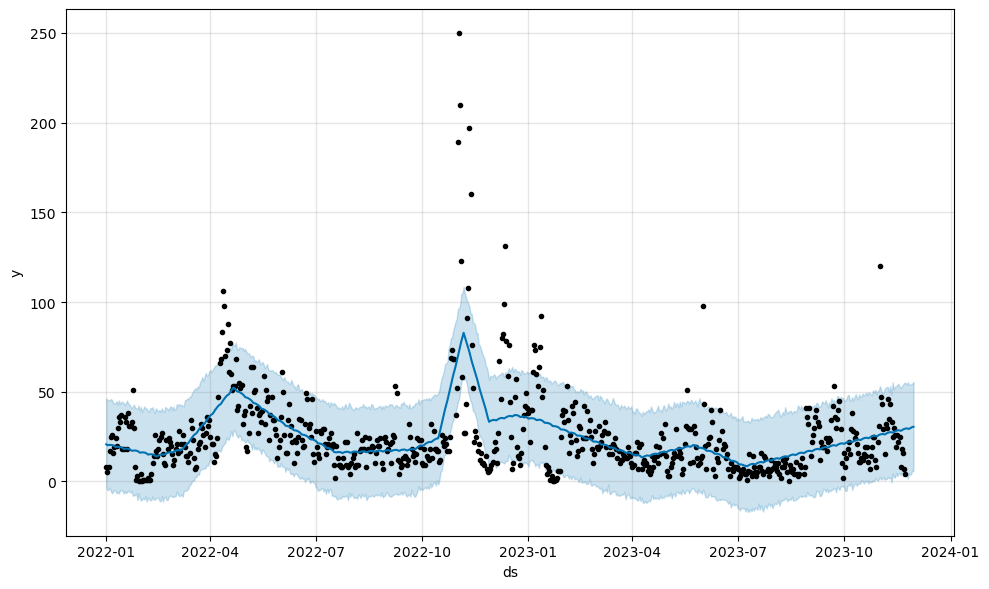

17:00:26 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  29.239706    4.407980   54.068176
695 2023-11-27  29.545944    3.575489   53.886315
696 2023-11-28  29.993437    4.140054   54.176892
697 2023-11-29  30.261169    6.268464   54.637657
698 2023-11-30  30.455233    5.713568   55.400840


17:00:27 - cmdstanpy - INFO - Chain [1] done processing


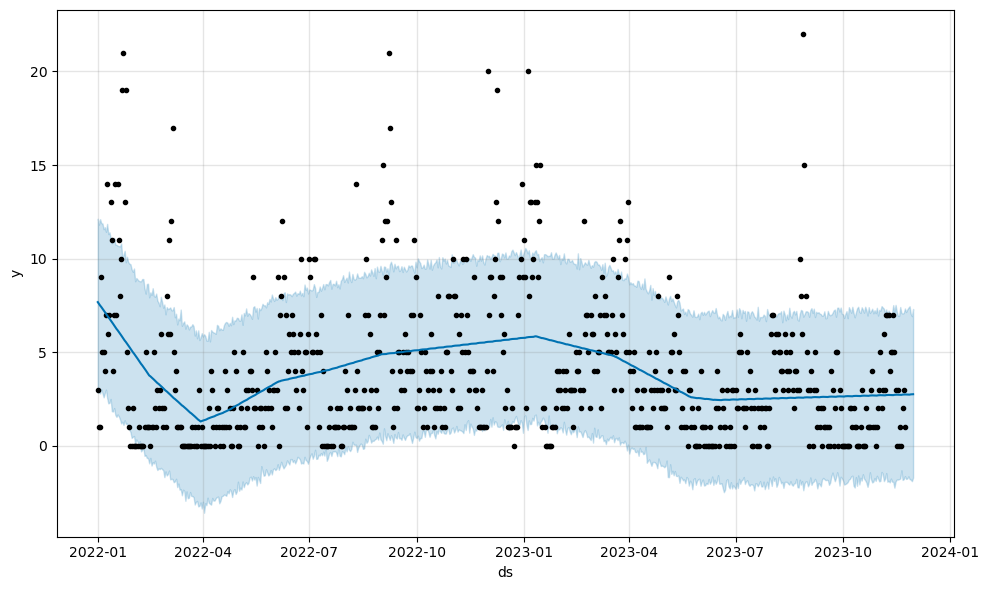

17:00:27 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
694 2023-11-26  2.735961   -1.628737    7.381830
695 2023-11-27  2.736250   -1.774598    7.456492
696 2023-11-28  2.750617   -1.804742    7.055066
697 2023-11-29  2.754557   -1.884772    6.929169
698 2023-11-30  2.758622   -1.695717    7.312430


17:00:27 - cmdstanpy - INFO - Chain [1] done processing


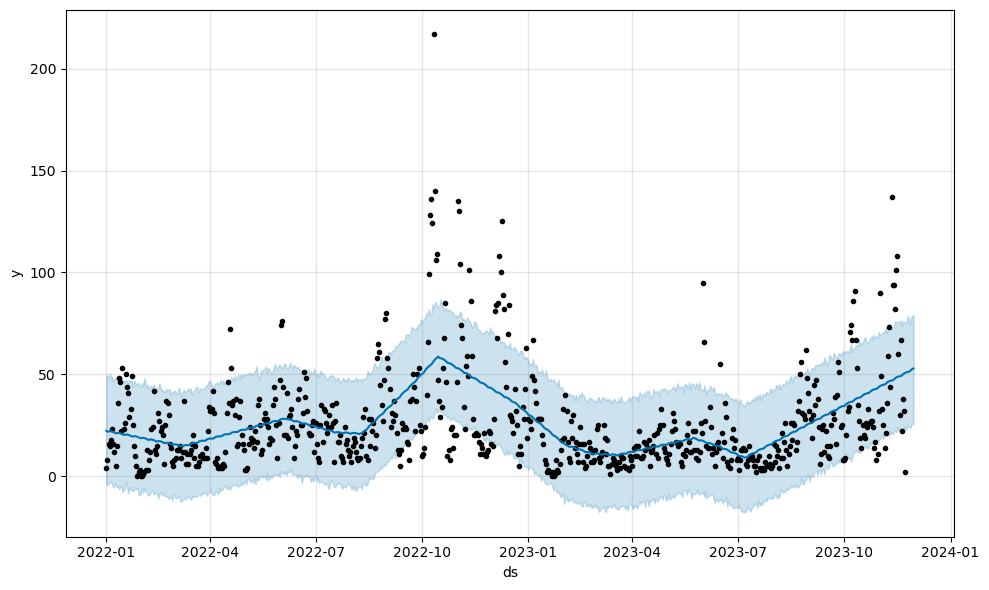

17:00:28 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  51.243100   24.410401   77.061387
695 2023-11-27  51.596147   23.542713   74.170919
696 2023-11-28  52.215753   24.325873   77.829957
697 2023-11-29  52.600078   26.039584   78.750308
698 2023-11-30  52.888640   25.546933   79.024230


17:00:28 - cmdstanpy - INFO - Chain [1] done processing


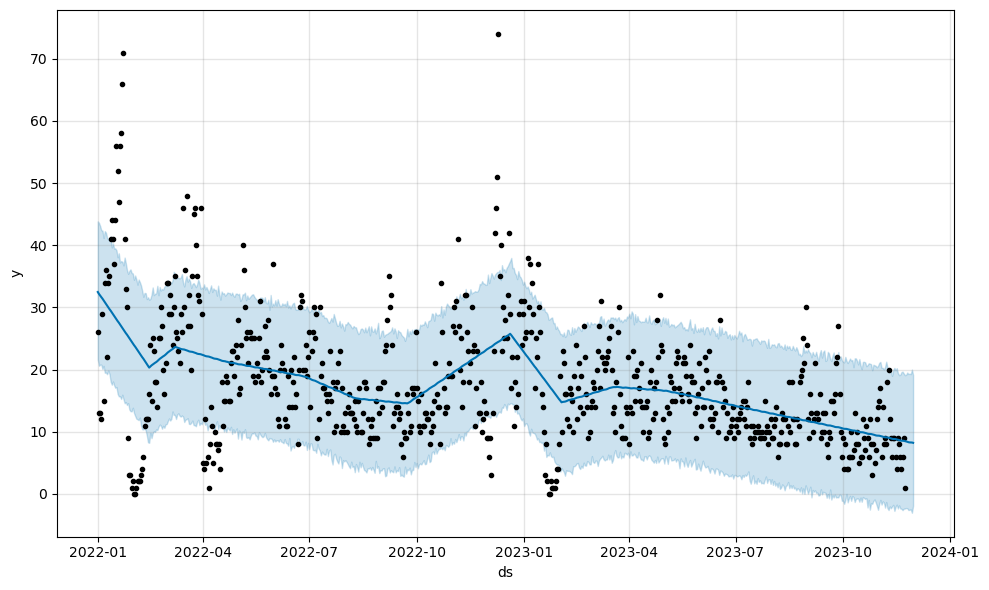

17:00:29 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
694 2023-11-26  8.315585   -2.606046   19.283146
695 2023-11-27  8.281087   -2.546781   19.347447
696 2023-11-28  8.272189   -2.513203   19.262213
697 2023-11-29  8.263942   -3.041133   19.999990
698 2023-11-30  8.214766   -1.918408   19.144875


17:00:29 - cmdstanpy - INFO - Chain [1] done processing


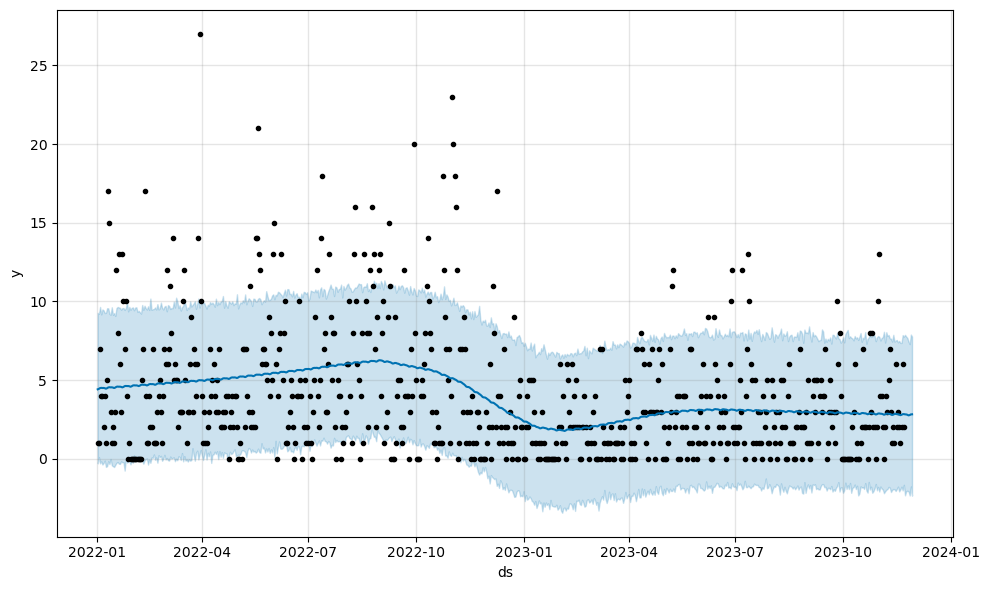

17:00:30 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
692 2023-11-25  2.793909   -2.037125    7.679965
693 2023-11-26  2.755124   -2.078453    7.444456
694 2023-11-27  2.777784   -2.336352    7.284991
695 2023-11-28  2.817502   -1.763127    7.892297
696 2023-11-29  2.823638   -2.345903    7.767347


17:00:30 - cmdstanpy - INFO - Chain [1] done processing


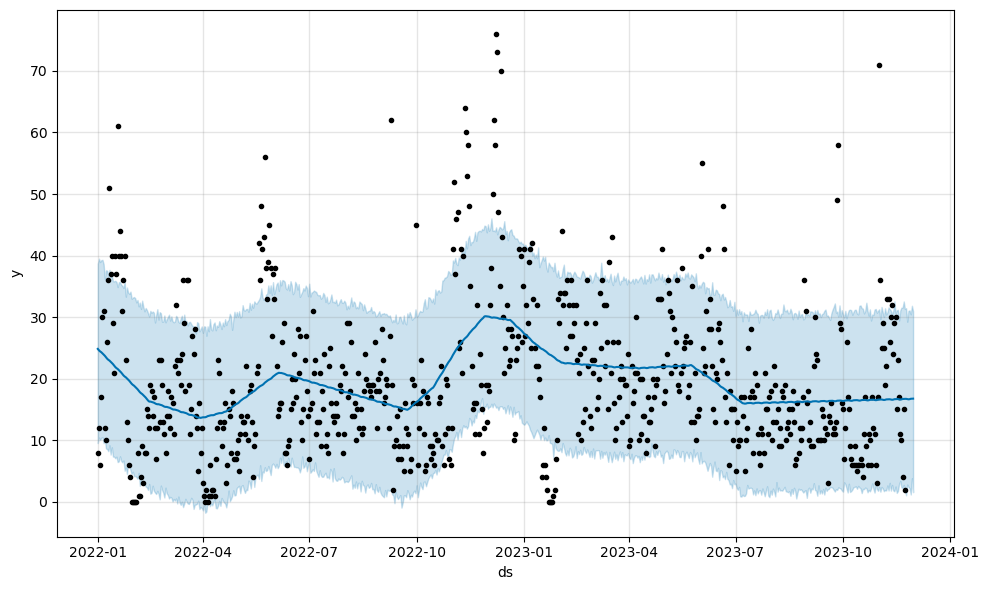

17:00:31 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  16.653081    2.440032   31.026854
695 2023-11-27  16.674895    2.188061   31.090628
696 2023-11-28  16.741358    1.190938   30.457977
697 2023-11-29  16.758356    3.835193   31.850141
698 2023-11-30  16.761727    1.566174   30.964848


17:00:31 - cmdstanpy - INFO - Chain [1] done processing


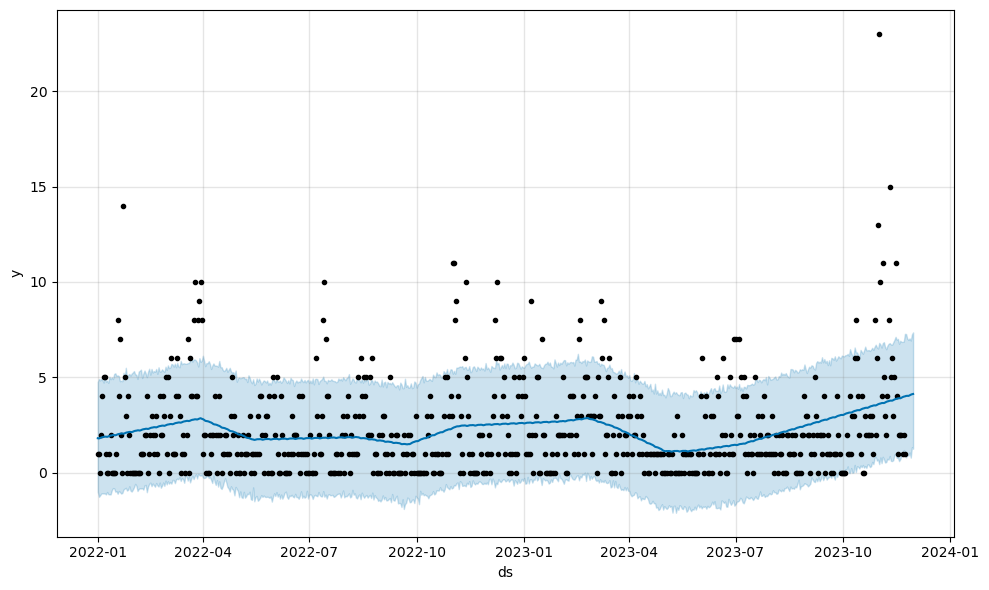

17:00:31 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
694 2023-11-26  4.030236    0.898876    6.961357
695 2023-11-27  4.057032    1.067406    7.045178
696 2023-11-28  4.091555    0.792525    6.934399
697 2023-11-29  4.116410    1.344682    7.252797
698 2023-11-30  4.130975    1.260134    7.360030


17:00:32 - cmdstanpy - INFO - Chain [1] done processing


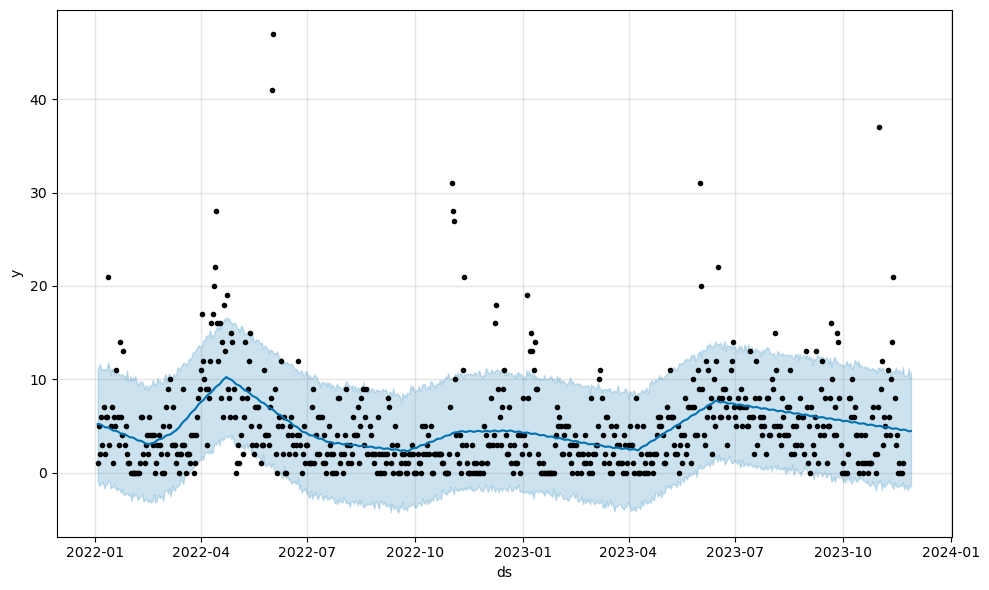

17:00:32 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
690 2023-11-24  4.528303   -1.592272   10.368636
691 2023-11-25  4.473020   -1.915968   10.454352
692 2023-11-26  4.419715   -1.363105   11.154956
693 2023-11-27  4.421026   -1.626726   10.108108
694 2023-11-28  4.446532   -1.381640   10.789913


17:00:32 - cmdstanpy - INFO - Chain [1] done processing


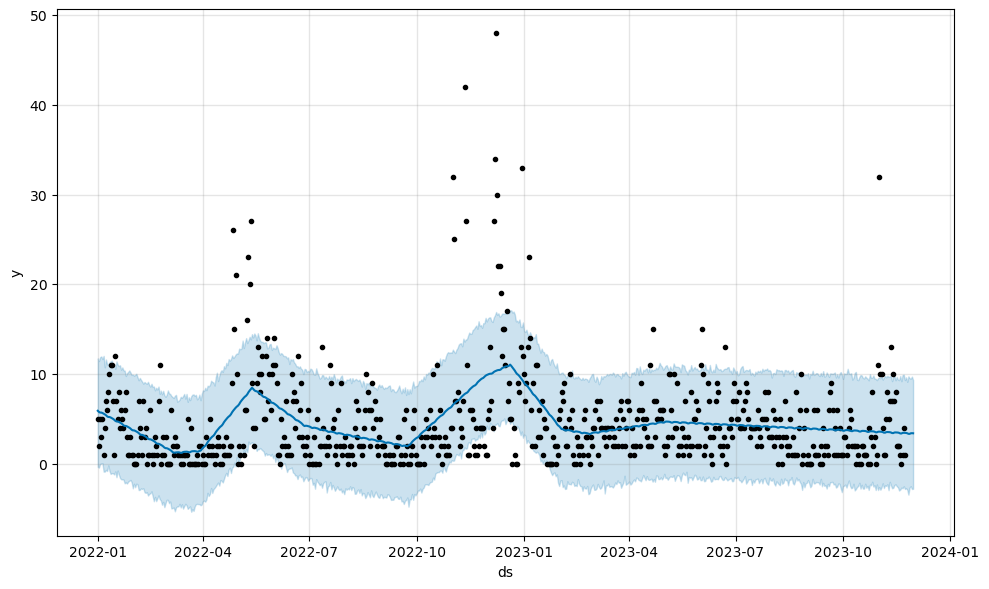

17:00:33 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
694 2023-11-26  3.314890   -3.473767    9.731983
695 2023-11-27  3.309851   -2.678166    9.513680
696 2023-11-28  3.371887   -2.529359    9.475902
697 2023-11-29  3.385135   -2.842017    9.696891
698 2023-11-30  3.374941   -2.816987    9.313686


17:00:33 - cmdstanpy - INFO - Chain [1] done processing


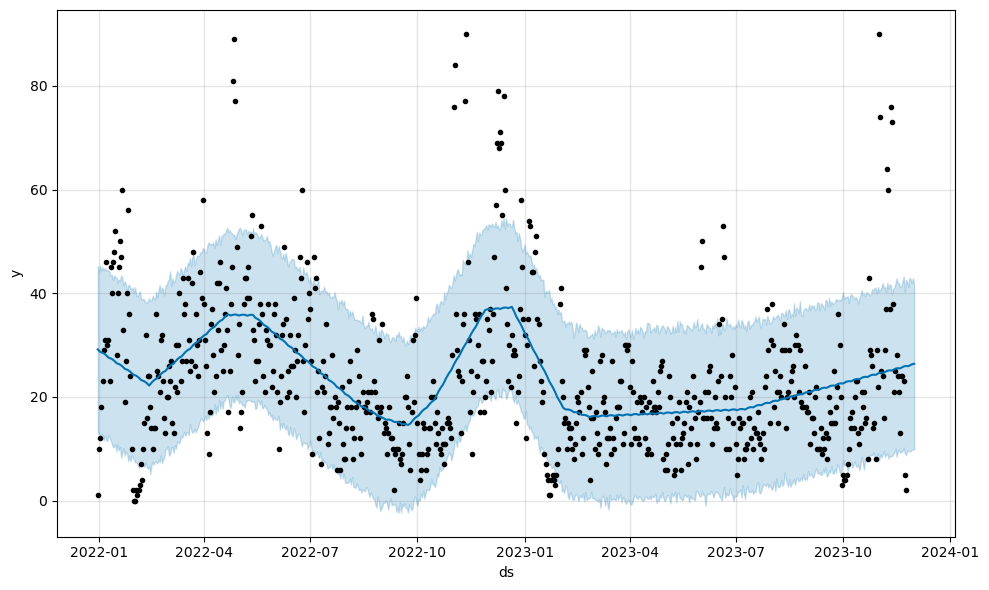

17:00:34 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
696 2023-11-27  26.043854    9.531386   42.931145
697 2023-11-28  26.182965    9.537769   42.713679
698 2023-11-29  26.288802    9.776912   42.007161
699 2023-11-30  26.337037    9.907281   42.874025
700 2023-12-01  26.384090    9.926333   41.699410


17:00:34 - cmdstanpy - INFO - Chain [1] done processing


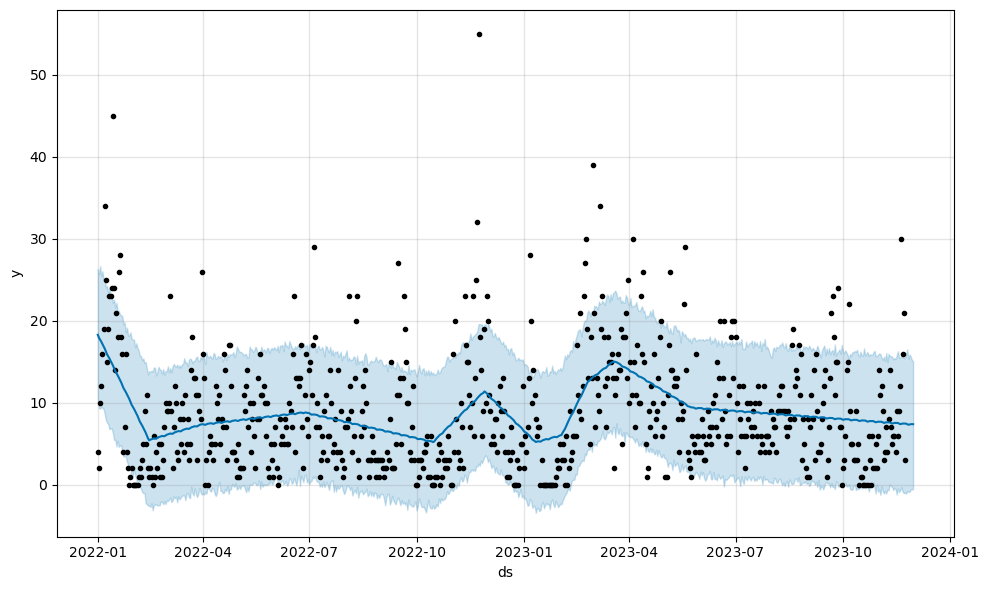

17:00:34 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
694 2023-11-26  7.322730   -0.865576   15.367366
695 2023-11-27  7.360106   -0.858327   15.896514
696 2023-11-28  7.396976   -0.590948   15.632298
697 2023-11-29  7.400755   -0.557626   15.220736
698 2023-11-30  7.393109   -0.520023   15.071139


17:00:35 - cmdstanpy - INFO - Chain [1] done processing


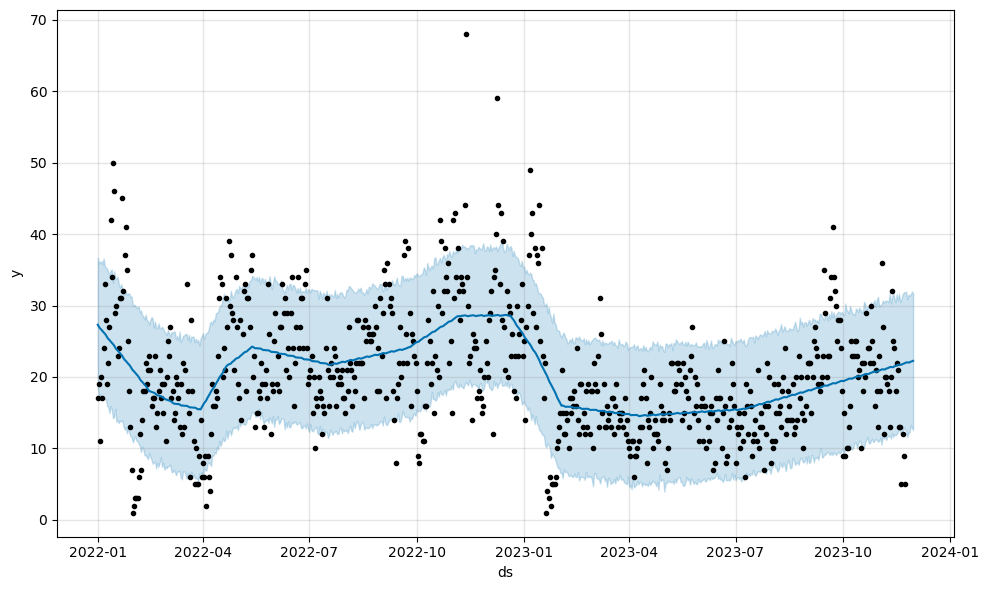

17:00:35 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  22.017781   12.178322   31.527094
695 2023-11-27  22.038350   12.225919   31.320397
696 2023-11-28  22.143855   13.305321   31.598384
697 2023-11-29  22.189829   12.860965   31.969517
698 2023-11-30  22.260301   12.582353   31.724404


17:00:35 - cmdstanpy - INFO - Chain [1] done processing


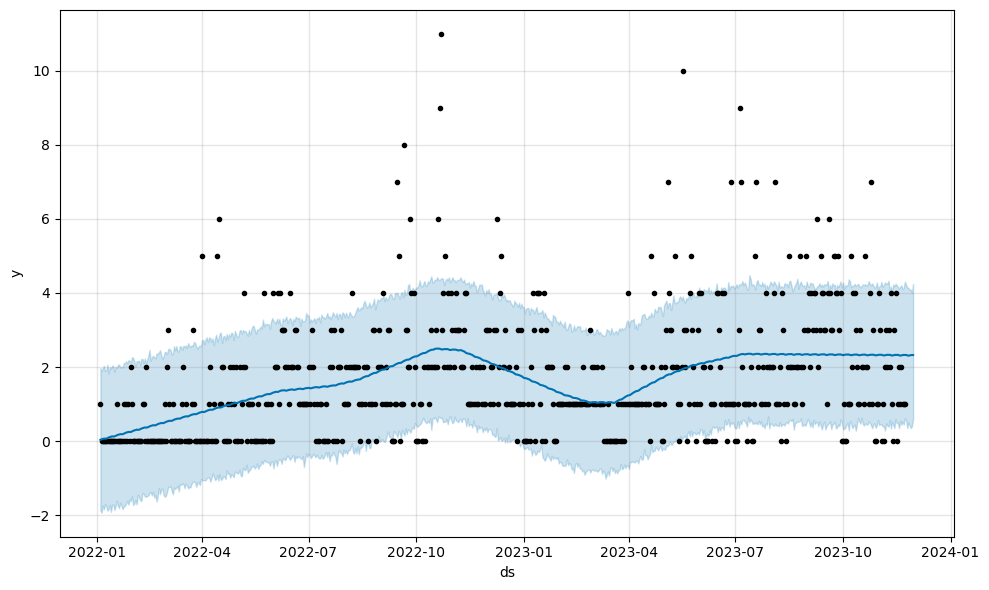

17:00:36 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
691 2023-11-26  2.306925    0.494898    4.143589
692 2023-11-27  2.313173    0.427942    4.086975
693 2023-11-28  2.319998    0.348482    4.092416
694 2023-11-29  2.324711    0.401425    4.010445
695 2023-11-30  2.322677    0.596344    4.245498


17:00:36 - cmdstanpy - INFO - Chain [1] done processing


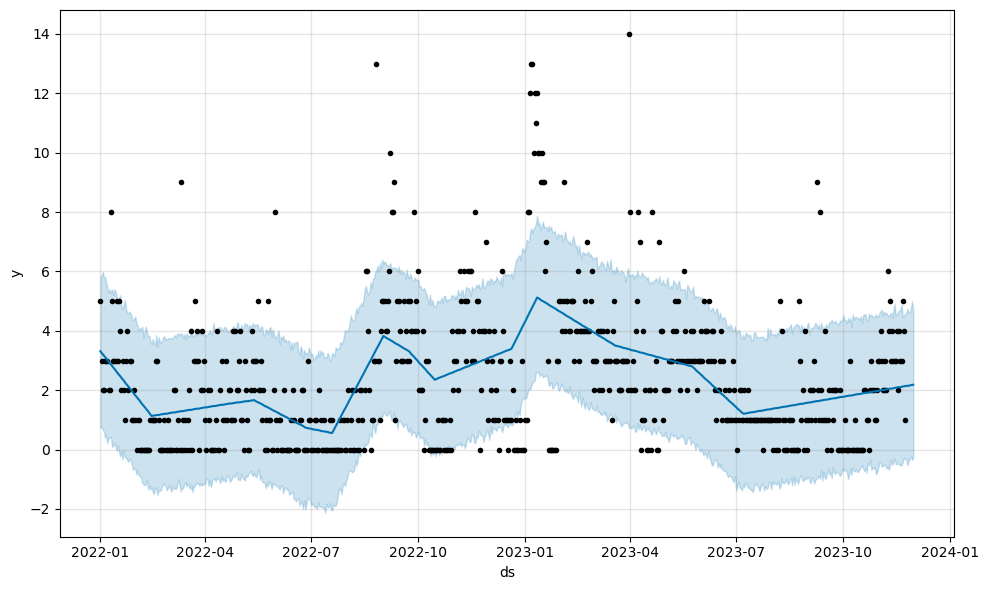

17:00:37 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
694 2023-11-26  2.148461   -0.390030    4.627430
695 2023-11-27  2.159961   -0.301949    4.603445
696 2023-11-28  2.169741   -0.240704    4.752608
697 2023-11-29  2.174882   -0.348484    4.995668
698 2023-11-30  2.183119   -0.261549    4.685998


17:00:37 - cmdstanpy - INFO - Chain [1] done processing


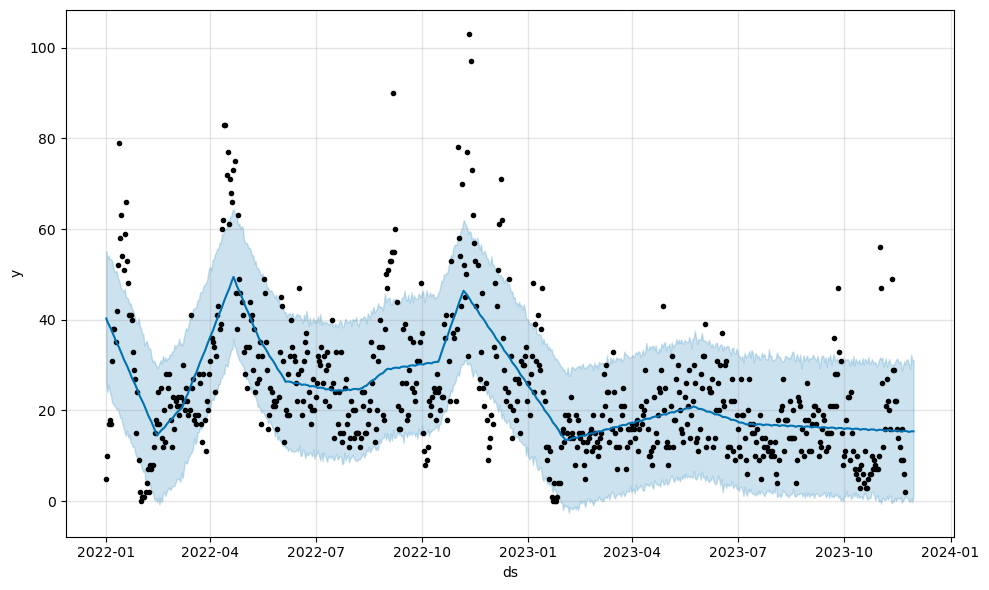

17:00:38 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  15.250600    0.049138   30.200111
695 2023-11-27  15.316667   -0.204251   29.157536
696 2023-11-28  15.403392    0.702033   32.328570
697 2023-11-29  15.414908   -0.204845   30.840755
698 2023-11-30  15.393625    1.081142   31.160506


17:00:38 - cmdstanpy - INFO - Chain [1] done processing


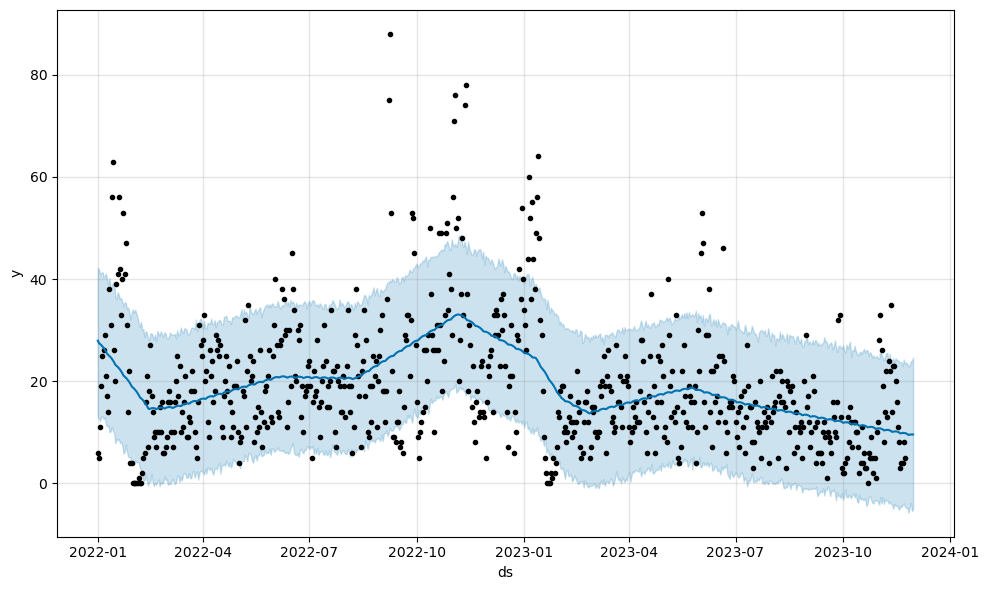

17:00:38 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
694 2023-11-26  9.457477   -5.787095   22.864392
695 2023-11-27  9.491836   -4.764861   23.018416
696 2023-11-28  9.559700   -3.821090   23.875891
697 2023-11-29  9.556810   -5.447710   23.913165
698 2023-11-30  9.542771   -5.075927   24.585338


17:00:39 - cmdstanpy - INFO - Chain [1] done processing


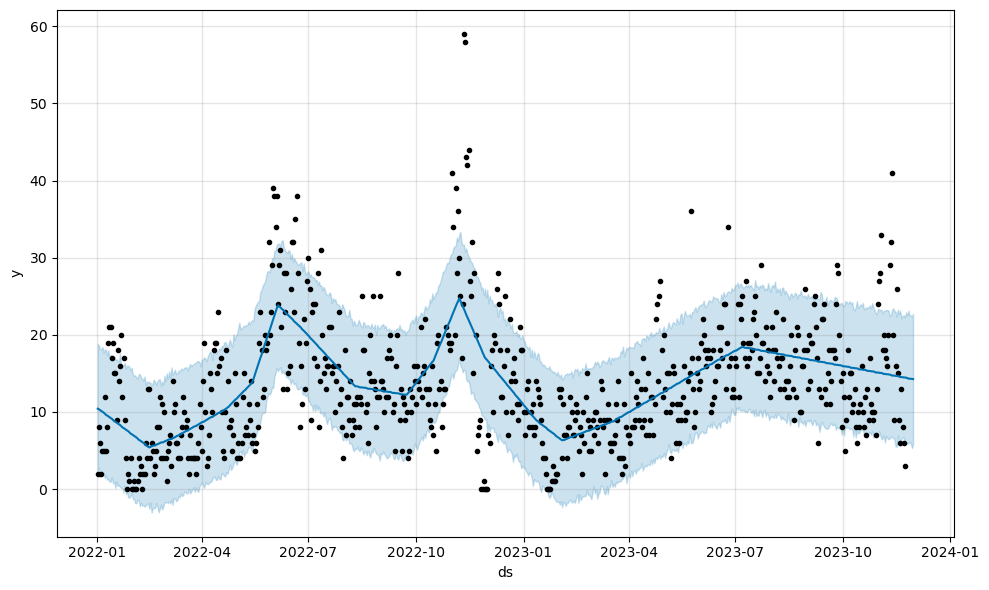

17:00:39 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
693 2023-11-26  14.314201    5.936871   23.139020
694 2023-11-27  14.322008    6.080914   22.534171
695 2023-11-28  14.299184    6.007699   22.515894
696 2023-11-29  14.281450    5.314337   22.354650
697 2023-11-30  14.258770    5.770308   22.731561


17:00:40 - cmdstanpy - INFO - Chain [1] done processing


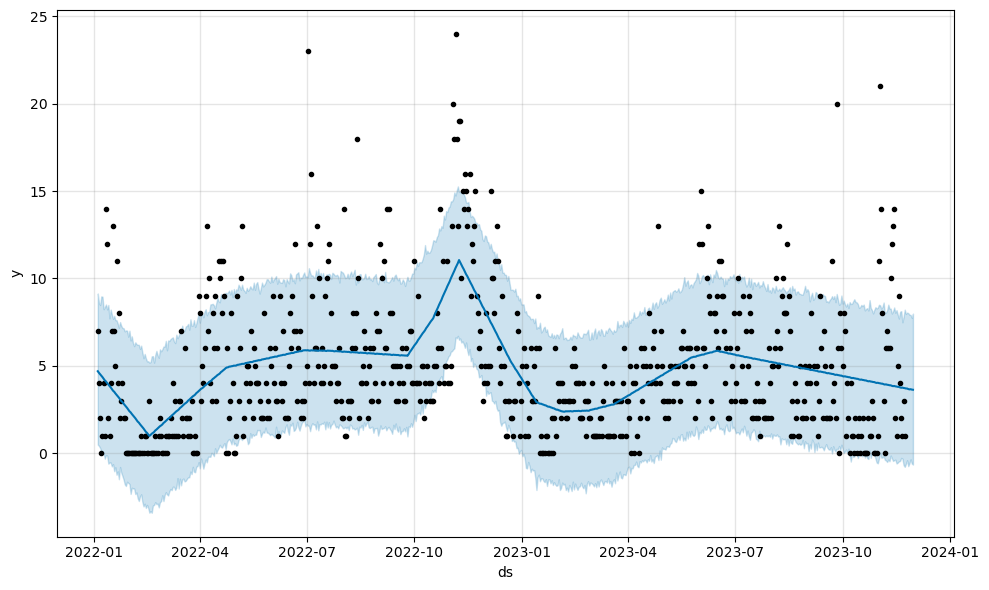

17:00:40 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
691 2023-11-26  3.669139   -0.746826    8.016254
692 2023-11-27  3.649977   -0.577466    7.922299
693 2023-11-28  3.660068   -0.357631    7.910671
694 2023-11-29  3.638318   -0.599768    7.747623
695 2023-11-30  3.628533   -0.654555    7.987969


17:00:40 - cmdstanpy - INFO - Chain [1] done processing


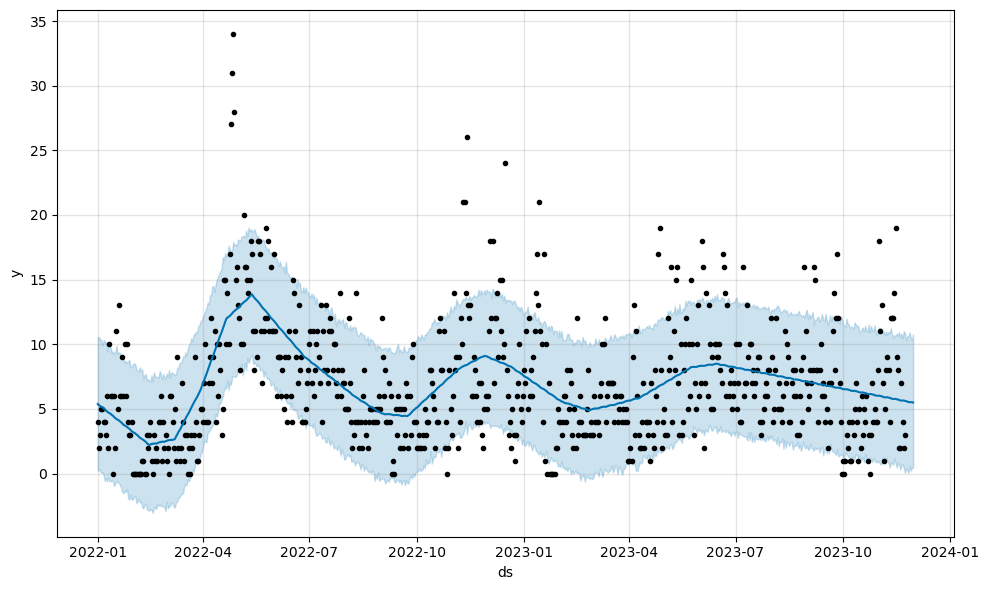

17:00:41 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
694 2023-11-26  5.528924    0.049996   10.596257
695 2023-11-27  5.521093    0.583905   10.937430
696 2023-11-28  5.521004    0.220627   10.513298
697 2023-11-29  5.525890    0.456264   10.357109
698 2023-11-30  5.495216    0.457342   10.756971


17:00:41 - cmdstanpy - INFO - Chain [1] done processing


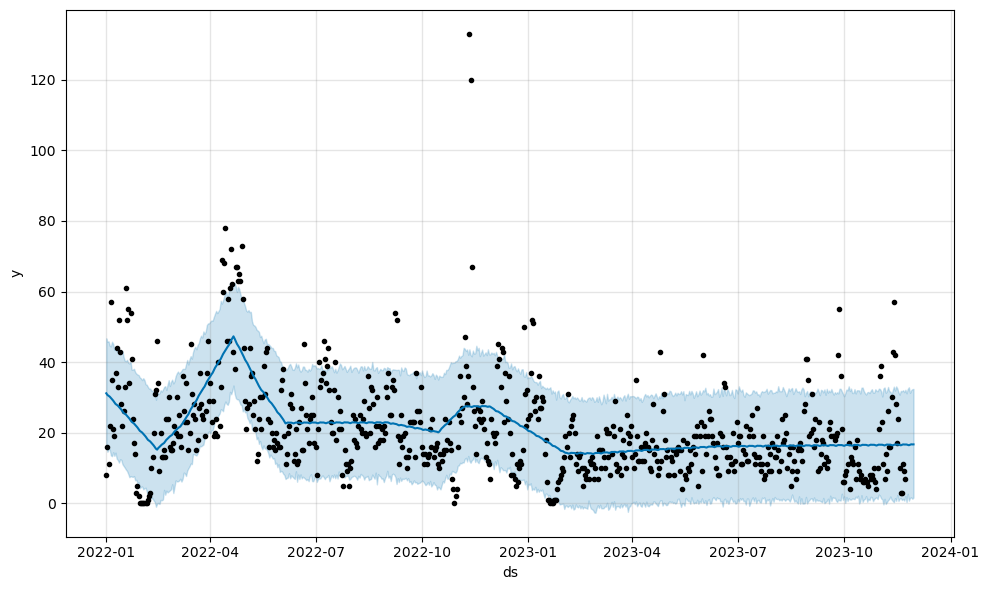

17:00:41 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  16.438190    0.712847   32.866335
695 2023-11-27  16.564471    1.502438   31.284094
696 2023-11-28  16.693833    1.664037   32.039063
697 2023-11-29  16.663303    1.258240   32.330191
698 2023-11-30  16.677557    1.620855   32.393889


17:00:42 - cmdstanpy - INFO - Chain [1] done processing


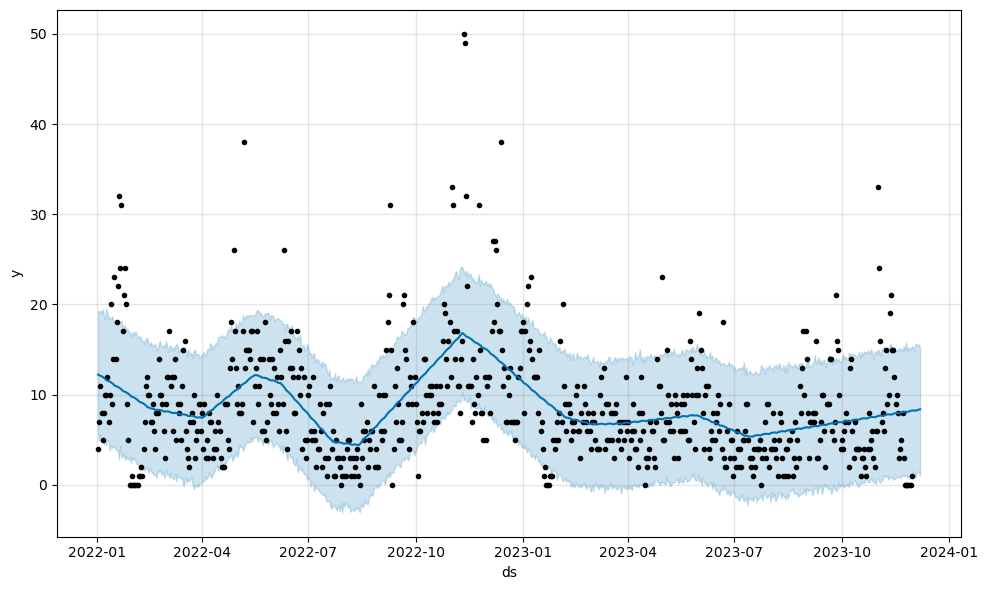

17:00:42 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
700 2023-12-03  8.206459    0.779239   15.639076
701 2023-12-04  8.234286    1.311303   15.615052
702 2023-12-05  8.306464    1.477631   15.451739
703 2023-12-06  8.340686    1.359090   15.590740
704 2023-12-07  8.376534    1.007589   15.169306


17:00:43 - cmdstanpy - INFO - Chain [1] done processing


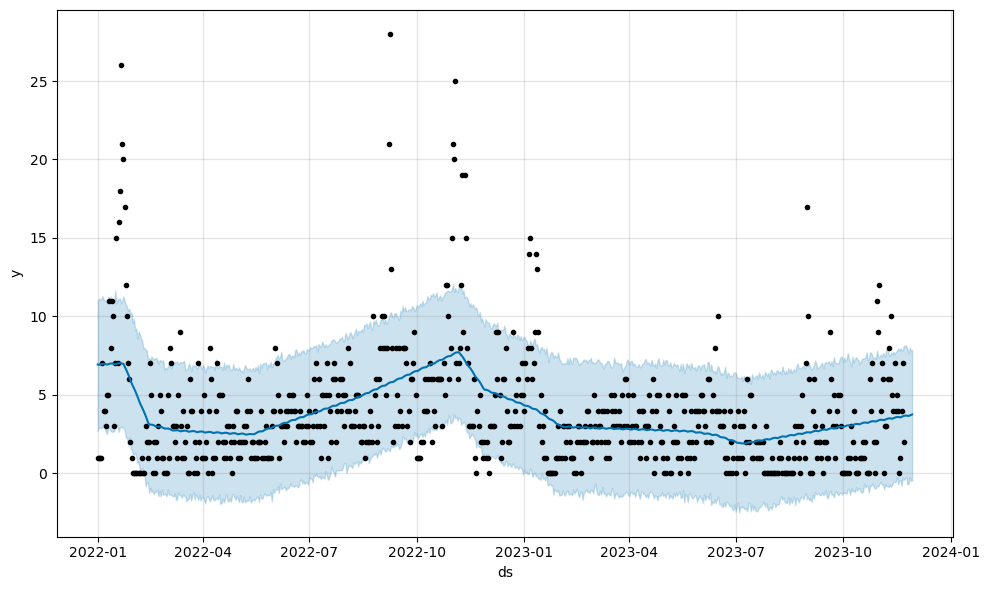

17:00:43 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
693 2023-11-25  3.665063   -0.708654    7.913639
694 2023-11-26  3.654388   -0.666338    7.641413
695 2023-11-27  3.686575   -0.221354    8.010500
696 2023-11-28  3.715177   -0.499265    7.826262
697 2023-11-29  3.746039   -0.446942    7.854713


17:00:43 - cmdstanpy - INFO - Chain [1] done processing


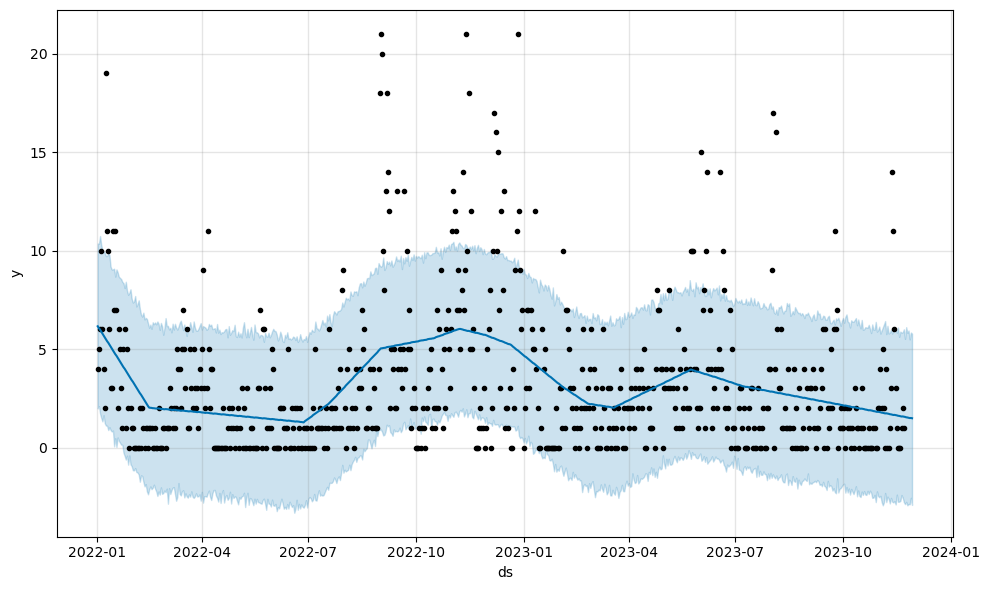

17:00:44 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
692 2023-11-25  1.525853   -2.938353    5.822766
693 2023-11-26  1.508844   -2.870371    5.941953
694 2023-11-27  1.494889   -2.883698    5.489764
695 2023-11-28  1.499565   -2.552443    5.842002
696 2023-11-29  1.486698   -2.916455    5.782945


17:00:44 - cmdstanpy - INFO - Chain [1] done processing


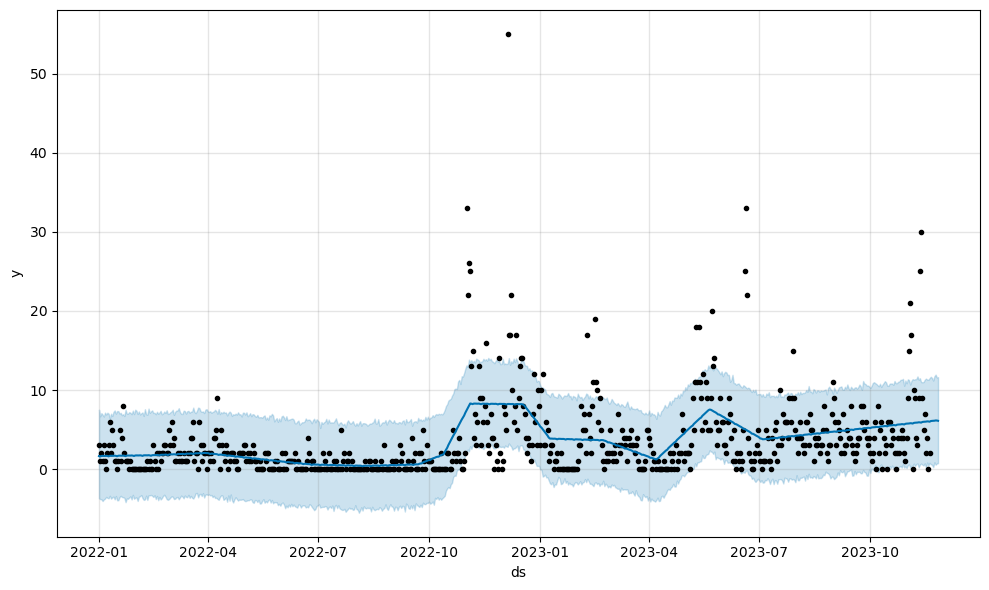

17:00:45 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
690 2023-11-22  6.115908    0.252978   11.209004
691 2023-11-23  6.131647    0.875308   11.751600
692 2023-11-24  6.162400    0.573777   11.957680
693 2023-11-25  6.155724    0.721617   11.601222
694 2023-11-26  6.120774    0.769179   11.636695


17:00:45 - cmdstanpy - INFO - Chain [1] done processing


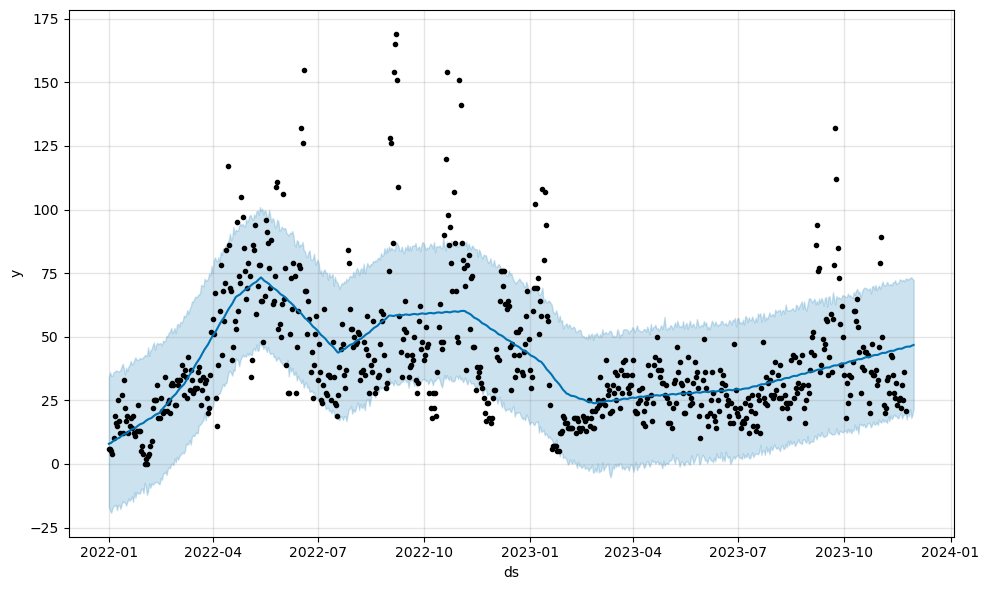

17:00:46 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  46.120361   18.774935   72.910398
695 2023-11-27  46.135562   21.544952   72.937074
696 2023-11-28  46.400517   18.069678   73.404034
697 2023-11-29  46.593807   19.311991   72.599993
698 2023-11-30  46.766987   21.761856   72.466871


17:00:46 - cmdstanpy - INFO - Chain [1] done processing


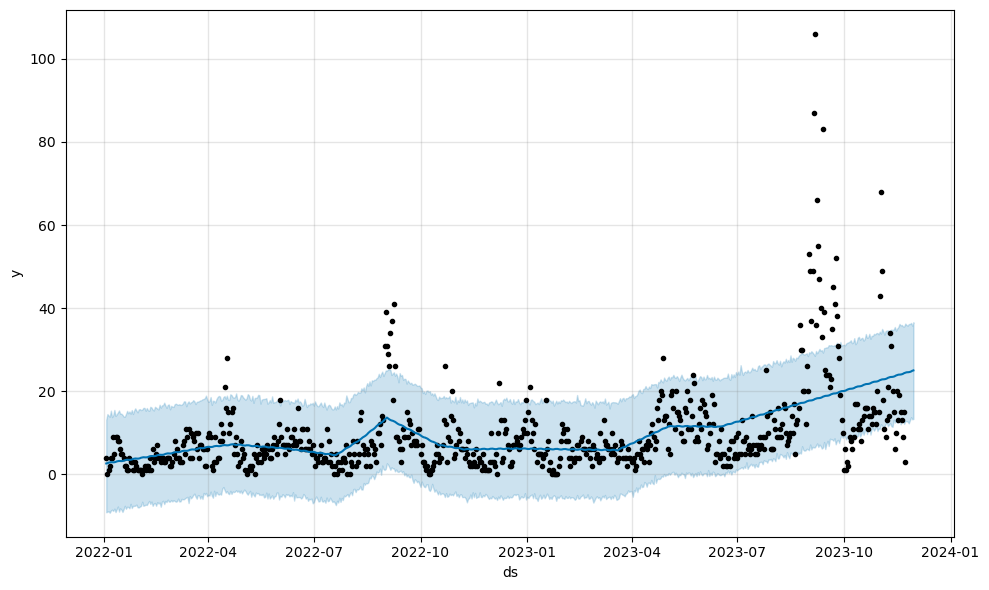

17:00:46 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
692 2023-11-26  24.585268   12.255674   36.171758
693 2023-11-27  24.643200   12.981159   36.185782
694 2023-11-28  24.749732   13.745108   36.433759
695 2023-11-29  24.916809   13.235011   35.795360
696 2023-11-30  25.006503   13.325112   36.603416


17:00:47 - cmdstanpy - INFO - Chain [1] done processing


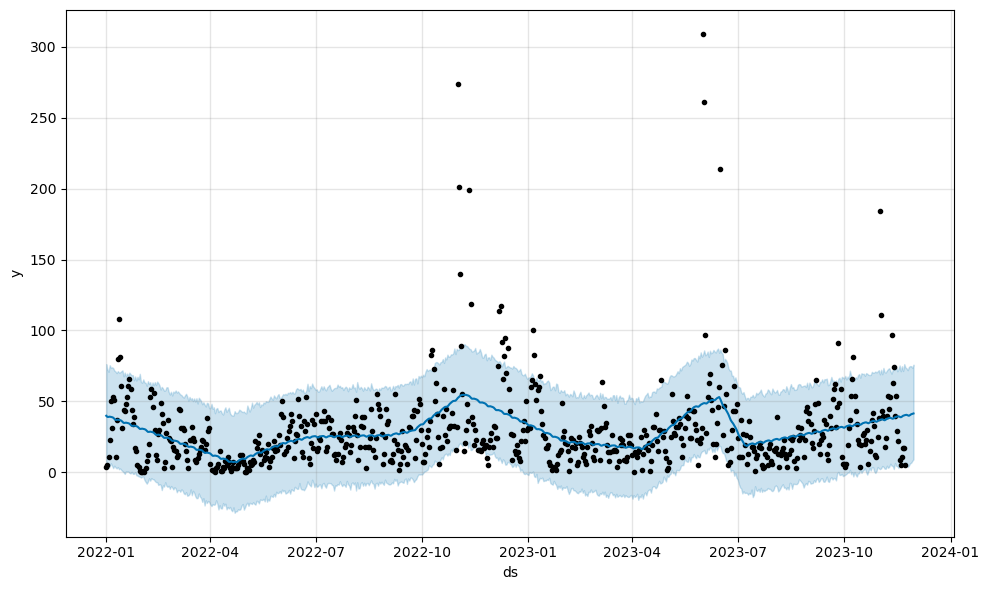

17:00:47 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  39.885059    4.732255   74.367812
695 2023-11-27  40.334741    6.298220   74.890495
696 2023-11-28  40.956127    6.795583   74.829908
697 2023-11-29  41.261968    8.144879   73.742914
698 2023-11-30  41.498643    9.210247   75.922437


17:00:47 - cmdstanpy - INFO - Chain [1] done processing


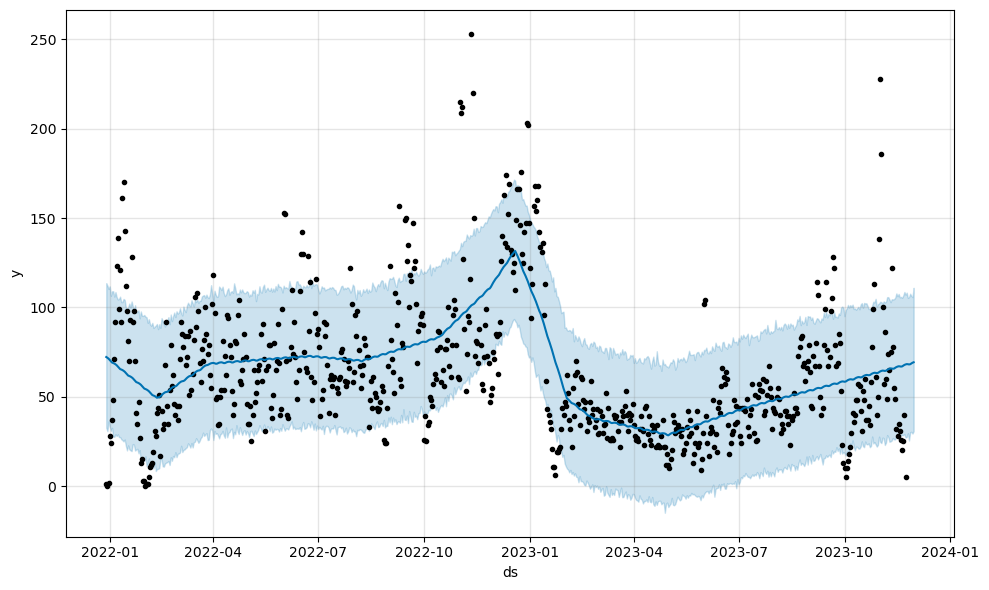

17:00:48 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
697 2023-11-26  68.099483   25.496920  105.805234
698 2023-11-27  68.212546   30.189701  107.670241
699 2023-11-28  68.647275   30.383947  106.444724
700 2023-11-29  69.043781   29.425892  105.780327
701 2023-11-30  69.307876   30.732074  110.957273


17:00:48 - cmdstanpy - INFO - Chain [1] done processing


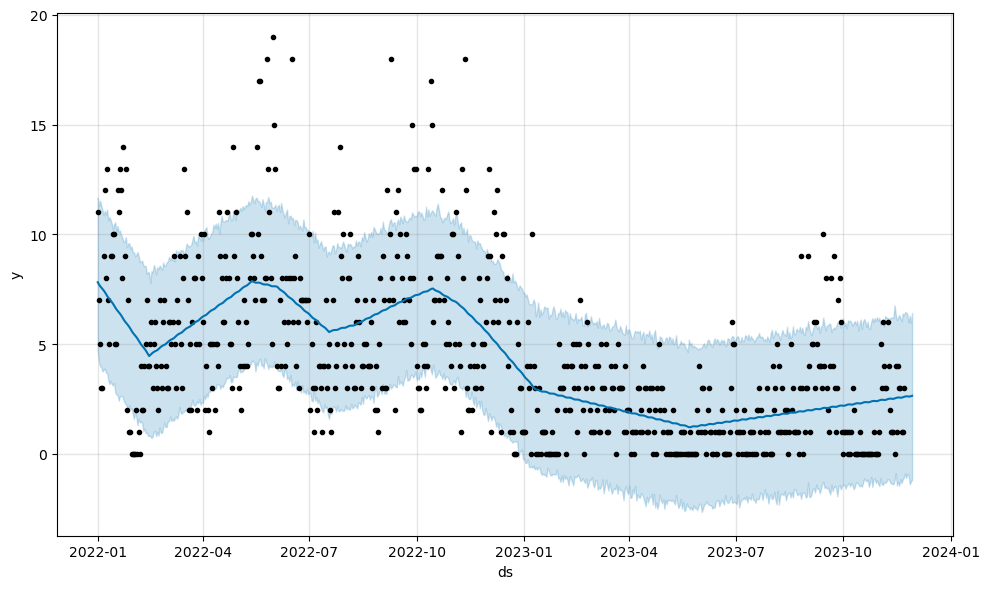

17:00:49 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
693 2023-11-25  2.626045   -0.903704    6.358027
694 2023-11-26  2.617853   -0.961416    5.988908
695 2023-11-27  2.619753   -1.377032    6.294937
696 2023-11-28  2.638792   -1.250628    5.985477
697 2023-11-29  2.654965   -1.172037    6.424095


17:00:49 - cmdstanpy - INFO - Chain [1] done processing


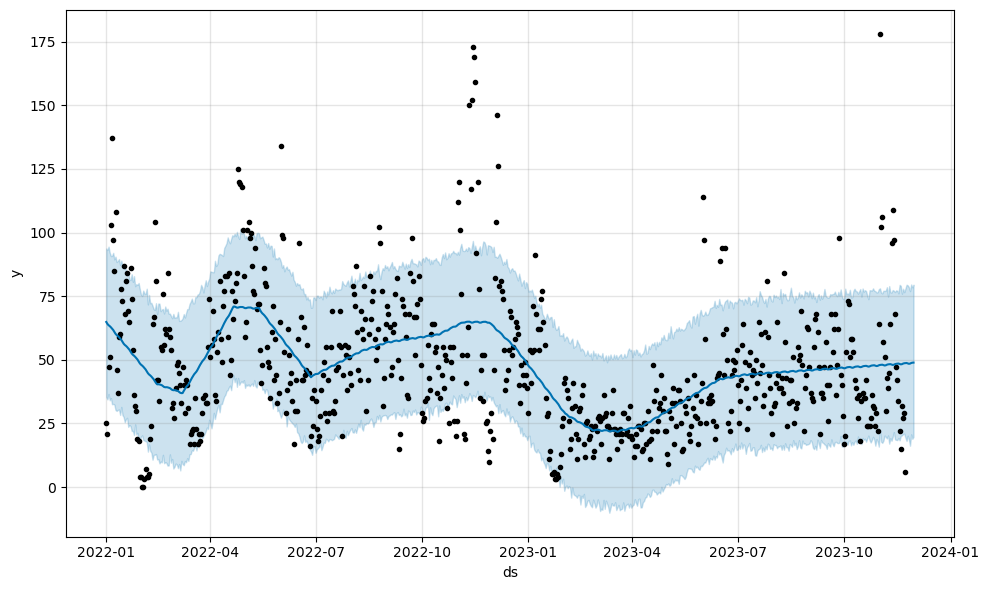

17:00:50 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  48.439936   18.698561   78.545074
695 2023-11-27  48.511493   16.248242   76.995237
696 2023-11-28  48.736393   20.725730   79.598643
697 2023-11-29  48.874322   18.950880   78.485101
698 2023-11-30  48.903462   19.726410   79.499686


17:00:50 - cmdstanpy - INFO - Chain [1] done processing


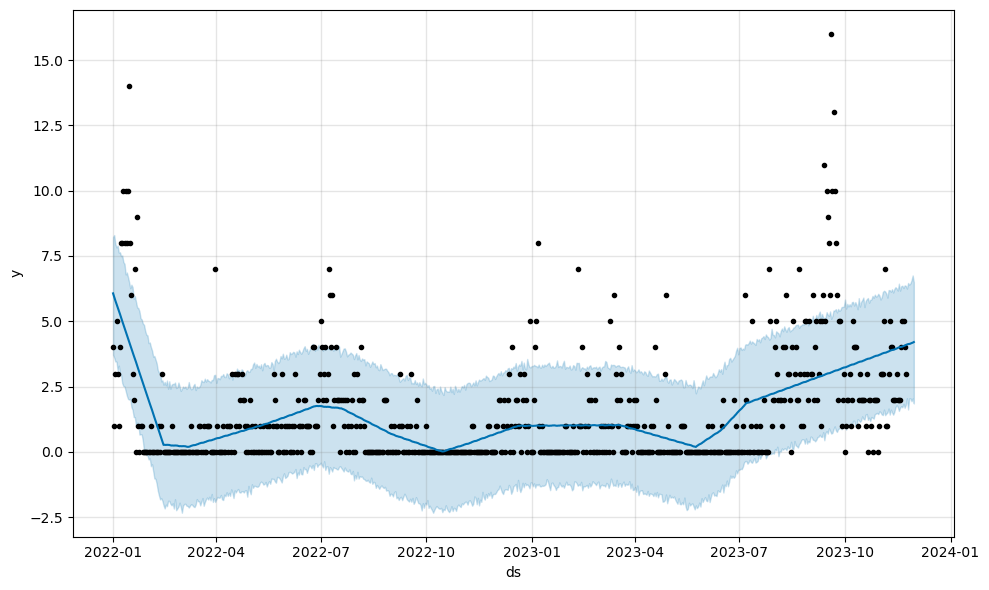

17:00:51 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
694 2023-11-26  4.133143    2.049366    6.403525
695 2023-11-27  4.143782    2.050228    6.449755
696 2023-11-28  4.166193    1.940606    6.570312
697 2023-11-29  4.181199    2.045546    6.754603
698 2023-11-30  4.205799    1.854845    6.497977


17:00:51 - cmdstanpy - INFO - Chain [1] done processing


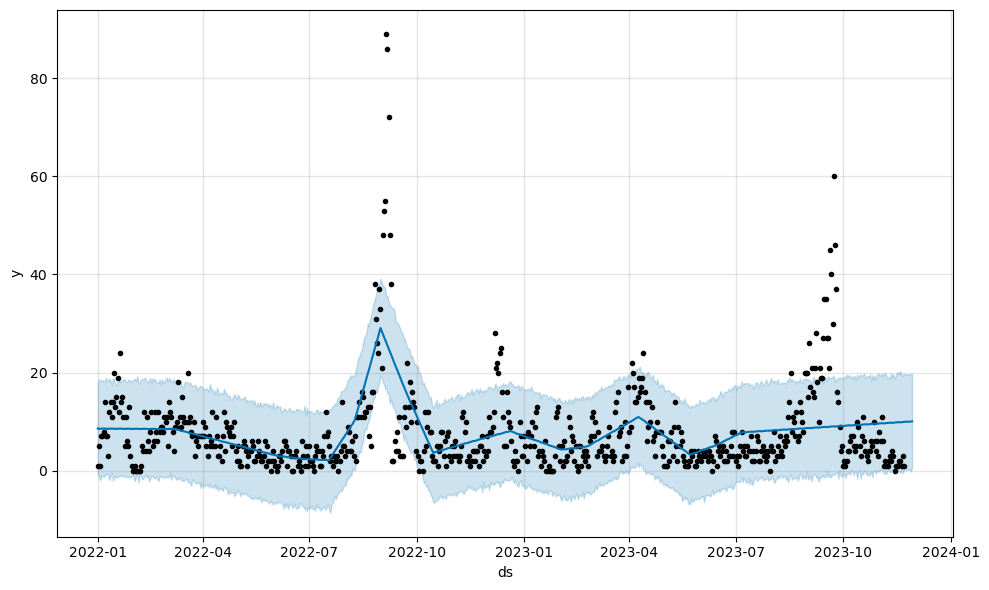

17:00:52 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
693 2023-11-25  10.020725    0.218246   19.489159
694 2023-11-26   9.967495    0.315078   19.689226
695 2023-11-27  10.003549    0.267274   19.603216
696 2023-11-28  10.059168   -0.125778   19.753712
697 2023-11-29  10.079427    0.771738   19.706909


17:00:52 - cmdstanpy - INFO - Chain [1] done processing


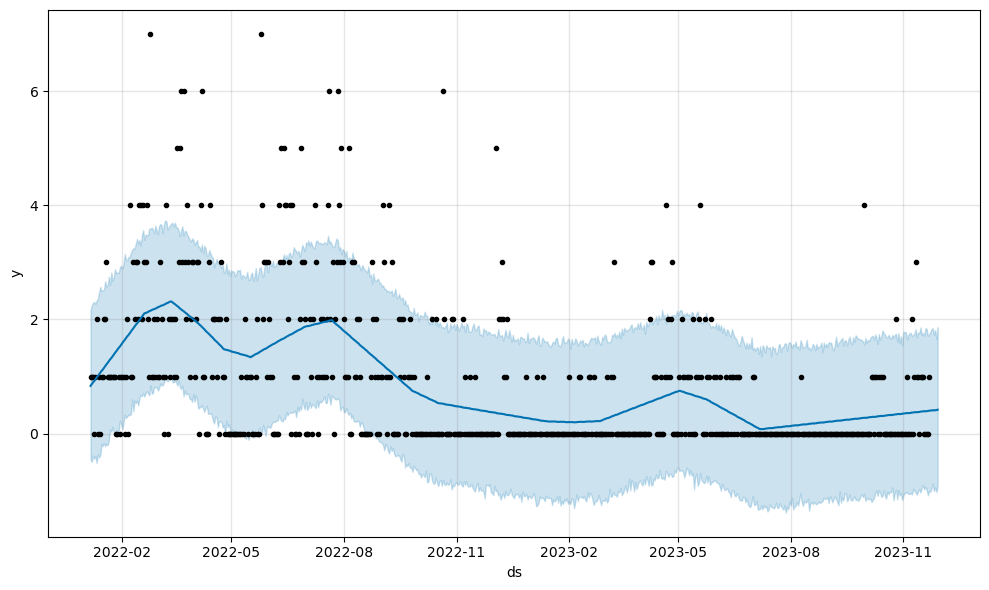

17:00:52 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
688 2023-11-25  0.409966   -0.875146    1.848062
689 2023-11-26  0.406266   -1.006299    1.733158
690 2023-11-27  0.410357   -0.938829    1.815790
691 2023-11-28  0.411848   -1.023959    1.661071
692 2023-11-29  0.418530   -0.918757    1.863350


17:00:53 - cmdstanpy - INFO - Chain [1] done processing


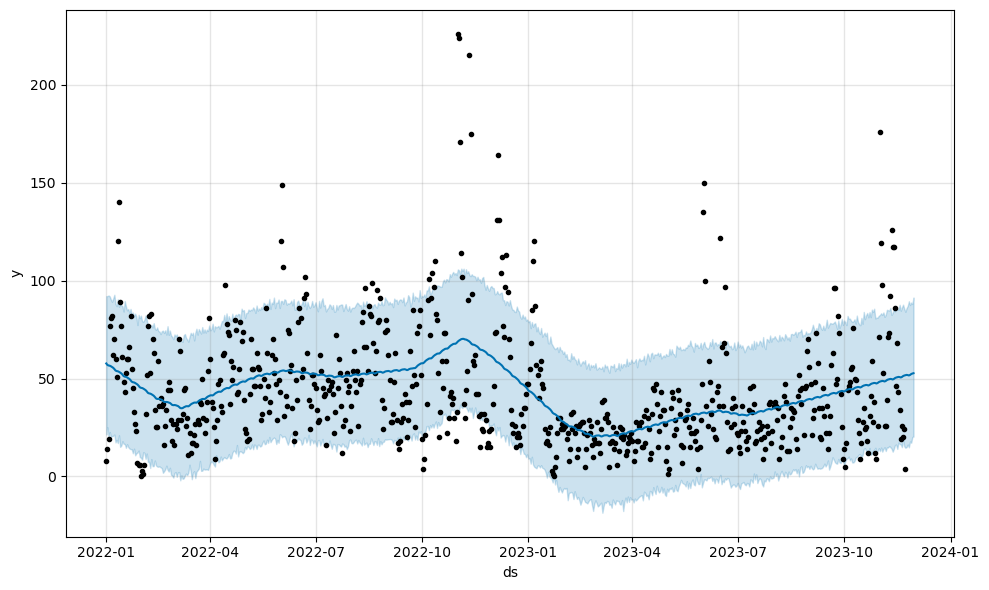

17:00:53 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  51.565172   14.835357   89.468657
695 2023-11-27  51.829759   17.849074   87.539806
696 2023-11-28  52.272042   17.179385   88.830697
697 2023-11-29  52.552124   20.143781   88.084740
698 2023-11-30  52.704494   20.379294   91.388684


17:00:53 - cmdstanpy - INFO - Chain [1] done processing


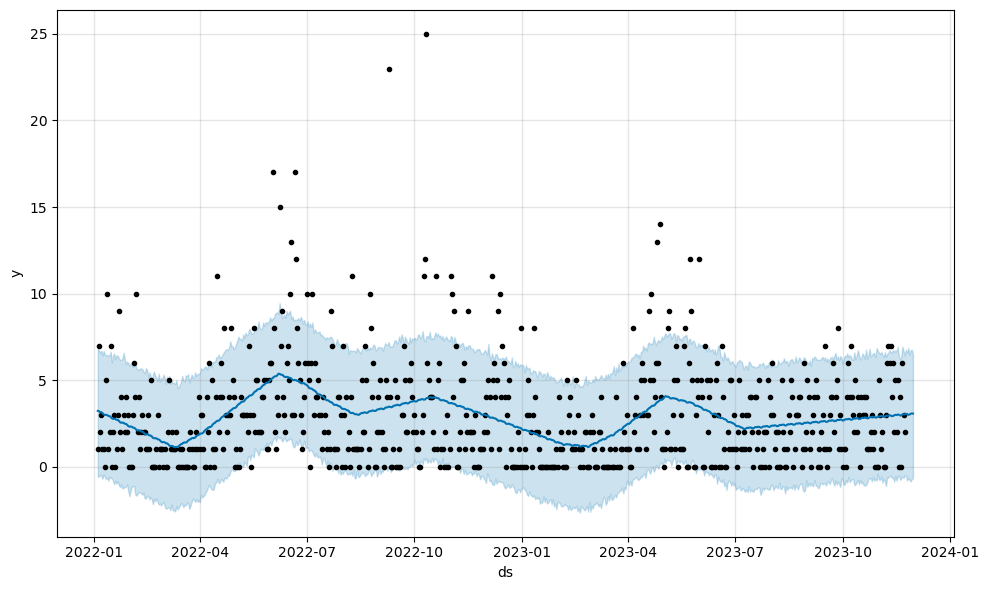

17:00:54 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
691 2023-11-26  3.000077   -0.658482    6.865682
692 2023-11-27  3.005698   -0.758596    6.454443
693 2023-11-28  3.055025   -0.857566    6.732334
694 2023-11-29  3.076419   -0.722751    6.757327
695 2023-11-30  3.066359   -0.667893    6.485743


17:00:54 - cmdstanpy - INFO - Chain [1] done processing


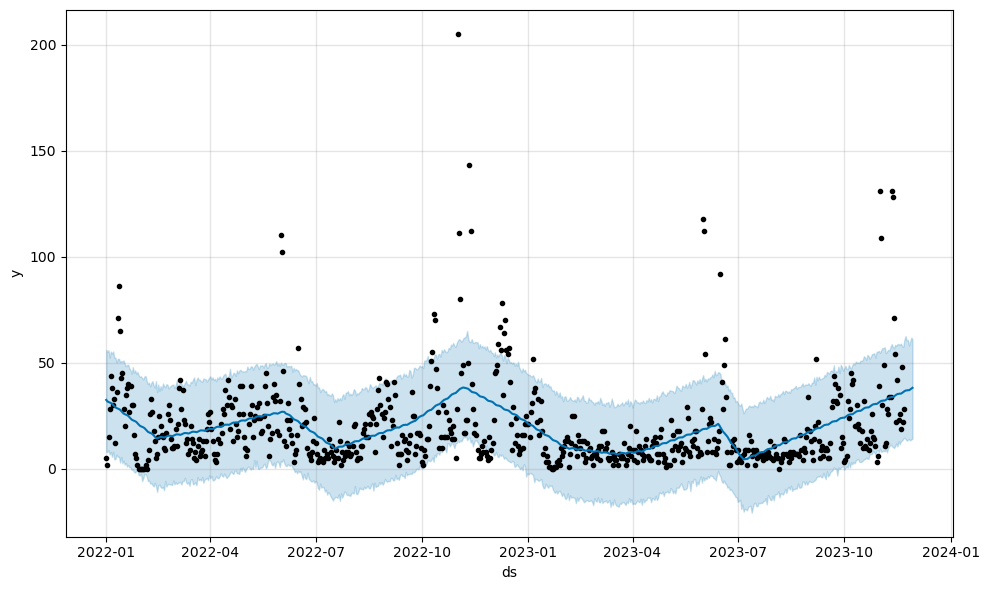

17:00:55 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
693 2023-11-25  37.096340   13.717835   60.826752
694 2023-11-26  37.056256   13.986019   58.127150
695 2023-11-27  37.403197   13.426425   60.044569
696 2023-11-28  37.829147   13.903924   61.872637
697 2023-11-29  38.200047   14.160900   61.031258


17:00:55 - cmdstanpy - INFO - Chain [1] done processing


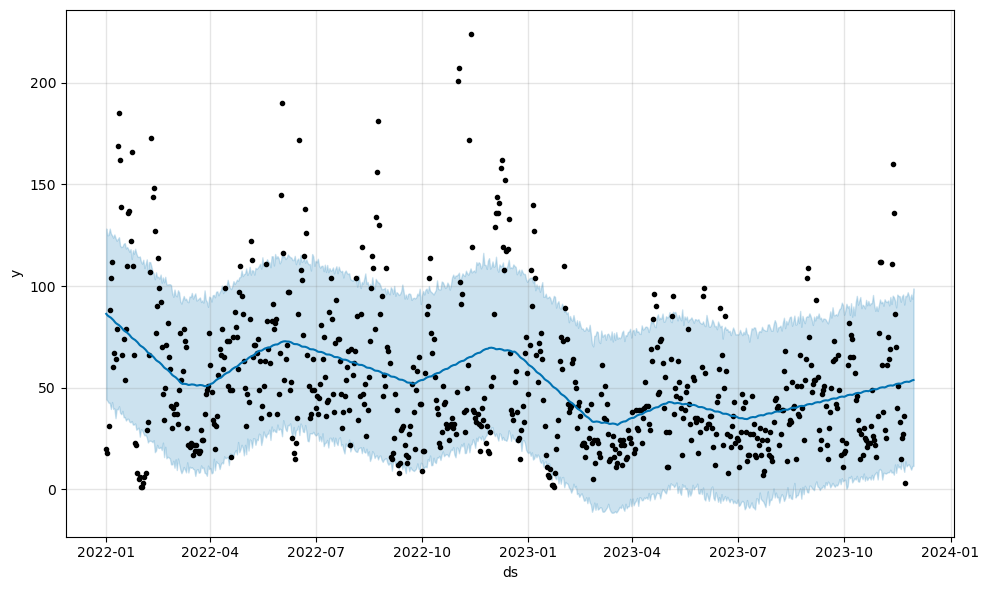

17:00:55 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  52.823053   12.222369   95.170157
695 2023-11-27  53.032693   11.047602   92.638529
696 2023-11-28  53.335581    9.652466   95.799376
697 2023-11-29  53.610538   11.430395   93.756319
698 2023-11-30  53.743658   11.530697   98.825550


17:00:56 - cmdstanpy - INFO - Chain [1] done processing


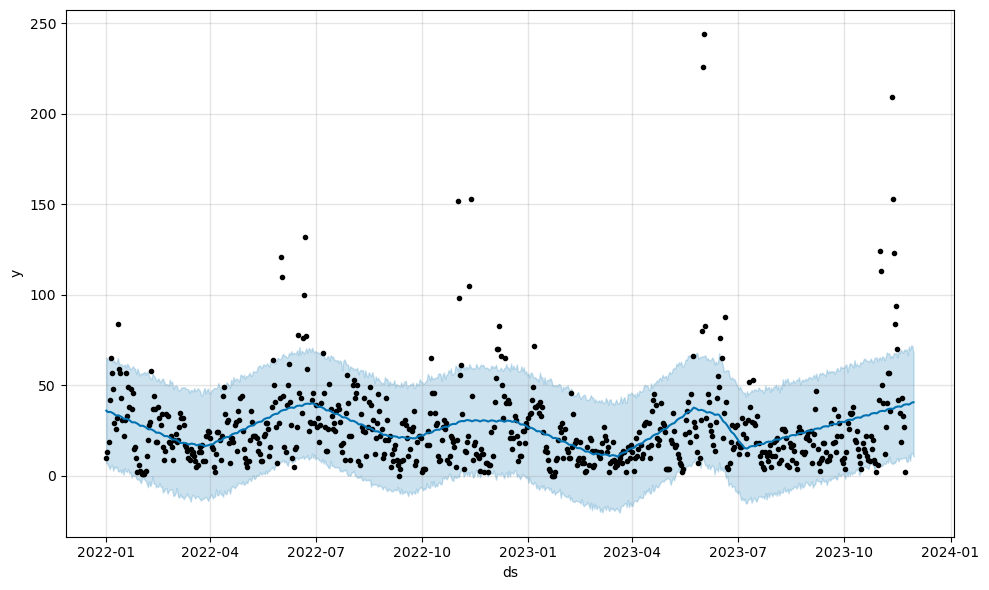

17:00:56 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  39.394340   11.586284   71.519421
695 2023-11-27  39.715630    8.255759   69.590521
696 2023-11-28  40.234637   12.754177   72.027623
697 2023-11-29  40.566660   12.662007   71.757688
698 2023-11-30  40.668289   10.749916   67.912591


17:00:56 - cmdstanpy - INFO - Chain [1] done processing


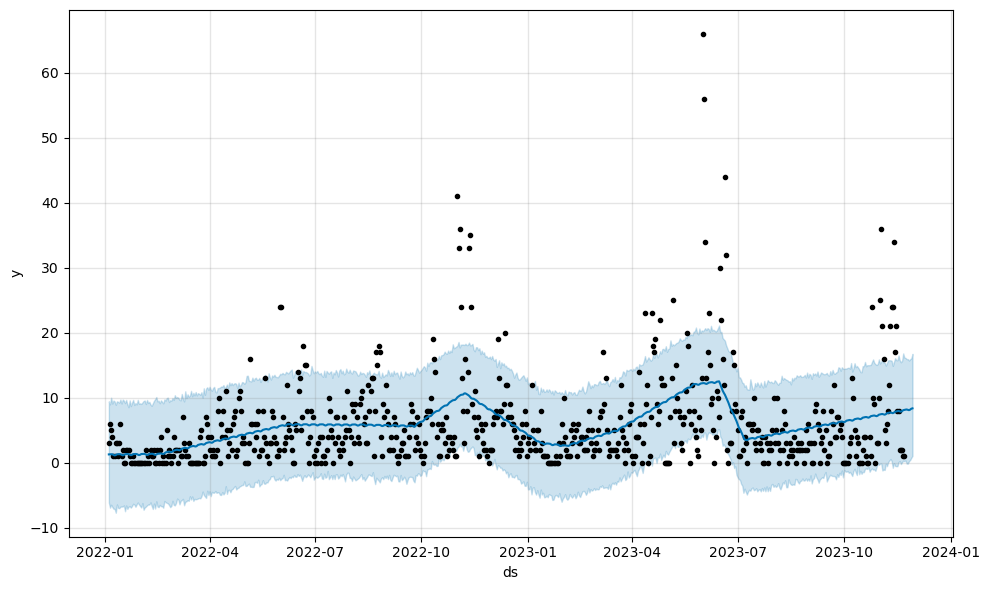

17:00:57 - cmdstanpy - INFO - Chain [1] start processing


            ds      yhat  yhat_lower  yhat_upper
690 2023-11-25  8.134479   -0.144158   15.940727
691 2023-11-26  8.080587    0.237000   15.728878
692 2023-11-27  8.163509    0.409520   15.922060
693 2023-11-28  8.308343    0.750426   16.088185
694 2023-11-29  8.357718    1.047823   16.748024


17:00:57 - cmdstanpy - INFO - Chain [1] done processing


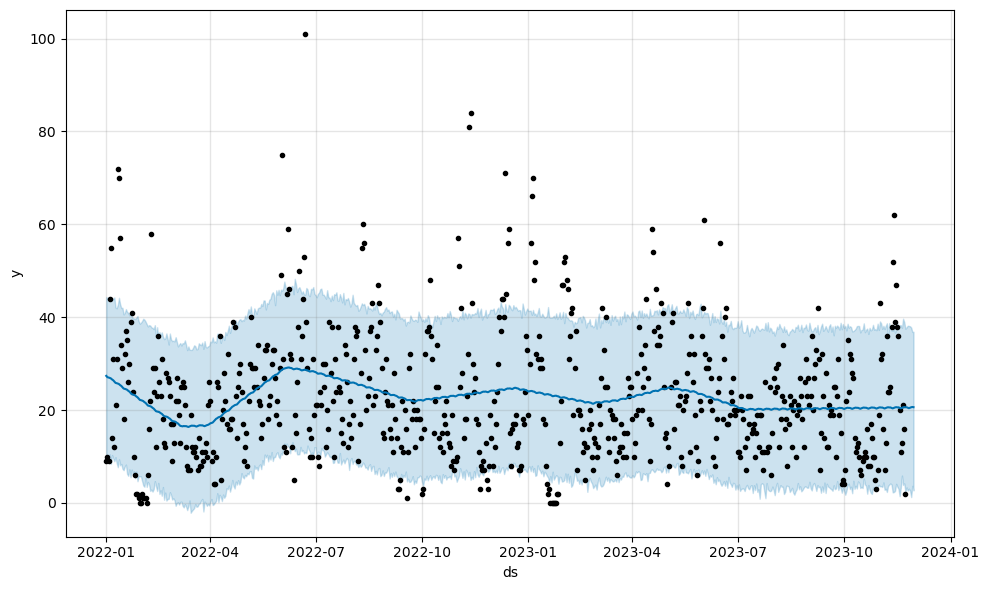

17:00:58 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  20.411224    3.078458   38.120900
695 2023-11-27  20.510783    2.655073   38.054156
696 2023-11-28  20.612867    1.267838   37.776830
697 2023-11-29  20.676526    3.689881   36.831655
698 2023-11-30  20.629343    2.705026   36.869871


17:00:58 - cmdstanpy - INFO - Chain [1] done processing


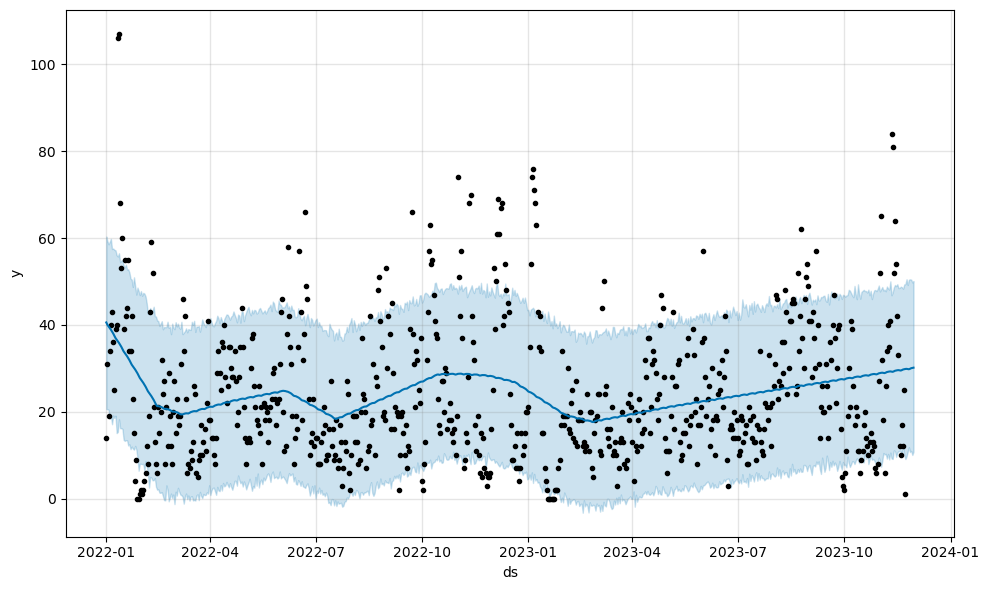

17:00:59 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  29.788825   11.823951   50.405871
695 2023-11-27  29.894683   10.710724   50.498524
696 2023-11-28  30.029500   10.992853   50.431764
697 2023-11-29  30.095894   10.050555   49.782522
698 2023-11-30  30.148716   10.808241   50.109204


17:00:59 - cmdstanpy - INFO - Chain [1] done processing


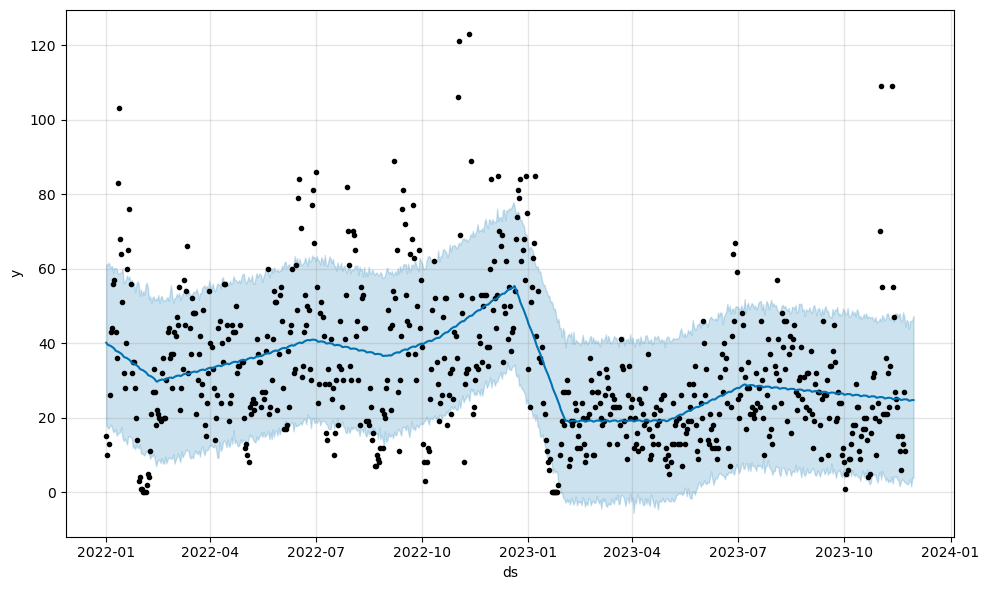

17:00:59 - cmdstanpy - INFO - Chain [1] start processing


            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  24.571850    2.752405   43.800239
695 2023-11-27  24.582360    3.600215   46.008468
696 2023-11-28  24.687689    1.556434   45.953494
697 2023-11-29  24.750136    3.987713   46.207795
698 2023-11-30  24.731600    3.835486   47.272861


17:01:00 - cmdstanpy - INFO - Chain [1] done processing


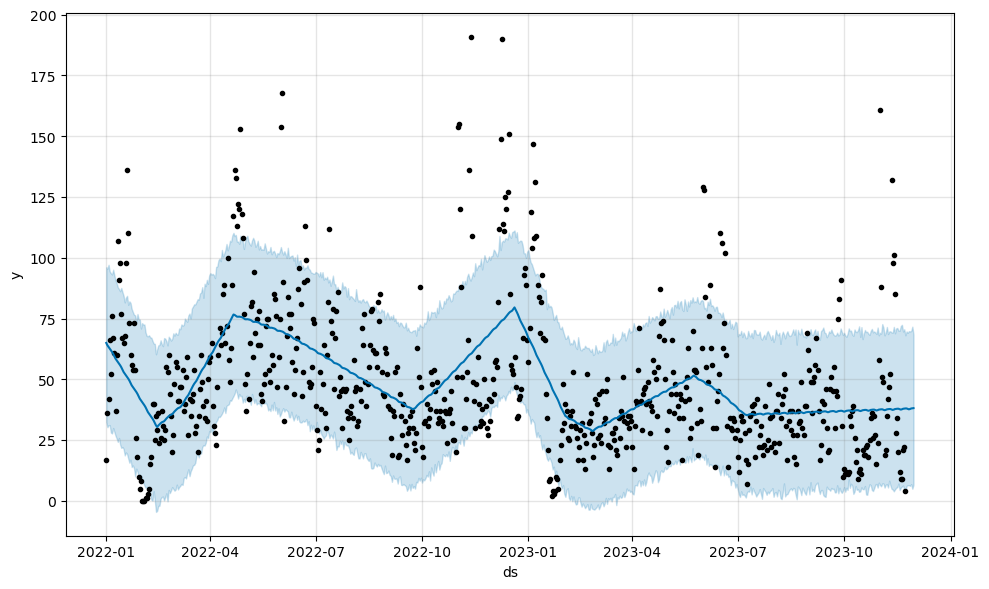

            ds       yhat  yhat_lower  yhat_upper
694 2023-11-26  37.664603    6.456336   69.833837
695 2023-11-27  37.800613    6.165490   69.719165
696 2023-11-28  38.011505    6.883414   69.874172
697 2023-11-29  38.094123    4.977235   71.670373
698 2023-11-30  38.148778    6.640865   68.436004


In [51]:
# TEST 
# use prophet to predict the data in ndf_gp_list
from prophet import Prophet

for idx, group in enumerate(df_gp_list):
    # continue when the number of rows in group is less than 10
    if len(group) < 10:
        continue
        
    m = Prophet(seasonality_prior_scale=0.001,changepoint_prior_scale=0.9)
    m.fit(group)
    future = m.make_future_dataframe(periods=7)
    forecast = m.predict(future)
    
    
    # plot in a small window
    m.plot(forecast)
    plt.savefig('./figs/{}.png'.format(idx))
    plt.show()
    print(forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail())

In [52]:
hot_season_valid = pd.to_datetime('2023-06-05')
df_hot = df[df['plan_in_load_time'] < hot_season_valid]

# generate a new dataframe which is groupby df by the columns 'start_city_id'
df_hot_gp = df_hot.groupby(['start_city_id'])
df_hot_gp

In [53]:
# transfer the groupby object to a list of small dataframes
df_hot_gp_list = []

for _, group in df_hot_gp:
    
    start_city_id = group['start_city_id'].values[0]
    print(group['start_city_id'].values[0])
    
    # rename the column 'plan_in_load_time' of group to 'y'
    group = group.rename(columns={'plan_in_load_time': 'y'})
    
    # NEW DATAFRAME
    # get the column 'y' and 'is_success' of group
    group['is_success'] = 1
    group = group[['y', 'is_success']]
    
    # group by 'y'
    group = group.groupby('y').sum()
    group = group[['is_success']]
    
    # NEW FORMAT
    # rename the column 'is_success' to 'y' and the index to 'ds'
    group = group.rename(columns={'is_success': 'y'})
    group.index.name = 'ds'
    
    # fill the missing days in group using the value 0
    group.index = pd.to_datetime(group.index)
    group = group.resample('D').sum()
    group = group.fillna(0)

    # set a new column 'ds' which is the index of group
    group['ds'] = group.index
    
    group['start_city_id'] = start_city_id
    
    # add group to df_hot_gp_list
    df_hot_gp_list.append(group)
    
df_hot_gp_list

37
40
41
49
52
53
58
60
62
76
77
78
79
80
82
83
84
87
94
95
97
107
111
116
119
138
139
140
143
144
147
149
150
160
164
165
167
180
182
186
194
197
201
220
221
222
223
224
225
226
227
228
229
230
231
232
233
235
244
245
258
283
284
286
288
289
292
296
297
300
304
311
318
321
322
327
343
351
367
378
383
384
385
386
388
389
390
391
394
3401


[             y         ds  start_city_id
 ds                                      
 2022-01-01   2 2022-01-01             37
 2022-01-02   4 2022-01-02             37
 2022-01-03   3 2022-01-03             37
 2022-01-04   9 2022-01-04             37
 2022-01-05   8 2022-01-05             37
 ...         ..        ...            ...
 2023-05-31   8 2023-05-31             37
 2023-06-01  11 2023-06-01             37
 2023-06-02  21 2023-06-02             37
 2023-06-03  15 2023-06-03             37
 2023-06-04  13 2023-06-04             37
 
 [520 rows x 3 columns],
              y         ds  start_city_id
 ds                                      
 2022-01-01  20 2022-01-01             40
 2022-01-02   5 2022-01-02             40
 2022-01-03   0 2022-01-03             40
 2022-01-04   2 2022-01-04             40
 2022-01-05   1 2022-01-05             40
 ...         ..        ...            ...
 2023-05-31   7 2023-05-31             40
 2023-06-01  12 2023-06-01             40
 2023-0

In [54]:
df_hot_valid = df[df['plan_in_load_time'] >= hot_season_valid]
df_hot_valid = df_hot_valid[df_hot_valid['plan_in_load_time'] < (hot_season_valid + pd.Timedelta(days=7))]
df_hot_valid

,ordersn,model_type_name,customer_id,is_success,start_city_name,end_city_name,start_city_id,end_city_id,order_time,plan_in_load_time
116,13060905376395,zc,238953,0,金华,咸阳,386,318,2023-06-09 10:19:19,2023-06-09
152,330606553182934,zc,140817,0,南京,孝感,220,194,2023-06-06 19:54:28,2023-06-06
329,430610053922246,zc,370827,0,揭阳,金华,84,386,2023-06-10 07:31:50,2023-06-10
354,530606093207893,zc,196646,0,成都,昆明,322,367,2023-06-06 14:55:35,2023-06-07
358,43060905381095,zc,328658,0,廊坊,呼和浩特,144,258,2023-06-09 13:45:33,2023-06-09
...,...,...,...,...,...,...,...,...,...,...
1056312,53060555284855,ka,274398,1,东莞,德阳,79,327,2023-06-05 10:39:24,2023-06-05
1056313,730607053221039,ka,274398,0,东莞,武汉,79,180,2023-06-07 06:20:20,2023-06-07
1056314,630609553716010,ka,100325,1,徐州,成都,229,322,2023-06-09 09:14:04,2023-06-09
1056388,430607053349622,ka,246704,1,南昌,赣州,233,235,2023-06-07 14:07:07,2023-06-08


17:01:01 - cmdstanpy - INFO - Chain [1] start processing
17:01:01 - cmdstanpy - INFO - Chain [1] done processing


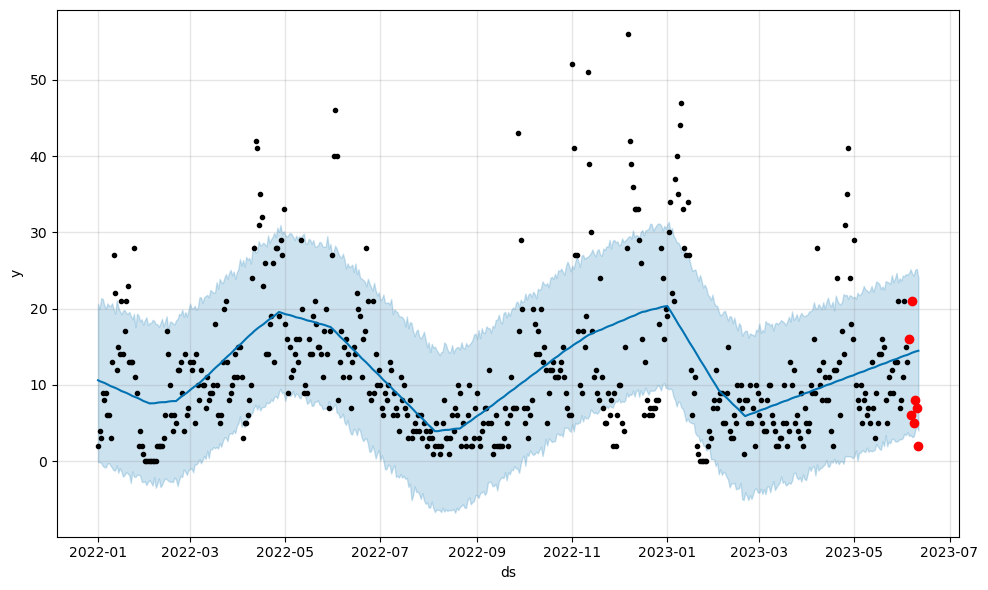

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  14.216865    3.164933   24.586710
523 2023-06-08  14.294567    3.233605   24.317715
524 2023-06-09  14.363779    4.058069   25.099913
525 2023-06-10  14.423742    4.644102   25.199313
526 2023-06-11  14.478038    4.018582   24.078353
[16  6 21  5  8  7  2]
---
[14.03337865 14.13407895 14.21686475 14.2945667  14.36377896 14.42374203
 14.47803774]
SMAPE: 0.7234674348953155


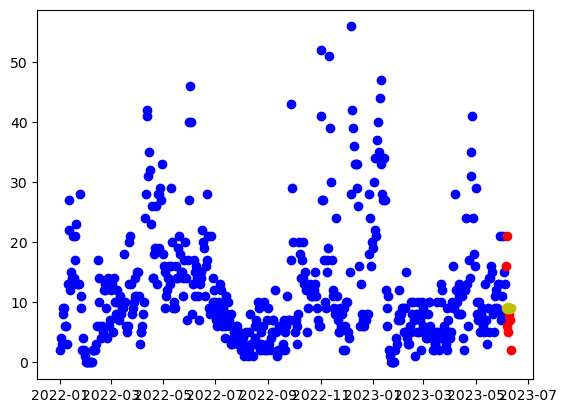

17:01:02 - cmdstanpy - INFO - Chain [1] start processing


[16  6 21  5  8  7  2]
---
[9.11472978 8.98553103 9.05057988 9.18398617 9.15384342 8.87655061
 9.07647801]
SMAPE_lr: 0.5686681625278304


17:01:02 - cmdstanpy - INFO - Chain [1] done processing


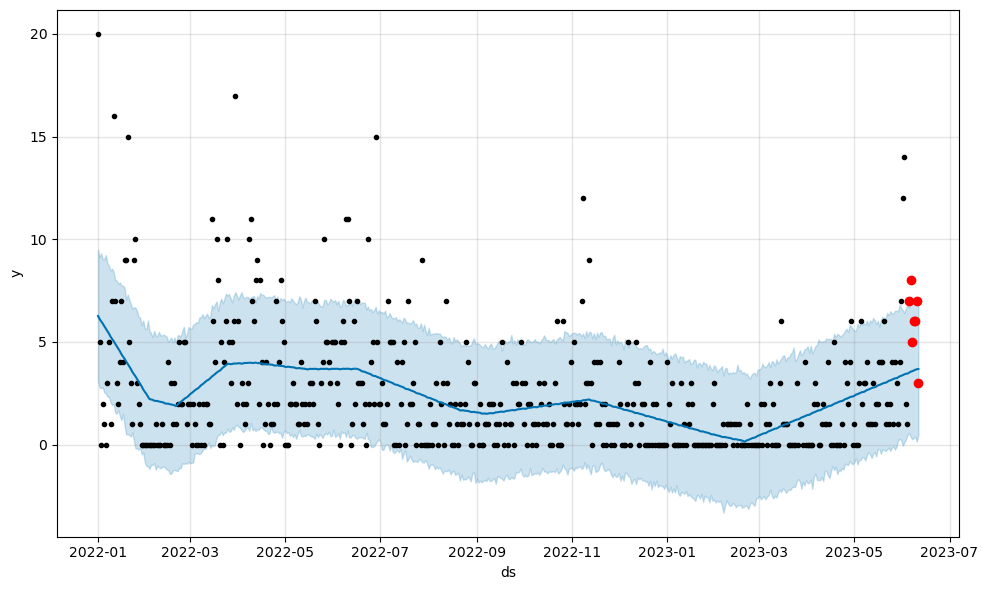

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  3.571769    0.251646    6.843160
523 2023-06-08  3.607759    0.339509    6.975996
524 2023-06-09  3.640958    0.373044    6.924543
525 2023-06-10  3.671761    0.141531    6.811302
526 2023-06-11  3.679191    0.486161    7.040366
[7 8 5 6 6 7 3]
---
[3.49593631 3.5485844  3.57176897 3.60775901 3.64095802 3.671761
 3.67919053]
SMAPE: 0.5123320572430089


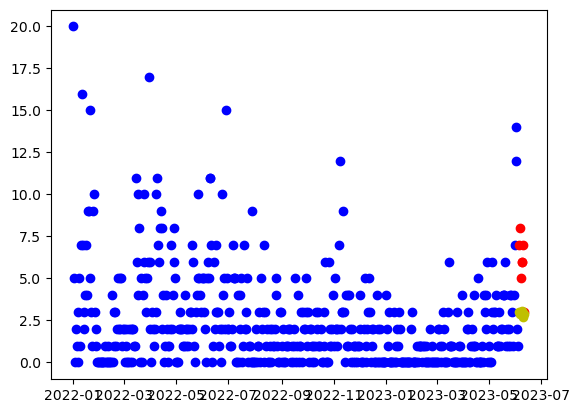

17:01:03 - cmdstanpy - INFO - Chain [1] start processing
17:01:03 - cmdstanpy - INFO - Chain [1] done processing


[7 8 5 6 6 7 3]
---
[3.00511598 2.86576129 2.9206542  3.04390454 3.00360585 2.71615709
 2.90592855]
SMAPE_lr: 0.643088146136823


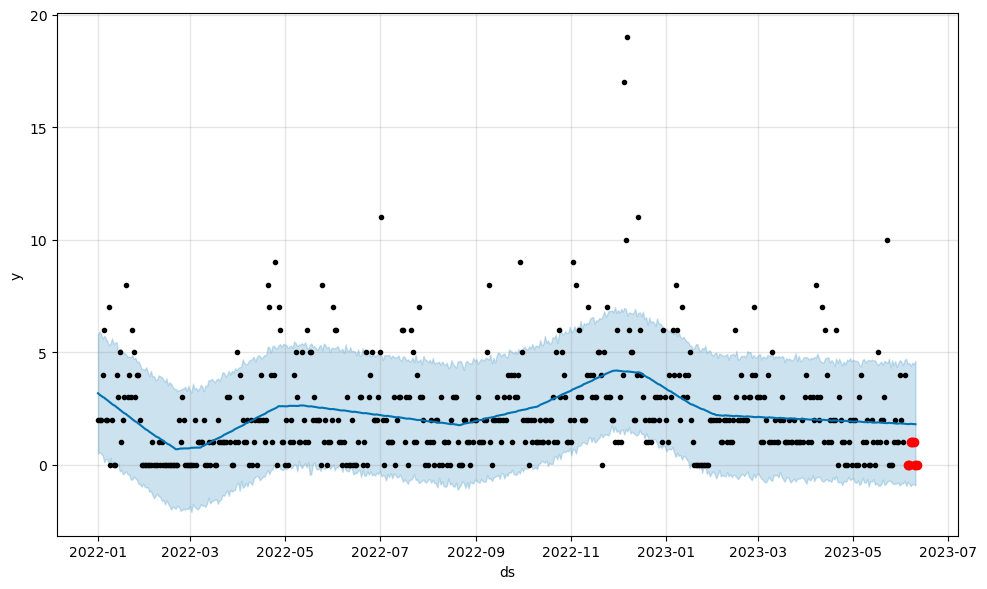

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-06  1.813794   -0.836864    4.524616
522 2023-06-07  1.828512   -0.942199    4.394947
523 2023-06-08  1.816065   -0.842394    4.541045
524 2023-06-09  1.814944   -0.867270    4.481472
525 2023-06-10  1.806410   -0.908553    4.623595
[0 0 1 1 1 0 0]
---
[1.81689238 1.81321613 1.81379411 1.82851195 1.81606479 1.81494377
 1.80641003]
SMAPE: 1.3919769810245397


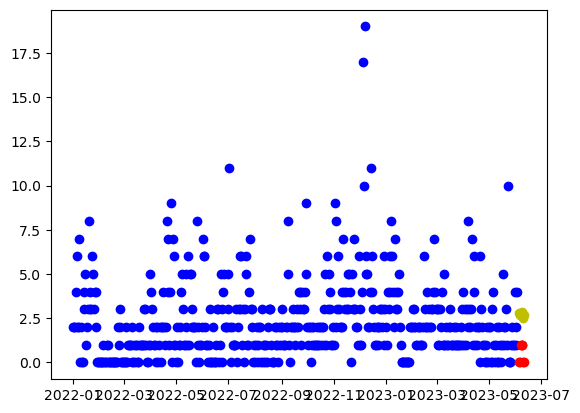

17:01:04 - cmdstanpy - INFO - Chain [1] start processing
17:01:04 - cmdstanpy - INFO - Chain [1] done processing


[0 0 1 1 1 0 0]
---
[2.7945915  2.65778223 2.71522055 2.84101632 2.80326304 2.5183597
 2.71067657]
SMAPE_lr: 1.5471754847519077


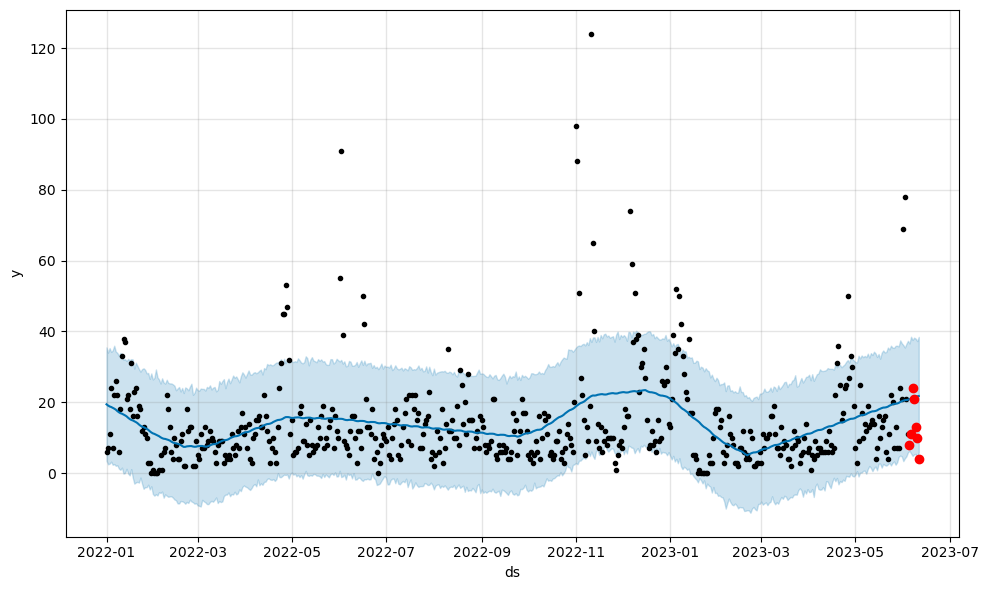

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  21.355996    4.872102   37.597997
523 2023-06-08  21.535136    5.309001   38.257962
524 2023-06-09  21.676633    5.451896   37.979175
525 2023-06-10  21.698901    4.171802   37.280597
526 2023-06-11  21.778849    5.925904   38.466618
[ 8 11 24 21 13 10  4]
---
[20.88495188 21.15580004 21.35599608 21.53513555 21.67663345 21.69890074
 21.77884905]
SMAPE: 0.6119233806104601


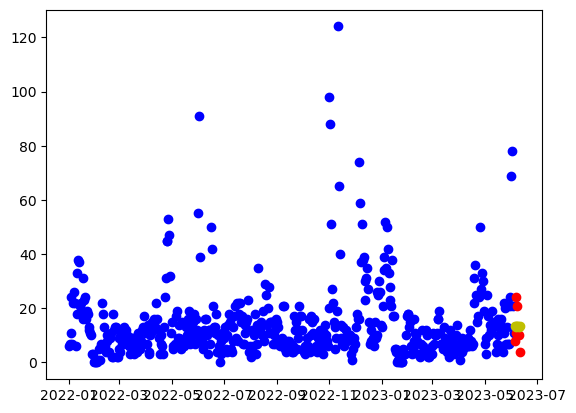

17:01:05 - cmdstanpy - INFO - Chain [1] start processing


[ 8 11 24 21 13 10  4]
---
[13.36452234 13.23170359 13.29313242 13.4229187  13.38915594 13.10824311
 13.3045505 ]
SMAPE_lr: 0.43924560777598437


17:01:05 - cmdstanpy - INFO - Chain [1] done processing


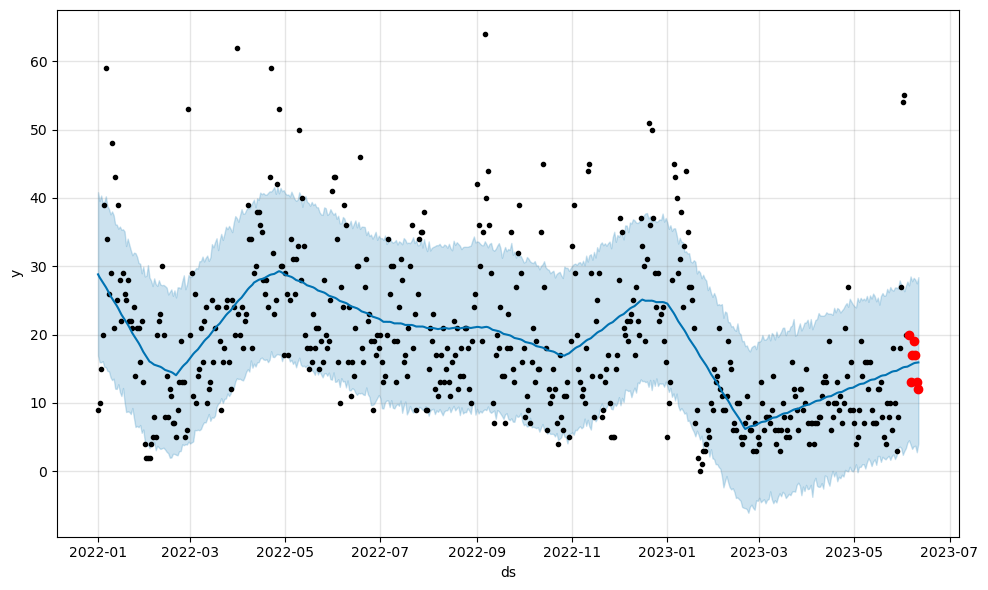

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  15.656773    3.260702   27.808179
523 2023-06-08  15.784189    3.649800   28.295323
524 2023-06-09  15.854582    3.716091   28.051282
525 2023-06-10  15.881427    2.768579   27.492286
526 2023-06-11  15.917626    4.056400   28.402533
[20 13 17 19 17 13 12]
---
[15.42748473 15.54610511 15.65677283 15.78418865 15.85458213 15.88142747
 15.91762639]
SMAPE: 0.1790858474598135


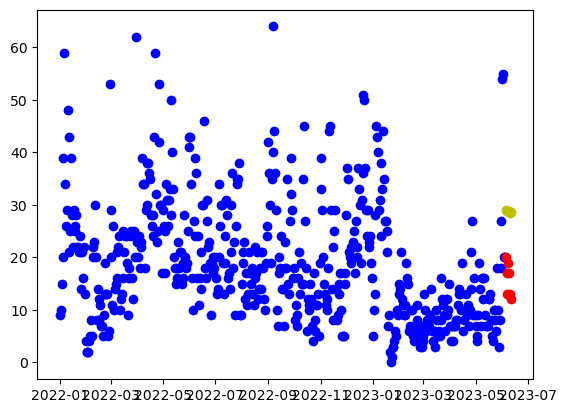

17:01:06 - cmdstanpy - INFO - Chain [1] start processing


[20 13 17 19 17 13 12]
---
[28.9965838  28.82391134 28.84548648 28.93541905 28.86180259 28.54103606
 28.69748974]
SMAPE_lr: 0.5916131535442328


17:01:06 - cmdstanpy - INFO - Chain [1] done processing


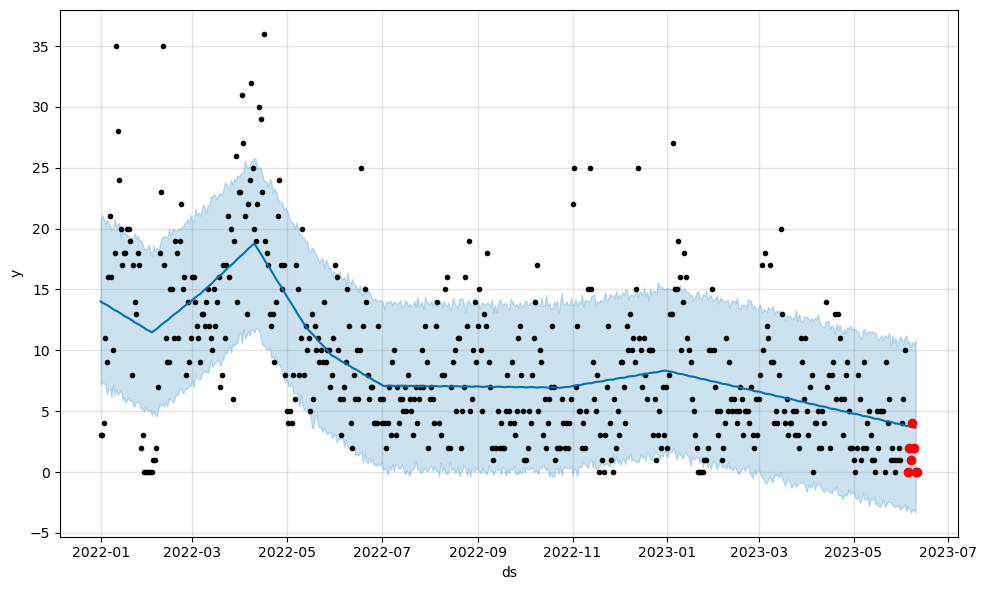

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-06  3.763610   -3.019777   10.700964
522 2023-06-07  3.740289   -3.351064   10.307094
523 2023-06-08  3.705994   -3.097215   10.679581
524 2023-06-09  3.675746   -3.157163   10.499747
525 2023-06-10  3.635924   -3.311079   10.845474
[0 2 1 4 2 0 0]
---
[3.78296826 3.76984629 3.7636096  3.74028865 3.70599415 3.67574595
 3.6359238 ]
SMAPE: 1.205550553635694


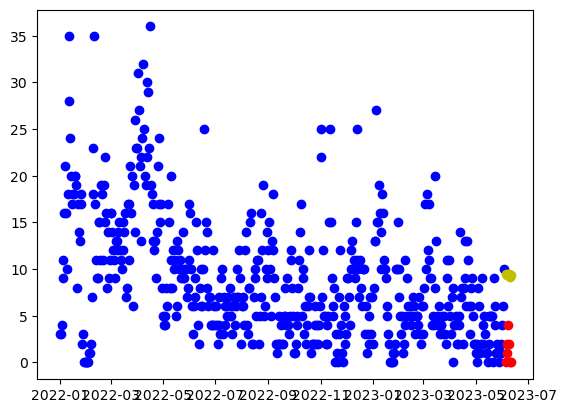

17:01:07 - cmdstanpy - INFO - Chain [1] start processing


[0 2 1 4 2 0 0]
---
[9.47273622 9.32882363 9.37915863 9.49785108 9.45299448 9.16098781
 9.34620137]
SMAPE_lr: 1.574938258698229


17:01:07 - cmdstanpy - INFO - Chain [1] done processing


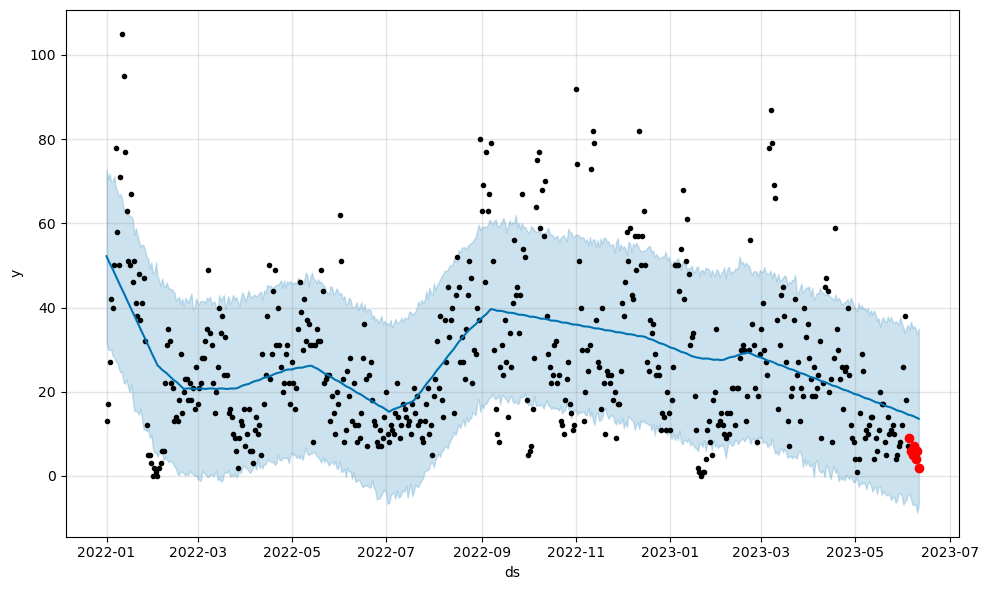

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  14.284993   -6.918452   35.154644
523 2023-06-08  14.123665   -6.723594   35.611137
524 2023-06-09  13.974184   -6.873285   34.921625
525 2023-06-10  13.773070   -8.747827   33.752380
526 2023-06-11  13.580573   -6.789173   35.022999
[9 6 5 7 4 6 2]
---
[14.49307119 14.39842684 14.28499291 14.12366496 13.97418428 13.7730698
 13.58057277]
SMAPE: 0.9015815719516648


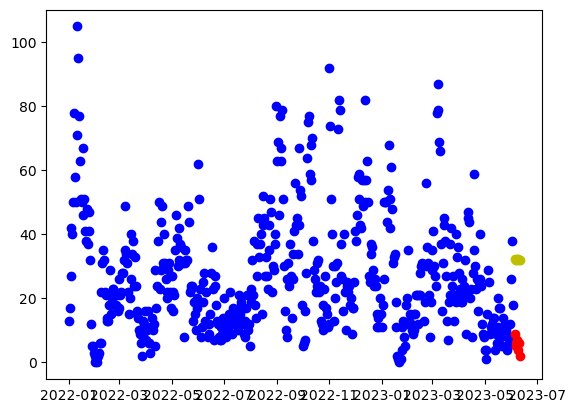

17:01:07 - cmdstanpy - INFO - Chain [1] start processing


[9 6 5 7 4 6 2]
---
[32.2445005  32.09463968 32.13902647 32.25177069 32.20096587 31.90301099
 32.08227632]
SMAPE_lr: 1.4193410611340145


17:01:08 - cmdstanpy - INFO - Chain [1] done processing


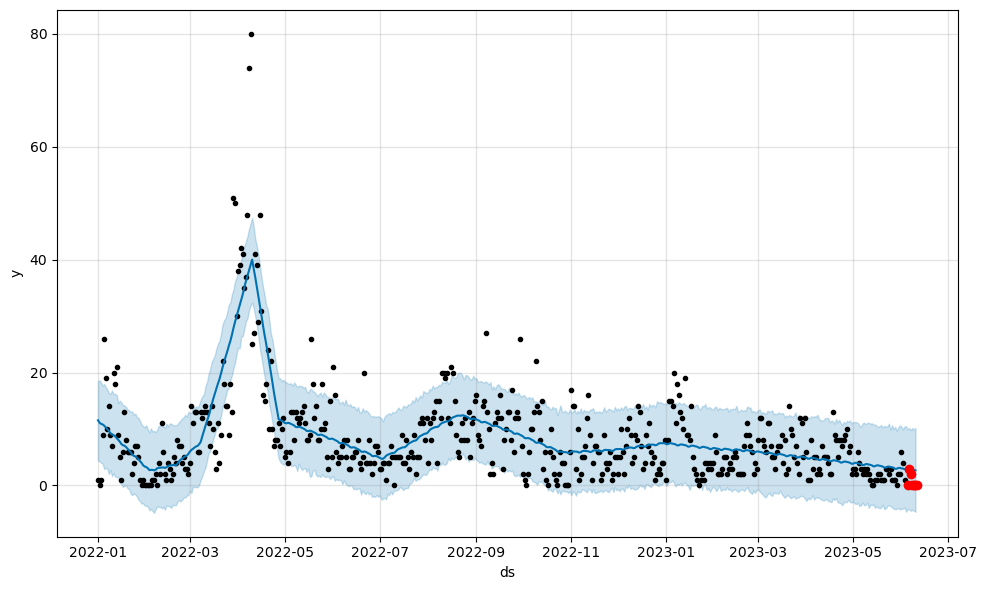

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-06  2.882180   -4.211841   10.197669
522 2023-06-07  2.900594   -4.486711    9.786346
523 2023-06-08  2.815891   -4.299006   10.188839
524 2023-06-09  2.762235   -4.490591    9.909442
525 2023-06-10  2.675669   -4.670489   10.183130
[0 3 2 0 0 0 0]
---
[2.71727389 2.740266   2.88218012 2.90059377 2.81589137 2.76223494
 2.67566886]
SMAPE: 1.4931261766891262


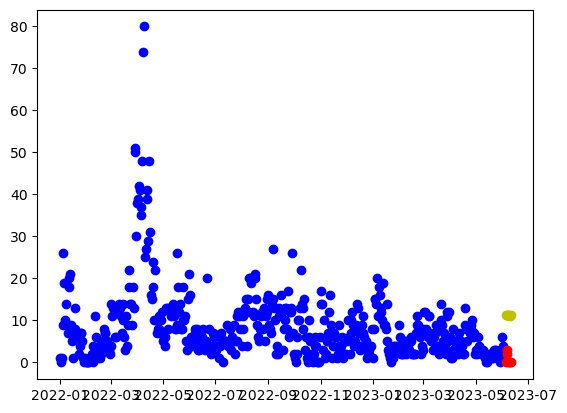

17:01:09 - cmdstanpy - INFO - Chain [1] start processing
17:01:09 - cmdstanpy - INFO - Chain [1] done processing


[0 3 2 0 0 0 0]
---
[11.34805419 11.19846473 11.24312286 11.35613844 11.30560497 11.00792143
 11.18745811]
SMAPE_lr: 1.7929644395501456


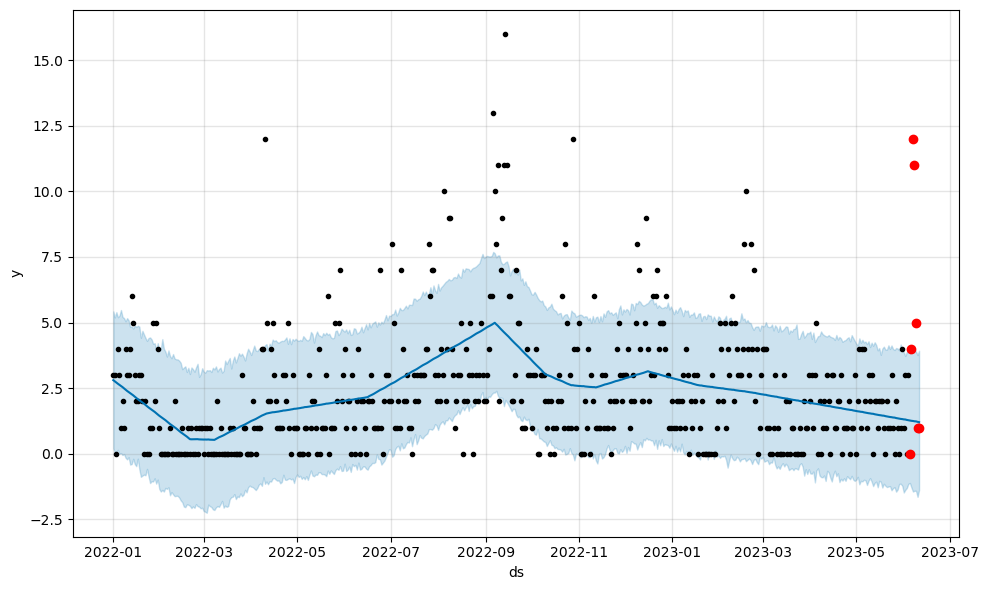

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  1.249629   -1.440178    3.899949
523 2023-06-08  1.238310   -1.409498    3.967090
524 2023-06-09  1.234268   -1.413235    3.894467
525 2023-06-10  1.217366   -1.642653    3.761550
526 2023-06-11  1.205007   -1.381828    3.928067
[ 0  4 12 11  5  1  1]
---
[1.26417756 1.25659426 1.24962898 1.23831    1.23426799 1.21736614
 1.20500724]
SMAPE: 1.1216980803252072


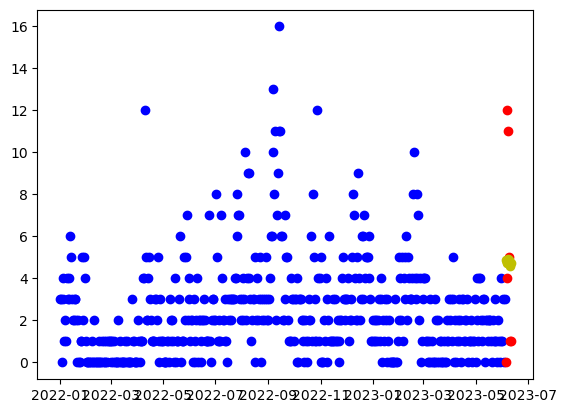

17:01:09 - cmdstanpy - INFO - Chain [1] start processing


[ 0  4 12 11  5  1  1]
---
[4.87365526 4.73146246 4.78351725 4.90392949 4.86079268 4.57050581
 4.75743915]
SMAPE_lr: 0.9156457967545609


17:01:10 - cmdstanpy - INFO - Chain [1] done processing


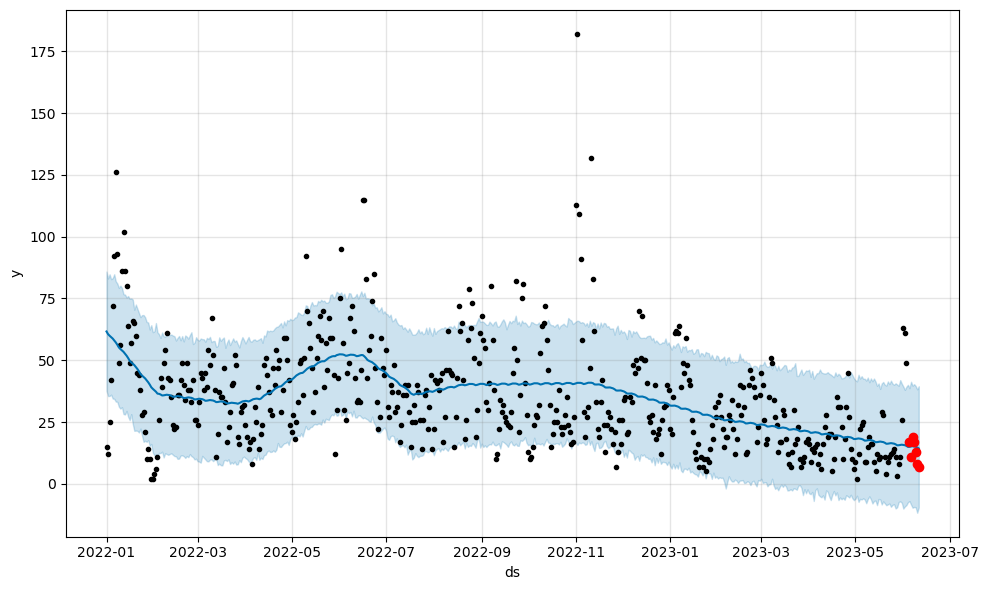

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  15.212650   -9.647095   39.707364
523 2023-06-08  15.111919   -9.360059   40.331770
524 2023-06-09  15.002980   -9.465700   39.588996
525 2023-06-10  14.733567  -11.699215   38.249836
526 2023-06-11  14.330203   -9.576930   39.497184
[17 11 19 17 13  8  7]
---
[14.99120419 15.11657139 15.21264958 15.11191867 15.0029795  14.73356682
 14.33020331]
SMAPE: 0.3146537924913835


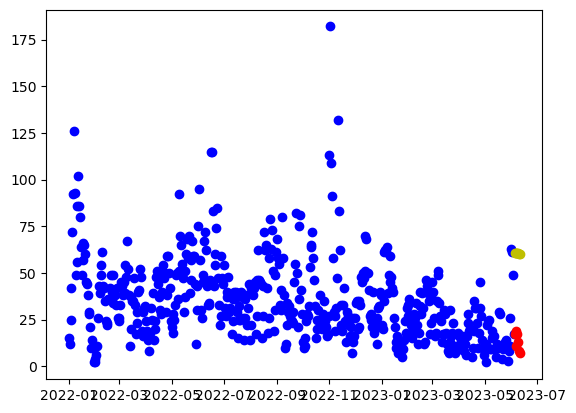

17:01:10 - cmdstanpy - INFO - Chain [1] start processing


[17 11 19 17 13  8  7]
---
[60.89081477 60.66690426 60.63724134 60.67593587 60.55108136 60.17907677
 60.28429241]
SMAPE_lr: 1.298683387022703


17:01:11 - cmdstanpy - INFO - Chain [1] done processing


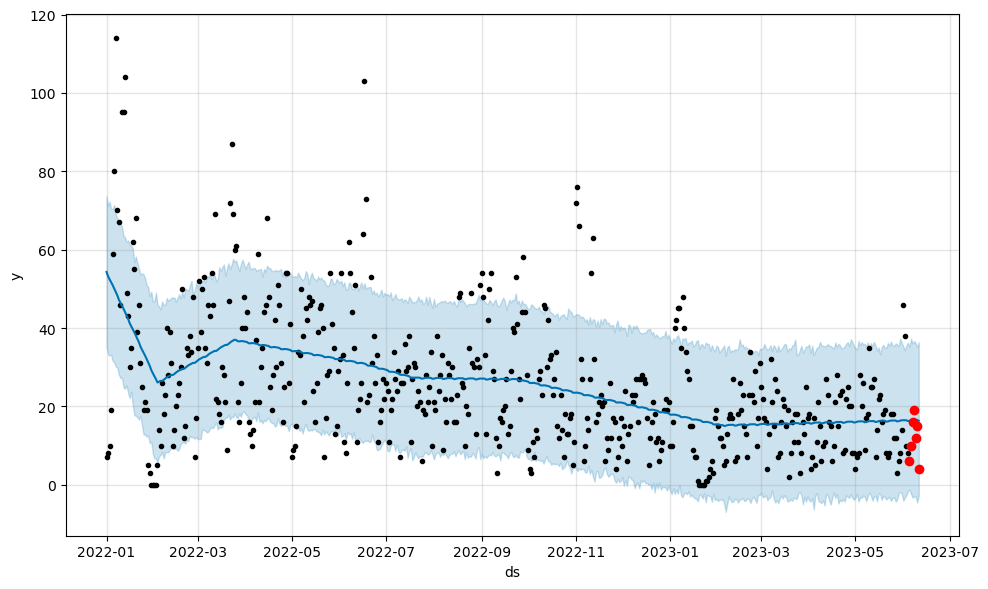

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  16.539826   -3.277629   36.065507
523 2023-06-08  16.558215   -2.953481   36.661929
524 2023-06-09  16.550281   -2.979009   36.148742
525 2023-06-10  16.542115   -4.528474   35.206237
526 2023-06-11  16.322017   -2.723540   36.382822
[ 6 10 16 19 12 15  4]
---
[16.3092804  16.44658938 16.53982645 16.55821451 16.5502812  16.54211501
 16.32201738]
SMAPE: 0.45878075473987845


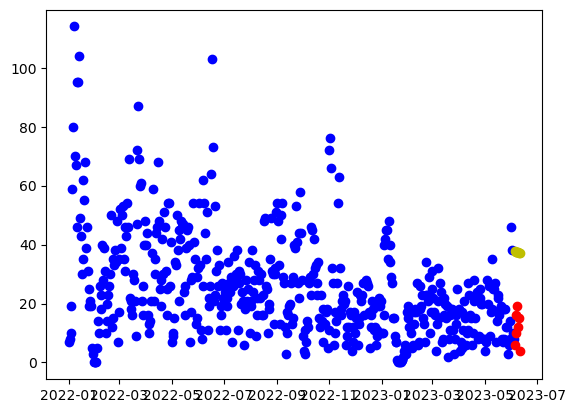

17:01:11 - cmdstanpy - INFO - Chain [1] start processing


[ 6 10 16 19 12 15  4]
---
[37.65645129 37.47128671 37.48036972 37.55781017 37.47170158 37.13844293
 37.28240449]
SMAPE_lr: 1.079795932813728


17:01:12 - cmdstanpy - INFO - Chain [1] done processing


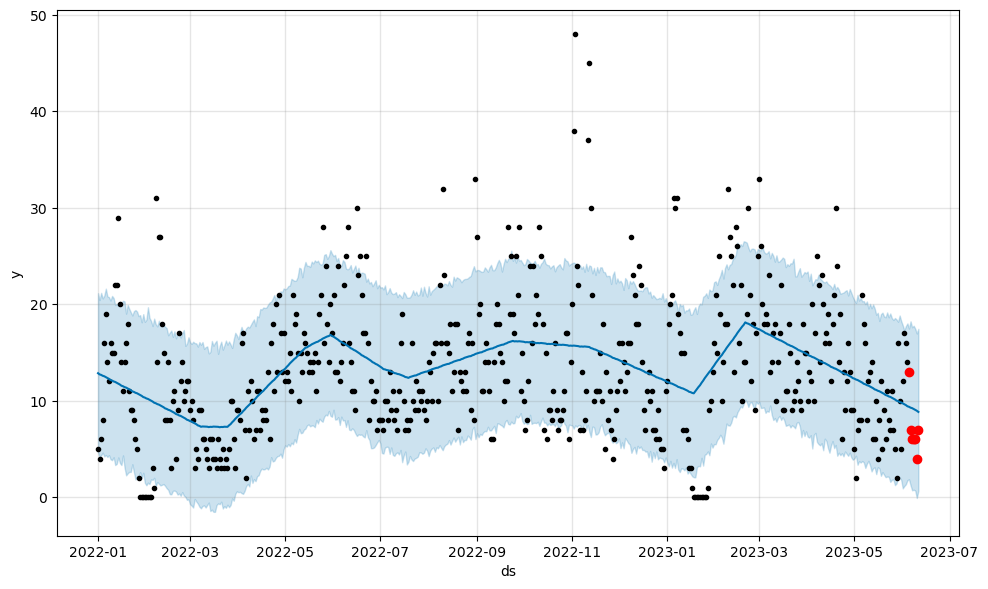

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  9.230883    0.708472   17.617910
523 2023-06-08  9.144939    0.767850   17.780254
524 2023-06-09  9.054876    0.676764   17.473165
525 2023-06-10  8.962751   -0.087873   16.976686
526 2023-06-11  8.840140    0.654014   17.457351
[13  7  6  6  6  4  7]
---
[9.37097549 9.28062979 9.23088317 9.14493936 9.0548759  8.96275092
 8.84013964]
SMAPE: 0.40686238653318885


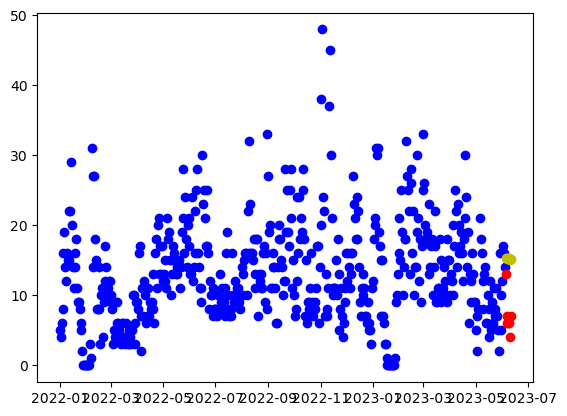

17:01:12 - cmdstanpy - INFO - Chain [1] start processing
17:01:12 - cmdstanpy - INFO - Chain [1] done processing


[13  7  6  6  6  4  7]
---
[15.37903557 15.23913909 15.29349019 15.41619874 15.37535825 15.08736769
 15.27659735]
SMAPE_lr: 0.7775577799858617


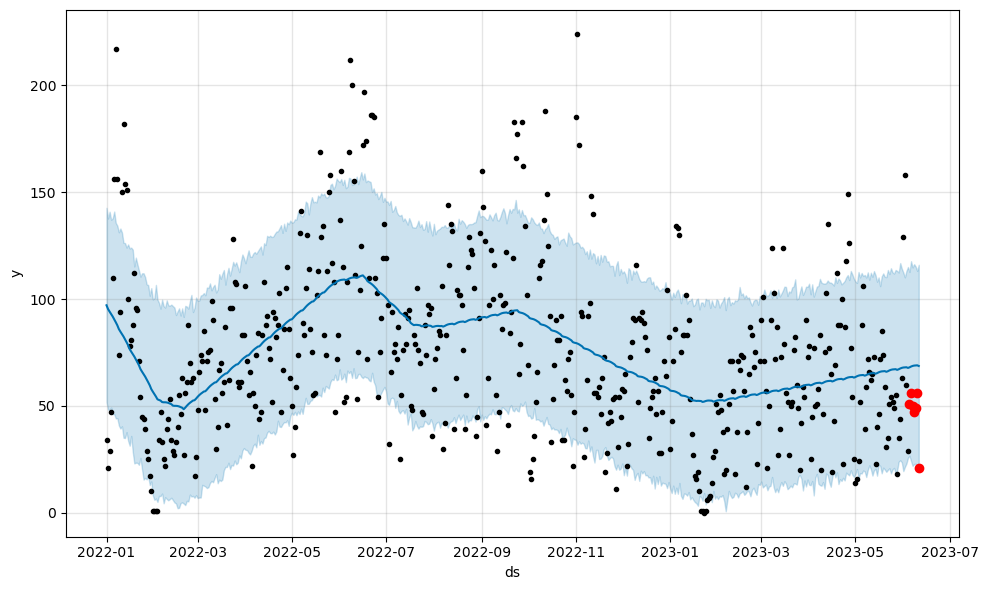

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  68.691248   21.930541  114.764778
523 2023-06-08  68.861341   22.827611  116.298823
524 2023-06-09  68.938954   22.914395  115.184220
525 2023-06-10  68.984114   19.265160  113.158911
526 2023-06-11  68.670821   23.709827  116.008857
[51 56 50 47 49 56 21]
---
[68.03158548 68.40762244 68.69124791 68.86134065 68.9389543  68.98411405
 68.67082134]
SMAPE: 0.3981569887433533


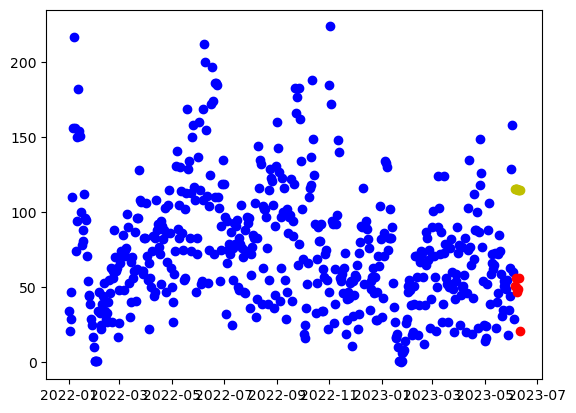

17:01:13 - cmdstanpy - INFO - Chain [1] start processing


[51 56 50 47 49 56 21]
---
[115.69684435 115.4257227  115.34884864 115.34033203 115.16826637
 114.74905065 114.80705515]
SMAPE_lr: 0.8539457196880663


17:01:14 - cmdstanpy - INFO - Chain [1] done processing


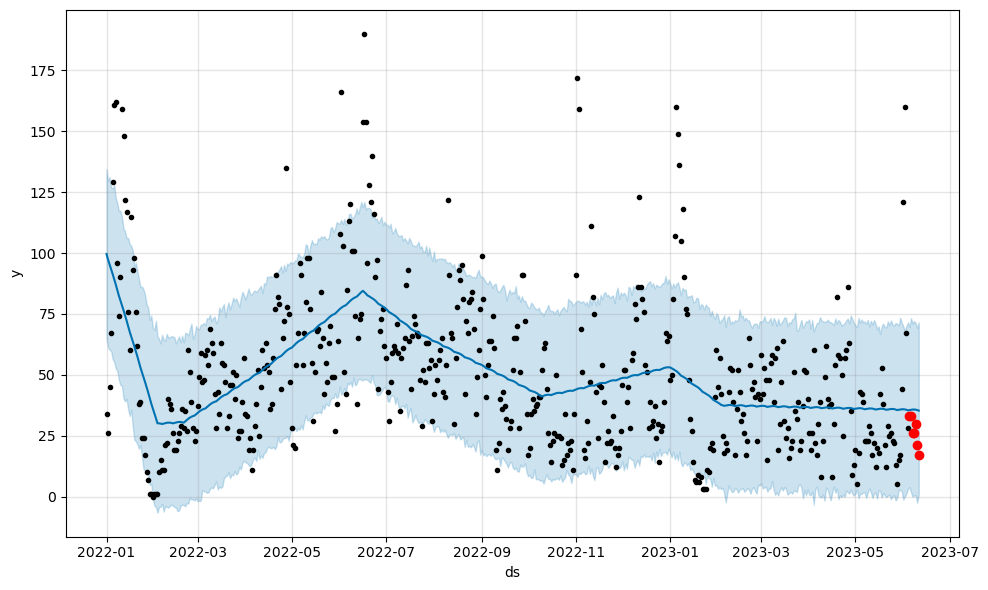

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  35.740980   -0.097932   71.013335
523 2023-06-08  35.748095    0.514133   72.064645
524 2023-06-09  35.685176    0.450312   71.089005
525 2023-06-10  35.527039   -2.536130   69.283177
526 2023-06-11  35.291944    0.864493   71.532361
[33 33 26 26 30 21 17]
---
[35.53651003 35.61315323 35.74098023 35.74809453 35.68517559 35.52703895
 35.29194376]
SMAPE: 0.30973836056998827


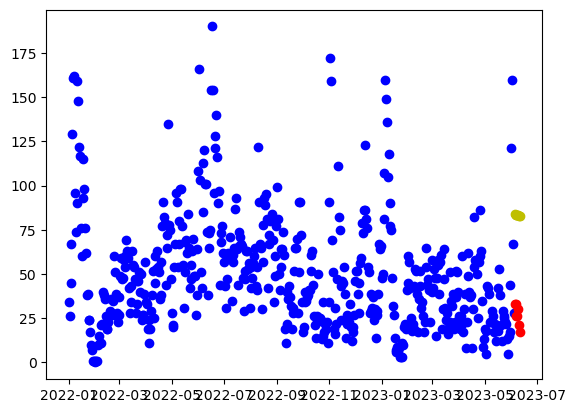

17:01:14 - cmdstanpy - INFO - Chain [1] start processing
17:01:15 - cmdstanpy - INFO - Chain [1] done processing


[33 33 26 26 30 21 17]
---
[83.81787936 83.56911308 83.51459439 83.52843315 83.37872286 82.9818625
 83.06222237]
SMAPE_lr: 1.0418114729891008


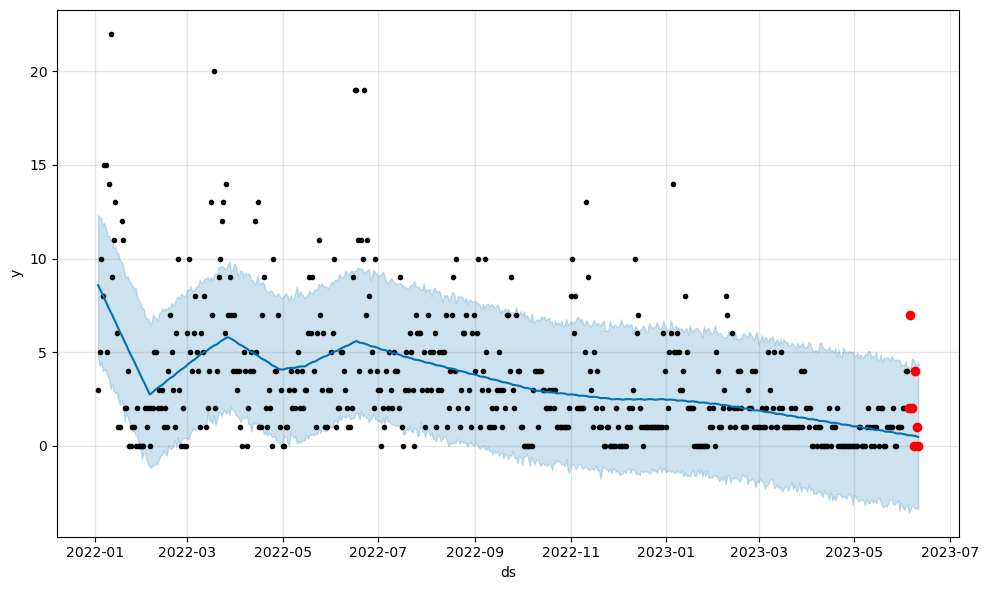

            ds      yhat  yhat_lower  yhat_upper
520 2023-06-07  0.552646   -3.209275    4.672047
521 2023-06-08  0.531753   -3.274536    4.599787
522 2023-06-09  0.523330   -3.339031    4.372943
523 2023-06-10  0.496015   -3.356892    4.223914
524 2023-06-11  0.462418   -3.394004    4.516798
[2 7 2 0 4 1 0]
---
[0.55572001 0.55372851 0.55264588 0.53175274 0.52332995 0.49601453
 0.46241771]
SMAPE: 1.4545718580889022


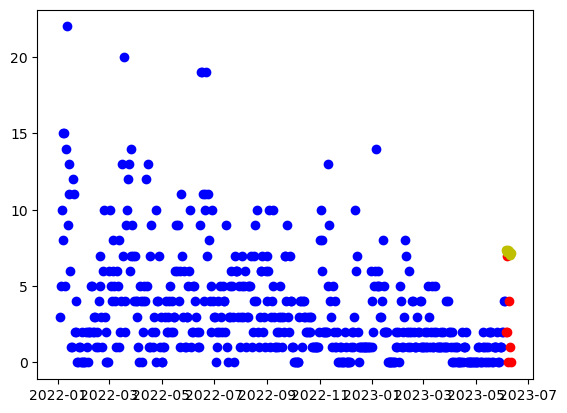

17:01:15 - cmdstanpy - INFO - Chain [1] start processing


[2 7 2 0 4 1 0]
---
[7.35141627 7.20189163 7.24661457 7.35969496 7.30922631 7.01160759
 7.19120909]
SMAPE_lr: 1.1991021590150268


17:01:16 - cmdstanpy - INFO - Chain [1] done processing


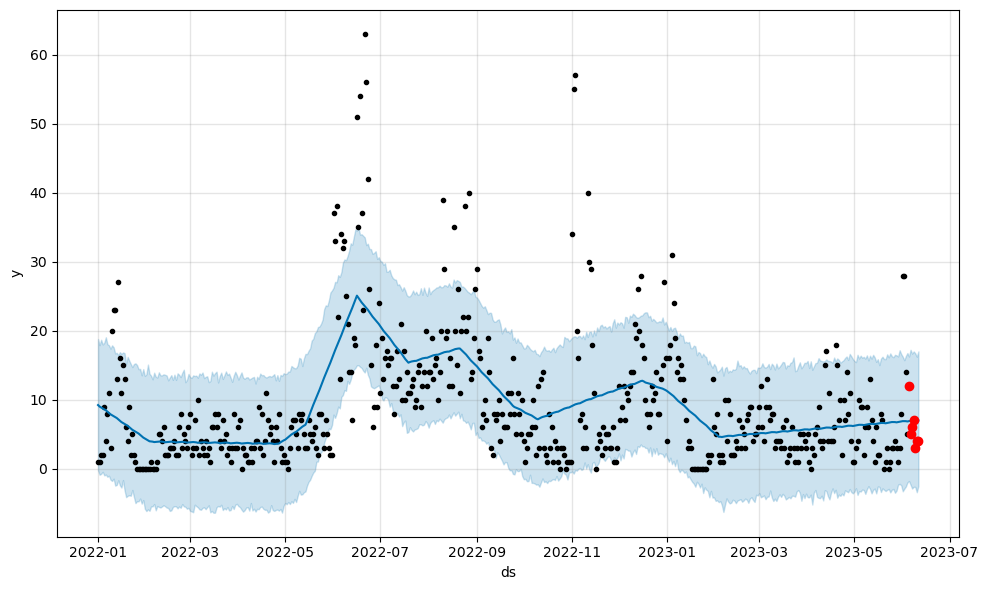

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  7.004869   -2.869131   16.676661
523 2023-06-08  7.034706   -2.617143   16.995749
524 2023-06-09  7.025546   -2.635967   16.733389
525 2023-06-10  7.027685   -3.402611   16.239676
526 2023-06-11  6.988215   -2.511088   17.001797
[12  5  6  7  3  4  4]
---
[6.90078216 6.95250593 7.00486859 7.03470601 7.02554568 7.02768534
 6.98821492]
SMAPE: 0.4174042302134677


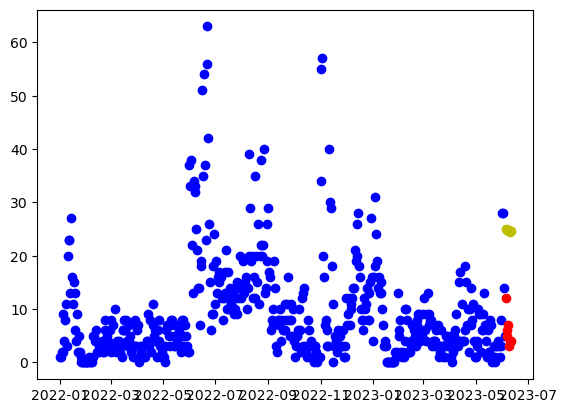

17:01:16 - cmdstanpy - INFO - Chain [1] start processing


[12  5  6  7  3  4  4]
---
[24.99249169 24.81333693 24.82842976 24.91188004 24.83178127 24.50453243
 24.65450381]
SMAPE_lr: 1.2606896943202166


17:01:17 - cmdstanpy - INFO - Chain [1] done processing


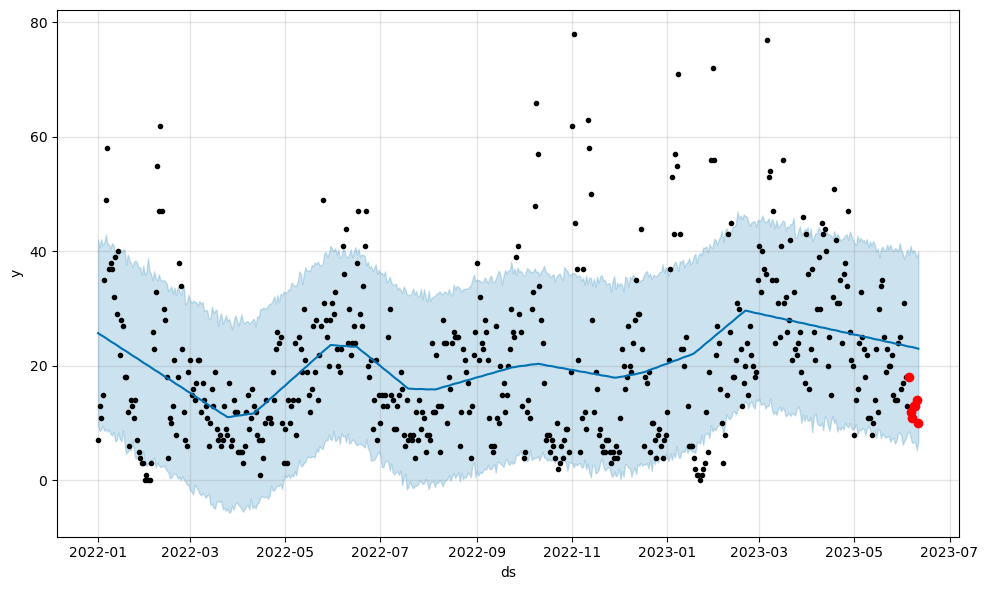

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  23.304622    6.529095   39.833643
523 2023-06-08  23.245717    6.731085   40.264061
524 2023-06-09  23.168666    6.657213   39.759298
525 2023-06-10  23.092640    5.255812   38.942665
526 2023-06-11  23.013523    6.883355   39.996189
[18 12 11 13 13 14 10]
---
[23.39484378 23.36299835 23.3046219  23.24571735 23.16866616 23.09264018
 23.01352276]
SMAPE: 0.5752795729677158


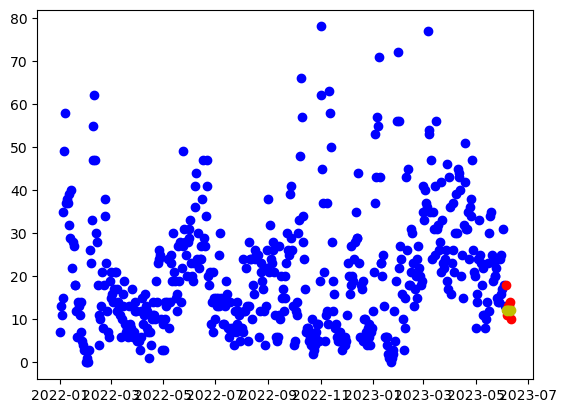

17:01:17 - cmdstanpy - INFO - Chain [1] start processing
17:01:17 - cmdstanpy - INFO - Chain [1] done processing


[18 12 11 13 13 14 10]
---
[12.15298642 12.04657334 12.13440786 12.29059982 12.28324274 12.02873559
 12.25144866]
SMAPE_lr: 0.1366283566810447


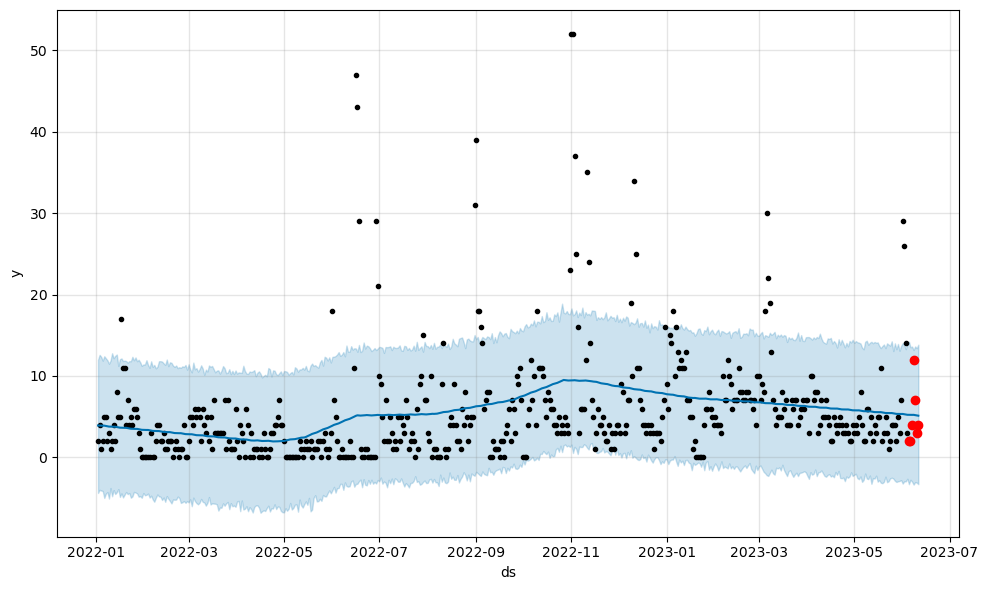

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-07  5.224788   -2.976896   13.615013
522 2023-06-08  5.228354   -3.341411   13.191713
523 2023-06-09  5.195468   -3.032686   13.629514
524 2023-06-10  5.158370   -3.095649   13.411502
525 2023-06-11  5.125043   -3.285534   13.844468
[ 2  2  4 12  7  3  4]
---
[5.22942939 5.21855068 5.22478838 5.22835371 5.19546845 5.15836964
 5.12504258]
SMAPE: 0.5583485953628516


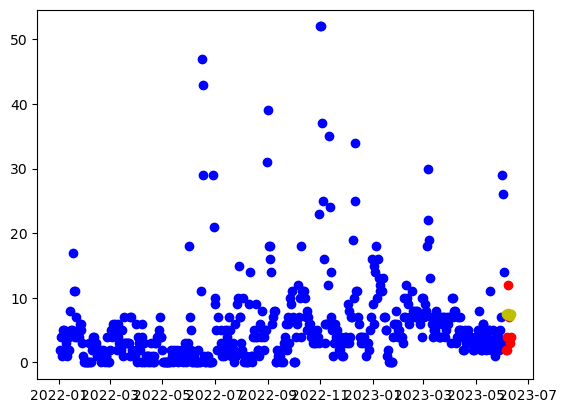

17:01:18 - cmdstanpy - INFO - Chain [1] start processing


[ 2  2  4 12  7  3  4]
---
[7.53615985 7.39848278 7.45505329 7.57998125 7.54136017 7.25558902
 7.44703809]
SMAPE_lr: 0.6958899226391698


17:01:18 - cmdstanpy - INFO - Chain [1] done processing


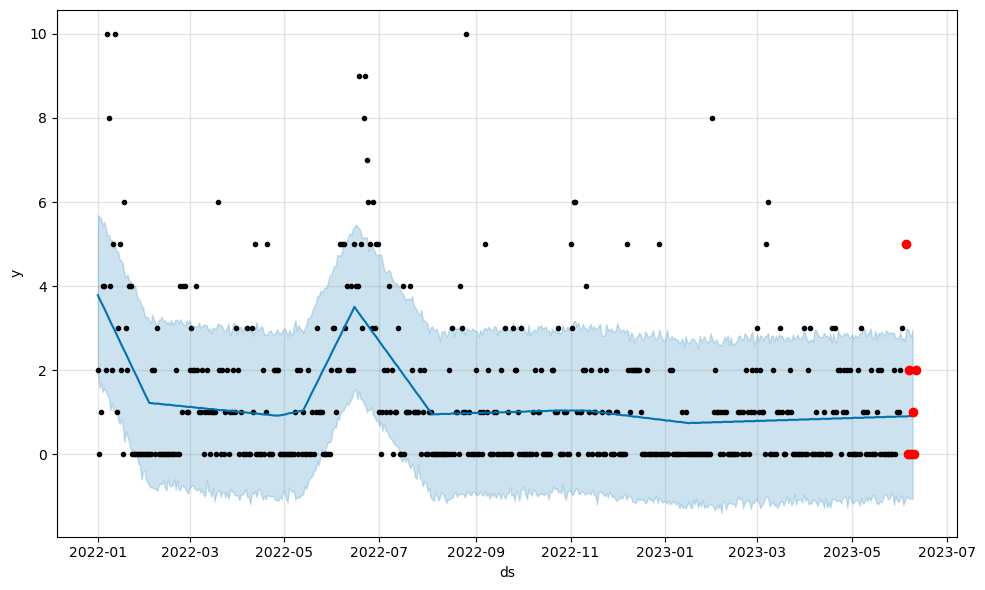

            ds      yhat  yhat_lower  yhat_upper
520 2023-06-05  0.894357   -1.018768    2.989279
521 2023-06-06  0.902323   -1.030032    2.971122
522 2023-06-07  0.906616   -1.057588    2.864333
523 2023-06-08  0.902846   -1.060667    2.798670
524 2023-06-09  0.904494   -1.059770    2.967600
[5 0 2 0 1 0 2]
---
[0.89605393 0.89417657 0.89435703 0.90232328 0.90661566 0.9028461
 0.9044937 ]
SMAPE: 1.2869155938316652


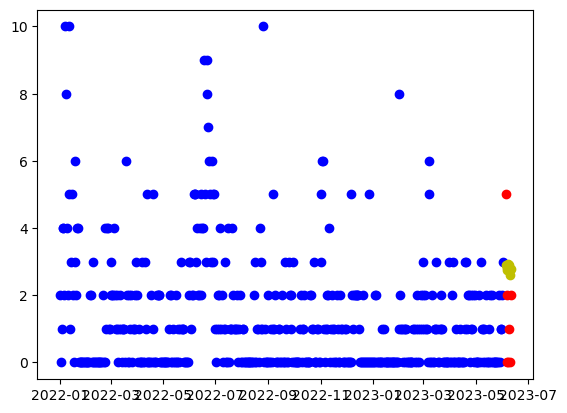

17:01:19 - cmdstanpy - INFO - Chain [1] start processing


[5 0 2 0 1 0 2]
---
[2.9020868  2.76104486 2.81425051 2.9358136  2.89382766 2.60469164
 2.79277584]
SMAPE_lr: 1.167542588510425


17:01:20 - cmdstanpy - INFO - Chain [1] done processing


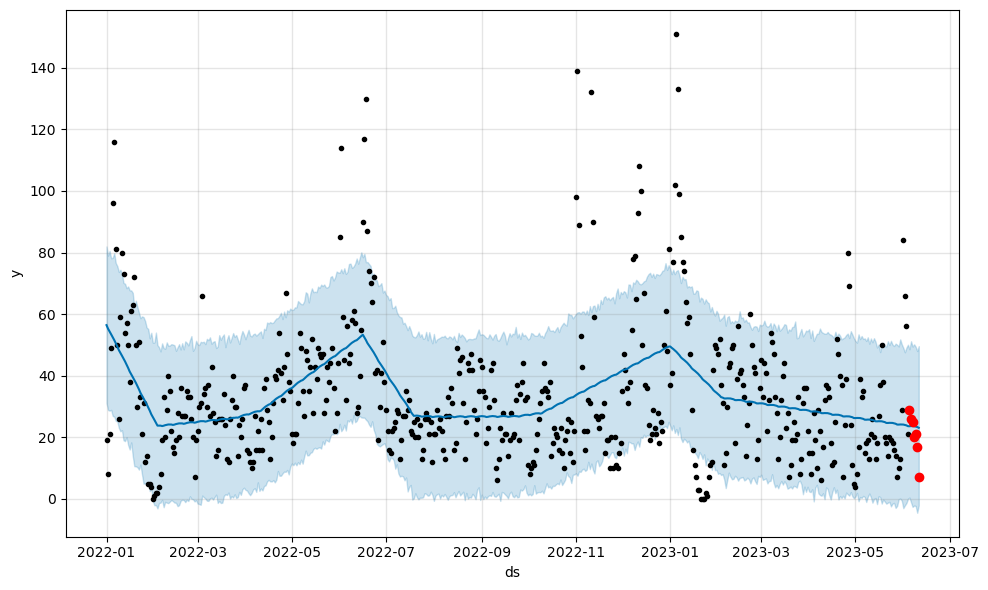

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  23.653562   -2.590044   49.469671
523 2023-06-08  23.622873   -2.159778   50.203237
524 2023-06-09  23.501058   -2.287611   49.413394
525 2023-06-10  23.359669   -4.499059   48.027363
526 2023-06-11  23.097002   -2.100715   49.621644
[29 26 25 20 21 17  7]
---
[23.60680787 23.65314328 23.65356178 23.62287334 23.50105812 23.35966872
 23.09700226]
SMAPE: 0.2883206360564539


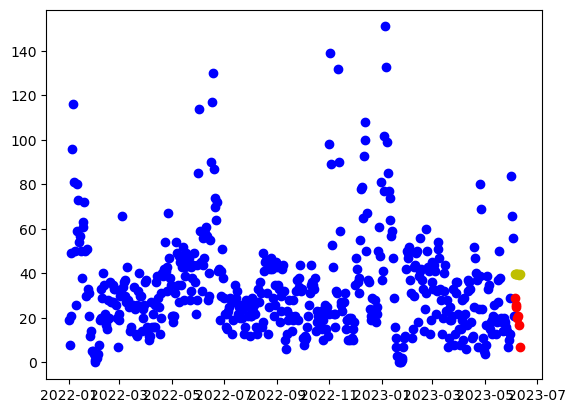

17:01:20 - cmdstanpy - INFO - Chain [1] start processing


[29 26 25 20 21 17  7]
---
[39.81104816 39.65435975 39.69191893 39.79783556 39.74020314 39.43542066
 39.60785839]
SMAPE_lr: 0.6654183739994163


17:01:21 - cmdstanpy - INFO - Chain [1] done processing


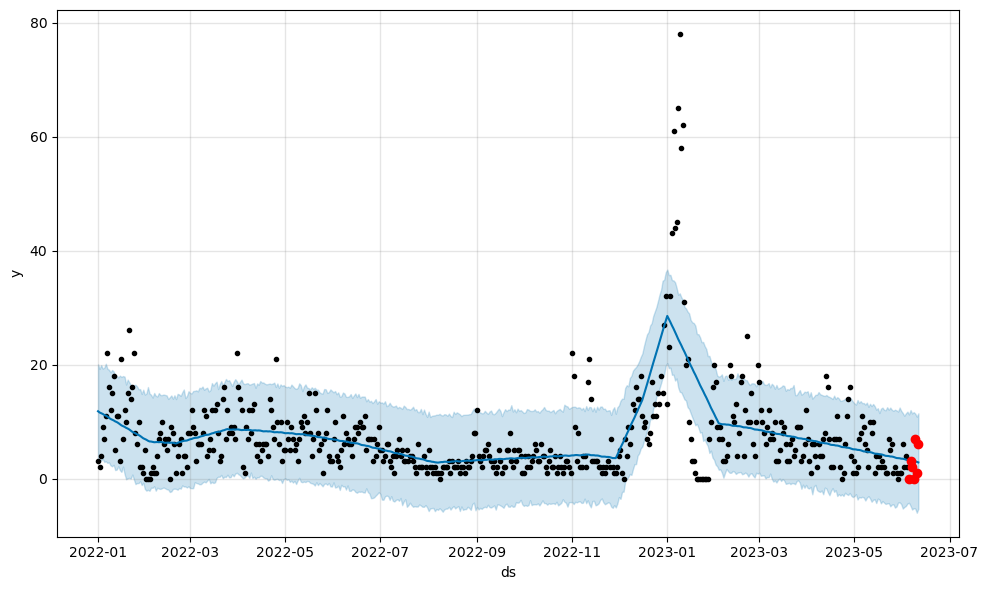

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  3.096916   -5.449644   11.412052
523 2023-06-08  3.084251   -5.208702   11.645546
524 2023-06-09  3.024363   -5.281934   11.390466
525 2023-06-10  2.930716   -6.013085   10.850547
526 2023-06-11  2.822723   -5.316799   11.436745
[0 3 2 0 7 1 6]
---
[3.19217536 3.16705396 3.09691621 3.08425138 3.02436322 2.93071633
 2.82272305]
SMAPE: 0.9972024277297559


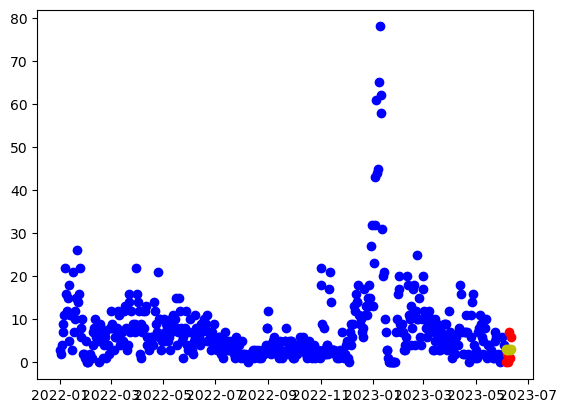

17:01:21 - cmdstanpy - INFO - Chain [1] start processing
17:01:22 - cmdstanpy - INFO - Chain [1] done processing


[0 3 2 0 7 1 6]
---
[3.02116321 2.89771104 2.96850646 3.10765932 3.08326315 2.8117169
 3.01739087]
SMAPE_lr: 0.9733646539517914


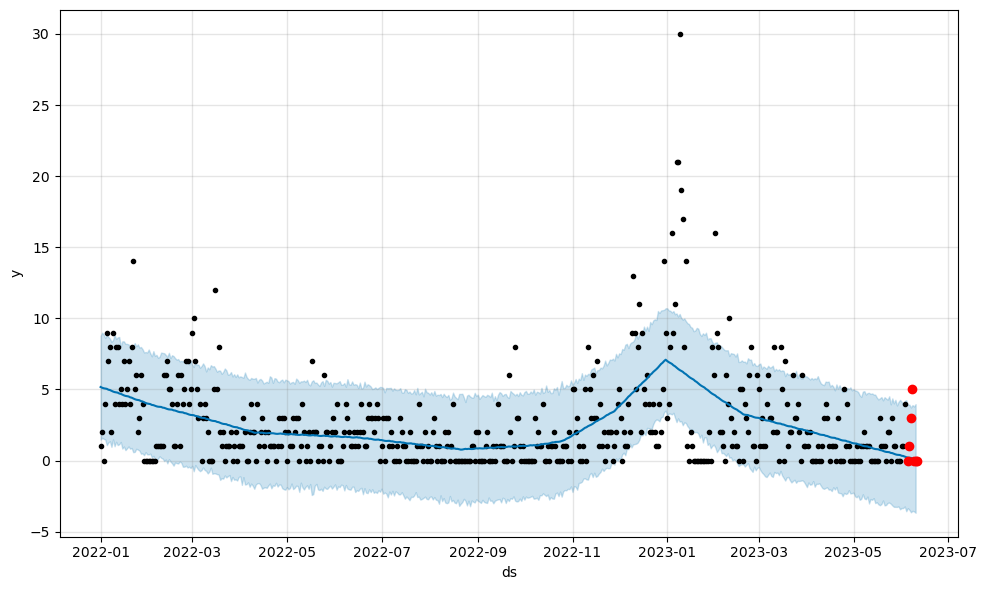

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-06  0.196107   -3.464178    3.939472
522 2023-06-07  0.189618   -3.636563    3.733436
523 2023-06-08  0.139378   -3.531663    3.902294
524 2023-06-09  0.123317   -3.575625    3.805517
525 2023-06-10  0.079298   -3.669636    3.969539
[0 1 3 5 0 0 0]
---
[0.23809739 0.20994904 0.19610679 0.18961825 0.13937824 0.12331653
 0.07929799]
SMAPE: 1.8449057571156753


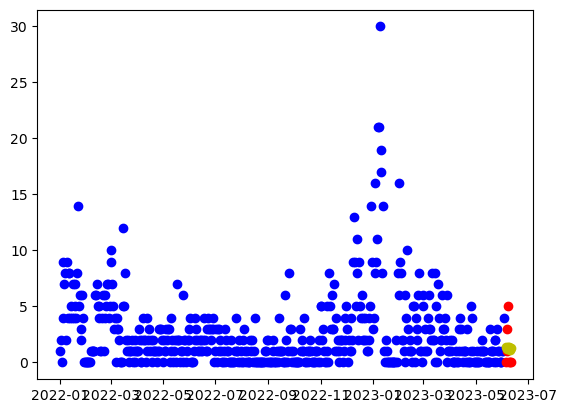

17:01:22 - cmdstanpy - INFO - Chain [1] start processing


[0 1 3 5 0 0 0]
---
[1.3670717  1.23427262 1.29572113 1.42552709 1.391784   1.11089085
 1.30721791]
SMAPE_lr: 1.4451101030435456


17:01:22 - cmdstanpy - INFO - Chain [1] done processing


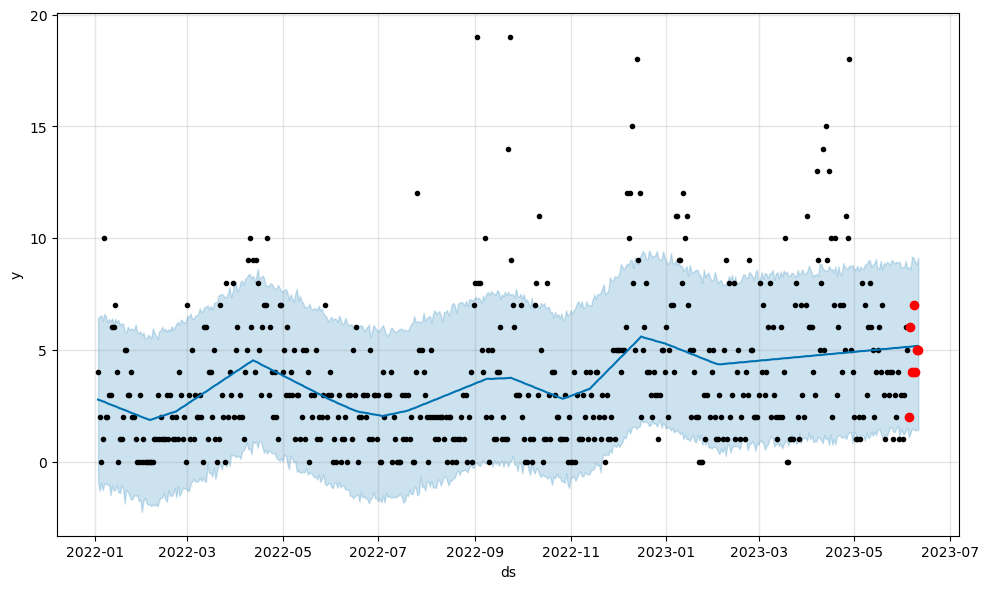

            ds      yhat  yhat_lower  yhat_upper
520 2023-06-07  5.151295    1.478326    9.173290
521 2023-06-08  5.157750    1.441463    9.129593
522 2023-06-09  5.171677    1.400644    8.930263
523 2023-06-10  5.174241    1.415345    8.816617
524 2023-06-11  5.168888    1.405828    9.127400
[2 6 4 7 4 5 5]
---
[5.13247113 5.14023206 5.15129469 5.15775016 5.17167684 5.17424067
 5.16888797]
SMAPE: 0.27290869517892846


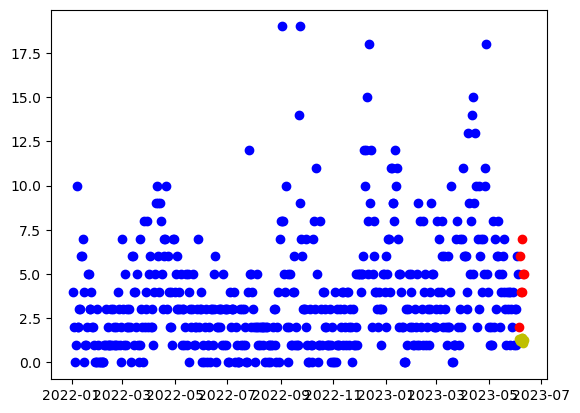

17:01:23 - cmdstanpy - INFO - Chain [1] start processing


[2 6 4 7 4 5 5]
---
[1.32022253 1.19231444 1.25865393 1.39335087 1.36449877 1.0884966
 1.28971465]
SMAPE_lr: 1.081742707641691


17:01:24 - cmdstanpy - INFO - Chain [1] done processing


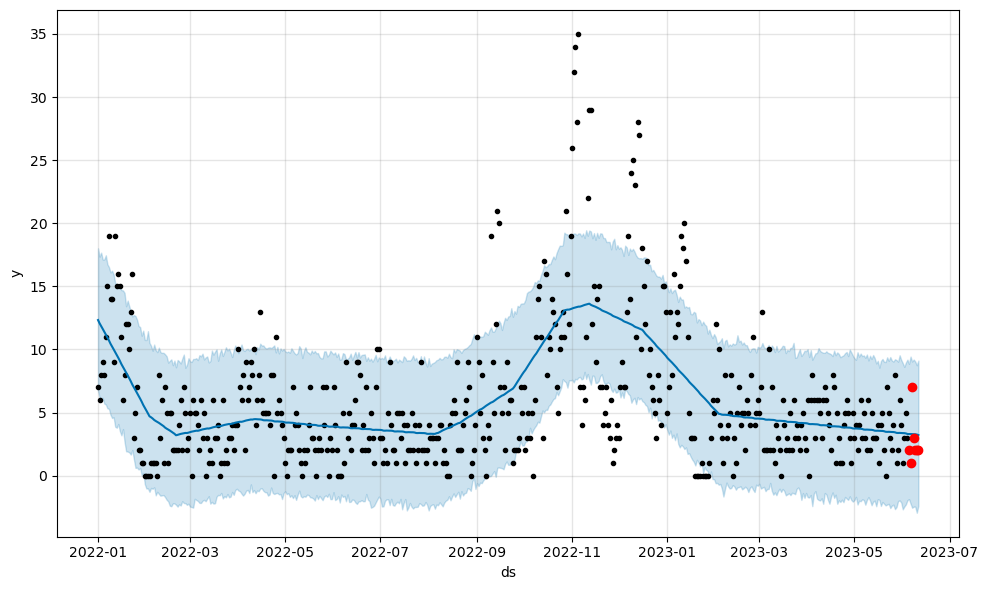

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  3.297909   -2.540894    9.043753
523 2023-06-08  3.285686   -2.453471    9.201628
524 2023-06-09  3.281305   -2.458431    9.048566
525 2023-06-10  3.260506   -2.939959    8.750749
526 2023-06-11  3.217175   -2.391034    9.120716
[2 1 7 3 2 2 2]
---
[3.29607854 3.30165585 3.29790894 3.28568568 3.28130499 3.26050633
 3.21717536]
SMAPE: 0.5429332605440661


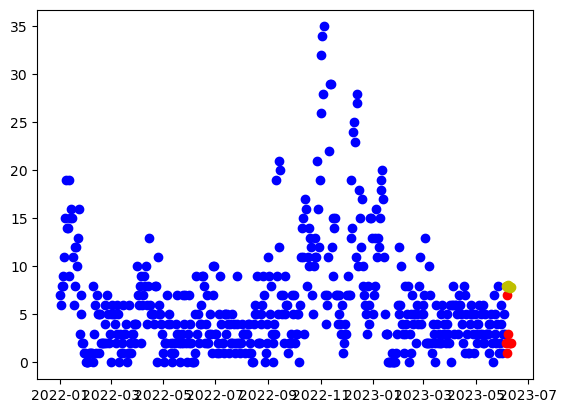

17:01:24 - cmdstanpy - INFO - Chain [1] start processing


[2 1 7 3 2 2 2]
---
[8.01296759 7.87254834 7.92637668 8.04856246 8.0071992  7.71868588
 7.90739277]
SMAPE_lr: 1.0511657738515032


17:01:25 - cmdstanpy - INFO - Chain [1] done processing


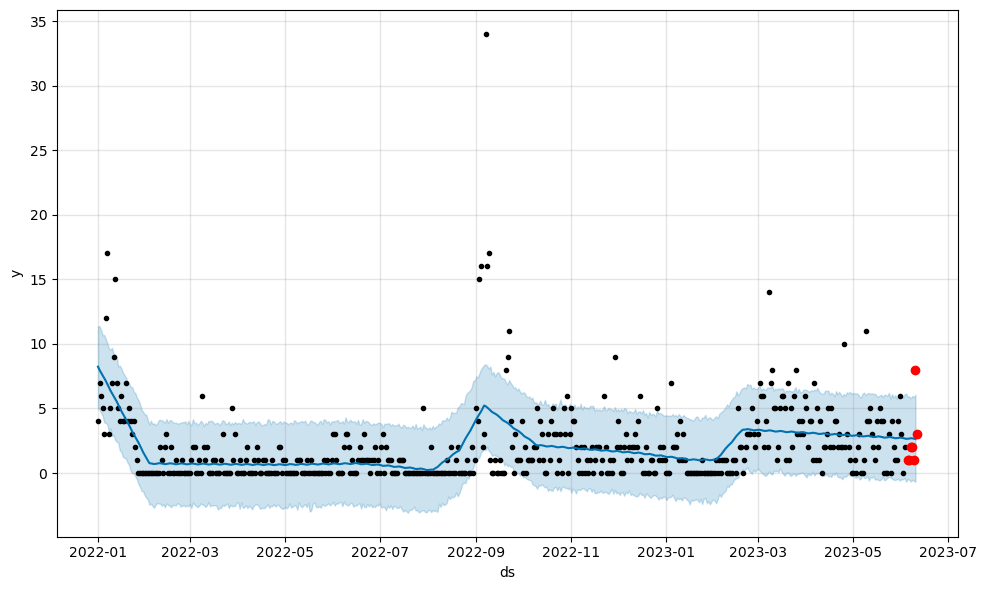

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-06  2.666468   -0.528555    5.934011
522 2023-06-07  2.694464   -0.654698    5.774546
523 2023-06-08  2.683523   -0.520902    5.963855
524 2023-06-09  2.661966   -0.604580    5.876119
525 2023-06-10  2.632948   -0.672544    6.056990
[1 1 2 2 1 8 3]
---
[2.64545588 2.65872267 2.6664679  2.69446353 2.68352334 2.66196597
 2.63294834]
SMAPE: 0.6338144177430289


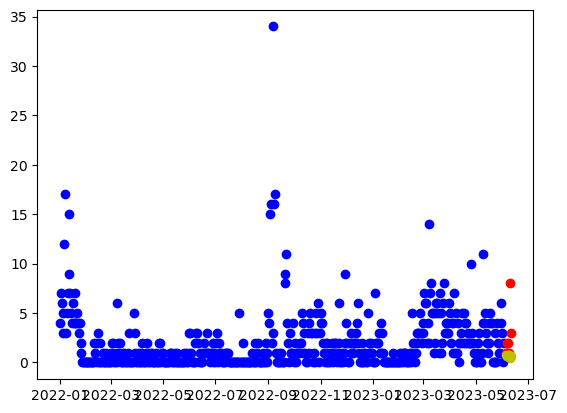

17:01:25 - cmdstanpy - INFO - Chain [1] start processing


[1 1 2 2 1 8 3]
---
[0.73738384 0.60569177 0.66824728 0.79916024 0.76652416 0.48673801
 0.68417208]
SMAPE_lr: 0.8488246450845461


17:01:26 - cmdstanpy - INFO - Chain [1] done processing


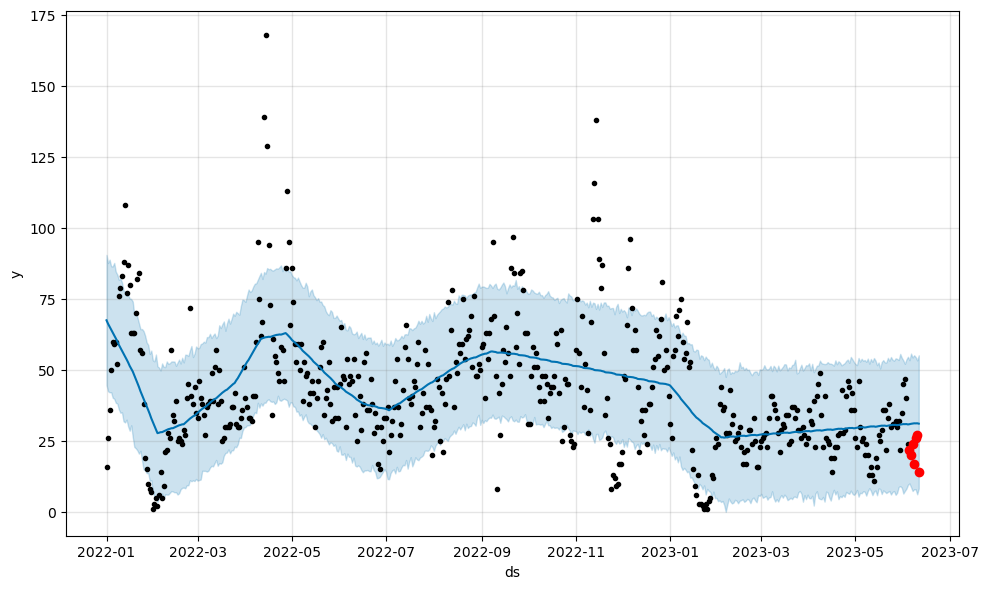

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  31.146515    7.404133   54.402682
523 2023-06-08  31.236774    8.024284   55.196294
524 2023-06-09  31.220919    7.989470   54.563772
525 2023-06-10  31.248602    6.236966   53.399161
526 2023-06-11  31.121364    8.305538   55.182542
[22 20 24 17 26 27 14]
---
[30.9335673  31.06238555 31.14651458 31.23677364 31.22091904 31.24860181
 31.1213639 ]
SMAPE: 0.3867945292416934


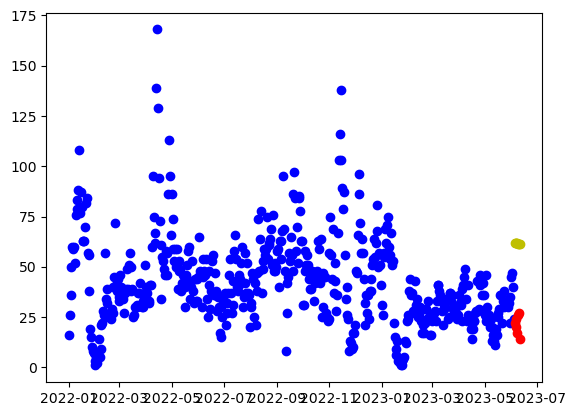

17:01:26 - cmdstanpy - INFO - Chain [1] start processing


[22 20 24 17 26 27 14]
---
[61.86019116 61.65616507 61.64638656 61.7049655  61.5999954  61.24787523
 61.37297528]
SMAPE_lr: 0.976004353148159


17:01:27 - cmdstanpy - INFO - Chain [1] done processing


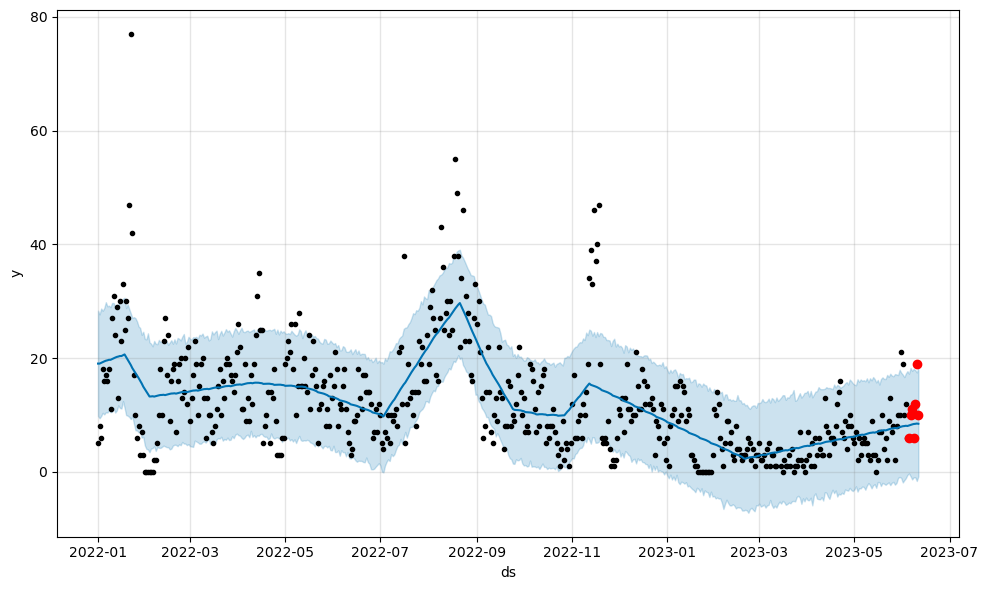

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  8.327309   -1.344894   17.737607
523 2023-06-08  8.403857   -0.978805   18.092736
524 2023-06-09  8.433631   -0.966665   17.879005
525 2023-06-10  8.484226   -1.616797   17.475374
526 2023-06-11  8.444609   -0.787511   18.210578
[ 6 10 11  6 12 19 10]
---
[8.14824415 8.259761   8.32730899 8.40385659 8.433631   8.4842256
 8.44460902]
SMAPE: 0.3410832972396281


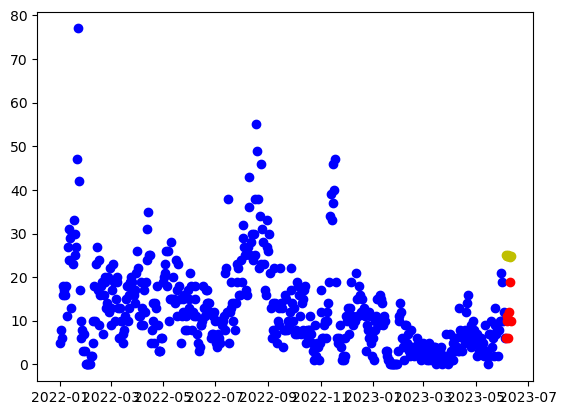

17:01:28 - cmdstanpy - INFO - Chain [1] start processing


[ 6 10 11  6 12 19 10]
---
[25.11332686 24.93430623 24.94953319 25.0331176  24.95315296 24.62603826
 24.77614377]
SMAPE_lr: 0.8421543032862189


17:01:28 - cmdstanpy - INFO - Chain [1] done processing


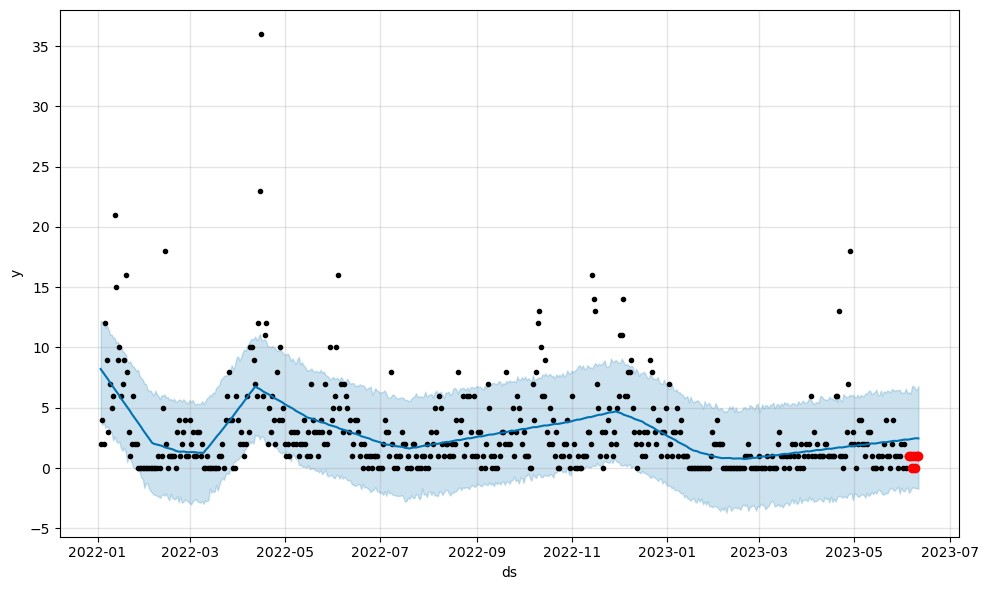

            ds      yhat  yhat_lower  yhat_upper
520 2023-06-07  2.410281   -1.610849    6.813522
521 2023-06-08  2.436281   -1.625269    6.784615
522 2023-06-09  2.468085   -1.655989    6.582698
523 2023-06-10  2.472873   -1.668558    6.457637
524 2023-06-11  2.458193   -1.713311    6.813241
[1 1 0 1 0 1 1]
---
[2.3731493  2.39355026 2.41028075 2.43628053 2.46808493 2.47287253
 2.45819346]
SMAPE: 1.1661358708639213


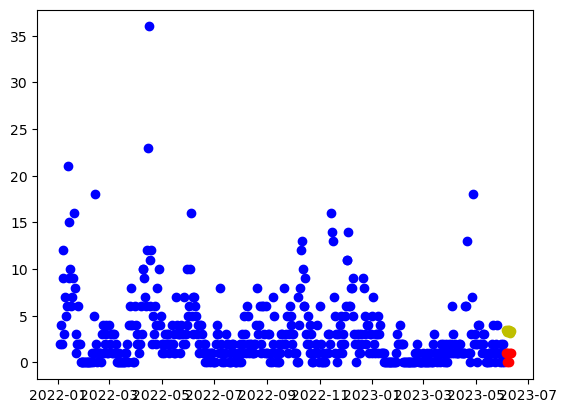

17:01:29 - cmdstanpy - INFO - Chain [1] start processing


[1 1 0 1 0 1 1]
---
[3.44656383 3.30736552 3.36241481 3.48582153 3.44567922 3.15838684
 3.34831468]
SMAPE_lr: 1.342611510418829


17:01:29 - cmdstanpy - INFO - Chain [1] done processing


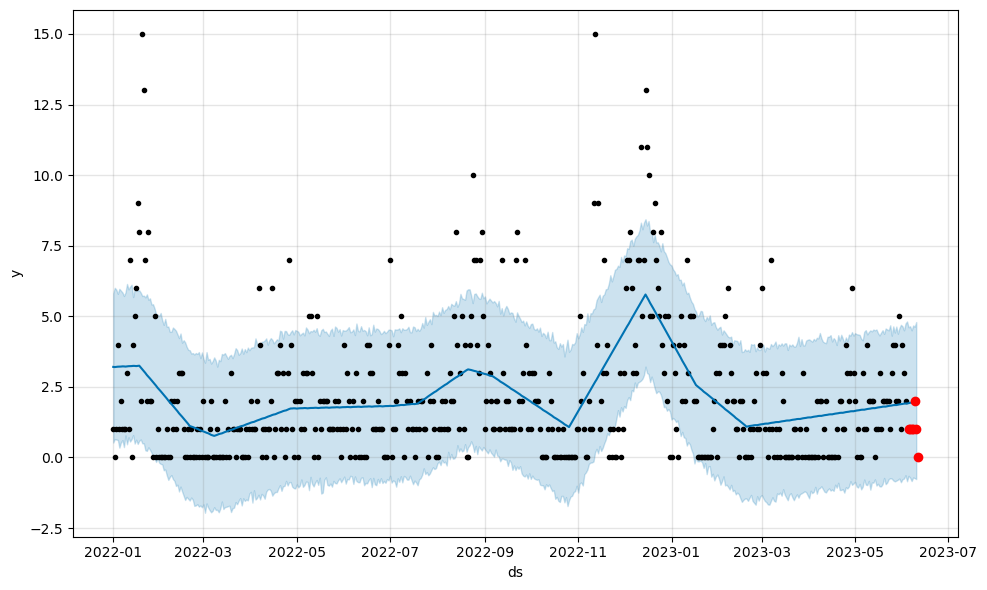

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-06  1.935734   -0.716783    4.648457
522 2023-06-07  1.943226   -0.834201    4.504668
523 2023-06-08  1.950697   -0.709625    4.677589
524 2023-06-09  1.962643   -0.728998    4.631041
525 2023-06-10  1.966915   -0.766072    4.797979
[1 1 1 1 2 1 0]
---
[1.9113244  1.9250388  1.93573407 1.94322563 1.95069729 1.96264284
 1.96691527]
SMAPE: 0.7445414849911446


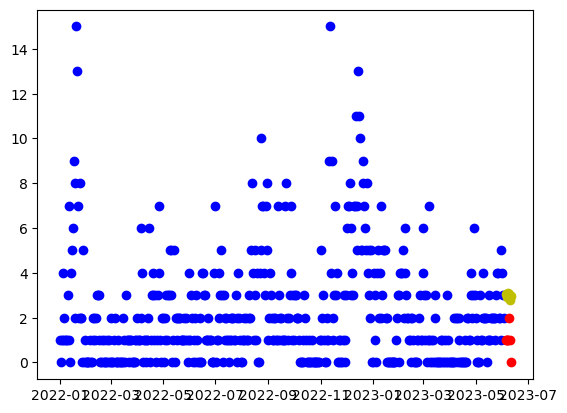

17:01:30 - cmdstanpy - INFO - Chain [1] start processing


[1 1 1 1 2 1 0]
---
[3.06609879 2.92794858 2.98404597 3.10850081 3.0694066  2.78316233
 2.97413827]
SMAPE_lr: 1.0549866703924728


17:01:30 - cmdstanpy - INFO - Chain [1] done processing


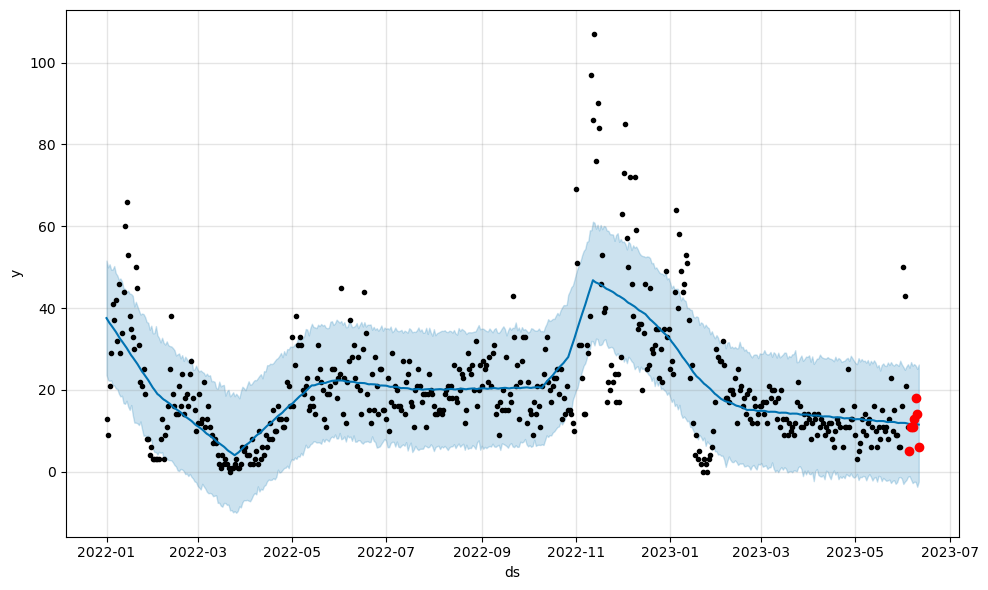

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  11.702521   -2.787201   25.895512
523 2023-06-08  11.700030   -2.462663   26.313187
524 2023-06-09  11.696246   -2.481659   25.942140
525 2023-06-10  11.619712   -3.688248   25.137961
526 2023-06-11  11.504550   -2.433494   26.200136
[ 5 11 11 13 18 14  6]
---
[11.66605493 11.71171591 11.70252124 11.70002993 11.69624593 11.61971151
 11.50454986]
SMAPE: 0.3241533538806462


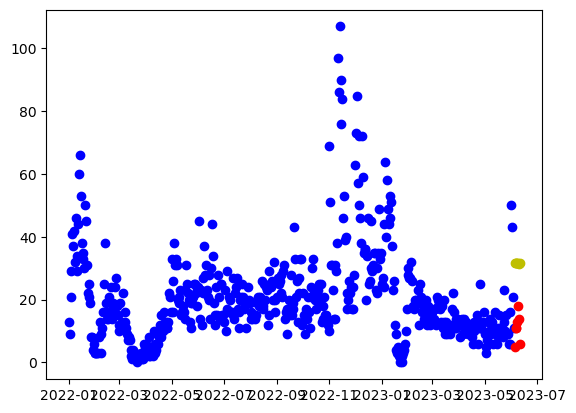

17:01:31 - cmdstanpy - INFO - Chain [1] start processing


[ 5 11 11 13 18 14  6]
---
[31.7952343  31.6303924  31.6597981  31.75756124 31.69177534 31.37883938
 31.54312362]
SMAPE_lr: 0.9869772557558368


17:01:31 - cmdstanpy - INFO - Chain [1] done processing


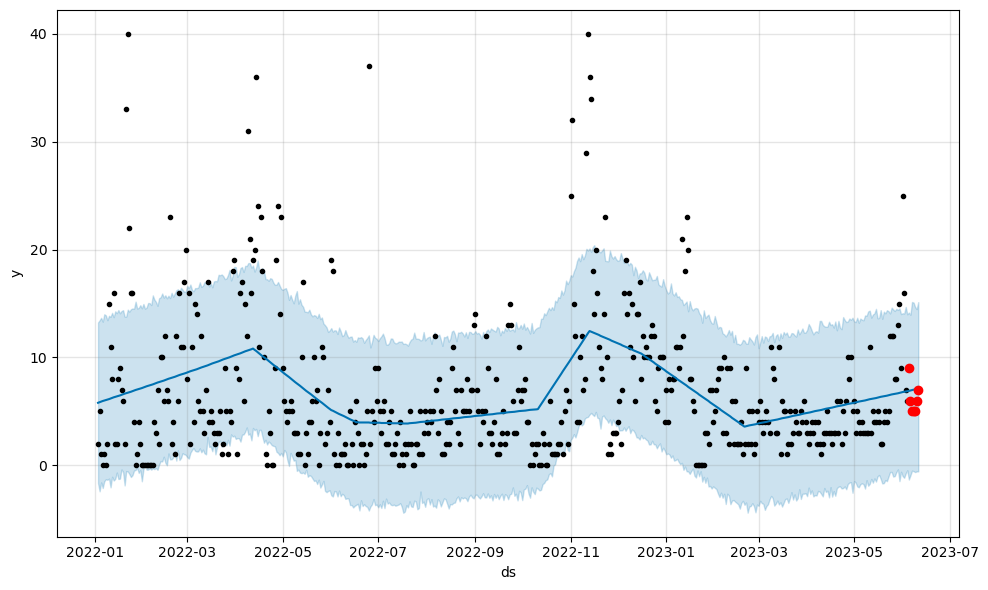

            ds      yhat  yhat_lower  yhat_upper
520 2023-06-07  6.966460   -0.501937   15.144548
521 2023-06-08  7.011253   -0.545225   15.087363
522 2023-06-09  7.036006   -0.631789   14.678494
523 2023-06-10  7.070928   -0.566883   14.484417
524 2023-06-11  7.082420   -0.565195   15.131424
[9 6 5 5 5 6 7]
---
[6.89673555 6.93537706 6.9664598  7.01125327 7.03600599 7.07092819
 7.08242021]
SMAPE: 0.2266692091310101


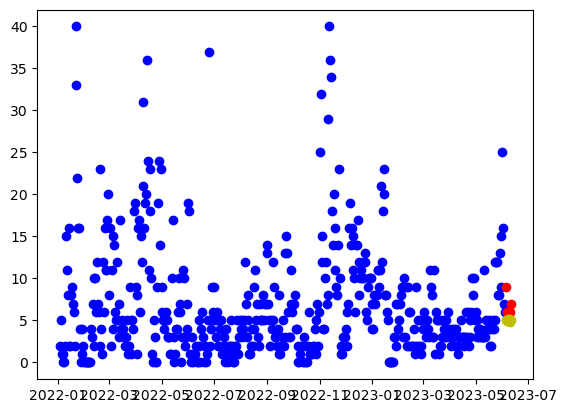

17:01:32 - cmdstanpy - INFO - Chain [1] start processing


[9 6 5 5 5 6 7]
---
[5.1096371  4.97694322 5.03849693 5.16840808 5.13477019 4.85398223
 5.05041449]
SMAPE_lr: 0.19142563455538783


17:01:32 - cmdstanpy - INFO - Chain [1] done processing


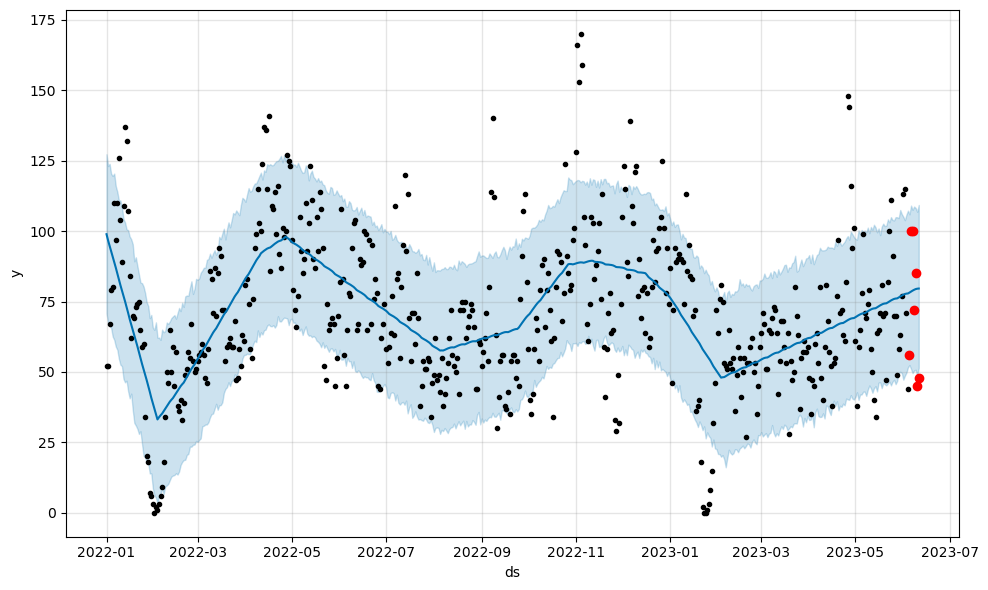

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  78.871895   49.588115  107.555979
523 2023-06-08  79.167182   50.535538  108.718779
524 2023-06-09  79.416069   50.762472  108.207071
525 2023-06-10  79.551356   48.725735  106.871786
526 2023-06-11  79.612241   51.471273  109.281197
[ 56 100 100  72  85  45  48]
---
[78.17781197 78.54482435 78.87189478 79.1671821  79.41606865 79.55135603
 79.61224088]
SMAPE: 0.2885926629800609


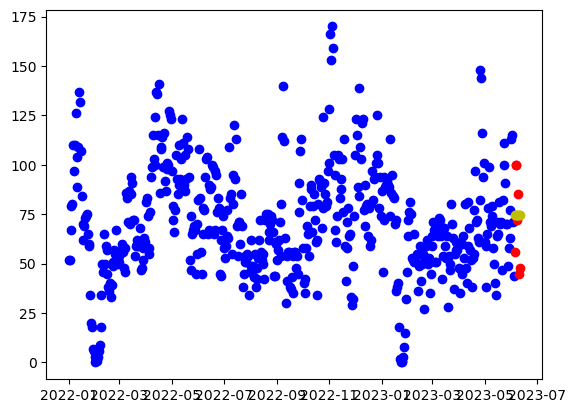

17:01:33 - cmdstanpy - INFO - Chain [1] start processing


[ 56 100 100  72  85  45  48]
---
[74.86357888 74.70924066 74.74915004 74.85741687 74.80213465 74.49970236
 74.67449029]
SMAPE_lr: 0.2802793310143081


17:01:33 - cmdstanpy - INFO - Chain [1] done processing


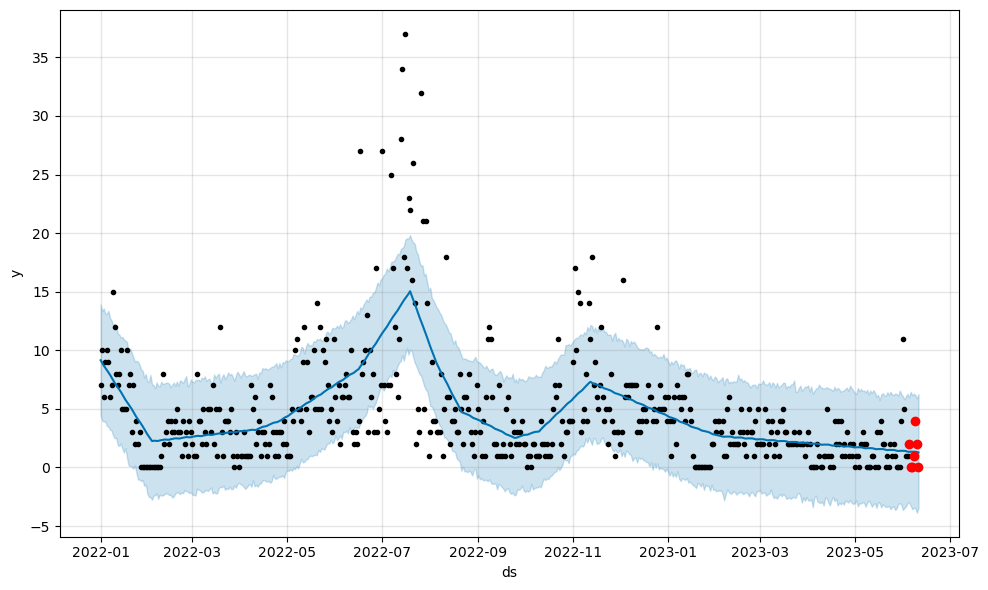

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  1.343977   -3.564113    6.151556
523 2023-06-08  1.342665   -3.454088    6.292566
524 2023-06-09  1.343250   -3.459218    6.173905
525 2023-06-10  1.317265   -3.869019    5.903389
526 2023-06-11  1.275686   -3.440698    6.254071
[2 0 0 1 4 2 0]
---
[1.32865878 1.34426675 1.34397739 1.34266526 1.34325048 1.31726538
 1.27568586]
SMAPE: 1.1574243442927696


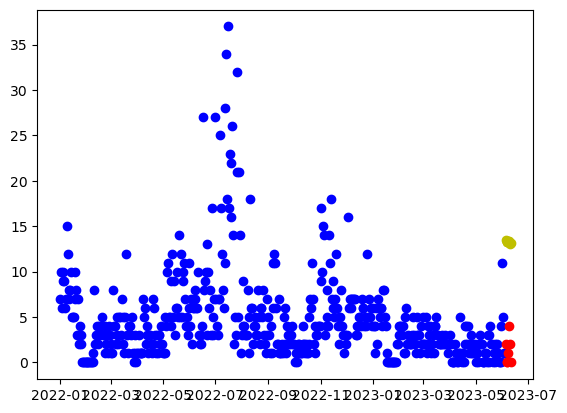

17:01:34 - cmdstanpy - INFO - Chain [1] start processing


[2 0 0 1 4 2 0]
---
[13.44240583 13.28109624 13.31403425 13.41532969 13.3530761  13.04367244
 13.21148899]
SMAPE_lr: 1.6786645505291953


17:01:34 - cmdstanpy - INFO - Chain [1] done processing


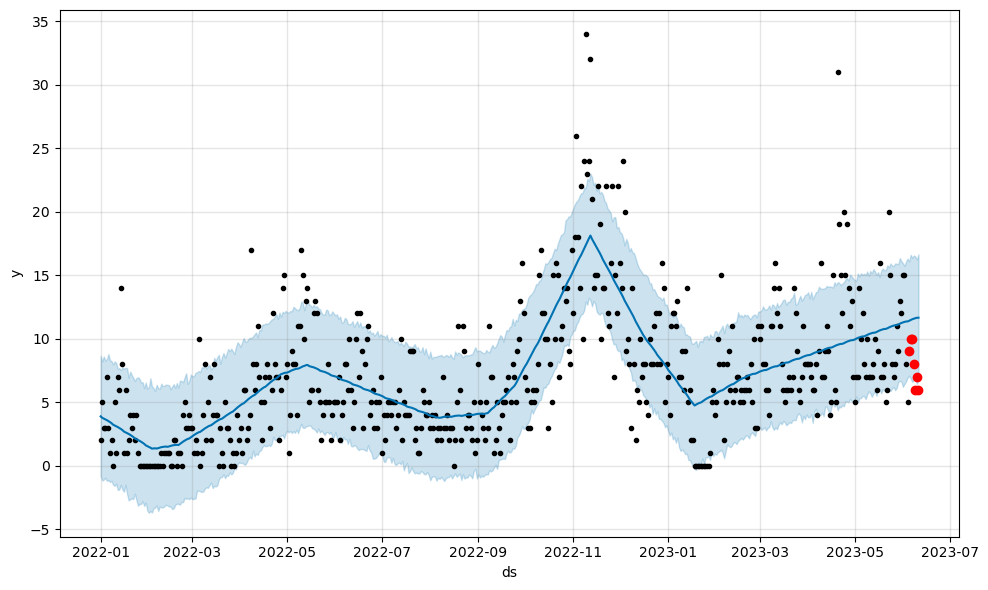

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  11.539457    6.611998   16.366007
523 2023-06-08  11.584230    6.766949   16.556753
524 2023-06-09  11.625029    6.803609   16.469569
525 2023-06-10  11.655672    6.461414   16.252766
526 2023-06-11  11.659955    6.924792   16.654723
[ 9 10 10  8  6  7  6]
---
[11.41788225 11.47965621 11.53945664 11.58422976 11.62502858 11.65567236
 11.65995455]
SMAPE: 0.380285264104618


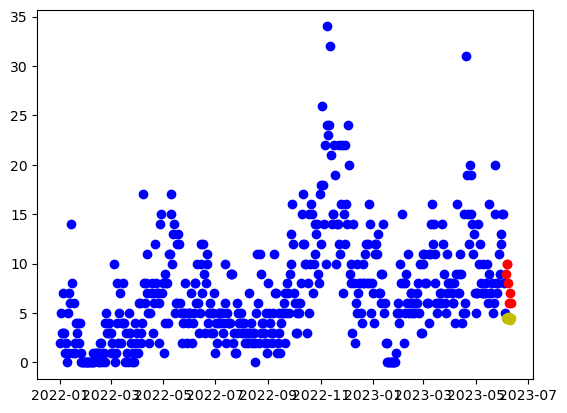

17:01:35 - cmdstanpy - INFO - Chain [1] start processing


[ 9 10 10  8  6  7  6]
---
[4.50066661 4.37623745 4.44605588 4.58423176 4.55885859 4.28633536
 4.49103235]
SMAPE_lr: 0.5431725749571102


17:01:35 - cmdstanpy - INFO - Chain [1] done processing


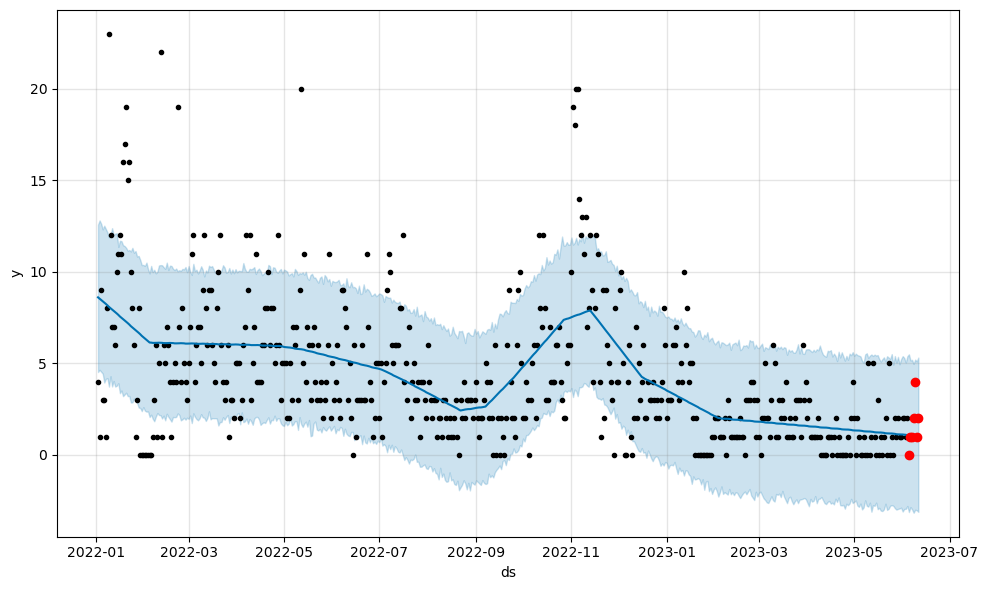

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-07  1.059085   -2.982094    5.191990
522 2023-06-08  1.058280   -3.167454    4.968887
523 2023-06-09  1.049768   -3.002988    5.204258
524 2023-06-10  1.039069   -3.028438    5.104444
525 2023-06-11  1.018888   -3.118360    5.313953
[0 1 1 2 4 1 2]
---
[1.06551797 1.0652642  1.05908498 1.05827991 1.04976753 1.03906868
 1.01888821]
SMAPE: 0.6561722648362345


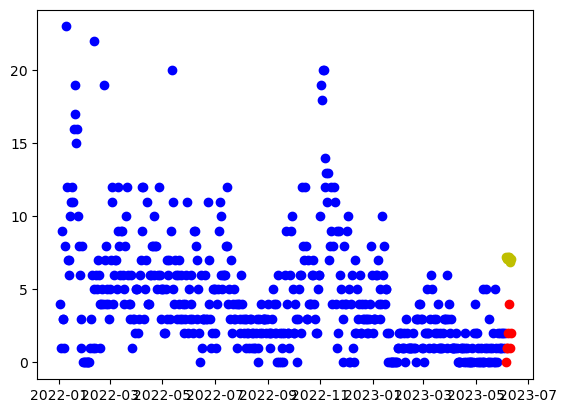

17:01:36 - cmdstanpy - INFO - Chain [1] start processing


[0 1 1 2 4 1 2]
---
[7.22436745 7.07731865 7.12451744 7.24007367 7.19208086 6.89693798
 7.07901532]
SMAPE_lr: 1.3327706795061152


17:01:36 - cmdstanpy - INFO - Chain [1] done processing


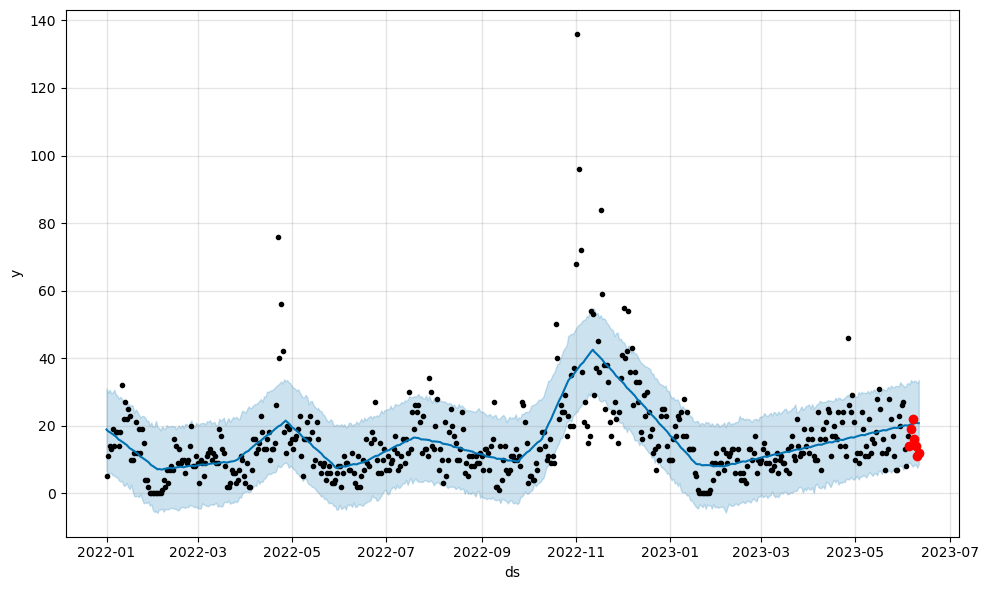

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  20.580428    7.898961   32.918504
523 2023-06-08  20.671311    8.369227   33.374641
524 2023-06-09  20.832470    8.507507   33.216535
525 2023-06-10  20.805783    7.562081   32.593024
526 2023-06-11  20.756994    8.652532   33.565543
[14 19 22 16 14 11 12]
---
[20.27794974 20.40262132 20.58042794 20.67131101 20.83246962 20.80578269
 20.75699393]
SMAPE: 0.32892960014123124


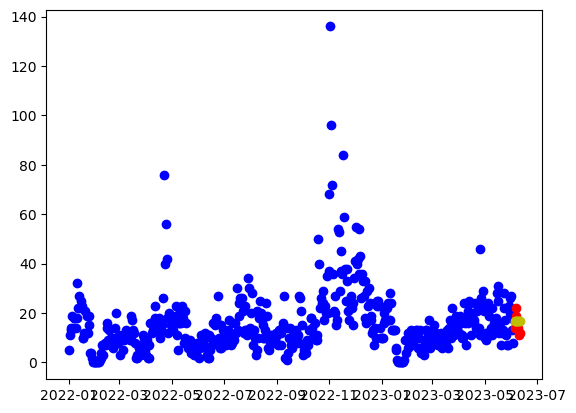

17:01:37 - cmdstanpy - INFO - Chain [1] start processing


[14 19 22 16 14 11 12]
---
[16.89735181 16.76196539 16.82082656 16.94804518 16.91171475 16.62823426
 16.82197398]
SMAPE_lr: 0.2239287861361505


17:01:37 - cmdstanpy - INFO - Chain [1] done processing


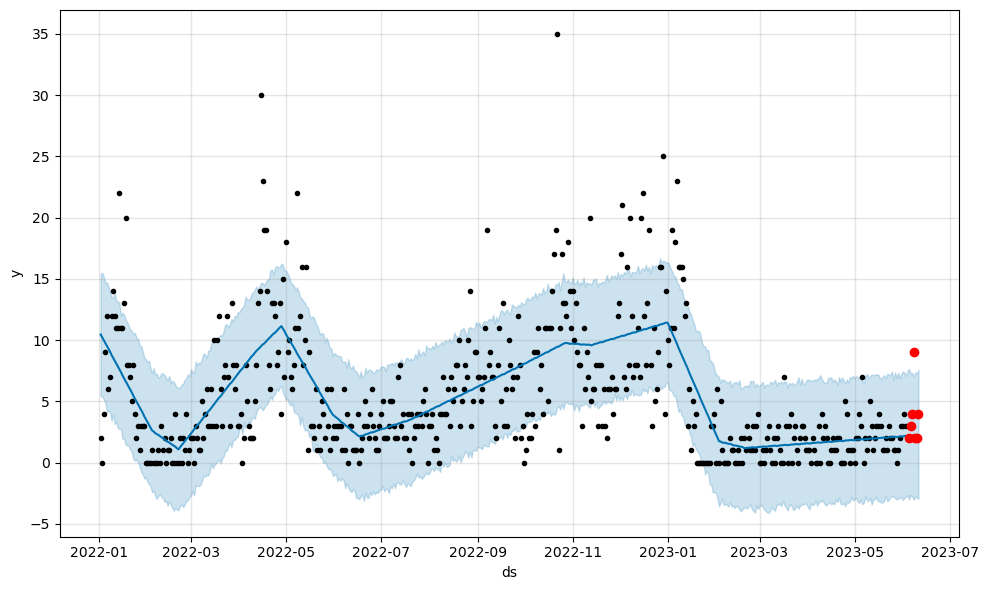

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-07  2.213240   -2.786223    7.326179
522 2023-06-08  2.217697   -3.022917    7.037359
523 2023-06-09  2.242428   -2.771747    7.375378
524 2023-06-10  2.252778   -2.858601    7.282174
525 2023-06-11  2.221139   -2.951215    7.578962
[2 3 4 9 2 2 4]
---
[2.17424214 2.20690207 2.21323982 2.21769685 2.24242799 2.25277822
 2.22113889]
SMAPE: 0.4253598867504986


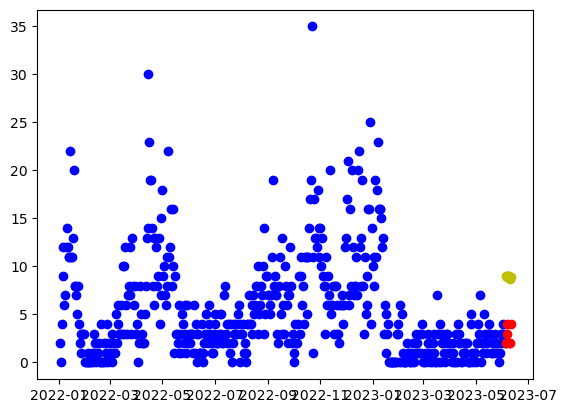

17:01:38 - cmdstanpy - INFO - Chain [1] start processing


[2 3 4 9 2 2 4]
---
[8.99933309 8.8521193  8.89915309 9.01454432 8.96638651 8.67107864
 8.85299098]
SMAPE_lr: 0.8996272827344667


17:01:38 - cmdstanpy - INFO - Chain [1] done processing


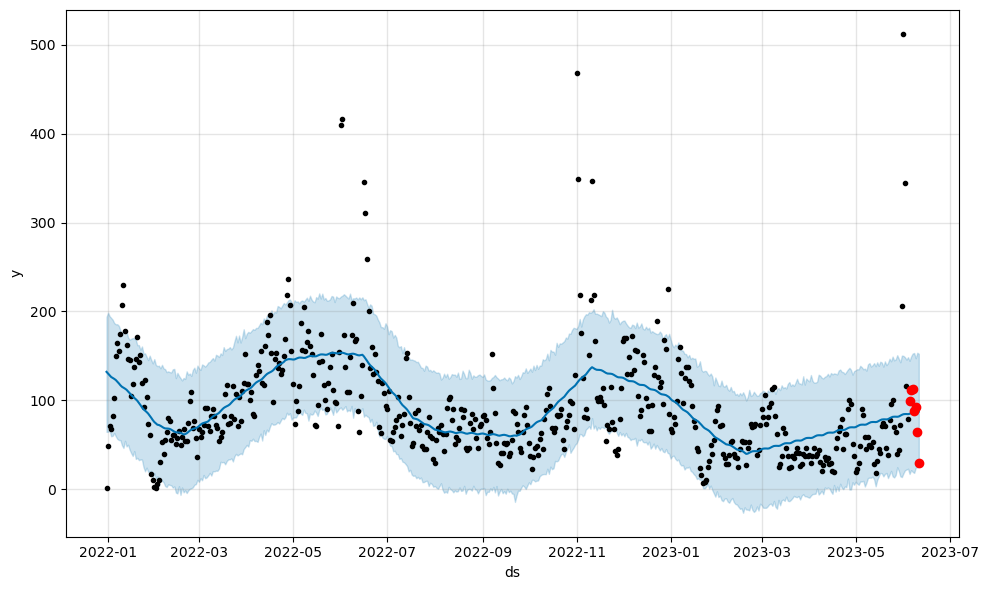

            ds       yhat  yhat_lower  yhat_upper
523 2023-06-07  86.711475   19.743783  152.656558
524 2023-06-08  87.433093   18.457955  153.299645
525 2023-06-09  87.623666   24.292021  147.434066
526 2023-06-10  87.642542   24.584676  153.585007
527 2023-06-11  87.530302   28.160520  152.426156
[ 99 112 113  88  93  64  30]
---
[84.85321819 85.79871997 86.71147478 87.43309276 87.623666   87.64254226
 87.53030152]
SMAPE: 0.2912693871936898


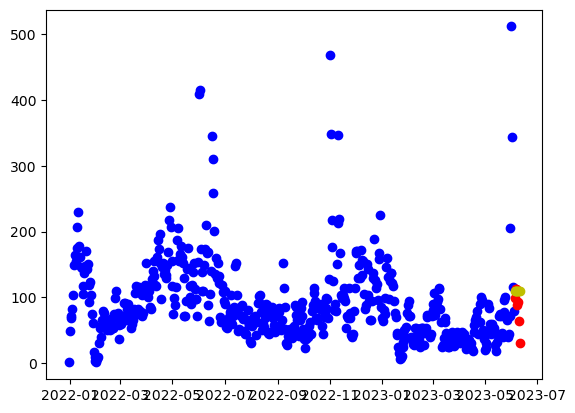

17:01:39 - cmdstanpy - INFO - Chain [1] start processing


[ 99 112 113  88  93  64  30]
---
[110.42252245 110.18024168 110.13220851 110.15253278 110.00930801
 109.61893318 109.70577856]
SMAPE_lr: 0.3155560755156706


17:01:39 - cmdstanpy - INFO - Chain [1] done processing


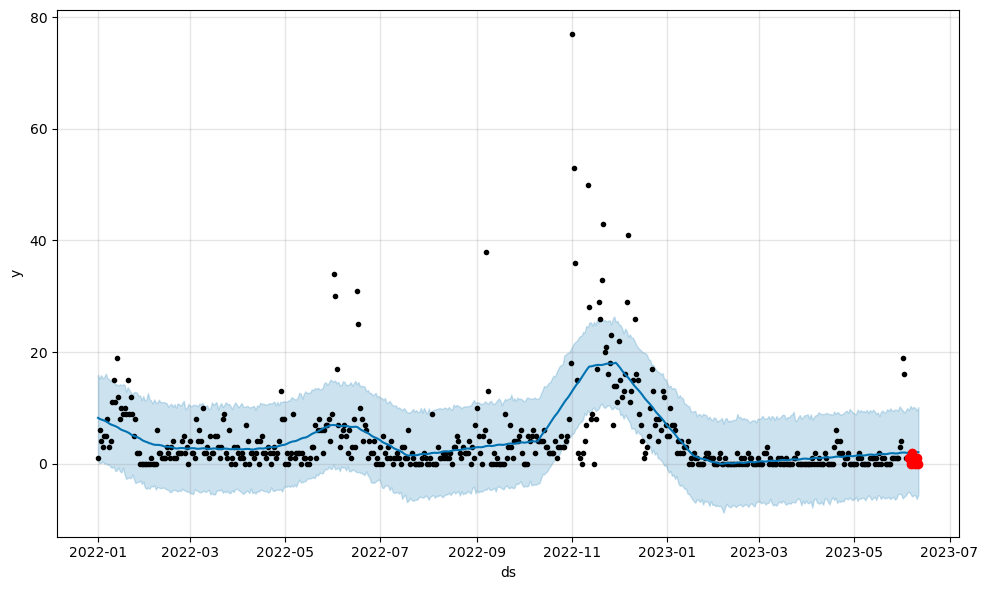

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  2.110485   -5.860474    9.918209
523 2023-06-08  2.129248   -5.663753   10.173106
524 2023-06-09  2.137202   -5.662224    9.974028
525 2023-06-10  2.082150   -6.315915    9.518692
526 2023-06-11  2.077305   -5.582584   10.155627
[1 0 2 1 0 1 0]
---
[1.9936608  2.0563532  2.11048505 2.12924791 2.13720172 2.08215043
 2.07730543]
SMAPE: 1.1630776204460314


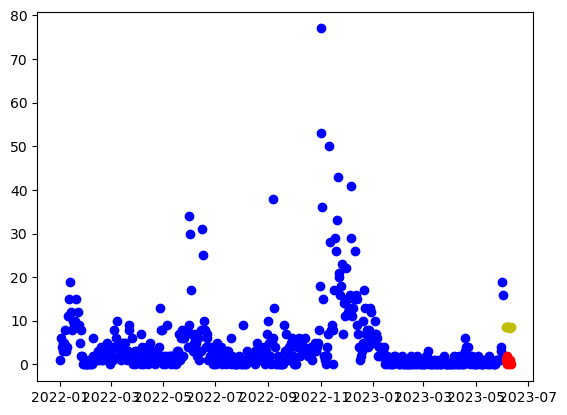

17:01:40 - cmdstanpy - INFO - Chain [1] start processing


[1 0 2 1 0 1 0]
---
[8.65989053 8.51209404 8.55854513 8.67335367 8.62461317 8.3287226
 8.51005225]
SMAPE_lr: 1.7122780260060577


17:01:40 - cmdstanpy - INFO - Chain [1] done processing


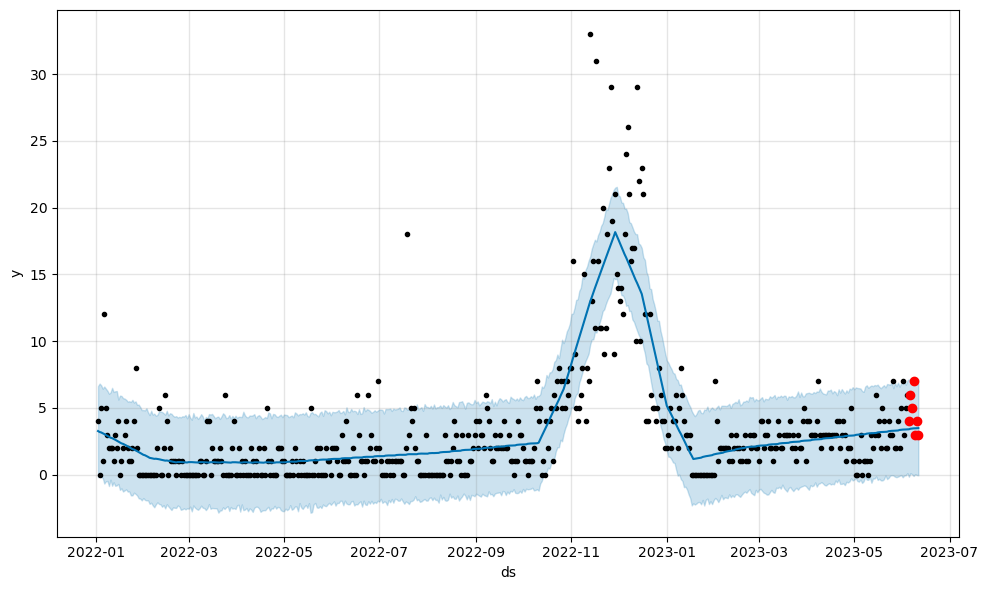

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-07  3.458780    0.034063    6.961230
522 2023-06-08  3.468408   -0.097895    6.760825
523 2023-06-09  3.471926    0.037131    6.988084
524 2023-06-10  3.478562   -0.022819    6.909556
525 2023-06-11  3.488602   -0.048648    7.143844
[4 6 5 7 3 4 3]
---
[3.40070008 3.44097042 3.45878011 3.46840807 3.47192644 3.47856249
 3.48860188]
SMAPE: 0.3112971822759305


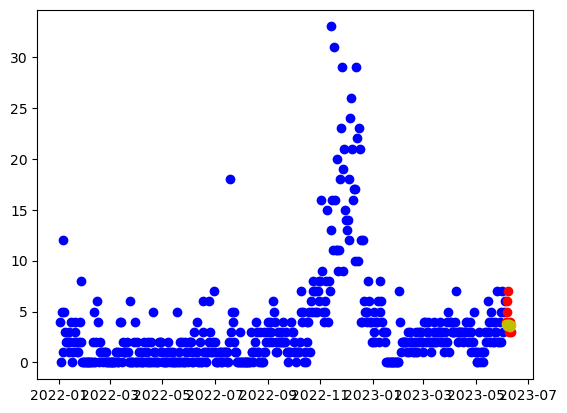

17:01:41 - cmdstanpy - INFO - Chain [1] start processing


[4 6 5 7 3 4 3]
---
[3.74491588 3.61046735 3.67026642 3.79842293 3.76303039 3.48048779
 3.67516541]
SMAPE_lr: 0.28995586625837755


17:01:41 - cmdstanpy - INFO - Chain [1] done processing


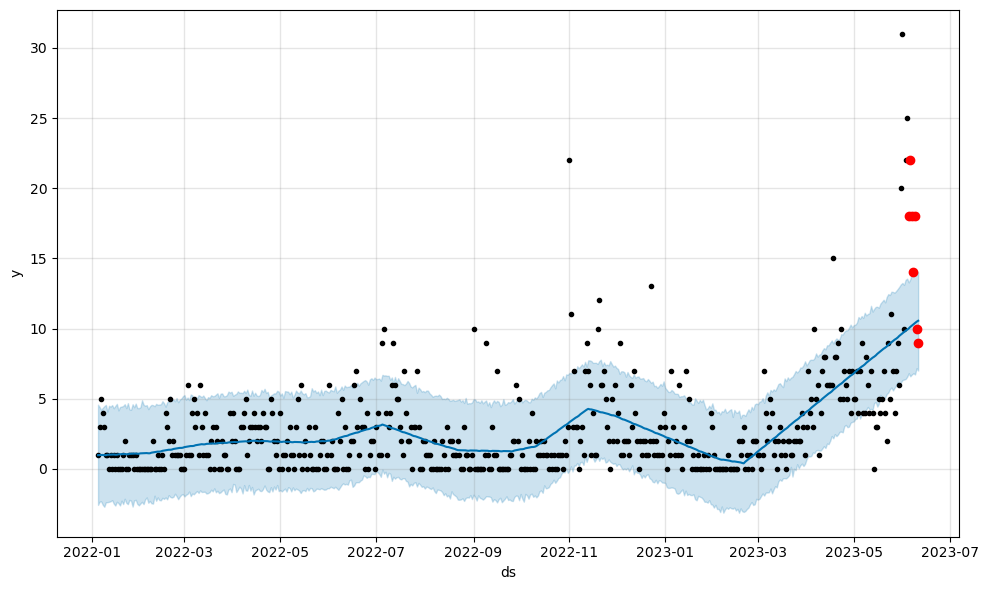

            ds       yhat  yhat_lower  yhat_upper
518 2023-06-07  10.208175    6.723981   13.890240
519 2023-06-08  10.301366    6.812828   13.911480
520 2023-06-09  10.391402    6.723299   13.950058
521 2023-06-10  10.482787    7.171130   14.078172
522 2023-06-11  10.554373    7.001377   14.011220
[18 22 18 14 18 10  9]
---
[10.00108048 10.11632673 10.20817503 10.30136647 10.39140208 10.48278692
 10.55437312]
SMAPE: 0.41575954221832945


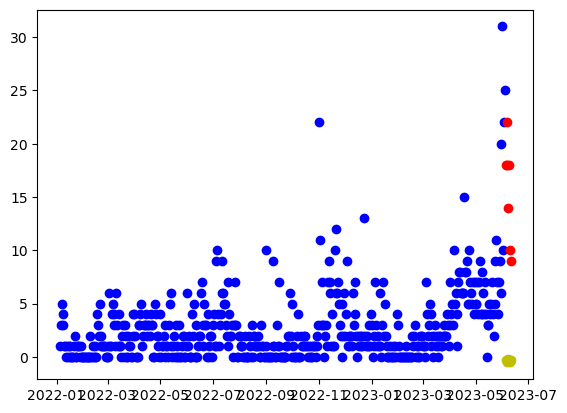

17:01:42 - cmdstanpy - INFO - Chain [1] start processing
17:01:42 - cmdstanpy - INFO - Chain [1] done processing


[18 22 18 14 18 10  9]
---
[0. 0. 0. 0. 0. 0. 0.]
SMAPE_lr: 2.0


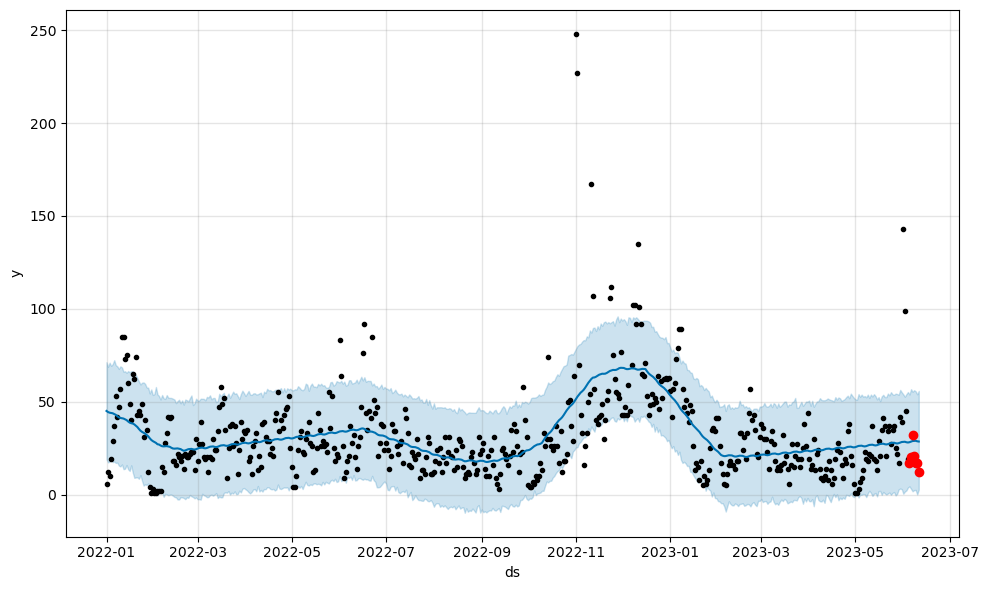

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  28.868901    1.799076   55.384742
523 2023-06-08  28.915909    2.441616   56.233686
524 2023-06-09  29.000549    2.512892   55.615225
525 2023-06-10  28.732348    0.118524   54.018973
526 2023-06-11  28.599287    2.654887   55.842865
[17 20 32 21 17 17 12]
---
[28.23337878 28.52993381 28.86890138 28.91590852 29.00054912 28.73234762
 28.59928737]
SMAPE: 0.4458322285519127


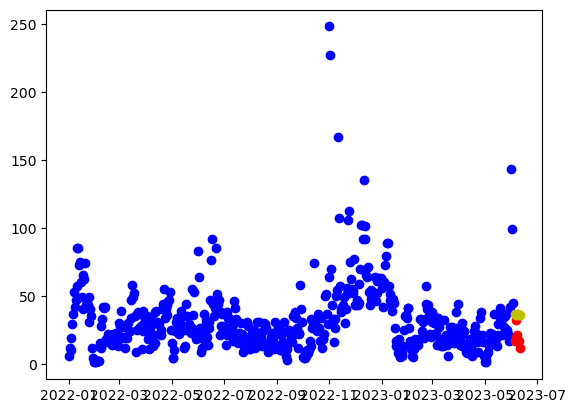

17:01:43 - cmdstanpy - INFO - Chain [1] start processing


[17 20 32 21 17 17 12]
---
[36.3401072  36.19409789 36.24233616 36.35893188 36.31197856 36.01787517
 36.200992  ]
SMAPE_lr: 0.6296381160776466


17:01:43 - cmdstanpy - INFO - Chain [1] done processing


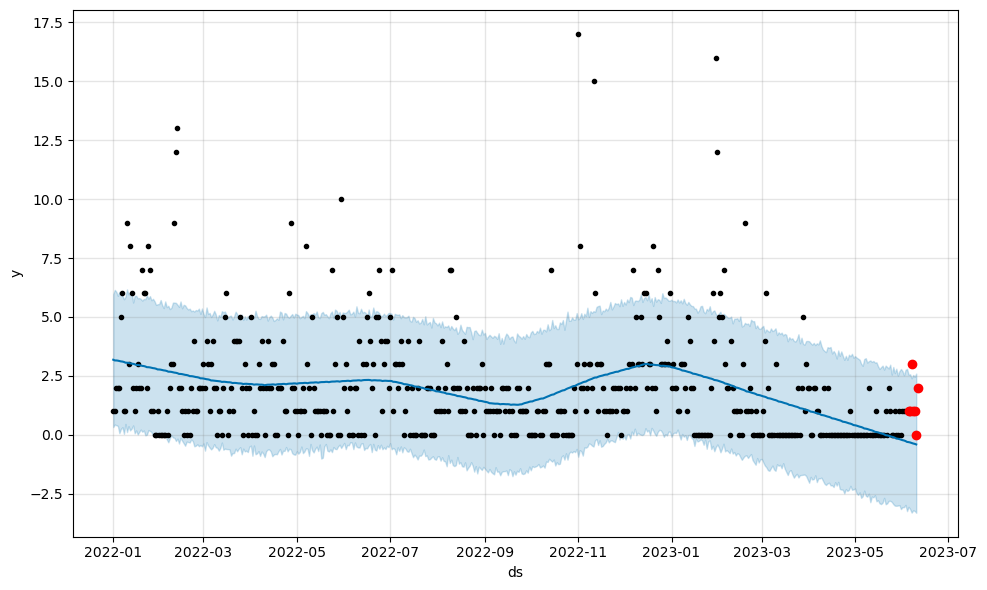

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-06 -0.319751   -3.145448    2.570993
522 2023-06-07 -0.342249   -3.294776    2.401526
523 2023-06-08 -0.363945   -3.198850    2.541898
524 2023-06-09 -0.378816   -3.222577    2.464696
525 2023-06-10 -0.403155   -3.301011    2.601011
[1 1 3 1 1 0 2]
---
[-0.2966213  -0.30507746 -0.3197514  -0.34224908 -0.3639447  -0.37881561
 -0.40315544]
SMAPE: 2.0


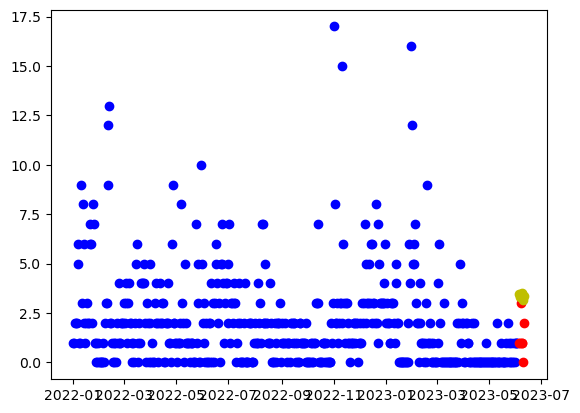

17:01:43 - cmdstanpy - INFO - Chain [1] start processing


[1 1 3 1 1 0 2]
---
[3.45857837 3.31770669 3.37108261 3.49281597 3.45100029 3.16203455
 3.35028902]
SMAPE_lr: 1.0012420045766293


17:01:43 - cmdstanpy - INFO - Chain [1] done processing


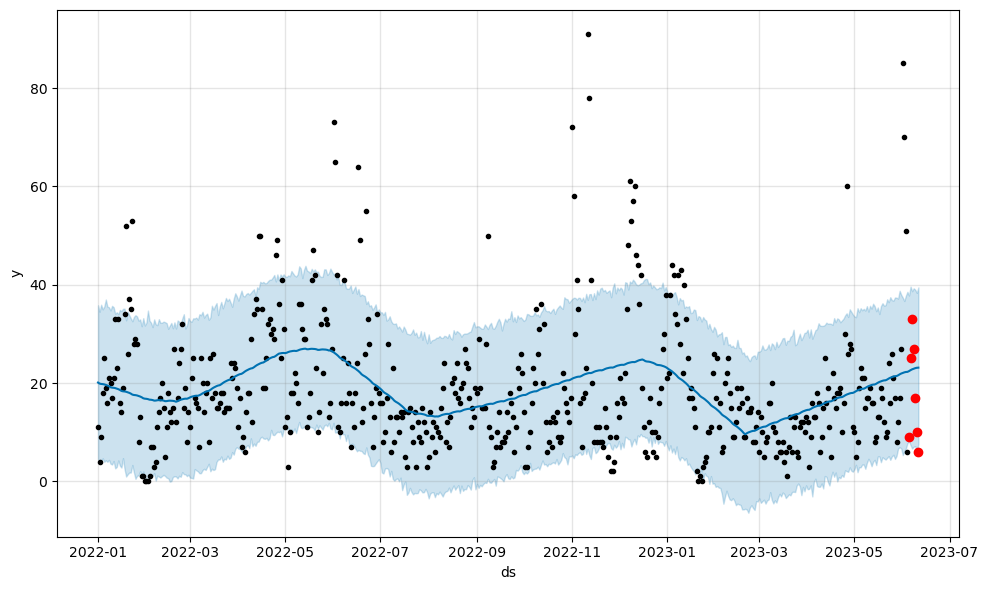

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  22.781268    6.656005   38.669605
523 2023-06-08  22.902165    7.027783   39.260857
524 2023-06-09  23.019294    7.147845   38.966854
525 2023-06-10  23.097563    5.952112   38.335660
526 2023-06-11  23.121857    7.616609   39.446255
[ 9 25 33 27 17 10  6]
---
[22.41502858 22.61459621 22.78126822 22.90216499 23.01929427 23.09756326
 23.12185715]
SMAPE: 0.5361452402806829


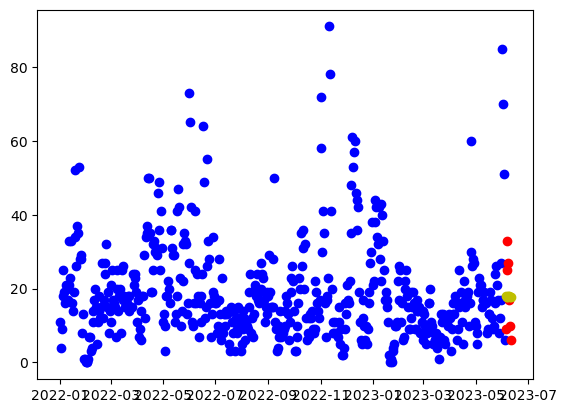

17:01:44 - cmdstanpy - INFO - Chain [1] start processing


[ 9 25 33 27 17 10  6]
---
[17.91593923 17.77908135 17.83647106 17.96221821 17.92441633 17.63946437
 17.83173263]
SMAPE_lr: 0.5139061194222604


17:01:44 - cmdstanpy - INFO - Chain [1] done processing


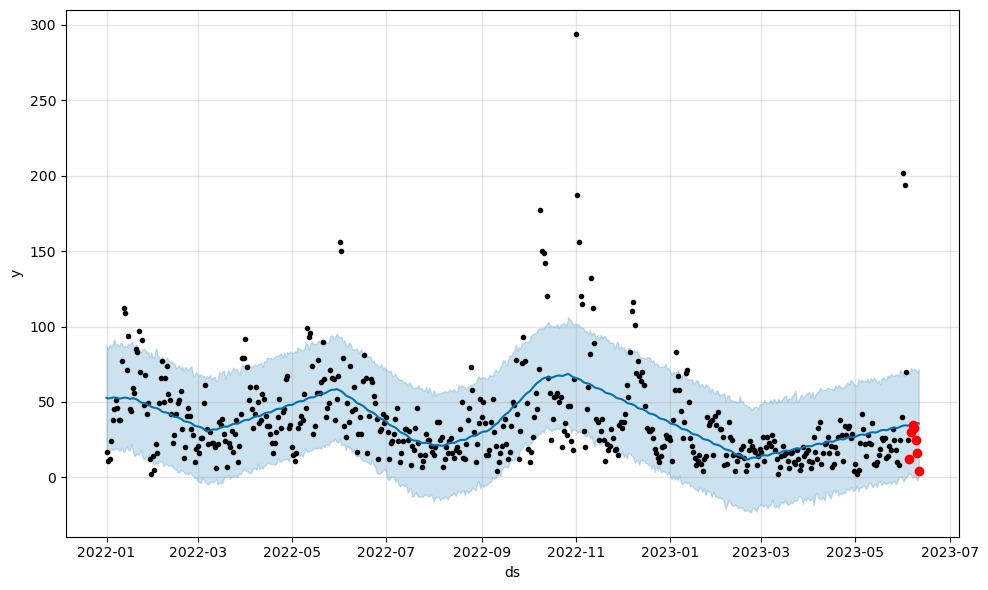

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  35.515572   -0.177261   70.644191
523 2023-06-08  35.842858    0.757501   72.011418
524 2023-06-09  35.997199    0.905918   71.256758
525 2023-06-10  35.947483   -1.960578   69.513426
526 2023-06-11  35.764855    1.477697   71.857593
[12 30 35 33 25 16  4]
---
[34.57536018 35.07954698 35.51557211 35.84285833 35.99719915 35.94748284
 35.76485545]
SMAPE: 0.5641327425548307


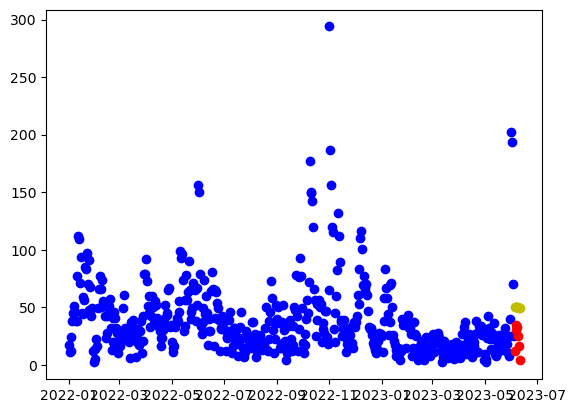

17:01:45 - cmdstanpy - INFO - Chain [1] start processing
17:01:45 - cmdstanpy - INFO - Chain [1] done processing


[12 30 35 33 25 16  4]
---
[50.02696757 49.84228974 49.85185951 49.92978672 49.84416489 49.511393
 49.65584132]
SMAPE_lr: 0.8386146017527129


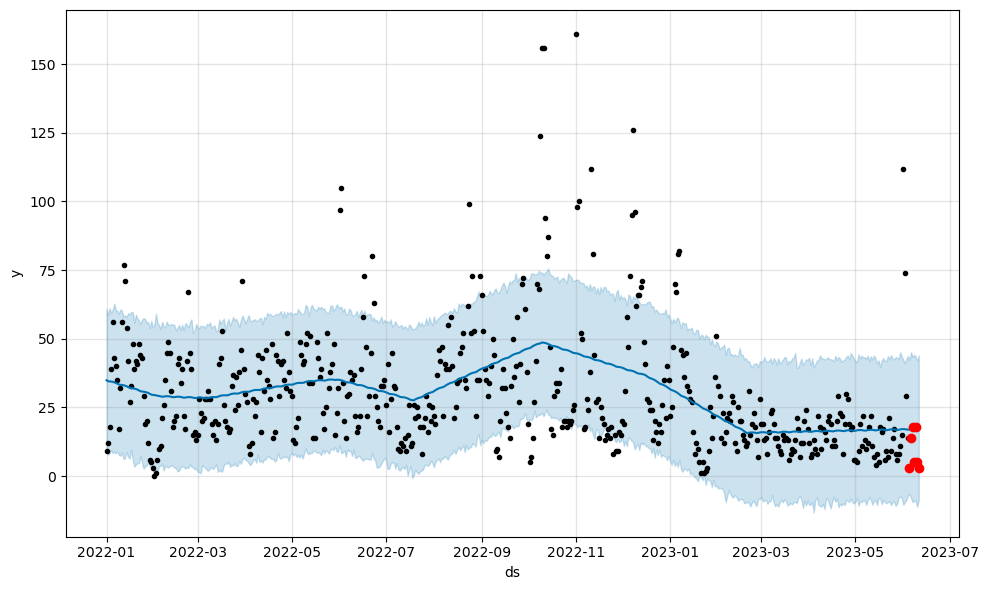

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  17.196496   -9.410130   43.410967
523 2023-06-08  17.222811   -8.975115   44.213329
524 2023-06-09  17.195067   -9.038857   43.507250
525 2023-06-10  17.113646  -11.174962   42.161981
526 2023-06-11  17.000844   -8.569031   43.931520
[ 3 14 18  5 18  5  3]
---
[16.96013644 17.120457   17.1964963  17.22281071 17.19506721 17.11364637
 17.00084362]
SMAPE: 0.7551959841531559


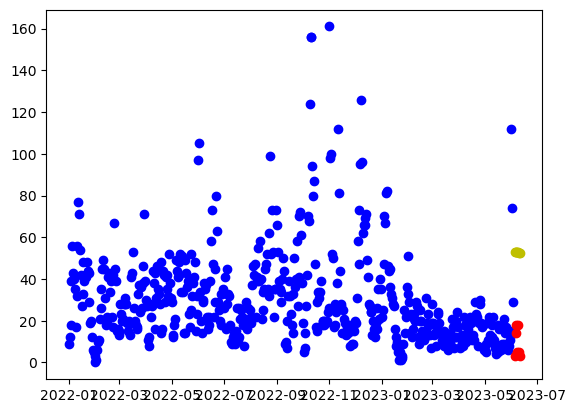

17:01:46 - cmdstanpy - INFO - Chain [1] start processing


[ 3 14 18  5 18  5  3]
---
[53.1578666  52.94968731 52.93575561 52.99018135 52.88105805 52.52478469
 52.64573154]
SMAPE_lr: 1.430123767053405


17:01:46 - cmdstanpy - INFO - Chain [1] done processing


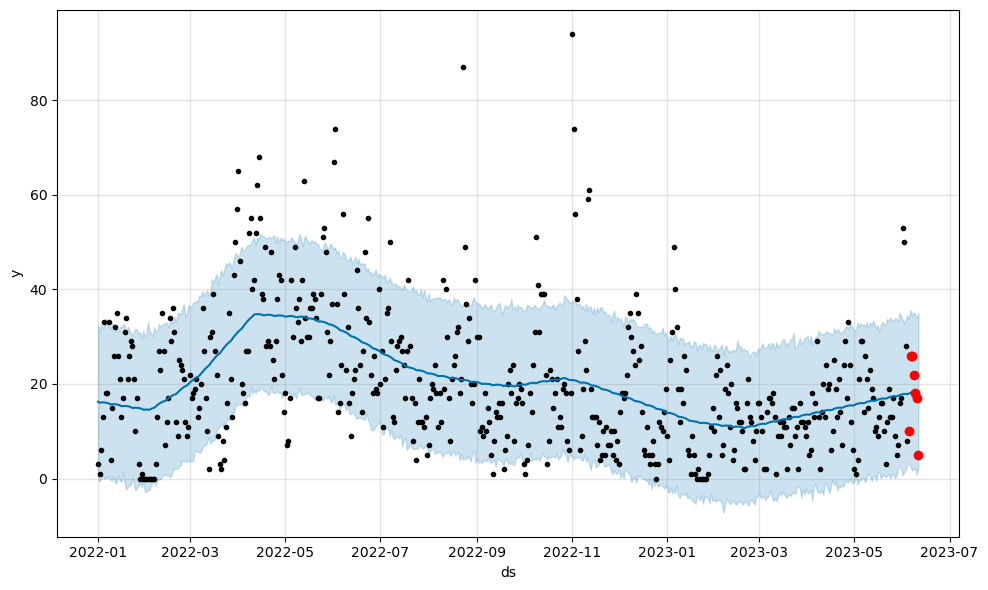

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  18.245773    1.699486   34.548614
523 2023-06-08  18.328489    2.038210   35.113956
524 2023-06-09  18.383035    2.097522   34.746644
525 2023-06-10  18.386948    0.794195   33.987923
526 2023-06-11  18.336311    2.434345   35.086590
[10 26 26 22 18 17  5]
---
[17.97719453 18.14915433 18.24577251 18.32848852 18.38303522 18.38694768
 18.33631059]
SMAPE: 0.3858445936818476


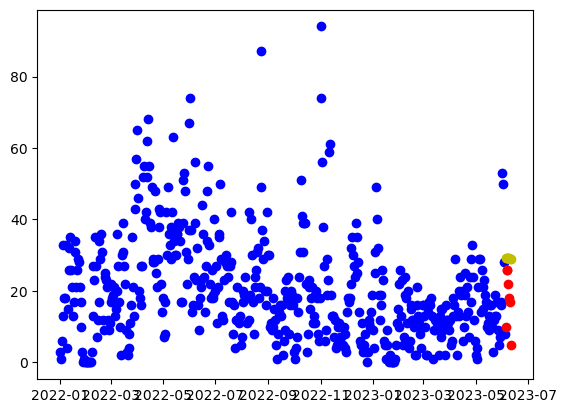

17:01:47 - cmdstanpy - INFO - Chain [1] start processing


[10 26 26 22 18 17  5]
---
[29.30885469 29.13792787 29.16124864 29.25292686 29.18105604 28.86203515
 29.02023447]
SMAPE_lr: 0.55675034909716


17:01:47 - cmdstanpy - INFO - Chain [1] done processing


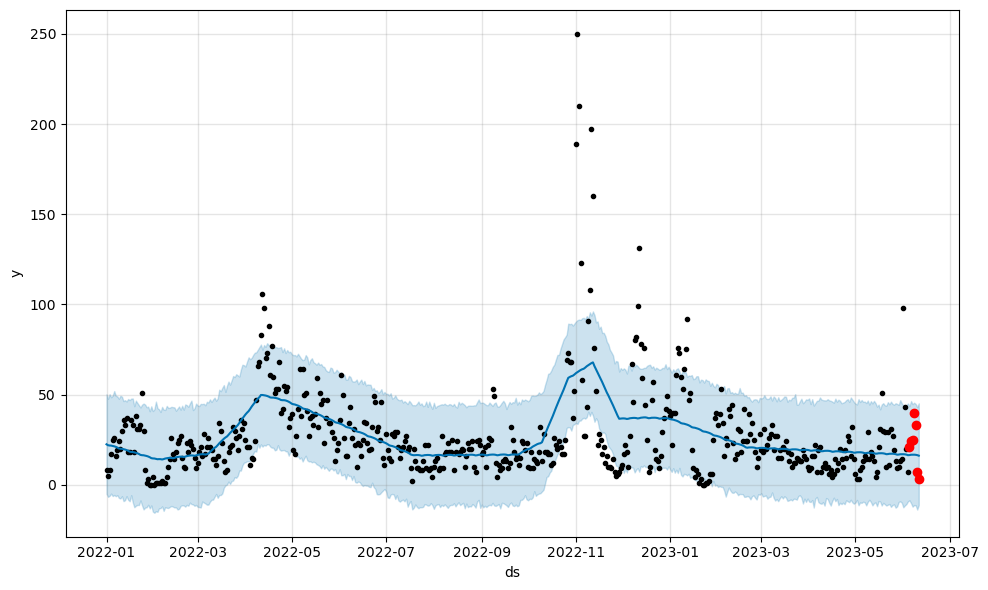

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  16.612975  -12.196821   44.642655
523 2023-06-08  16.635111  -11.320853   45.494577
524 2023-06-09  16.564633  -11.435255   44.766121
525 2023-06-10  16.394060  -13.809434   43.091197
526 2023-06-11  16.098180  -11.339519   45.134324
[21 24 25 40 33  7  3]
---
[16.42876862 16.60243926 16.61297472 16.63511132 16.56463285 16.39405999
 16.09818015]
SMAPE: 0.6678320508640938


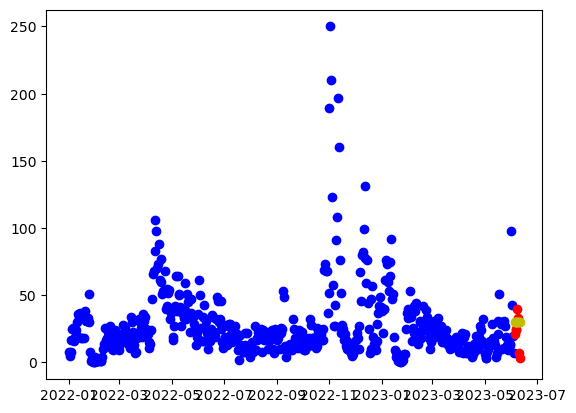

17:01:48 - cmdstanpy - INFO - Chain [1] start processing


[21 24 25 40 33  7  3]
---
[30.29587371 30.14861528 30.19560445 30.31095106 30.26274863 29.96739613
 30.14926385]
SMAPE_lr: 0.5743604085462298


17:01:48 - cmdstanpy - INFO - Chain [1] done processing


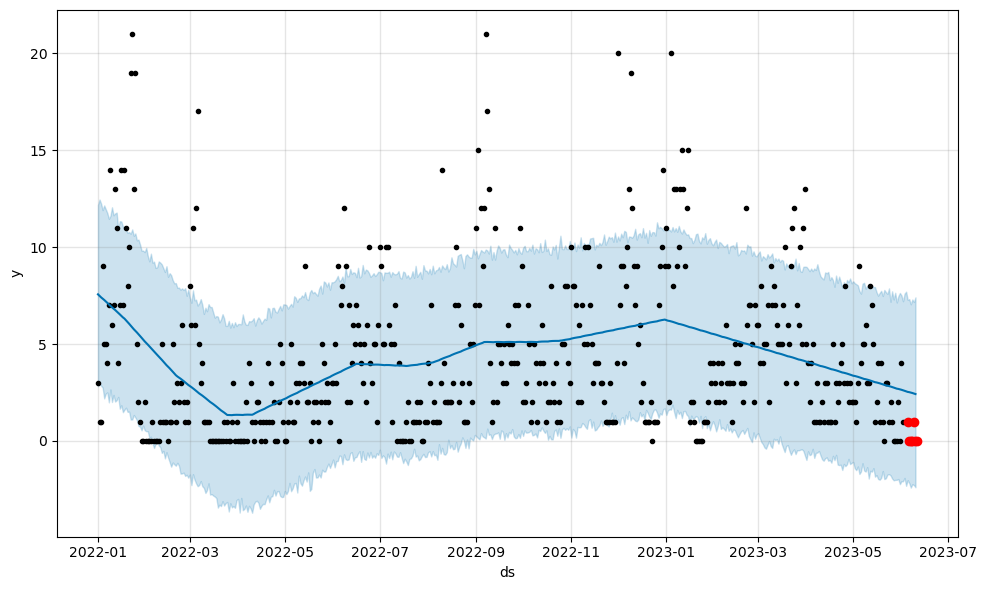

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-06  2.515347   -2.179094    7.316503
522 2023-06-07  2.494803   -2.410091    7.050359
523 2023-06-08  2.471802   -2.236612    7.298035
524 2023-06-09  2.447017   -2.276925    7.169725
525 2023-06-10  2.418471   -2.393039    7.408007
[1 0 0 0 1 0 0]
---
[2.557333   2.52908215 2.51534651 2.49480341 2.47180249 2.44701705
 2.4184708 ]
SMAPE: 1.674774691189596


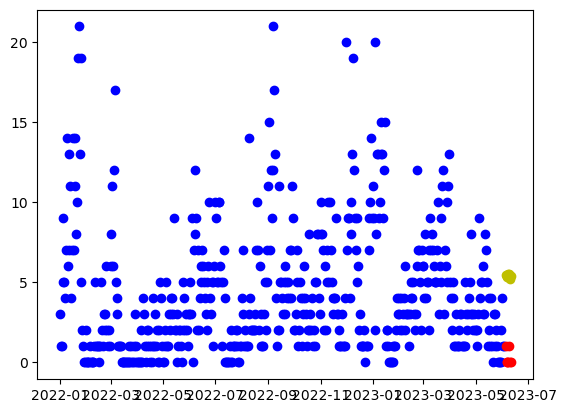

17:01:49 - cmdstanpy - INFO - Chain [1] start processing


[1 0 0 0 1 0 0]
---
[5.49767739 5.35944707 5.41546434 5.53983906 5.50066473 5.21434033
 5.40523616]
SMAPE_lr: 1.8241533892765254


17:01:49 - cmdstanpy - INFO - Chain [1] done processing


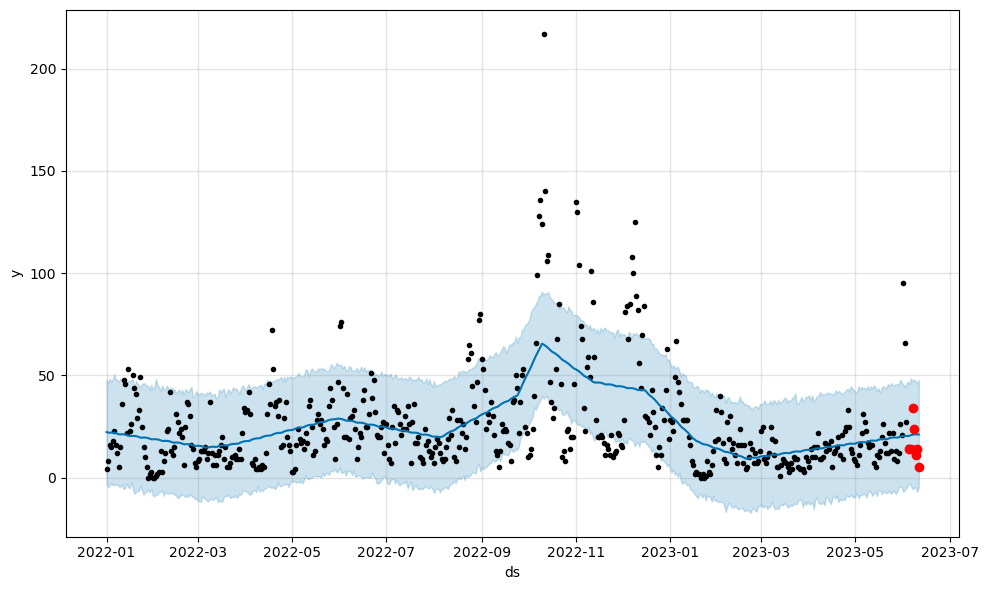

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  21.005049   -5.596760   47.062087
523 2023-06-08  21.147325   -4.866633   47.992423
524 2023-06-09  21.183686   -4.845656   47.337849
525 2023-06-10  21.160593   -6.946138   45.978868
526 2023-06-11  21.094824   -4.408796   47.879900
[14 14 34 24 11 14  5]
---
[20.48128029 20.82819807 21.005049   21.14732496 21.18368566 21.16059338
 21.09482355]
SMAPE: 0.5200899999548697


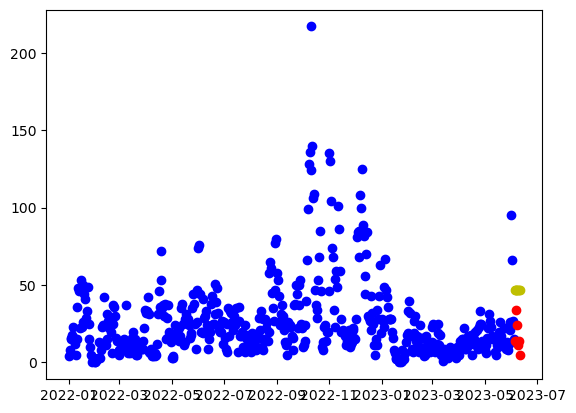

17:01:50 - cmdstanpy - INFO - Chain [1] start processing


[14 14 34 24 11 14  5]
---
[47.08964363 46.8944049  46.89341376 46.96078006 46.86459732 46.52126451
 46.65515192]
SMAPE_lr: 1.0081044959103636


17:01:50 - cmdstanpy - INFO - Chain [1] done processing


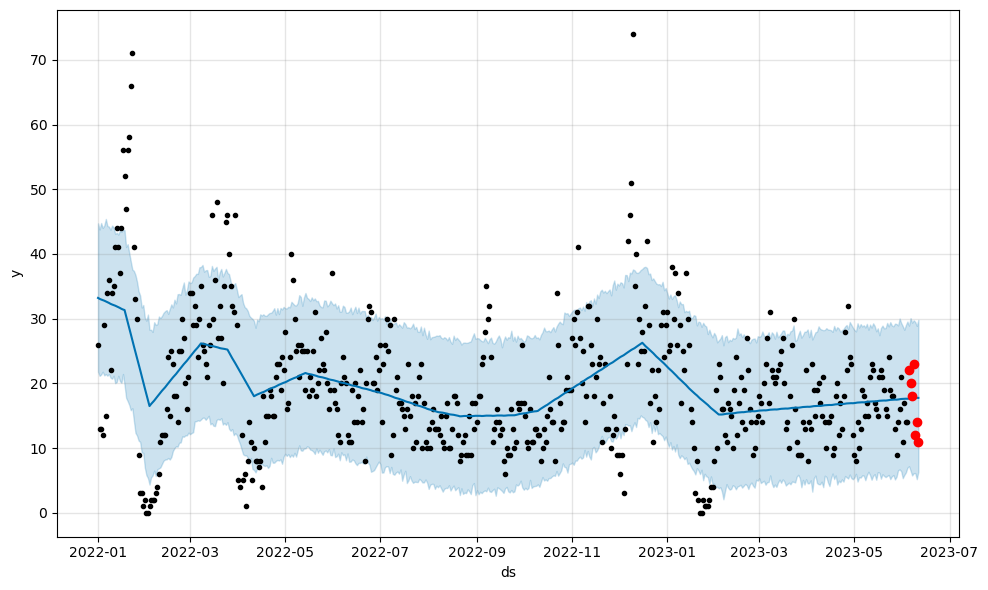

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  17.722898    5.761612   29.374008
523 2023-06-08  17.739803    6.116454   29.735830
524 2023-06-09  17.771615    6.132889   29.492871
525 2023-06-10  17.766176    5.194479   28.886529
526 2023-06-11  17.756111    6.349276   29.822695
[22 20 18 23 12 14 11]
---
[17.64331888 17.6891877  17.72289822 17.73980264 17.77161493 17.76617628
 17.75611111]
SMAPE: 0.24441450617611


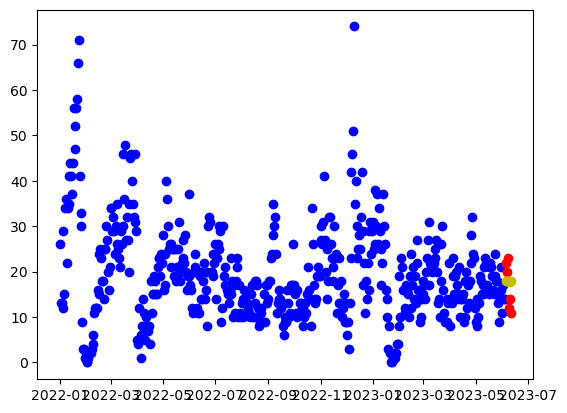

17:01:51 - cmdstanpy - INFO - Chain [1] start processing
17:01:51 - cmdstanpy - INFO - Chain [1] done processing


[22 20 18 23 12 14 11]
---
[17.99095529 17.85460641 17.91250513 18.03876129 18.0014684  17.71702546
 17.90980272]
SMAPE_lr: 0.23899891661855152


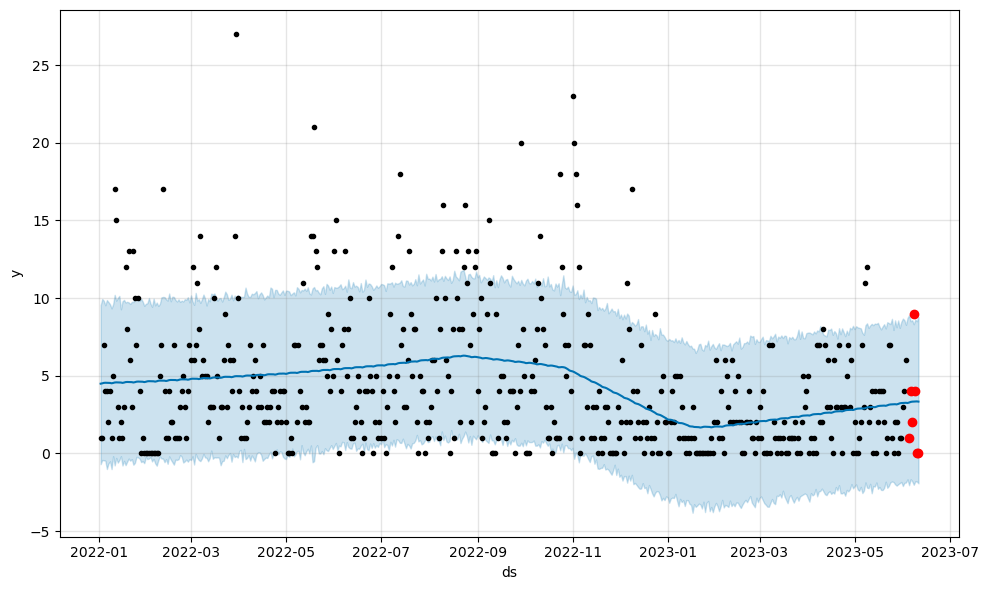

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-07  3.333543   -1.788677    8.577242
522 2023-06-08  3.338855   -2.015776    8.317073
523 2023-06-09  3.349262   -1.793147    8.620349
524 2023-06-10  3.349950   -1.807696    8.507970
525 2023-06-11  3.336680   -1.921393    8.786122
[1 4 2 9 4 0 0]
---
[3.27648004 3.3152687  3.33354278 3.33885487 3.34926229 3.34995009
 3.33667984]
SMAPE: 0.9780883225732878


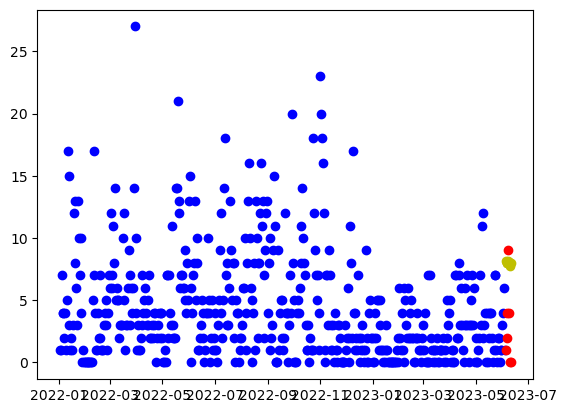

17:01:52 - cmdstanpy - INFO - Chain [1] start processing


[1 4 2 9 4 0 0]
---
[8.11936171 7.97101776 8.0169214  8.13118248 8.08189452 7.7854565
 7.96623869]
SMAPE_lr: 1.1718997653242462


17:01:52 - cmdstanpy - INFO - Chain [1] done processing


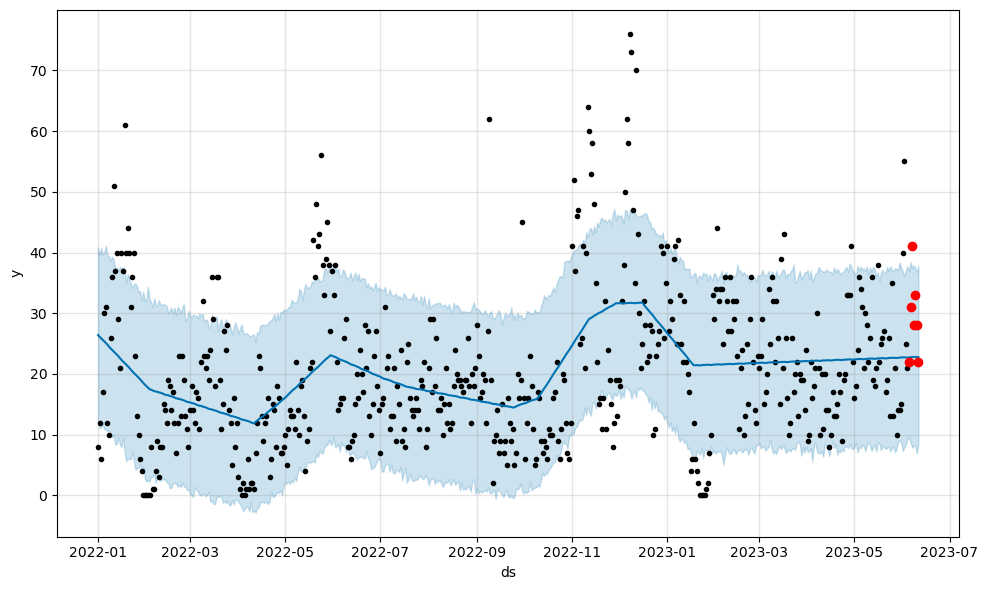

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  22.769394    7.877657   37.424051
523 2023-06-08  22.799318    8.161723   37.887809
524 2023-06-09  22.806844    8.167763   37.516125
525 2023-06-10  22.773014    6.958853   36.775767
526 2023-06-11  22.757202    8.453579   37.814062
[22 31 41 28 33 28 22]
---
[22.71963355 22.77196703 22.76939428 22.7993184  22.8068436  22.77301372
 22.75720199]
SMAPE: 0.24568181033084738


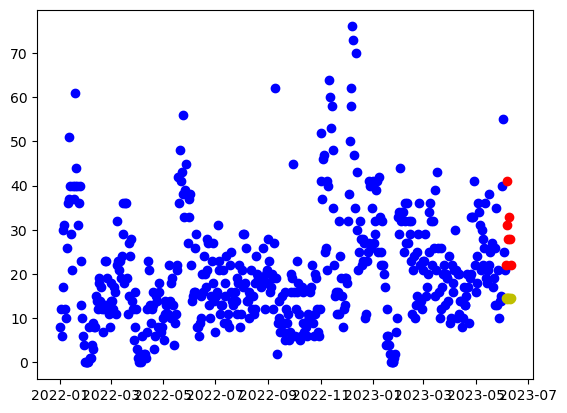

17:01:53 - cmdstanpy - INFO - Chain [1] start processing


[22 31 41 28 33 28 22]
---
[14.57005852 14.45570184 14.53559275 14.68384111 14.66854042 14.40608967
 14.62085914]
SMAPE_lr: 0.6463613924974388


17:01:53 - cmdstanpy - INFO - Chain [1] done processing


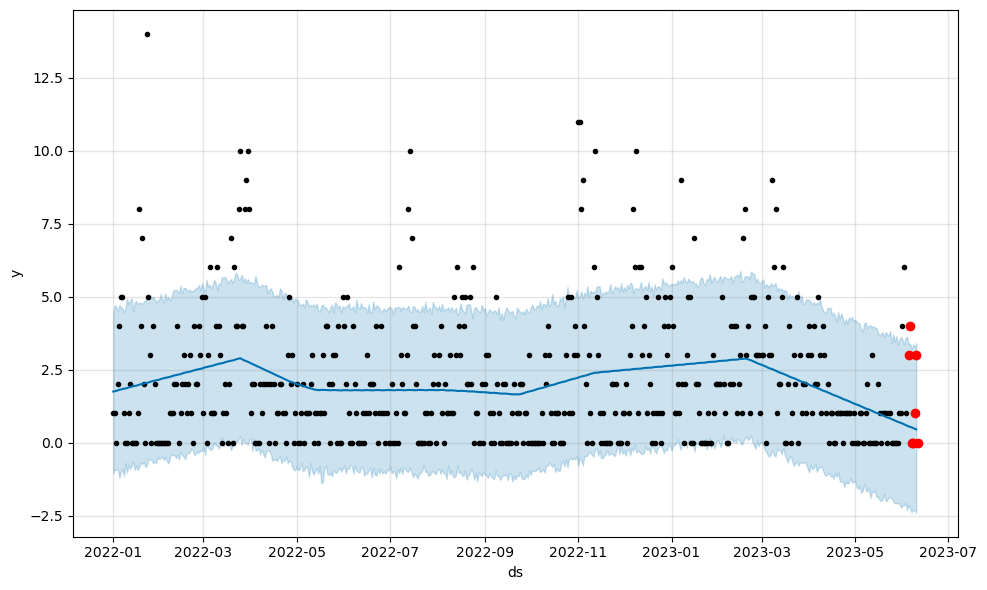

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-06  0.540066   -2.244940    3.389242
522 2023-06-07  0.522713   -2.387308    3.227099
523 2023-06-08  0.499593   -2.294547    3.363650
524 2023-06-09  0.479568   -2.323266    3.282190
525 2023-06-10  0.452969   -2.403279    3.413936
[3 4 0 0 1 3 0]
---
[0.57913165 0.55727878 0.54006619 0.52271297 0.49959336 0.47956768
 0.45296885]
SMAPE: 1.5685328105537657


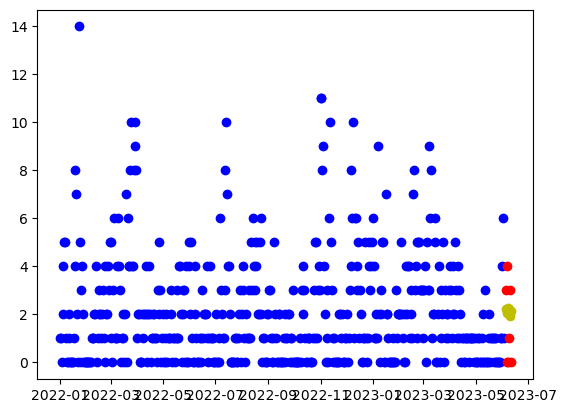

17:01:54 - cmdstanpy - INFO - Chain [1] start processing


[3 4 0 0 1 3 0]
---
[2.21238618 2.07598059 2.13382259 2.26002204 2.22267244 1.93817278
 2.13089334]
SMAPE_lr: 1.1606244416141738


17:01:54 - cmdstanpy - INFO - Chain [1] done processing


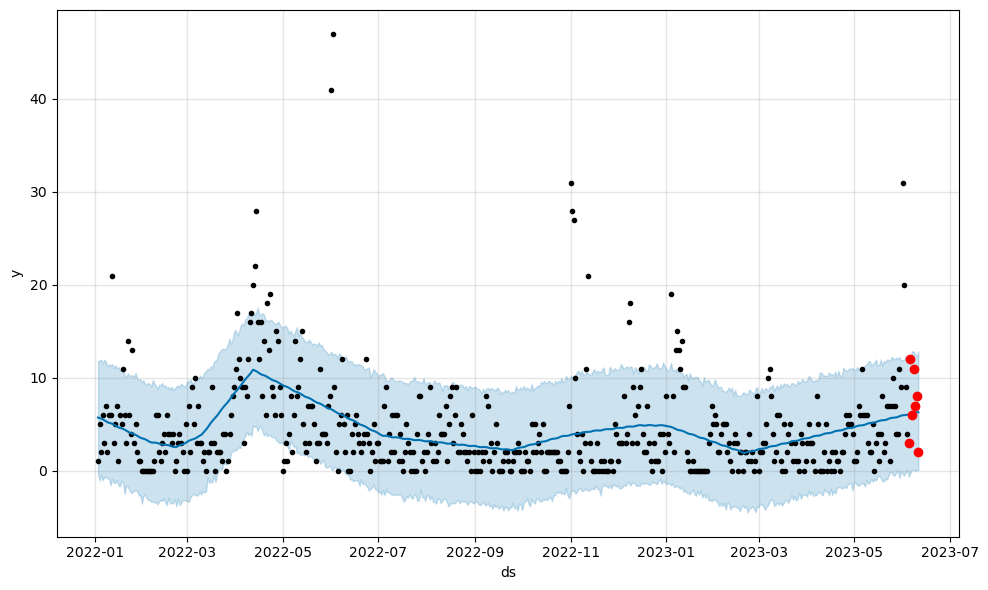

            ds      yhat  yhat_lower  yhat_upper
520 2023-06-07  6.201813    0.120094   12.861453
521 2023-06-08  6.244062    0.090615   12.820659
522 2023-06-09  6.258729    0.014634   12.482216
523 2023-06-10  6.280358    0.050402   12.307077
524 2023-06-11  6.295295    0.059945   12.849819
[ 3 12  6 11  7  8  2]
---
[6.06750747 6.14430108 6.20181319 6.24406214 6.25872942 6.28035835
 6.29529547]
SMAPE: 0.47071264822187014


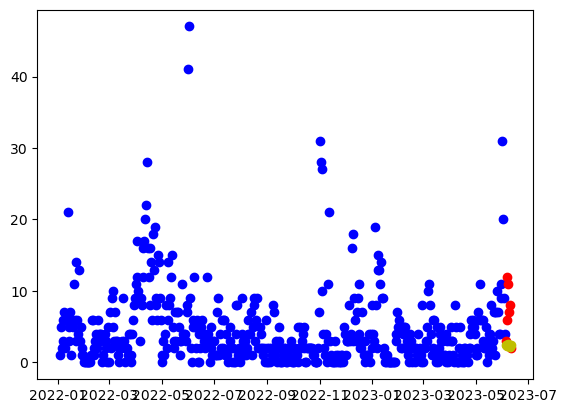

17:01:55 - cmdstanpy - INFO - Chain [1] start processing


[ 3 12  6 11  7  8  2]
---
[2.4714394  2.33906278 2.40093375 2.53116216 2.49784153 2.21737084
 2.41412036]
SMAPE_lr: 0.8452683632209557


17:01:55 - cmdstanpy - INFO - Chain [1] done processing


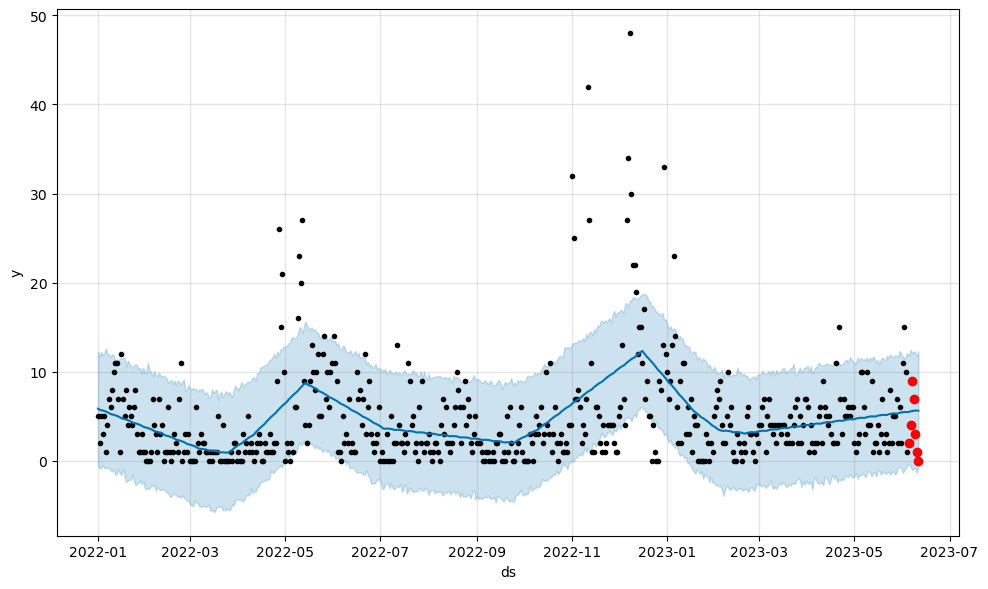

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  5.600941   -1.006585   12.081356
523 2023-06-08  5.626844   -0.844594   12.299104
524 2023-06-09  5.655234   -0.818293   12.159805
525 2023-06-10  5.651350   -1.341807   11.843488
526 2023-06-11  5.636618   -0.688567   12.294891
[2 4 9 7 3 1 0]
---
[5.49652123 5.56817394 5.60094102 5.62684378 5.65523438 5.65135038
 5.63661819]
SMAPE: 0.8508420700462628


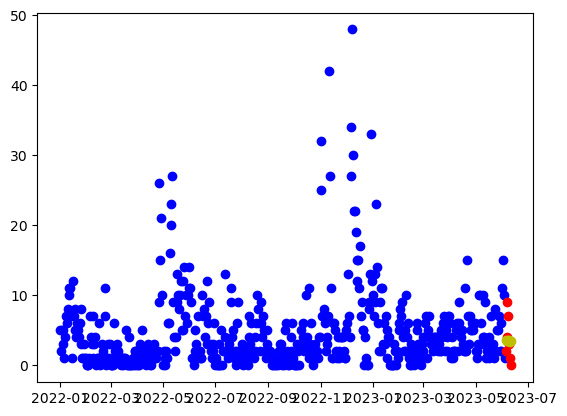

17:01:56 - cmdstanpy - INFO - Chain [1] start processing


[2 4 9 7 3 1 0]
---
[3.61892074 3.48700927 3.54934539 3.68003895 3.64718348 3.36717793
 3.56439261]
SMAPE_lr: 0.783209080091111


17:01:56 - cmdstanpy - INFO - Chain [1] done processing


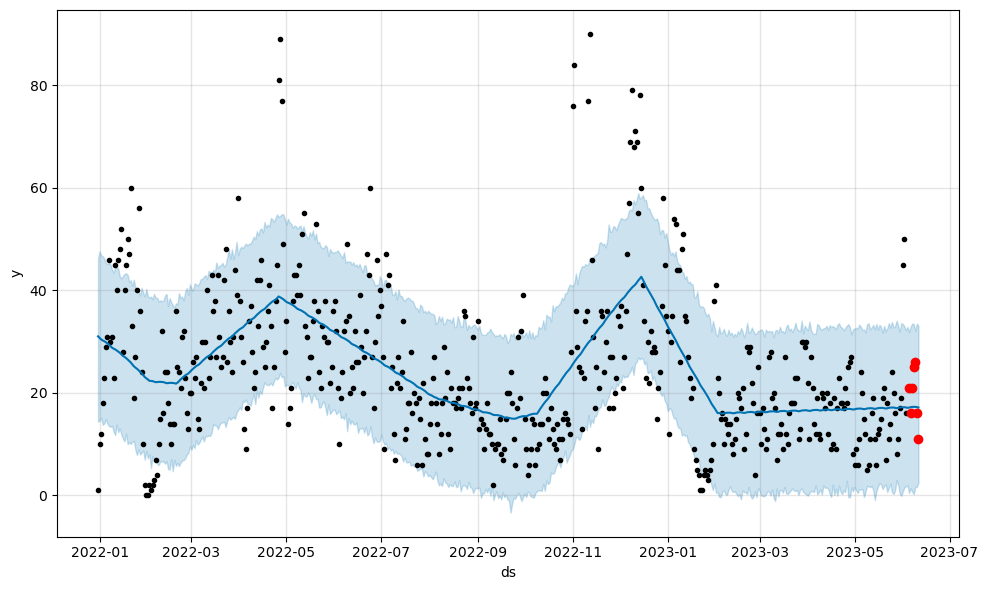

            ds       yhat  yhat_lower  yhat_upper
523 2023-06-07  17.265514    0.746683   33.522478
524 2023-06-08  17.276394    0.262388   33.449047
525 2023-06-09  17.286349    1.664416   32.082199
526 2023-06-10  17.218358    1.680958   33.495056
527 2023-06-11  17.158749    2.454805   33.117198
[21 16 21 25 26 16 11]
---
[17.13832324 17.22640494 17.26551419 17.27639367 17.28634866 17.21835814
 17.15874909]
SMAPE: 0.2500420791081431


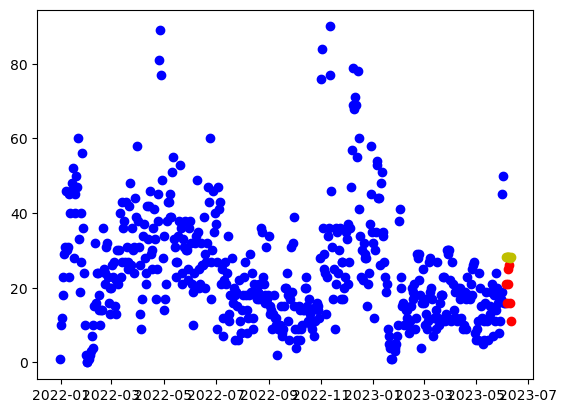

17:01:57 - cmdstanpy - INFO - Chain [1] start processing


[21 16 21 25 26 16 11]
---
[28.31630691 28.16112468 28.20019005 28.30761286 28.25148662 27.94821032
 28.12215424]
SMAPE_lr: 0.3951879582295014


17:01:57 - cmdstanpy - INFO - Chain [1] done processing


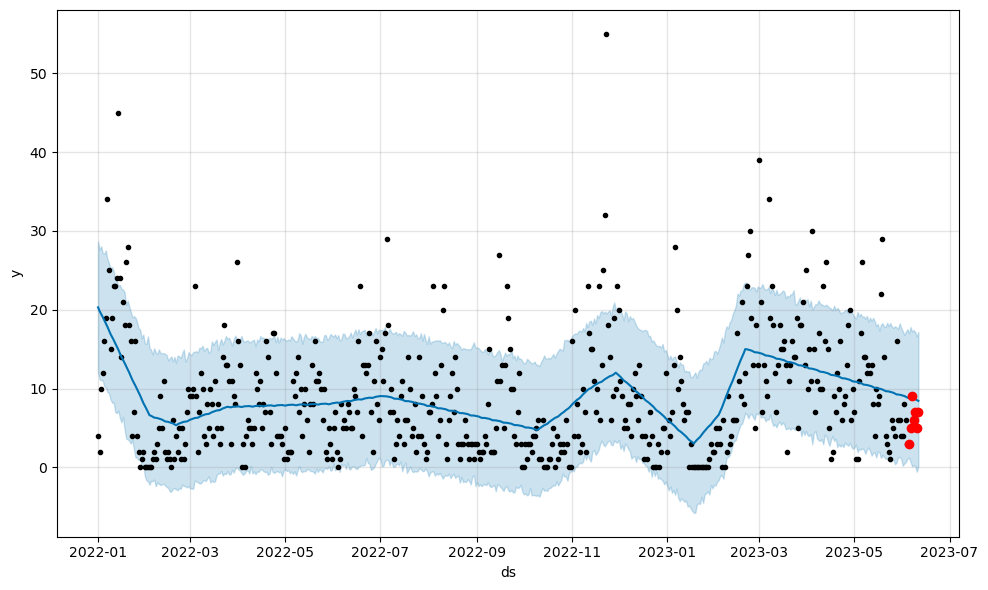

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  8.753720    0.108404   17.221992
523 2023-06-08  8.702531    0.250271   17.426914
524 2023-06-09  8.640909    0.181639   17.140745
525 2023-06-10  8.543357   -0.565895   16.609043
526 2023-06-11  8.433250    0.125320   17.195247
[3 5 9 6 7 5 7]
---
[8.82592748 8.80505239 8.75372034 8.70253073 8.64090923 8.5433566
 8.43324975]
SMAPE: 0.4072466744147868


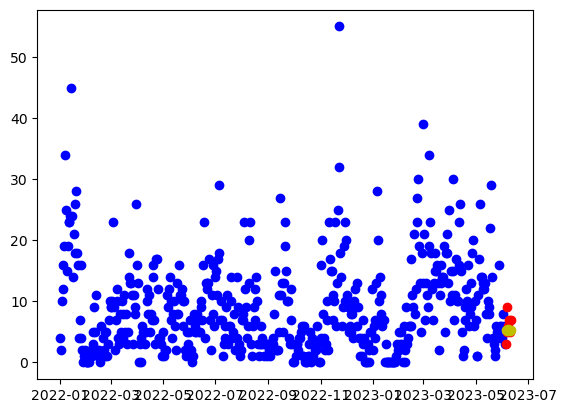

17:01:57 - cmdstanpy - INFO - Chain [1] start processing


[3 5 9 6 7 5 7]
---
[5.34086372 5.2158808  5.28514548 5.42276759 5.39684067 5.12376368
 5.3279069 ]
SMAPE_lr: 0.25415584037517114


17:01:58 - cmdstanpy - INFO - Chain [1] done processing


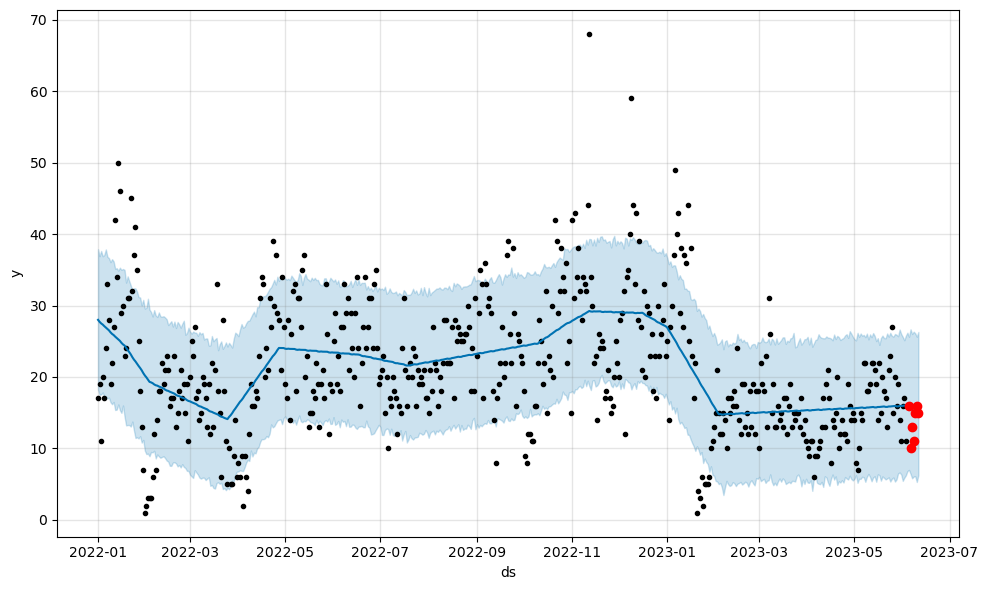

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  16.017548    5.820495   26.009470
523 2023-06-08  16.044389    6.067169   26.336874
524 2023-06-09  16.083849    6.102547   26.113016
525 2023-06-10  16.089928    5.307426   25.637365
526 2023-06-11  16.031272    6.268036   26.297426
[16 10 13 11 15 16 15]
---
[15.95718328 16.0182236  16.01754761 16.04438851 16.08384928 16.0899279
 16.03127208]
SMAPE: 0.1697328808394131


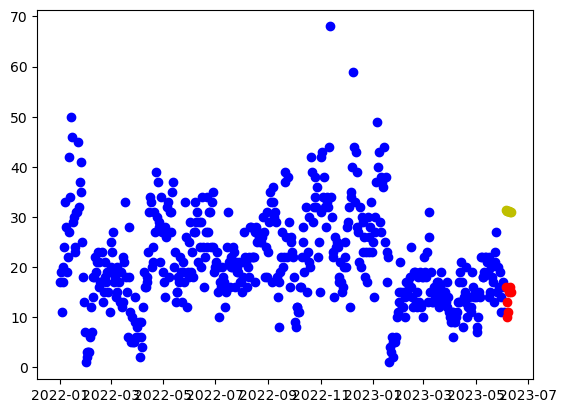

17:01:58 - cmdstanpy - INFO - Chain [1] start processing
17:01:58 - cmdstanpy - INFO - Chain [1] done processing


[16 10 13 11 15 16 15]
---
[31.34526983 31.17870866 31.20639508 31.30243895 31.23493377 30.92027852
 31.0828435 ]
SMAPE_lr: 0.7852405843054733


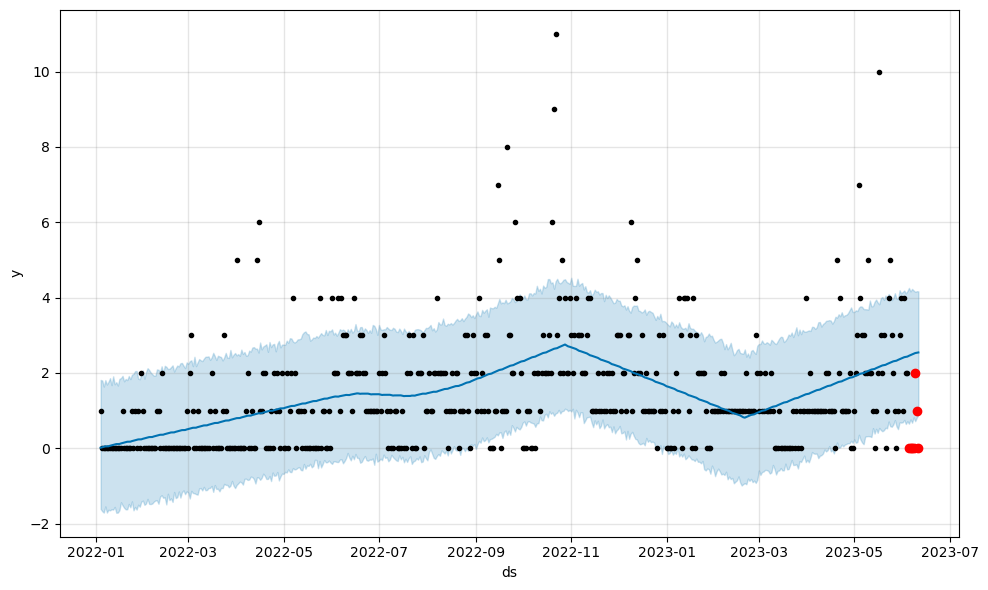

            ds      yhat  yhat_lower  yhat_upper
519 2023-06-07  2.492615    0.677746    4.230945
520 2023-06-08  2.509786    0.819955    4.187678
521 2023-06-09  2.527644    0.719038    4.152963
522 2023-06-10  2.534252    0.813350    4.170470
523 2023-06-11  2.543617    0.885283    4.165918
[0 0 0 0 2 1 0]
---
[2.45552052 2.47314679 2.49261467 2.50978575 2.5276439  2.53425162
 2.54361743]
SMAPE: 1.5858993231077103


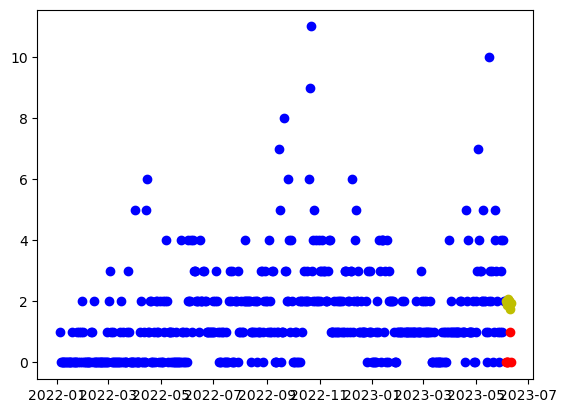

17:01:59 - cmdstanpy - INFO - Chain [1] start processing


[0 0 0 0 2 1 0]
---
[2.01973444 1.88307422 1.94066159 2.06660641 2.02900218 1.74424789
 1.93671381]
SMAPE_lr: 1.5081146336053217


17:01:59 - cmdstanpy - INFO - Chain [1] done processing


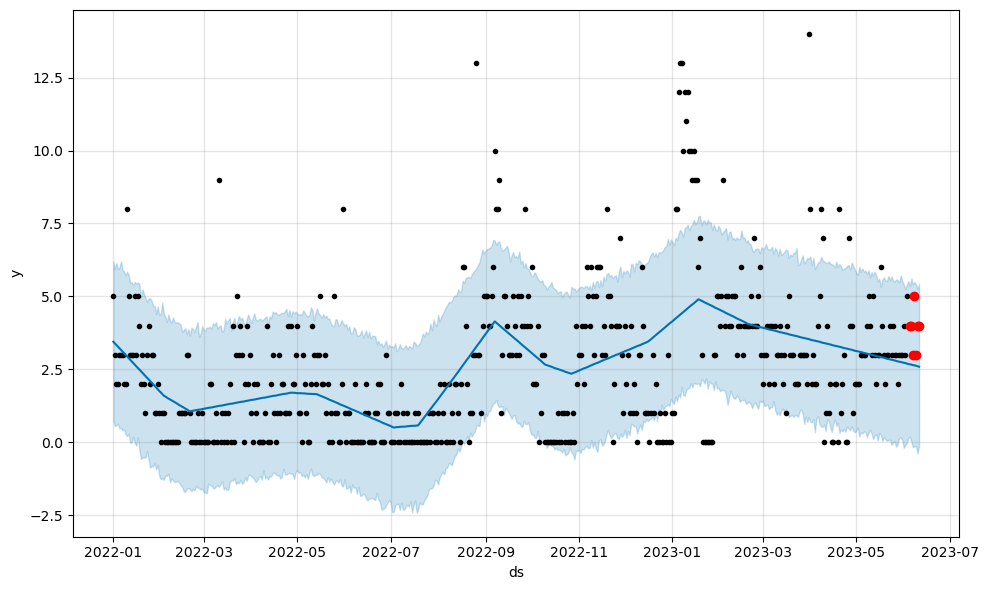

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  2.644168   -0.174948    5.418677
523 2023-06-08  2.632468   -0.138650    5.489113
524 2023-06-09  2.621489   -0.150071    5.406339
525 2023-06-10  2.605027   -0.389006    5.256114
526 2023-06-11  2.588074   -0.119975    5.438730
[4 4 3 5 3 4 4]
---
[2.66966302 2.65794273 2.64416844 2.63246823 2.62148885 2.60502723
 2.58807364]
SMAPE: 0.36203330785394966


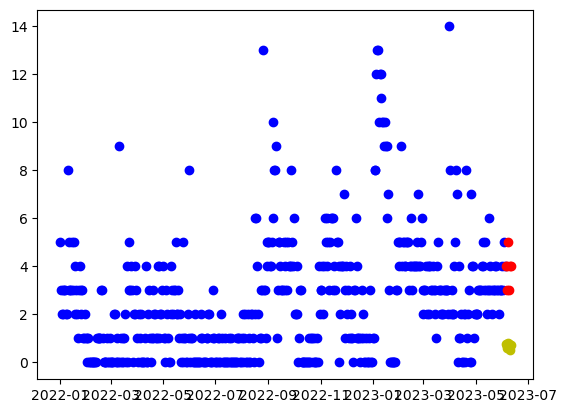

17:02:00 - cmdstanpy - INFO - Chain [1] start processing


[4 4 3 5 3 4 4]
---
[0.75003337 0.62080145 0.68581712 0.81919023 0.7890143  0.51168831
 0.71158253]
SMAPE_lr: 1.3761298677612577


17:02:00 - cmdstanpy - INFO - Chain [1] done processing


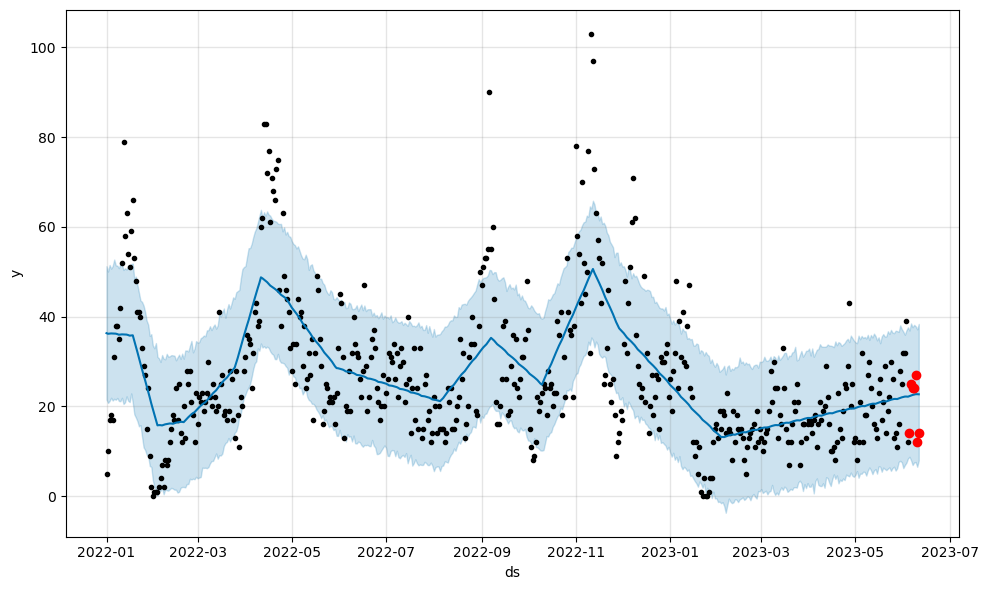

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  22.549193    6.937044   37.632032
523 2023-06-08  22.636443    7.498797   38.175442
524 2023-06-09  22.719620    7.603686   37.858371
525 2023-06-10  22.726143    6.536211   37.178497
526 2023-06-11  22.698989    7.937600   38.382091
[14 25 24 24 27 12 14]
---
[22.30452445 22.45475289 22.54919312 22.63644275 22.71961997 22.72614308
 22.69898896]
SMAPE: 0.2785118025401875


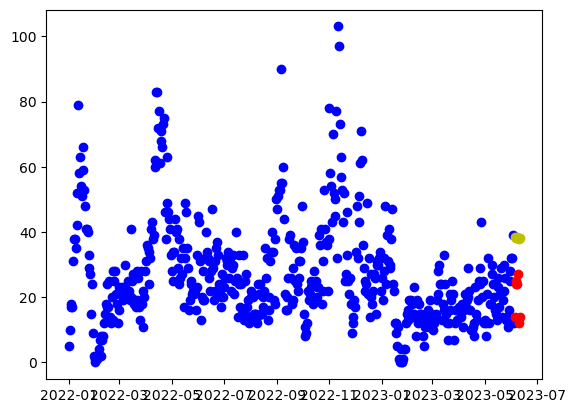

17:02:01 - cmdstanpy - INFO - Chain [1] start processing


[14 25 24 24 27 12 14]
---
[38.44060262 38.26495856 38.28356209 38.37052306 38.293935   37.97019686
 38.12367894]
SMAPE_lr: 0.6545637178772262


17:02:01 - cmdstanpy - INFO - Chain [1] done processing


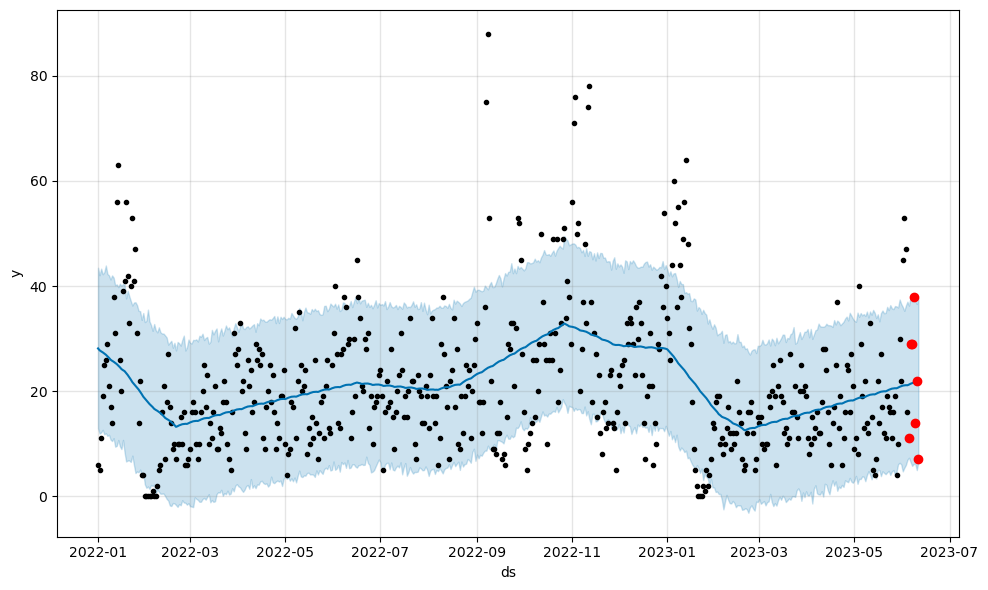

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  21.516396    5.757794   37.043868
523 2023-06-08  21.622596    6.110926   37.609741
524 2023-06-09  21.671867    6.160898   37.257217
525 2023-06-10  21.705800    4.949765   36.588788
526 2023-06-11  21.692019    6.536487   37.645649
[11 29 29 38 14 22  7]
---
[21.23692067 21.39439009 21.51639593 21.62259644 21.67186687 21.7057998
 21.69201872]
SMAPE: 0.46433130012511054


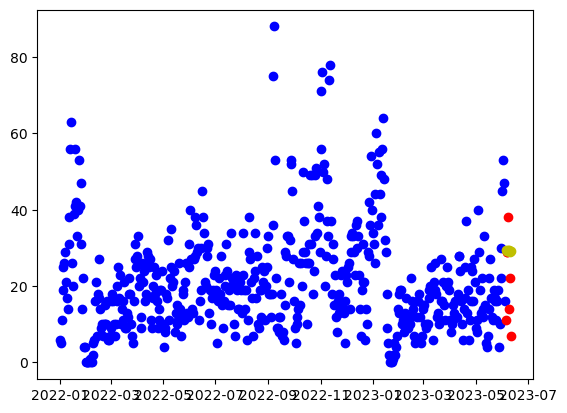

17:02:02 - cmdstanpy - INFO - Chain [1] start processing


[11 29 29 38 14 22  7]
---
[29.43990148 29.28172888 29.31780386 29.4222363  29.36311969 29.05685301
 29.22780655]
SMAPE_lr: 0.4855865513170346


17:02:02 - cmdstanpy - INFO - Chain [1] done processing


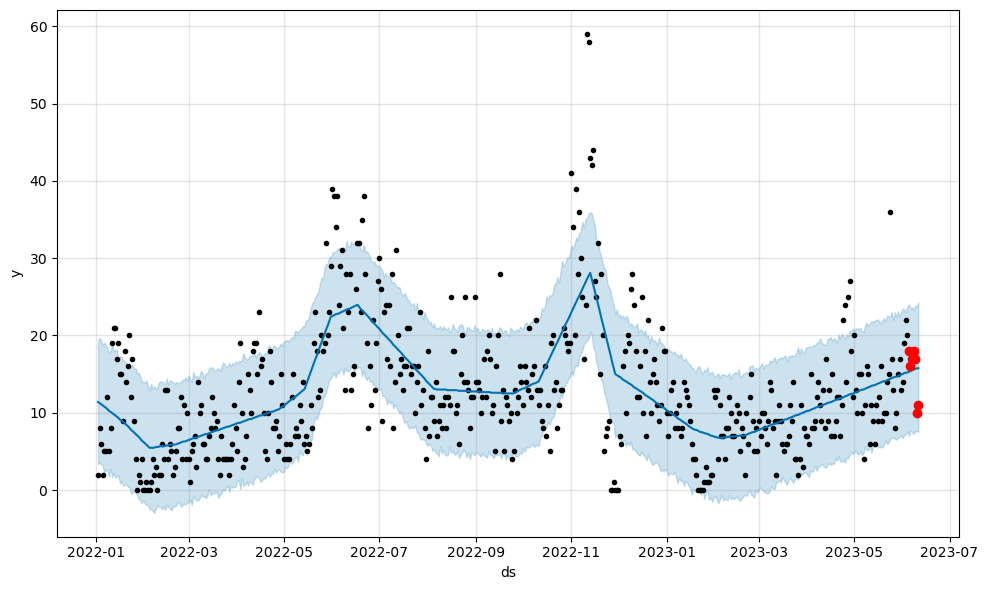

            ds       yhat  yhat_lower  yhat_upper
521 2023-06-07  15.490570    7.515652   23.646501
522 2023-06-08  15.574620    7.270000   23.241461
523 2023-06-09  15.677313    7.678926   23.865164
524 2023-06-10  15.739289    7.585846   23.728823
525 2023-06-11  15.756430    7.556845   24.268157
[18 16 17 18 17 10 11]
---
[15.32047744 15.4110271  15.49057048 15.5746203  15.67731288 15.73928913
 15.75643005]
SMAPE: 0.1883102533953441


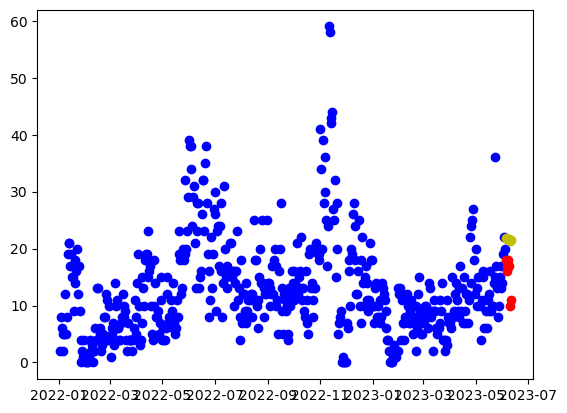

17:02:03 - cmdstanpy - INFO - Chain [1] start processing


[18 16 17 18 17 10 11]
---
[21.79543329 21.63436341 21.66754113 21.76907629 21.70706241 21.39789846
 21.56595473]
SMAPE_lr: 0.3627543810554413


17:02:04 - cmdstanpy - INFO - Chain [1] done processing


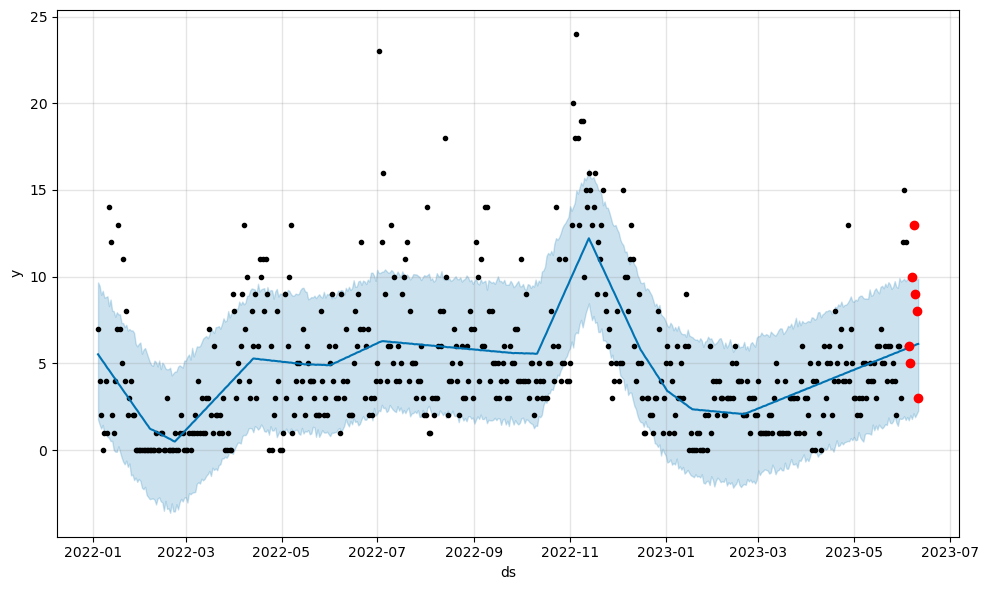

            ds      yhat  yhat_lower  yhat_upper
519 2023-06-07  5.979629    1.787492    9.991431
520 2023-06-08  6.018795    2.120729    9.891042
521 2023-06-09  6.047466    1.896514    9.803791
522 2023-06-10  6.096911    2.078848    9.836738
523 2023-06-11  6.120013    2.268727    9.882484
[ 6  5 10 13  9  8  3]
---
[5.89353361 5.94704903 5.97962905 6.0187953  6.04746559 6.09691058
 6.12001285]
SMAPE: 0.3964134383106466


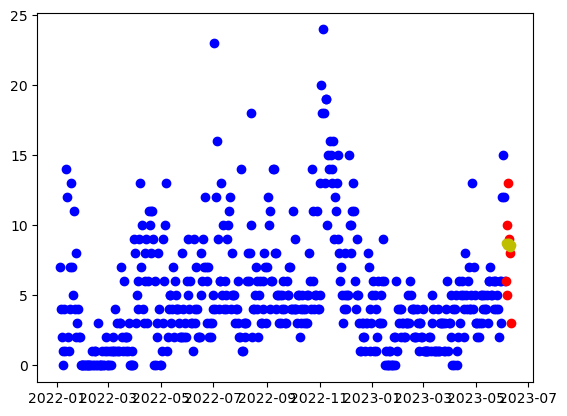

17:02:04 - cmdstanpy - INFO - Chain [1] start processing


[ 6  5 10 13  9  8  3]
---
[8.75628158 8.61021182 8.65838965 8.77492493 8.72791117 8.43374733
 8.61680372]
SMAPE_lr: 0.35520884767151006


17:02:05 - cmdstanpy - INFO - Chain [1] done processing


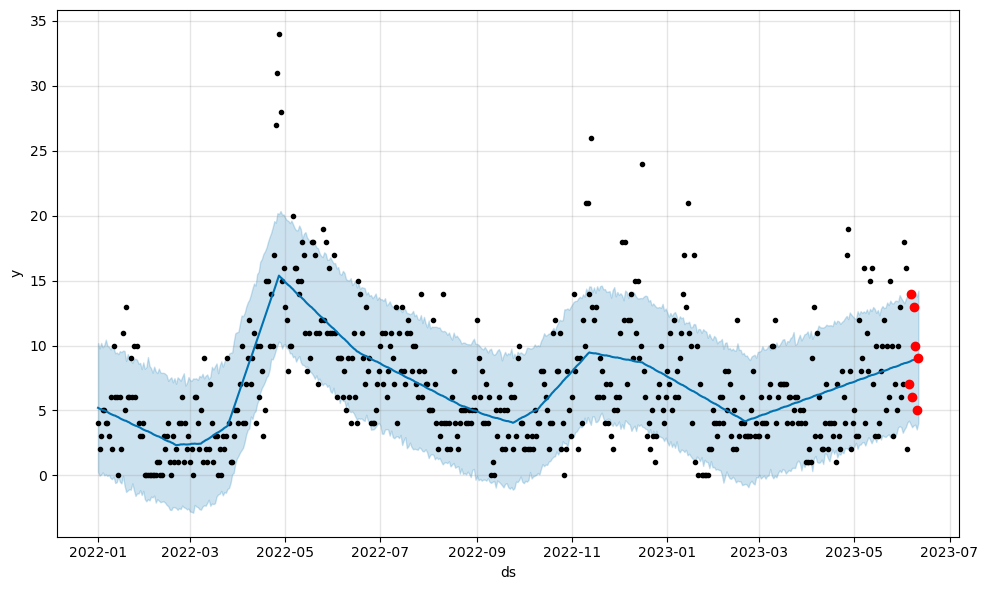

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  8.858713    3.705701   13.906198
523 2023-06-08  8.891182    3.853082   14.091322
524 2023-06-09  8.943259    3.901139   14.009558
525 2023-06-10  8.961963    3.535048   13.769488
526 2023-06-11  8.995633    4.043720   14.217302
[ 7 14  6 13 10  5  9]
---
[8.73744924 8.7855689  8.85871275 8.89118239 8.94325888 8.96196274
 8.99563339]
SMAPE: 0.30260901157426695


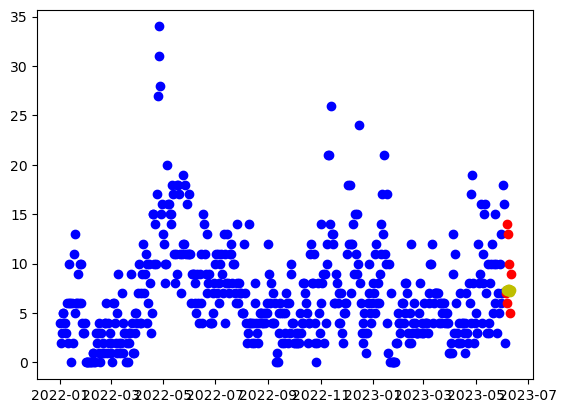

17:02:06 - cmdstanpy - INFO - Chain [1] start processing


[ 7 14  6 13 10  5  9]
---
[7.38396081 7.24623203 7.30275085 7.42762711 7.38895433 7.10313149
 7.29452886]
SMAPE_lr: 0.3268227681424952


17:02:06 - cmdstanpy - INFO - Chain [1] done processing


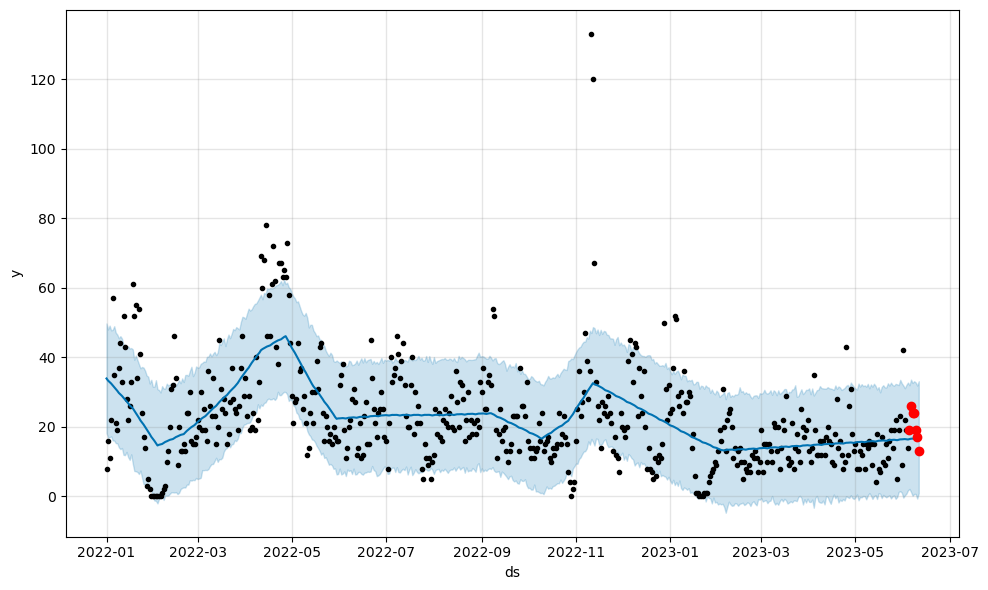

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  16.599608    0.176955   32.593459
523 2023-06-08  16.647992    0.692656   33.115322
524 2023-06-09  16.672516    0.695665   32.763245
525 2023-06-10  16.619258   -0.639060   31.880931
526 2023-06-11  16.549962    0.893898   33.114555
[19 26 24 24 19 17 13]
---
[16.47501775 16.58676522 16.59960827 16.6479922  16.67251566 16.61925815
 16.5499619 ]
SMAPE: 0.24344735276760504


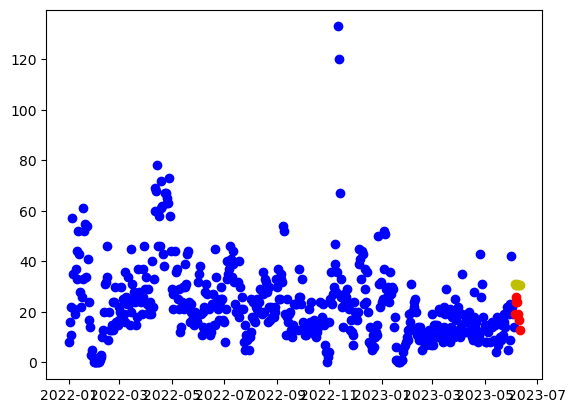

17:02:06 - cmdstanpy - INFO - Chain [1] start processing


[19 26 24 24 19 17 13]
---
[30.9524291  30.78318954 30.80819757 30.90156304 30.83137947 30.51404584
 30.67393242]
SMAPE_lr: 0.4285624077633485


17:02:07 - cmdstanpy - INFO - Chain [1] done processing


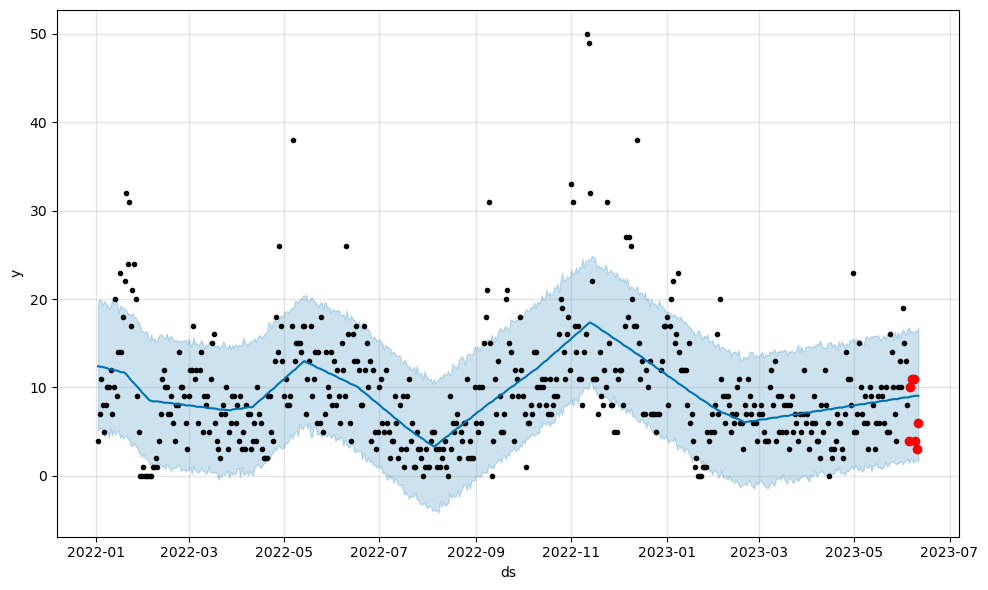

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-07  8.994573    1.778498   16.374436
522 2023-06-08  9.037303    1.485509   16.011440
523 2023-06-09  9.055153    1.819418   16.473560
524 2023-06-10  9.072620    1.810915   16.331900
525 2023-06-11  9.052725    1.640740   16.754528
[ 4 10 11 11  4  3  6]
---
[8.89331664 8.96007926 8.99457274 9.03730302 9.05515277 9.07262035
 9.05272459]
SMAPE: 0.4930420158930682


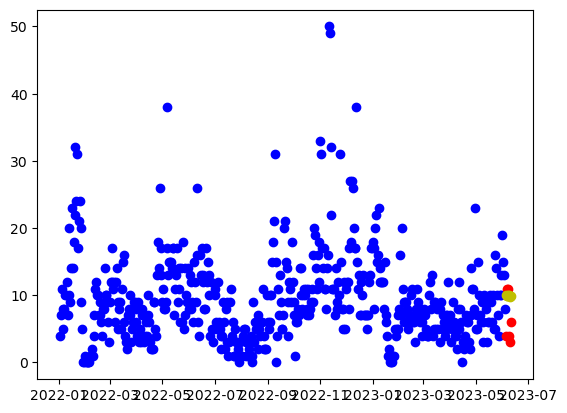

17:02:07 - cmdstanpy - INFO - Chain [1] start processing


[ 4 10 11 11  4  3  6]
---
[ 9.98306445  9.84510831  9.90139976 10.02604865  9.98714851  9.70109829
  9.89226829]
SMAPE_lr: 0.49575108167132786


17:02:08 - cmdstanpy - INFO - Chain [1] done processing


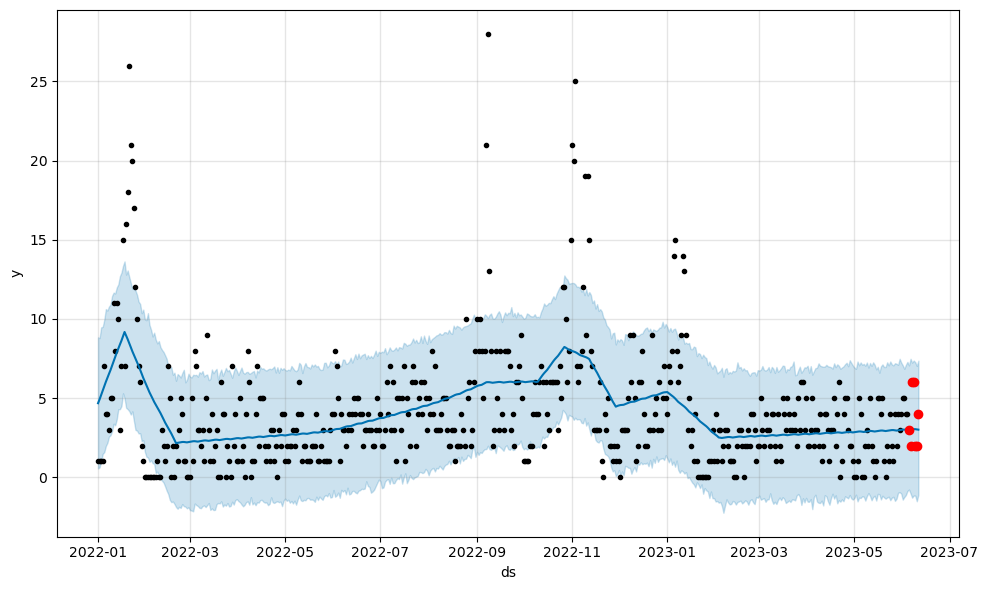

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  3.027292   -1.295527    7.234370
523 2023-06-08  3.034821   -1.161729    7.366445
524 2023-06-09  3.033806   -1.168801    7.266671
525 2023-06-10  3.018227   -1.521406    7.029200
526 2023-06-11  3.003025   -1.115201    7.360631
[3 2 6 6 2 2 4]
---
[2.99038492 3.00590068 3.02729164 3.03482123 3.03380554 3.01822743
 3.00302478]
SMAPE: 0.4030533767866173


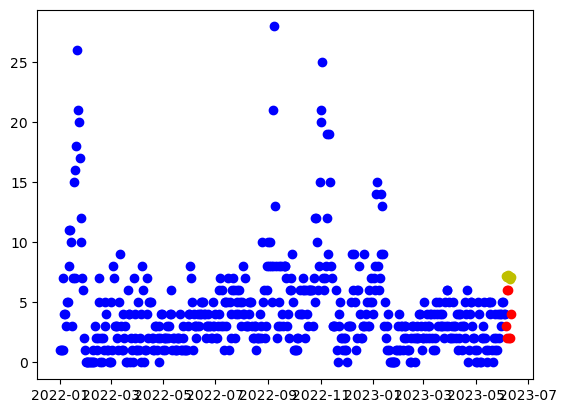

17:02:08 - cmdstanpy - INFO - Chain [1] start processing


[3 2 6 6 2 2 4]
---
[7.23390966 7.08949977 7.13933747 7.25753261 7.21217871 6.91967474
 7.10439099]
SMAPE_lr: 0.7291775223975405


17:02:09 - cmdstanpy - INFO - Chain [1] done processing


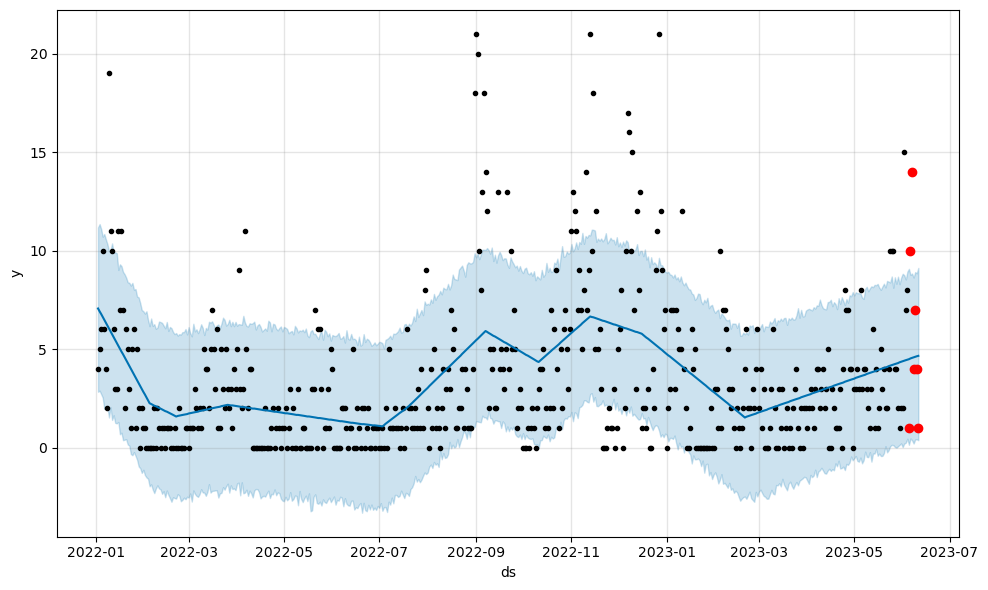

            ds      yhat  yhat_lower  yhat_upper
521 2023-06-07  4.557907    0.372152    8.838670
522 2023-06-08  4.589527    0.210817    8.637482
523 2023-06-09  4.609654    0.412494    8.912774
524 2023-06-10  4.638180    0.424681    8.848997
525 2023-06-11  4.660111    0.377174    9.123353
[ 1 10 14  4  7  4  1]
---
[4.49005724 4.53064763 4.55790732 4.58952662 4.60965355 4.63817952
 4.66011108]
SMAPE: 0.7188434859972155


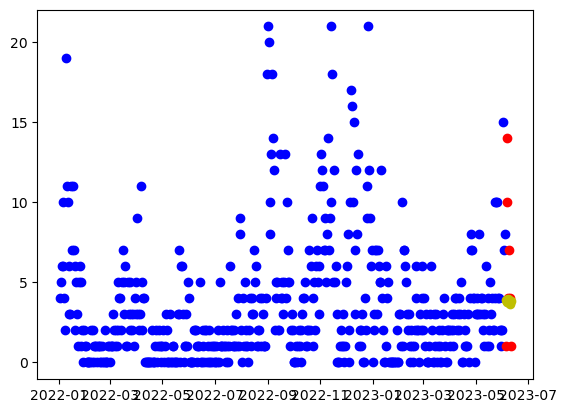

17:02:09 - cmdstanpy - INFO - Chain [1] start processing


[ 1 10 14  4  7  4  1]
---
[3.90425996 3.76805512 3.82609787 3.95249806 3.91534921 3.6310503
 3.8239716 ]
SMAPE_lr: 0.7251094589689646


17:02:09 - cmdstanpy - INFO - Chain [1] done processing


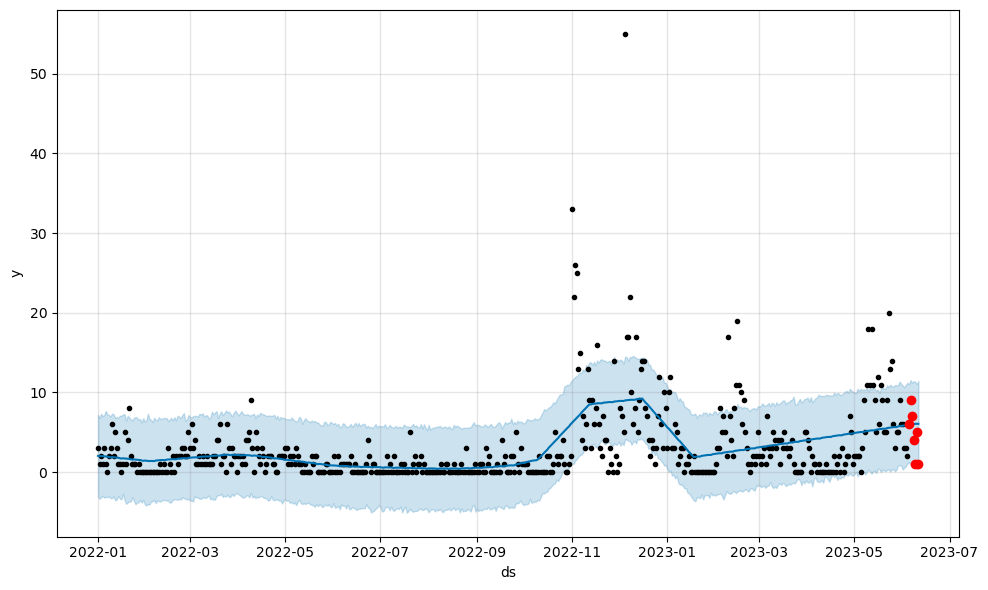

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  5.996426    0.677577   11.224829
523 2023-06-08  6.029615    0.808101   11.412798
524 2023-06-09  6.064617    0.841772   11.312509
525 2023-06-10  6.061177    0.419093   11.056998
526 2023-06-11  6.066458    0.963295   11.438357
[6 9 7 4 1 5 1]
---
[5.94689558 5.97349994 5.99642627 6.02961482 6.06461737 6.06117726
 6.06645825]
SMAPE: 0.5759883172843582


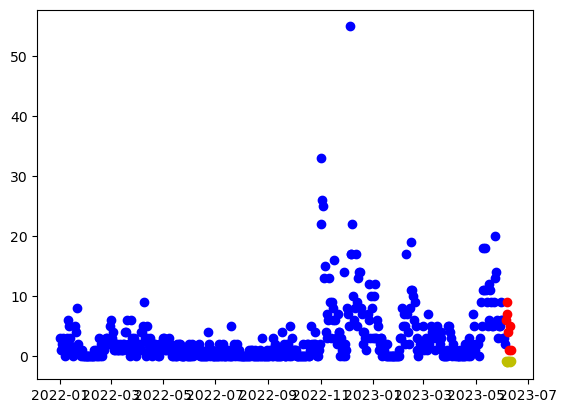

17:02:10 - cmdstanpy - INFO - Chain [1] start processing


[6 9 7 4 1 5 1]
---
[0. 0. 0. 0. 0. 0. 0.]
SMAPE_lr: 2.0


17:02:10 - cmdstanpy - INFO - Chain [1] done processing


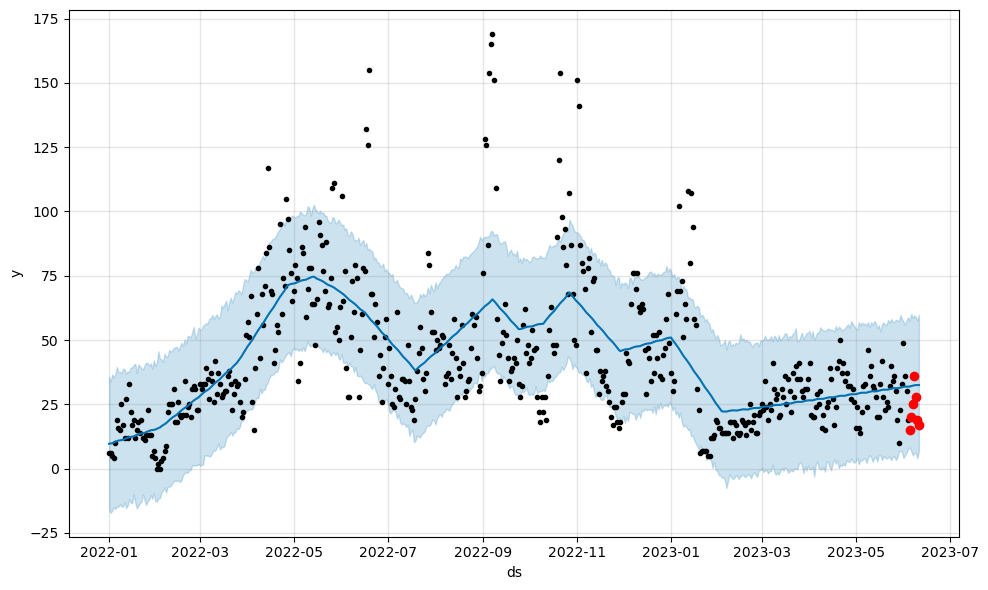

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  32.253246    5.170773   58.611851
523 2023-06-08  32.391709    6.098898   59.530629
524 2023-06-09  32.495033    6.164445   59.015203
525 2023-06-10  32.488603    4.045453   57.620070
526 2023-06-11  32.493123    6.691205   59.794658
[15 20 25 36 28 19 17]
---
[31.89974562 32.10162292 32.25324642 32.39170921 32.49503327 32.4886027
 32.49312262]
SMAPE: 0.4061046199830082


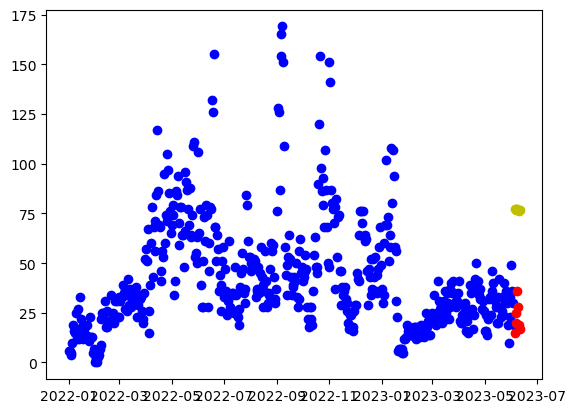

17:02:11 - cmdstanpy - INFO - Chain [1] start processing


[15 20 25 36 28 19 17]
---
[77.220318   76.97872127 76.93137213 76.95238043 76.8098397  76.42014889
 76.50767831]
SMAPE_lr: 1.096606102248103


17:02:11 - cmdstanpy - INFO - Chain [1] done processing


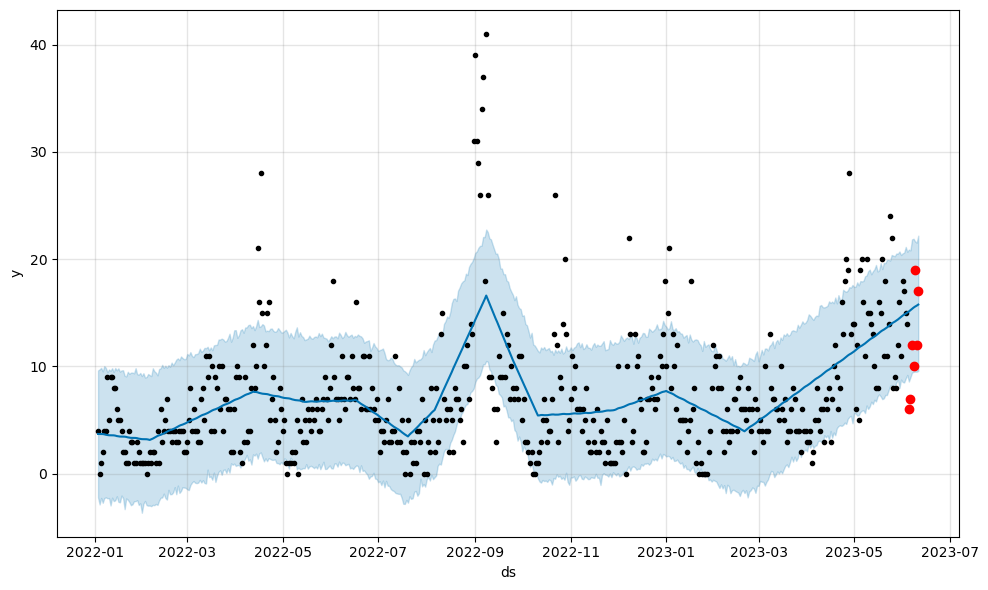

            ds       yhat  yhat_lower  yhat_upper
520 2023-06-07  15.350731    9.418215   21.846989
521 2023-06-08  15.483303    9.491155   21.903573
522 2023-06-09  15.583708    9.517797   21.653146
523 2023-06-10  15.665030    9.504615   21.543895
524 2023-06-11  15.767416    9.581731   22.192572
[ 6  7 12 10 19 12 17]
---
[15.12154703 15.24101174 15.35073065 15.48330297 15.58370831 15.66503046
 15.76741552]
SMAPE: 0.4025578253949021


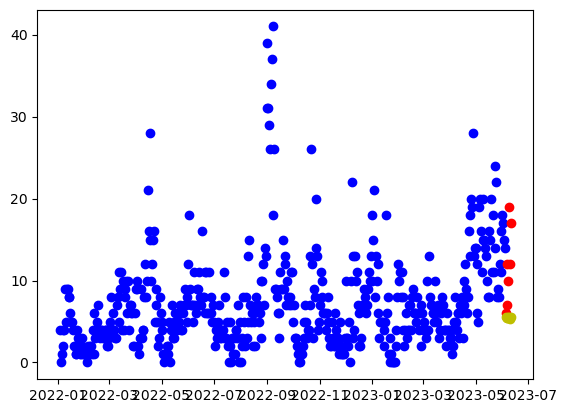

17:02:12 - cmdstanpy - INFO - Chain [1] start processing
17:02:12 - cmdstanpy - INFO - Chain [1] done processing


[ 6  7 12 10 19 12 17]
---
[5.53897735 5.41035423 5.4759787  5.60996061 5.58039348 5.30367629
 5.50417931]
SMAPE_lr: 0.6475306332408961


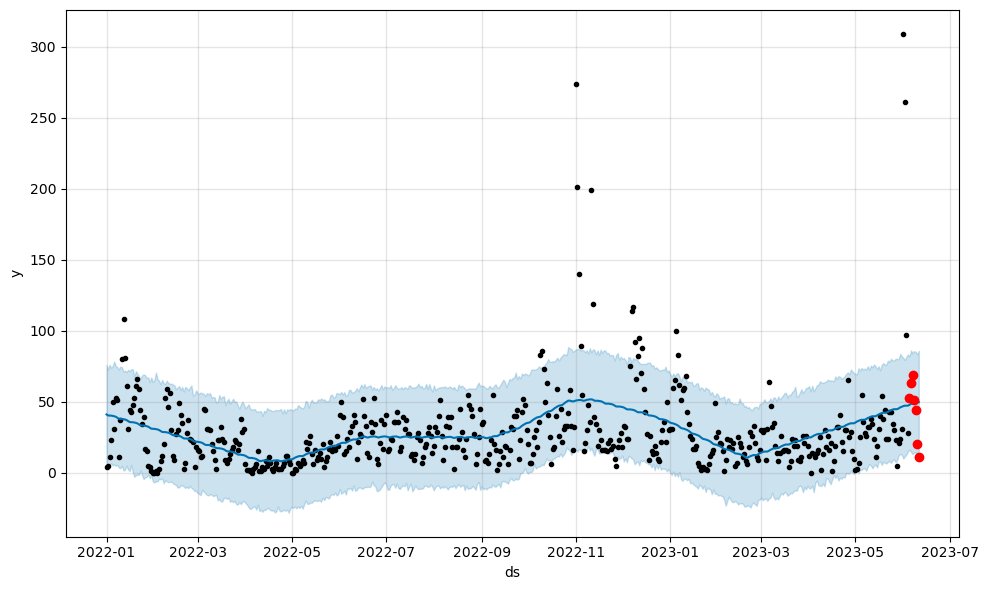

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  48.967090   13.218587   84.189878
523 2023-06-08  49.449063   14.254755   85.714580
524 2023-06-09  49.739029   14.553679   85.093108
525 2023-06-10  49.751760   11.742079   83.484566
526 2023-06-11  49.760886   15.404202   85.950377
[53 63 69 51 44 20 11]
---
[47.82744756 48.51463607 48.96708973 49.44906266 49.73902939 49.75176034
 49.76088571]
SMAPE: 0.42632617108411414


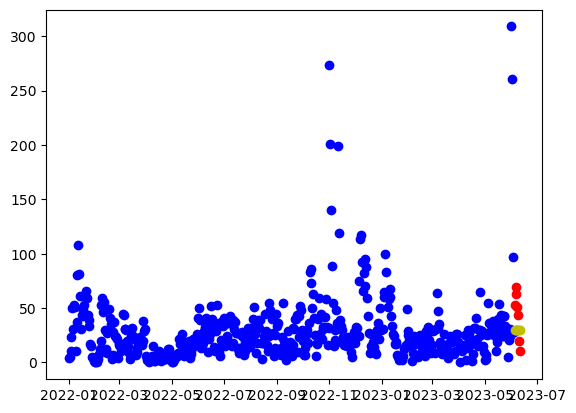

17:02:13 - cmdstanpy - INFO - Chain [1] start processing


[53 63 69 51 44 20 11]
---
[29.72494072 29.59460192 29.65851071 29.79077695 29.75949414 29.48106127
 29.67984862]
SMAPE_lr: 0.6135080689513234


17:02:13 - cmdstanpy - INFO - Chain [1] done processing


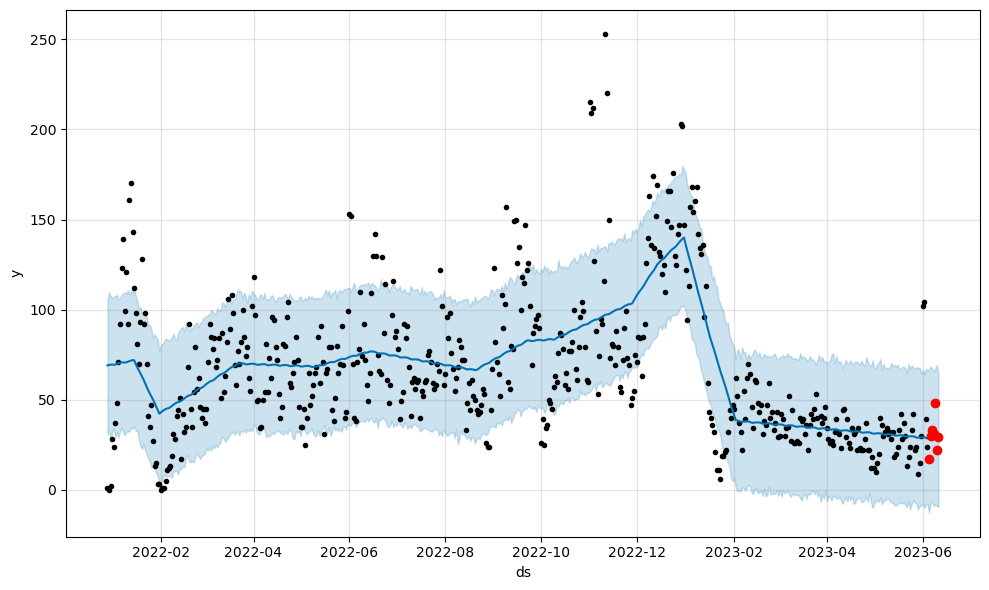

            ds       yhat  yhat_lower  yhat_upper
525 2023-06-07  28.589676   -6.014247   67.290555
526 2023-06-08  28.601126   -9.088123   65.342364
527 2023-06-09  28.549561   -8.279201   67.401421
528 2023-06-10  28.285411   -8.987338   69.179904
529 2023-06-11  27.923129   -9.708916   64.228377
[17 30 33 31 48 22 29]
---
[28.35379944 28.47520179 28.58967563 28.601126   28.54956149 28.28541144
 27.9231289 ]
SMAPE: 0.22464960084648725


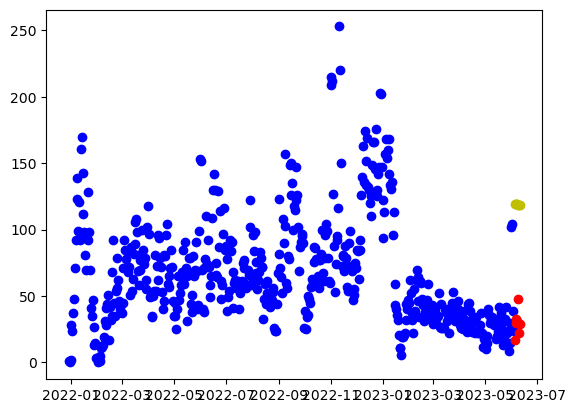

17:02:14 - cmdstanpy - INFO - Chain [1] start processing
17:02:14 - cmdstanpy - INFO - Chain [1] done processing


[17 30 33 31 48 22 29]
---
[119.54295792 119.24834445 119.14797857 119.11597013 118.92041265
 118.47770511 118.51221778]
SMAPE_lr: 1.205899501153201


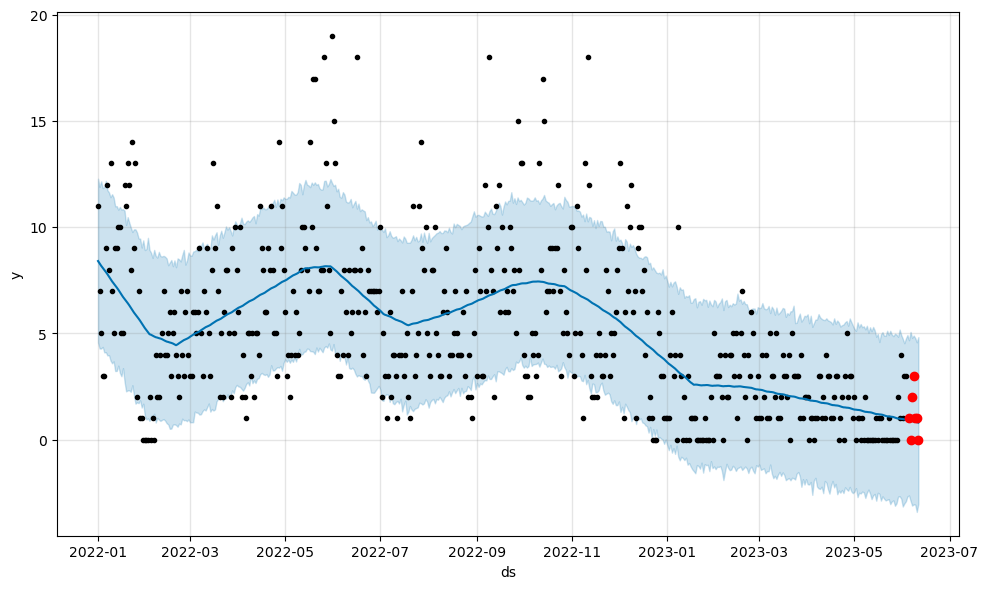

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  0.868037   -3.109476    4.787190
523 2023-06-08  0.862630   -3.052654    4.897805
524 2023-06-09  0.848573   -3.066415    4.782334
525 2023-06-10  0.822457   -3.406787    4.581416
526 2023-06-11  0.797650   -3.027625    4.824366
[1 0 2 3 1 1 0]
---
[0.88342213 0.87910807 0.86803716 0.86262952 0.84857291 0.82245733
 0.79765025]
SMAPE: 0.9112171233064358


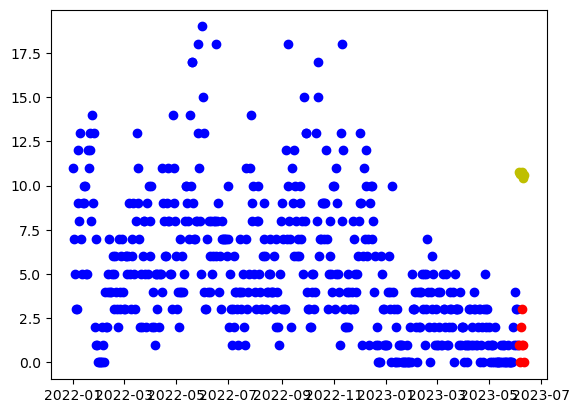

17:02:15 - cmdstanpy - INFO - Chain [1] start processing


[1 0 2 3 1 1 0]
---
[10.79527314 10.64045434 10.67988313 10.78766937 10.73190657 10.4289937
 10.60330104]
SMAPE_lr: 1.6383828506586673


17:02:15 - cmdstanpy - INFO - Chain [1] done processing


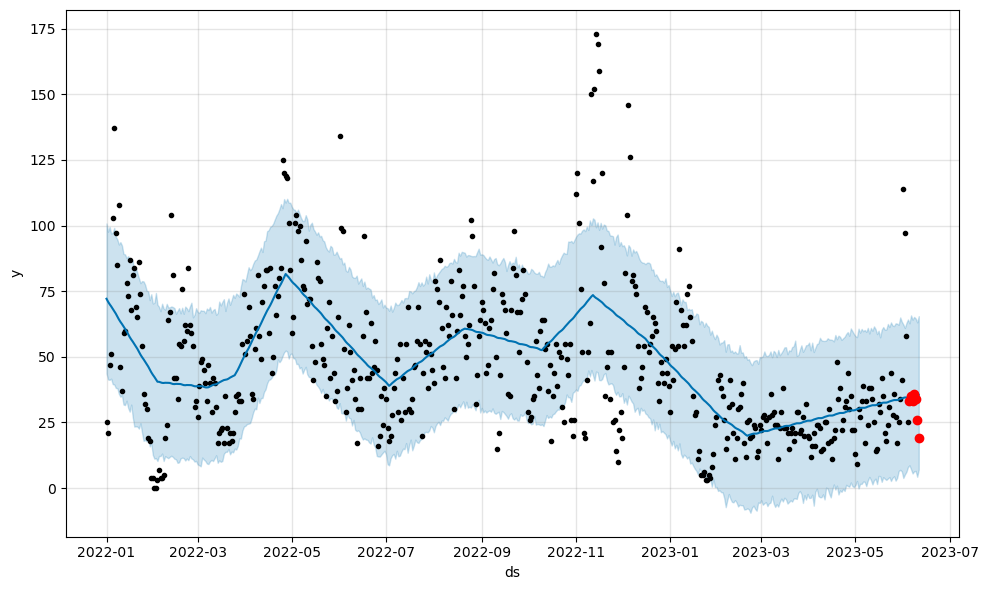

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  35.169028    5.569040   64.162846
523 2023-06-08  35.340856    6.402686   65.211554
524 2023-06-09  35.504936    6.541936   64.606826
525 2023-06-10  35.523924    4.321830   63.139362
526 2023-06-11  35.511056    7.066220   65.515180
[33 35 33 36 34 26 19]
---
[34.68994105 34.96766475 35.16902839 35.34085638 35.50493641 35.52392358
 35.5110563 ]
SMAPE: 0.15595201833331637


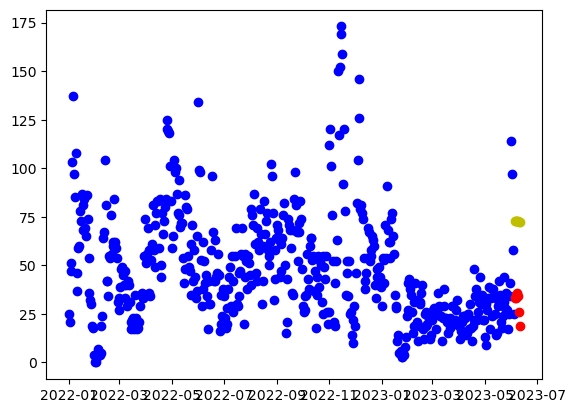

17:02:16 - cmdstanpy - INFO - Chain [1] start processing


[33 35 33 36 34 26 19]
---
[72.97494899 72.74744946 72.71419753 72.74930303 72.6208595  72.2452659
 72.34689252]
SMAPE_lr: 0.8165965113412132


17:02:16 - cmdstanpy - INFO - Chain [1] done processing


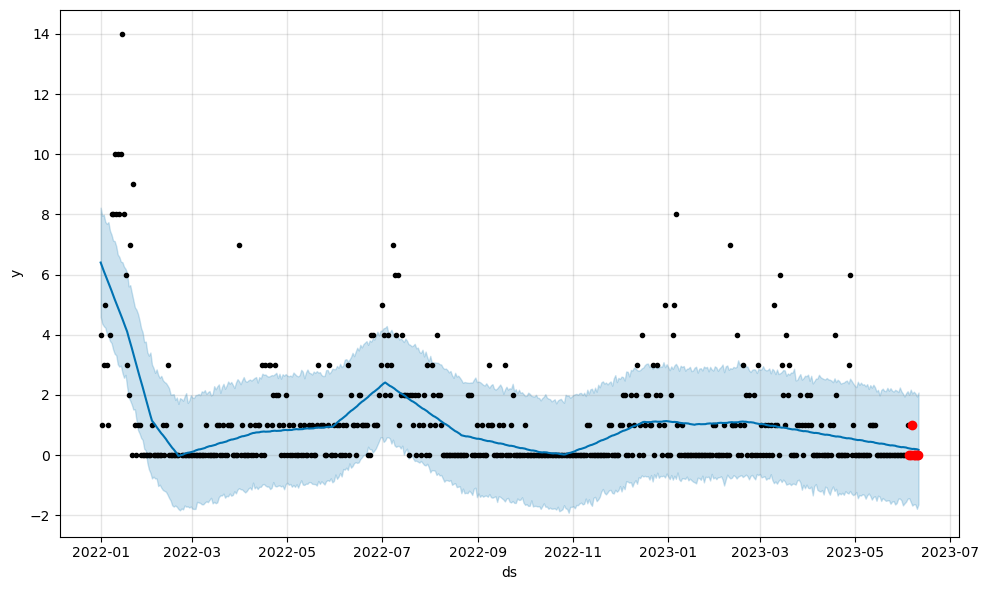

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  0.203290   -1.679514    2.047537
523 2023-06-08  0.206569   -1.634440    2.106593
524 2023-06-09  0.200667   -1.641620    2.051788
525 2023-06-10  0.193335   -1.786388    1.949906
526 2023-06-11  0.174435   -1.634771    2.079725
[0 0 1 0 0 0 0]
---
[0.22317041 0.21501623 0.20328997 0.20656915 0.20066669 0.19333518
 0.17443456]
SMAPE: 1.903459932178741


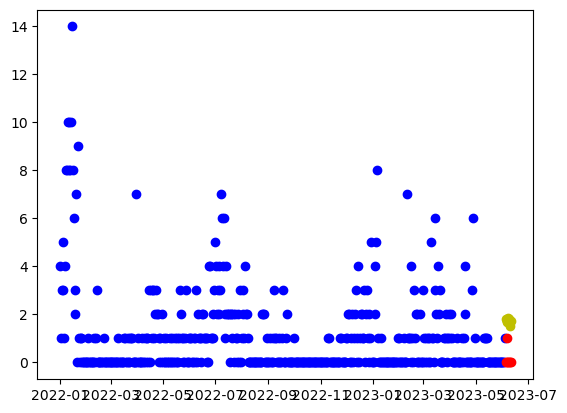

17:02:17 - cmdstanpy - INFO - Chain [1] start processing


[0 0 1 0 0 0 0]
---
[1.81189376 1.67322478 1.72880339 1.85273945 1.81312646 1.5263634
 1.71682057]
SMAPE_lr: 1.790593718465993


17:02:17 - cmdstanpy - INFO - Chain [1] done processing


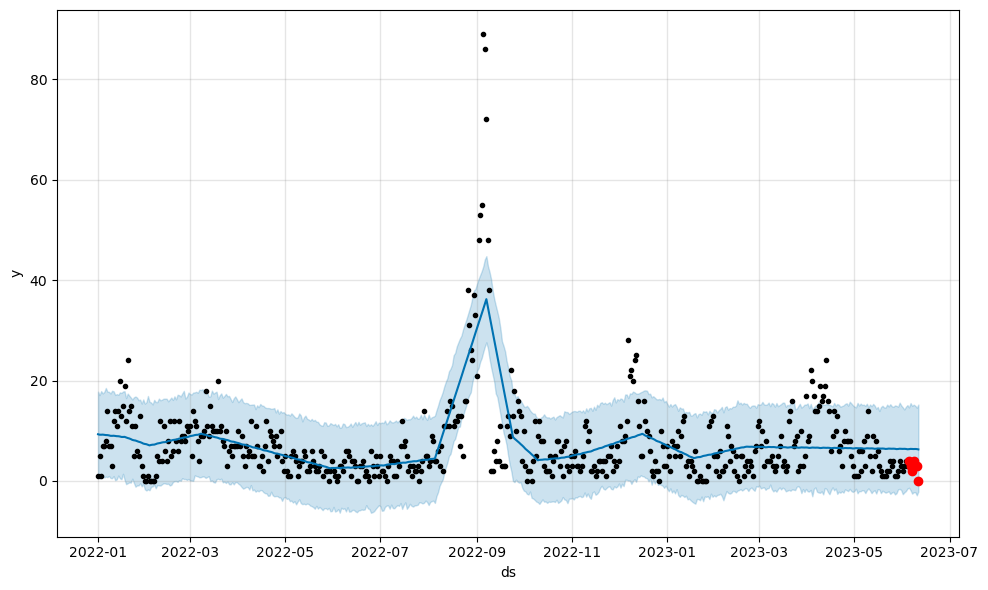

            ds      yhat  yhat_lower  yhat_upper
522 2023-06-07  6.377378   -2.519166   14.951431
523 2023-06-08  6.359319   -2.245889   15.192683
524 2023-06-09  6.375182   -2.219986   14.979666
525 2023-06-10  6.351619   -2.851776   14.586217
526 2023-06-11  6.289841   -2.085429   15.221614
[4 3 2 4 3 3 0]
---
[6.3411546  6.39146831 6.37737814 6.35931907 6.37518178 6.35161947
 6.28984054]
SMAPE: 0.873199622565903


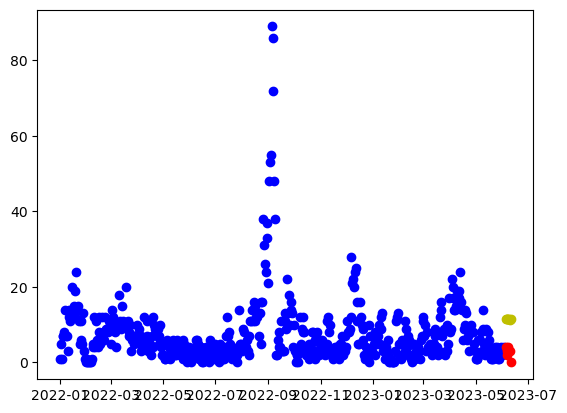

[4 3 2 4 3 3 0]
---
[11.56636178 11.41981555 11.46751691 11.58357572 11.53608548 11.24144518
 11.4240251 ]
SMAPE_lr: 1.2644382392912858


17:02:18 - cmdstanpy - INFO - Chain [1] start processing
17:02:18 - cmdstanpy - INFO - Chain [1] done processing


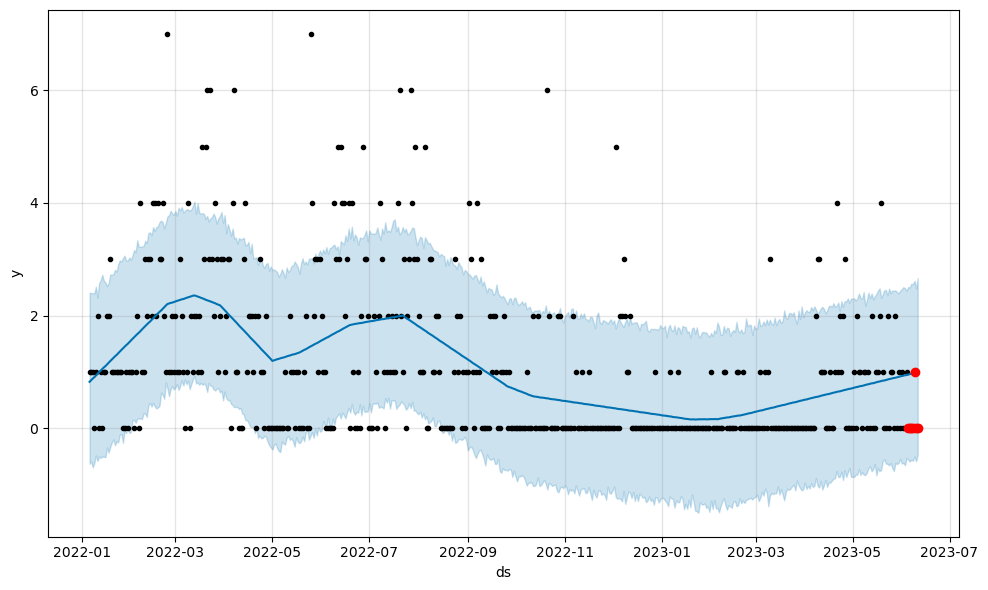

            ds      yhat  yhat_lower  yhat_upper
517 2023-06-07  0.968121   -0.558141    2.565951
518 2023-06-08  0.973623   -0.578803    2.552979
519 2023-06-09  0.981801   -0.503593    2.616345
520 2023-06-10  0.988693   -0.588364    2.482317
521 2023-06-11  0.991719   -0.473309    2.664299
[0 0 0 0 1 0 0]
---
[0.9517647  0.95818158 0.96812057 0.97362281 0.9818007  0.98869276
 0.99171863]
SMAPE: 1.7169094891428969


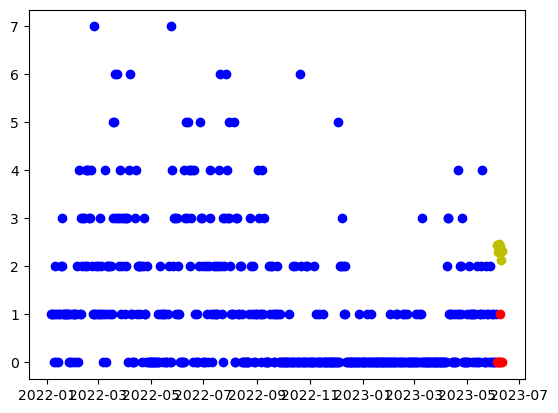

17:02:19 - cmdstanpy - INFO - Chain [1] start processing


[0 0 0 0 1 0 0]
---
[2.43996527 2.29923724 2.35275681 2.47463382 2.43296179 2.14413969
 2.33253781]
SMAPE_lr: 1.8335464806561654


17:02:19 - cmdstanpy - INFO - Chain [1] done processing


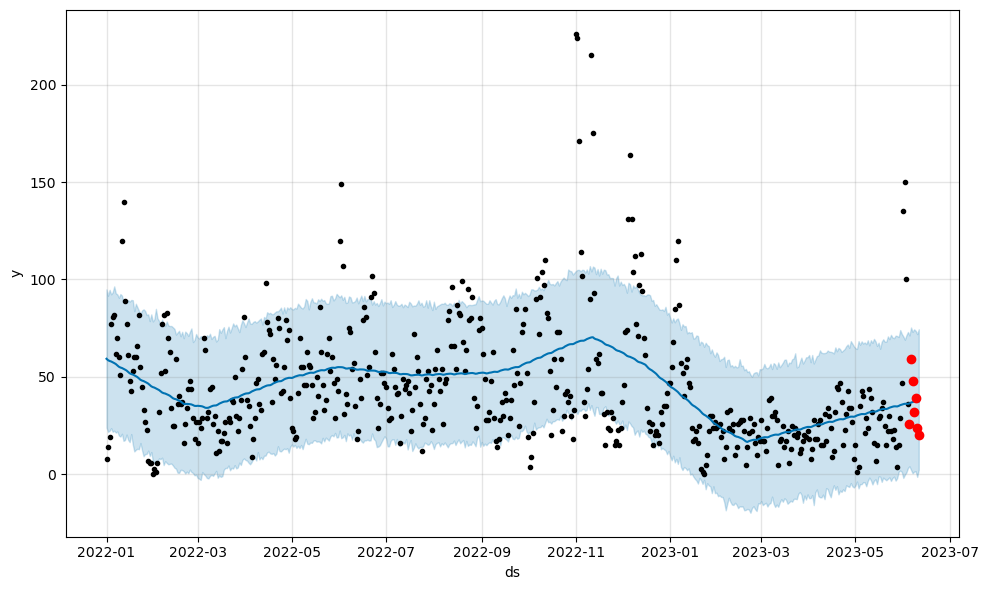

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  37.106655    0.571625   73.104126
523 2023-06-08  37.344751    1.374925   74.407885
524 2023-06-09  37.536093    1.576882   73.667742
525 2023-06-10  37.540992   -1.304666   71.986871
526 2023-06-11  37.478418    2.366099   74.463854
[26 59 48 32 39 24 20]
---
[36.42551495 36.8406727  37.1066545  37.34475111 37.53609262 37.54099234
 37.47841789]
SMAPE: 0.32758128878583265


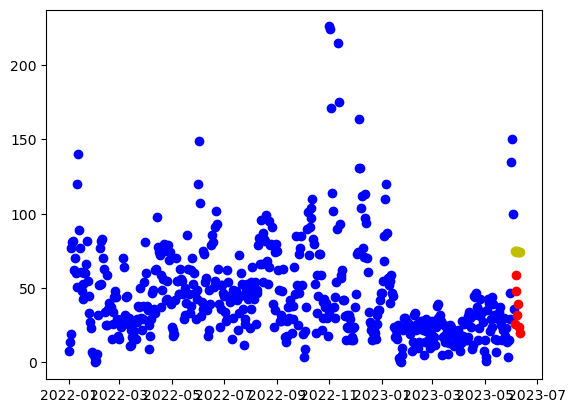

17:02:20 - cmdstanpy - INFO - Chain [1] start processing
17:02:20 - cmdstanpy - INFO - Chain [1] done processing


[26 59 48 32 39 24 20]
---
[74.9236138  74.68531147 74.64125672 74.66555942 74.52631307 74.13991666
 74.23074047]
SMAPE_lr: 0.7481882675198064


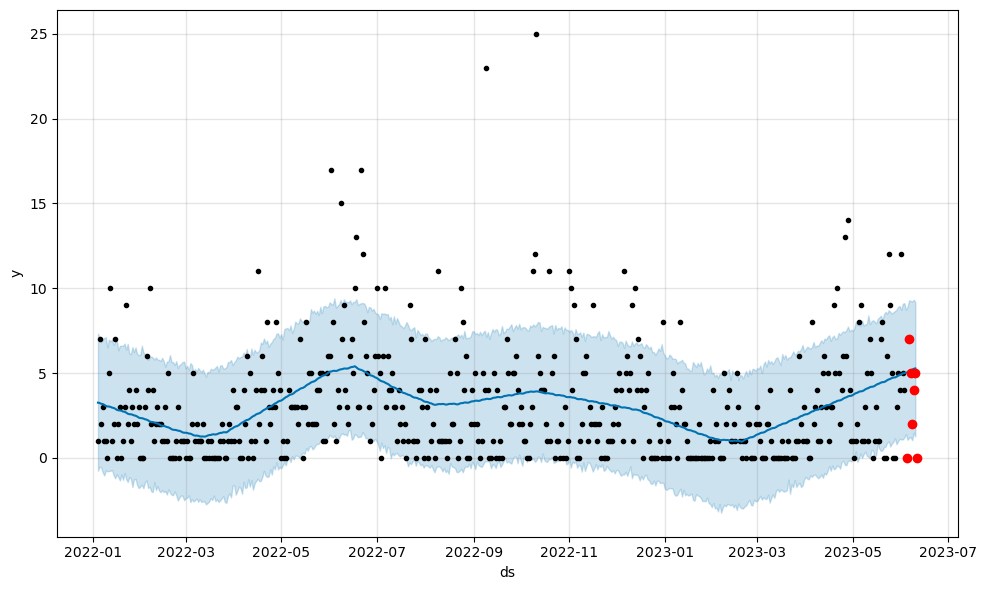

            ds      yhat  yhat_lower  yhat_upper
518 2023-06-06  5.114869    1.180188    9.282392
519 2023-06-07  5.164724    1.216243    9.258943
520 2023-06-08  5.192929    1.041208    9.215097
521 2023-06-09  5.246941    1.478341    9.320495
522 2023-06-10  5.272388    1.257793    9.185019
[0 7 5 2 4 5 0]
---
[5.00997357 5.05005181 5.11486943 5.16472385 5.19292879 5.24694119
 5.27238783]
SMAPE: 0.7910717906562993


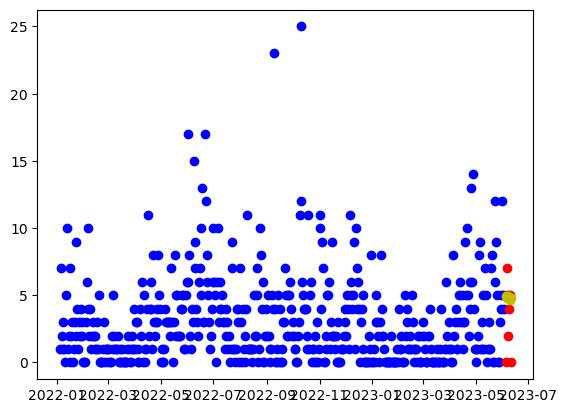

17:02:20 - cmdstanpy - INFO - Chain [1] start processing


[0 7 5 2 4 5 0]
---
[4.91309139 4.77194901 4.82505422 4.94651688 4.90443049 4.61519404
 4.8031778 ]
SMAPE_lr: 0.7922391985458628


17:02:21 - cmdstanpy - INFO - Chain [1] done processing


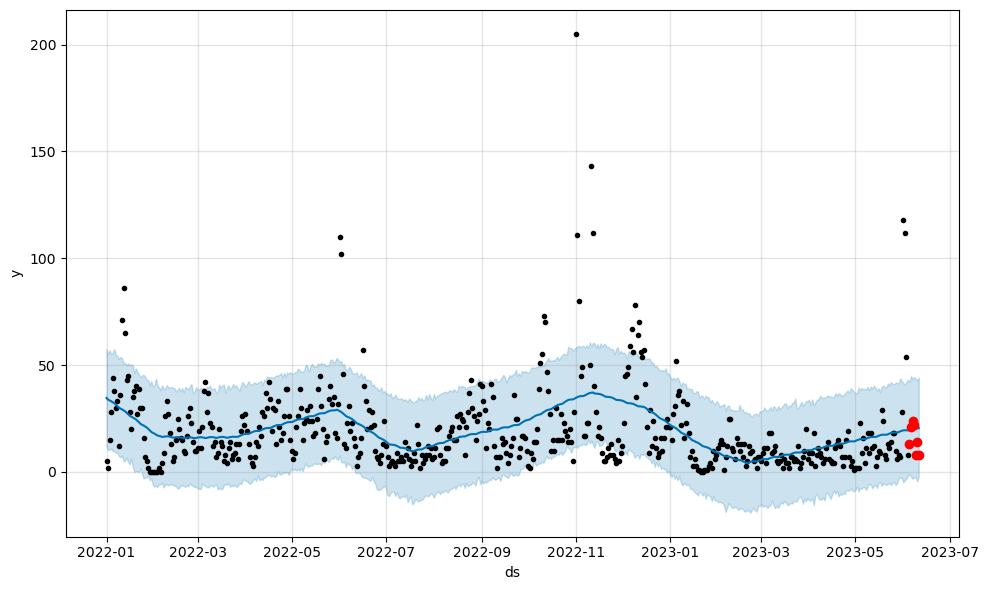

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  20.287214   -3.237312   43.437596
523 2023-06-08  20.521154   -2.602057   44.356876
524 2023-06-09  20.545803   -2.579973   43.782477
525 2023-06-10  20.559833   -4.422251   42.680384
526 2023-06-11  20.490145   -2.105700   44.275898
[13 21 24 22  8 14  8]
---
[19.7115974  20.04264676 20.28721375 20.52115397 20.54580311 20.55983306
 20.49014477]
SMAPE: 0.40423557021070383


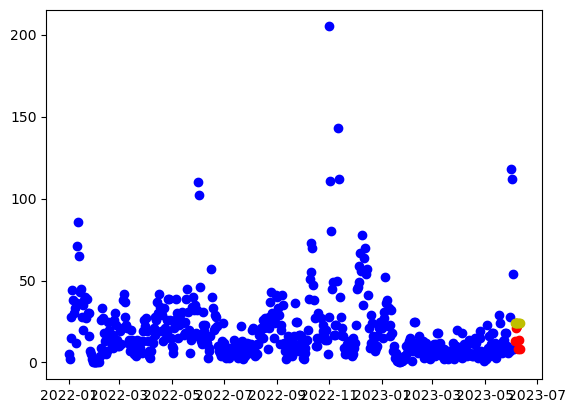

17:02:21 - cmdstanpy - INFO - Chain [1] start processing


[13 21 24 22  8 14  8]
---
[24.35057526 24.19590436 24.23548104 24.34341517 24.28780026 23.98503528
 24.15949052]
SMAPE_lr: 0.48567356080373536


17:02:21 - cmdstanpy - INFO - Chain [1] done processing


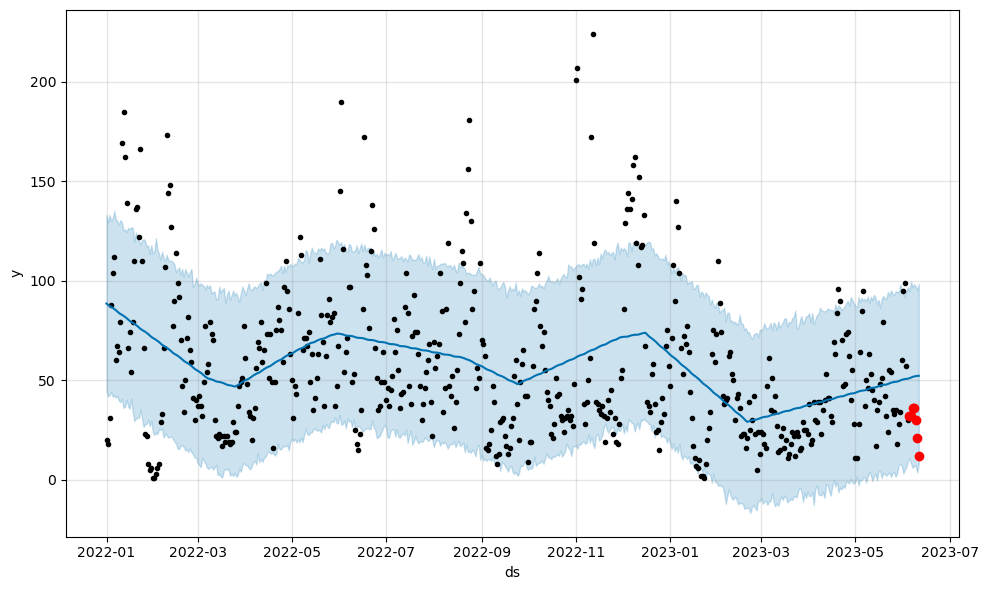

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  51.651606    5.939947   96.690923
523 2023-06-08  51.863450    6.859969   98.236103
524 2023-06-09  52.051145    7.059699   97.258343
525 2023-06-10  52.146864    3.543952   95.269462
526 2023-06-11  52.210246    8.278414   98.485684
[32 32 36 36 30 21 12]
---
[51.00259532 51.33591834 51.65160573 51.86345003 52.05114456 52.14686376
 52.21024569]
SMAPE: 0.6116759097466786


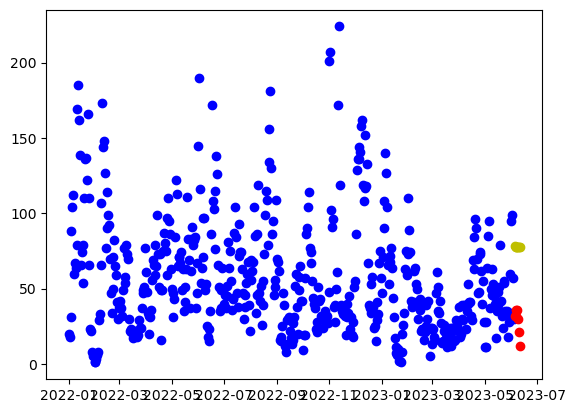

17:02:22 - cmdstanpy - INFO - Chain [1] start processing
17:02:22 - cmdstanpy - INFO - Chain [1] done processing


[32 32 36 36 30 21 12]
---
[78.13288407 77.91758293 77.8965294  77.9438333  77.82758816 77.46419296
 77.57801797]
SMAPE_lr: 0.9490481909567384


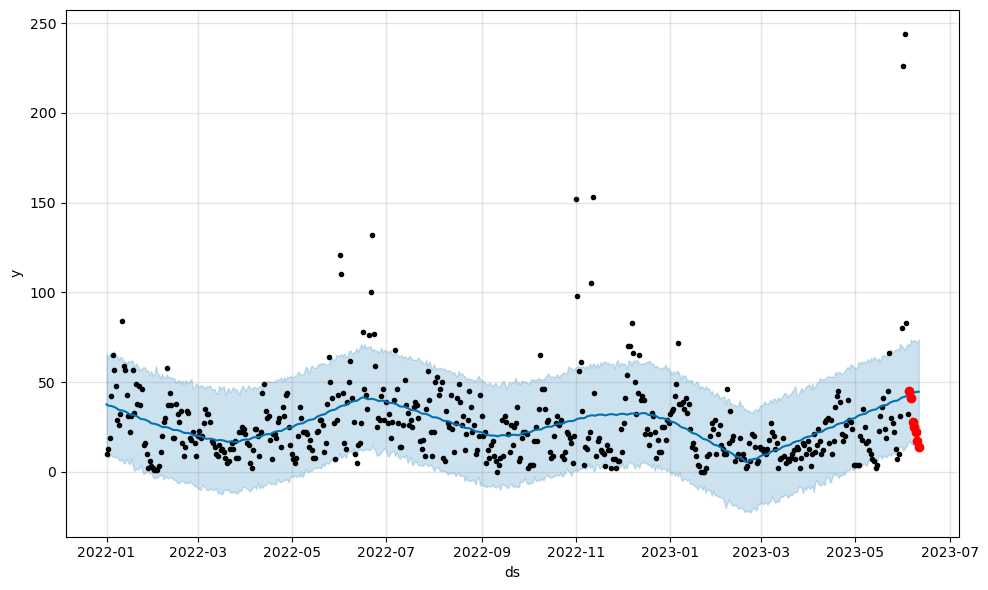

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  43.816096   14.916037   72.291701
523 2023-06-08  44.139172   15.689477   73.457762
524 2023-06-09  44.439678   15.994340   73.021423
525 2023-06-10  44.590169   13.861521   71.918145
526 2023-06-11  44.672095   16.880853   73.929224
[45 41 28 25 22 17 14]
---
[42.66434835 43.31481371 43.81609646 44.13917153 44.43967793 44.59016852
 44.67209505]
SMAPE: 0.5313226903834602


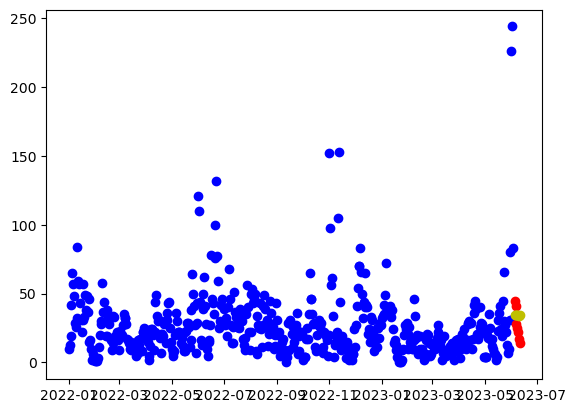

17:02:23 - cmdstanpy - INFO - Chain [1] start processing
17:02:23 - cmdstanpy - INFO - Chain [1] done processing


[45 41 28 25 22 17 14]
---
[34.37790542 34.2157477  34.24783758 34.34828489 34.28518317 33.97493138
 34.14189981]
SMAPE_lr: 0.41473094228996754


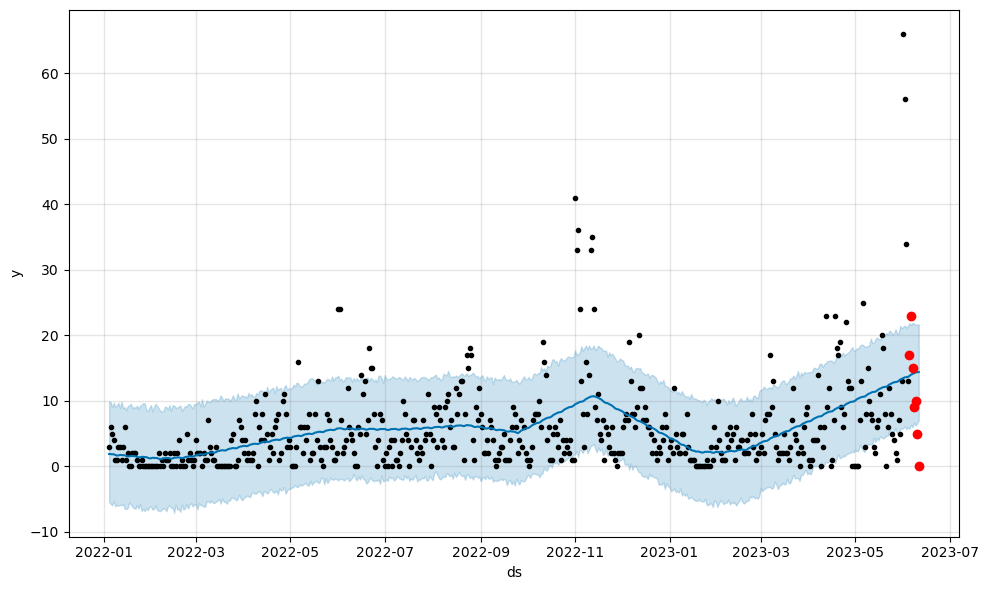

            ds       yhat  yhat_lower  yhat_upper
519 2023-06-07  14.108340    5.982987   21.888119
520 2023-06-08  14.238959    6.678767   21.748221
521 2023-06-09  14.326764    6.232851   21.608790
522 2023-06-10  14.363935    6.626591   21.636818
523 2023-06-11  14.395331    6.980167   21.660742
[17 23 15  9 10  5  0]
---
[13.79007958 13.99085998 14.10833991 14.23895889 14.32676374 14.36393537
 14.3953308 ]
SMAPE: 0.6472313057507932


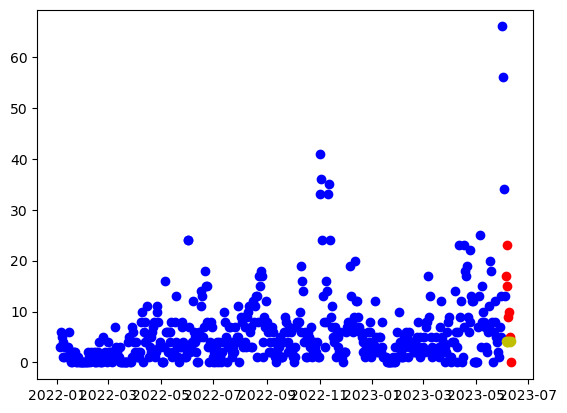

17:02:24 - cmdstanpy - INFO - Chain [1] start processing
17:02:24 - cmdstanpy - INFO - Chain [1] done processing


[17 23 15  9 10  5  0]
---
[4.17365474 4.04516485 4.11092255 4.2450377  4.2156038  3.93901984
 4.13965609]
SMAPE_lr: 1.0745730534622953


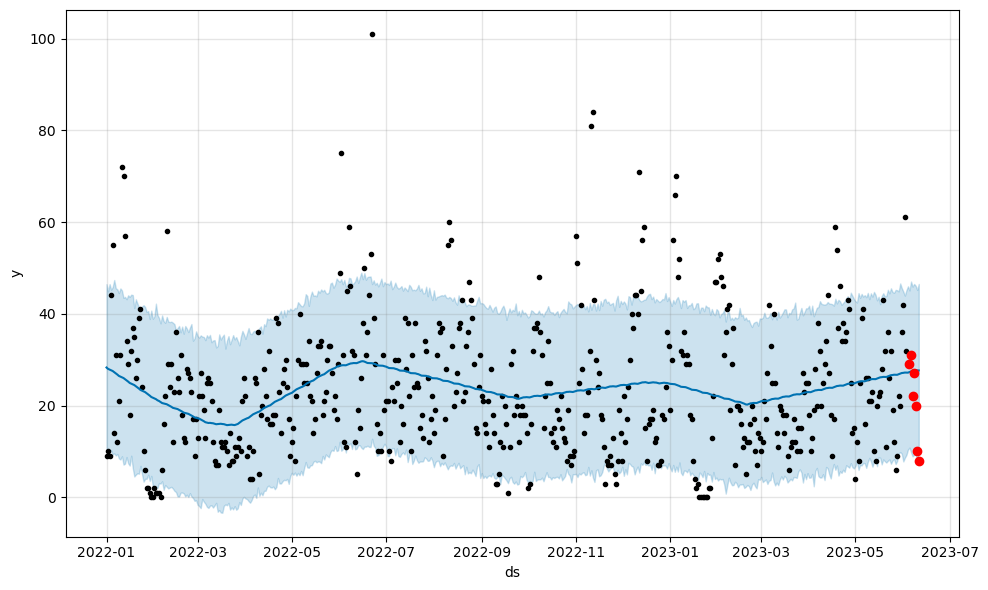

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  27.565496    8.929368   45.926721
523 2023-06-08  27.602736    9.251915   46.507523
524 2023-06-09  27.665469    9.287763   46.117797
525 2023-06-10  27.656705    7.842706   45.201142
526 2023-06-11  27.647931    9.738038   46.509618
[29 31 22 27 20 10  8]
---
[27.30795431 27.43968245 27.56549609 27.60273633 27.66546922 27.65670539
 27.64793111]
SMAPE: 0.398619237941714


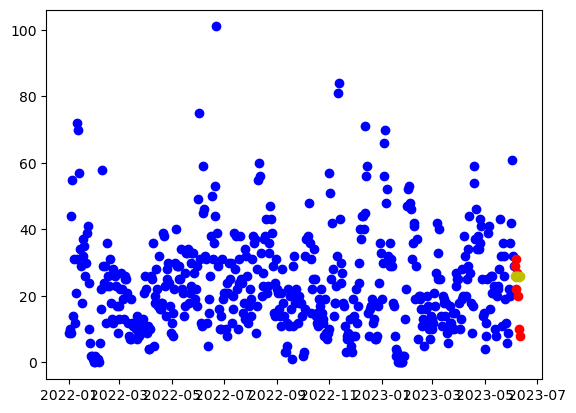

17:02:25 - cmdstanpy - INFO - Chain [1] start processing


[29 31 22 27 20 10  8]
---
[25.97144318 25.829362   25.88152842 26.00205228 25.9590271  25.66885186
 25.85589683]
SMAPE_lr: 0.3835220986633831


17:02:25 - cmdstanpy - INFO - Chain [1] done processing


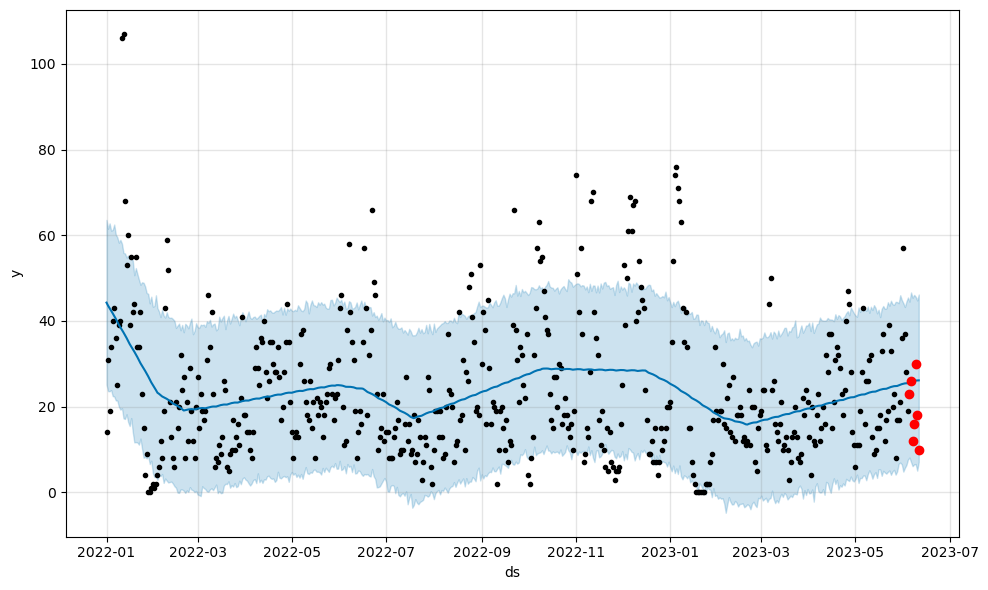

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  25.911252    6.111927   45.419451
523 2023-06-08  26.013637    6.521425   46.099352
524 2023-06-09  26.092202    6.604738   45.673115
525 2023-06-10  26.115571    5.063847   44.802728
526 2023-06-11  26.142730    7.109863   46.186338
[23 26 12 16 30 18 10]
---
[25.63336603 25.79301702 25.91125197 26.01363687 26.09220152 26.11557095
 26.14272987]
SMAPE: 0.38962746860173586


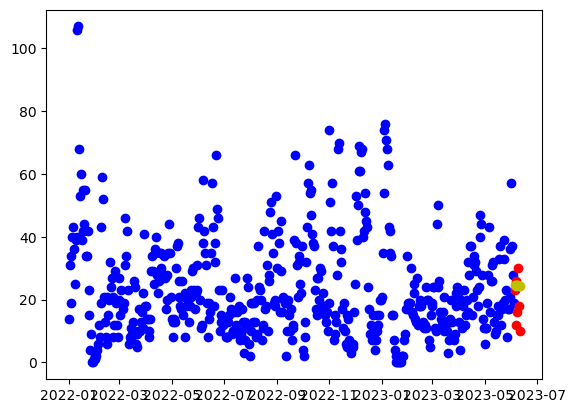

17:02:25 - cmdstanpy - INFO - Chain [1] start processing


[23 26 12 16 30 18 10]
---
[24.61119194 24.46994436 24.52294438 24.64430184 24.60211026 24.31276861
 24.50064717]
SMAPE_lr: 0.3680199235558084


17:02:26 - cmdstanpy - INFO - Chain [1] done processing


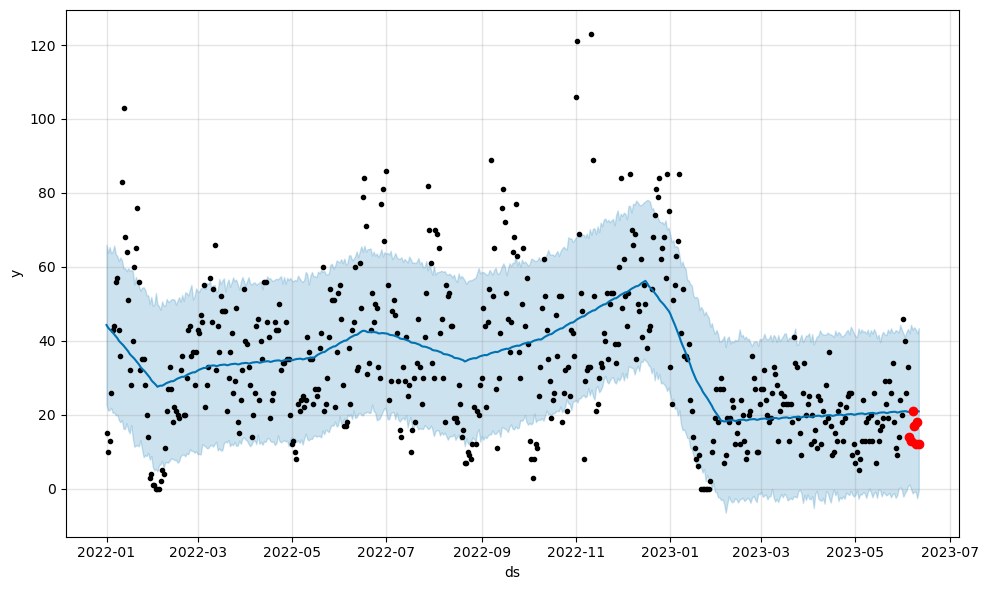

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  21.034012   -1.281656   42.974255
523 2023-06-08  21.056392   -0.855063   43.646149
524 2023-06-09  21.108922   -0.808001   43.130946
525 2023-06-10  21.073259   -2.602937   42.037503
526 2023-06-11  20.906388   -0.508304   43.448790
[14 13 21 17 12 18 12]
---
[20.80435968 20.94265293 21.03401205 21.05639169 21.10892234 21.07325876
 20.90638847]
SMAPE: 0.3318100877853417


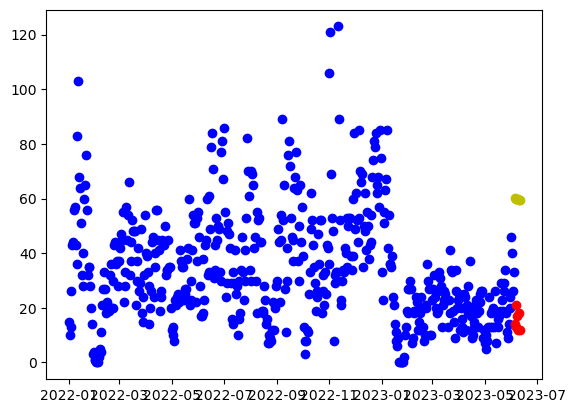

17:02:27 - cmdstanpy - INFO - Chain [1] start processing


[14 13 21 17 12 18 12]
---
[60.11206716 59.8921464  59.86647322 59.90915749 59.78829272 59.42027788
 59.52948326]
SMAPE_lr: 1.1912031213017291


17:02:27 - cmdstanpy - INFO - Chain [1] done processing


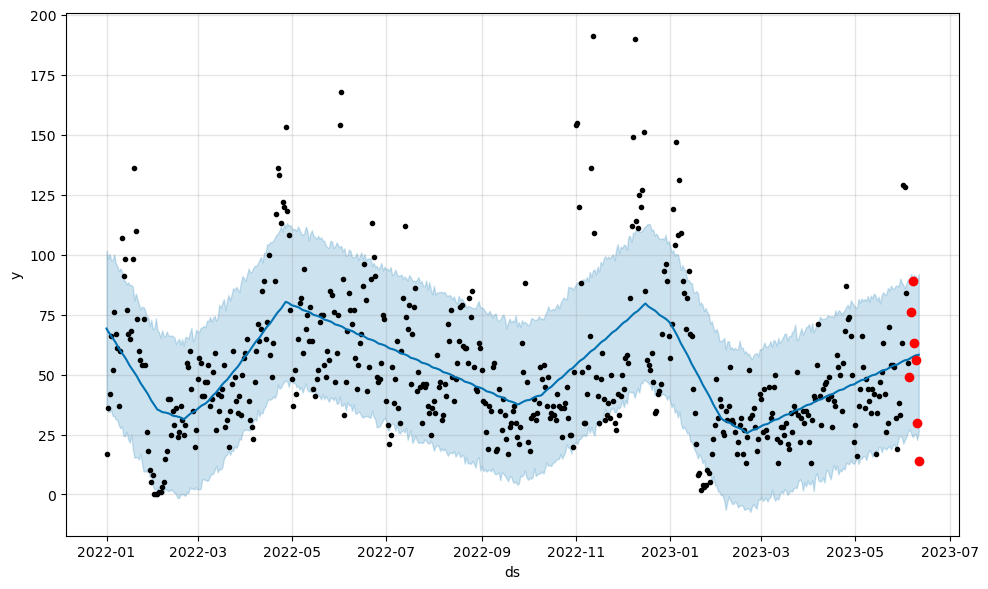

            ds       yhat  yhat_lower  yhat_upper
522 2023-06-07  57.368462   23.918806   90.143281
523 2023-06-08  57.714686   24.988614   91.479059
524 2023-06-09  57.987342   25.247358   90.884327
525 2023-06-10  58.108300   22.740276   89.425151
526 2023-06-11  58.259509   26.227513   91.933846
[49 76 89 63 56 30 14]
---
[56.57715984 57.01177498 57.36846171 57.7146864  57.98734155 58.10830021
 58.25950941]
SMAPE: 0.4066799395893242


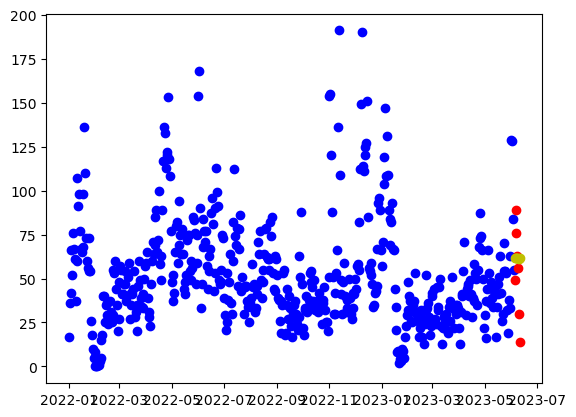

[49 76 89 63 56 30 14]
---
[61.82486977 61.64725347 61.66388477 61.7488735  61.6703132  61.34460283
 61.49611267]
SMAPE_lr: 0.4091187571686247


In [55]:
# use prophet to predict the data in ndf_gp_list
from prophet import Prophet

acc_hot_list = []
acc_hot_lr_list = []

for idx, group in enumerate(df_hot_gp_list):
    # continue when the number of rows in group is less than 10
    if len(group) < 10:
        continue
        
    m = Prophet(seasonality_prior_scale=0.001,changepoint_prior_scale=0.9)
    m.fit(group)
    future = m.make_future_dataframe(periods=7)
    forecast = m.predict(future)
    
    # plot in a small window
    m.plot(forecast)
    
    # plot the true data in Next 7 Days
    # find the key: start_city_id
    start_city_id = group['start_city_id'].values[0]
    df_new = df_gp_dict[start_city_id]
    df_new = df_new[df_new['ds'] >= hot_season_valid]
    df_new = df_new[df_new['ds'] < (hot_season_valid + pd.Timedelta(days=7))]
    
    # plot the df_new in the same window
    plt.plot(df_new['ds'], df_new['y'], 'ro')
    
    plt.savefig('./figs/hot_season/{}.png'.format(start_city_id))
    plt.show()
    print(forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail())
    
    
    # calculate the accuracy of the prediction in these 7 days by 1 - MAPE
    # MAPE = mean(abs(y-yhat)/y)
    y = df_new['y'].values
    print(y)
    print('---')
    yhat = forecast['yhat'].values[-7:]
    print(yhat)
    SMAPE = 2.0 * np.mean(np.abs(y-yhat)/ (np.abs(y)+np.abs(yhat)))
    
    accuracy = SMAPE
    print('SMAPE: {}'.format(accuracy))
    acc_hot_list.append(accuracy)
    
    
    # test noisy linear regression
    # the values of x and y in 1 month
    min_date = min(group['ds'])
    
    history_len = 360
    x = np.array([(pd.to_datetime(t) - min_date).days for t in group['ds']][-history_len:])
    y = np.array(group['y'].values[-history_len:])
    
    # model by LR
    model = LinearRegression()
    model.fit(x.reshape(-1, 1), y)

    # get w and b
    slope = model.coef_[0]
    intercept = model.intercept_

    # predict 
    future_x = np.arange(y[-1], y[-1]+7)
    future_prediction = model.predict(future_x.reshape(-1, 1))

    # add random noise
    np.random.seed(0)
    random_noise = np.random.normal(0, 1, size=len(future_x))
    future_prediction_with_noise = future_prediction + 0.1 * random_noise
    
    
    plt.plot(group['ds'], group['y'], 'bo')
    plt.plot(df_new['ds'], df_new['y'], 'ro')
    plt.plot(df_new['ds'], future_prediction_with_noise, 'yo')
    
    plt.savefig('./figs/lr/hot_season/{}.png'.format(start_city_id))
    plt.show()
    
    future_prediction_with_noise = np.clip(future_prediction_with_noise, 0, None)
    
    y = df_new['y'].values
    print(y)
    print('---')
    yhat = future_prediction_with_noise
    print(future_prediction_with_noise)
    SMAPE_lr = 2.0 * np.mean(np.abs(y-future_prediction_with_noise)/ (np.abs(y)+np.abs(future_prediction_with_noise)))
    
    accuracy_lr = SMAPE_lr
    print('SMAPE_lr: {}'.format(accuracy_lr))
    acc_hot_lr_list.append(accuracy_lr)


In [56]:
# Print the SMAPE of hot season
print(np.mean(acc_hot_list))
print(np.mean(acc_hot_lr_list))

0.6457437880416868
0.9063265148313527


In [57]:
cold_season_valid = pd.to_datetime('2023-07-10')
df_cold = df[df['plan_in_load_time'] < cold_season_valid]

# generate a new dataframe which is groupby df by the columns 'start_city_id'
df_cold_gp = df_cold.groupby(['start_city_id'])
df_cold_gp

In [58]:
# transfer the groupby object to a list of small dataframes
df_cold_gp_list = []

for _, group in df_cold_gp:
    
    start_city_id = group['start_city_id'].values[0]
    print(group['start_city_id'].values[0])
    
    # rename the column 'plan_in_load_time' of group to 'y'
    group = group.rename(columns={'plan_in_load_time': 'y'})
    
    # NEW DATAFRAME
    # get the column 'y' and 'is_success' of group
    group['is_success'] = 1
    group = group[['y', 'is_success']]
    
    # group by 'y'
    group = group.groupby('y').sum()
    group = group[['is_success']]
    
    # NEW FORMAT
    # rename the column 'is_success' to 'y' and the index to 'ds'
    group = group.rename(columns={'is_success': 'y'})
    group.index.name = 'ds'
    
    # fill the missing days in group using the value 0
    group.index = pd.to_datetime(group.index)
    group = group.resample('D').sum()
    group = group.fillna(0)

    # set a new column 'ds' which is the index of group
    group['ds'] = group.index
    
    group['start_city_id'] = start_city_id
    
    # add group to df_cold_gp_list
    df_cold_gp_list.append(group)
    
df_cold_gp_list

37
40
41
49
52
53
58
60
62
76
77
78
79
80
82
83
84
87
94
95
97
107
111
116
119
138
139
140
143
144
147
149
150
160
164
165
167
180
182
186
194
197
201
220
221
222
223
224
225
226
227
228
229
230
231
232
233
235
244
245
258
283
284
286
288
289
292
296
297
300
304
311
318
321
322
327
343
351
367
378
383
384
385
386
388
389
390
391
394
3401


[            y         ds  start_city_id
 ds                                     
 2022-01-01  2 2022-01-01             37
 2022-01-02  4 2022-01-02             37
 2022-01-03  3 2022-01-03             37
 2022-01-04  9 2022-01-04             37
 2022-01-05  8 2022-01-05             37
 ...        ..        ...            ...
 2023-07-05  5 2023-07-05             37
 2023-07-06  2 2023-07-06             37
 2023-07-07  8 2023-07-07             37
 2023-07-08  1 2023-07-08             37
 2023-07-09  2 2023-07-09             37
 
 [555 rows x 3 columns],
              y         ds  start_city_id
 ds                                      
 2022-01-01  20 2022-01-01             40
 2022-01-02   5 2022-01-02             40
 2022-01-03   0 2022-01-03             40
 2022-01-04   2 2022-01-04             40
 2022-01-05   1 2022-01-05             40
 ...         ..        ...            ...
 2023-07-04   2 2023-07-04             40
 2023-07-05   4 2023-07-05             40
 2023-07-06   2 2023

In [59]:
df_cold_valid = df[df['plan_in_load_time'] >= cold_season_valid]
df_cold_valid = df_cold_valid[df_cold_valid['plan_in_load_time'] < (cold_season_valid + pd.Timedelta(days=7))]
df_cold_valid

,ordersn,model_type_name,customer_id,is_success,start_city_name,end_city_name,start_city_id,end_city_id,order_time,plan_in_load_time
184,830713050764763,zc,370827,0,临沂,绍兴,292,389,2023-07-13 12:17:20,2023-07-13
356,430713050797522,zc,370814,0,武汉,深圳,180,77,2023-07-13 15:25:55,2023-07-13
647,530715091170045,zc,213630,0,徐州,长沙,229,197,2023-07-15 08:11:59,2023-07-15
656,330713550803156,zc,370272,0,徐州,佛山,229,80,2023-07-13 15:54:36,2023-07-13
659,530714550981595,zc,355336,1,合肥,南昌,3401,233,2023-07-14 14:06:41,2023-07-14
...,...,...,...,...,...,...,...,...,...,...
1056332,230713550782494,ka,147273,1,东莞,西安,79,311,2023-07-13 14:39:42,2023-07-14
1056333,330714520886532,ka,143664,1,无锡,成都,222,322,2023-07-14 08:41:48,2023-07-14
1056394,33071052013257,ka,353091,1,北京,乌鲁木齐,52,351,2023-07-10 09:16:57,2023-07-10
1056528,1030714091155138,ka,2537,1,沈阳,西安,244,311,2023-07-14 22:15:37,2023-07-14


17:02:29 - cmdstanpy - INFO - Chain [1] start processing
17:02:29 - cmdstanpy - INFO - Chain [1] done processing


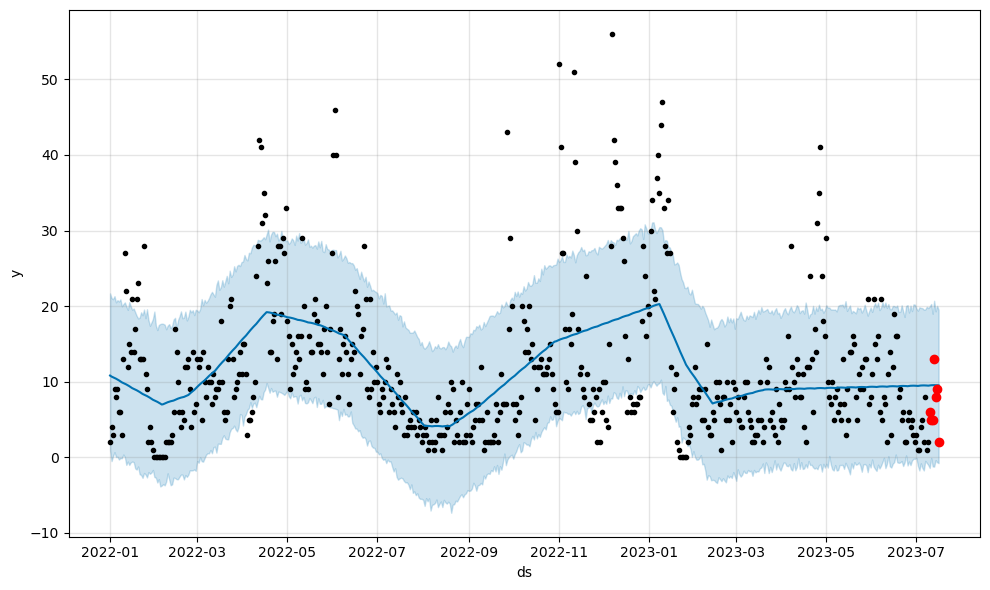

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  9.548376   -1.204487   18.985449
558 2023-07-13  9.551911   -1.226533   20.712988
559 2023-07-14  9.550327   -0.371923   19.312613
560 2023-07-15  9.535553   -0.642617   20.039874
561 2023-07-16  9.516376   -0.766525   19.536298
[ 6  5  5 13  8  9  2]
---
[9.50905168 9.53739756 9.54837629 9.55191128 9.55032725 9.53555315
 9.51637626]
SMAPE: 0.5068025355708613


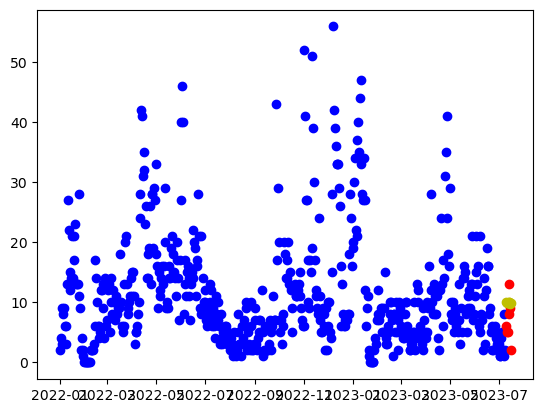

17:02:30 - cmdstanpy - INFO - Chain [1] start processing
17:02:30 - cmdstanpy - INFO - Chain [1] done processing


[ 6  5  5 13  8  9  2]
---
[10.04285795  9.9088702   9.96913005 10.09774734 10.06281559  9.78073377
  9.97587216]
SMAPE_lr: 0.5316113673838443


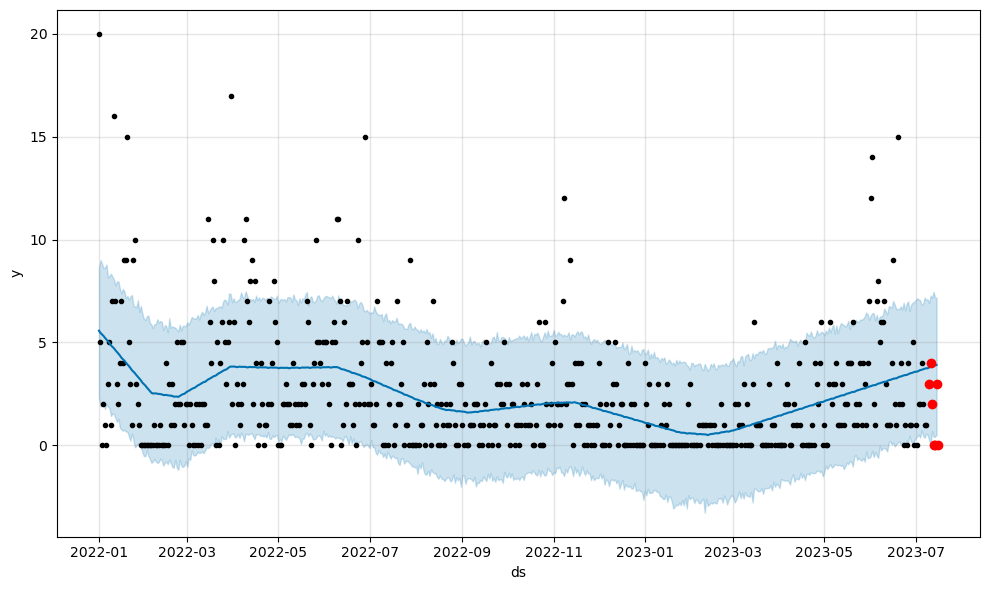

            ds      yhat  yhat_lower  yhat_upper
556 2023-07-11  3.817926    0.013452    7.274856
557 2023-07-12  3.833440    0.690369    7.167173
558 2023-07-13  3.861567    0.410893    7.459994
559 2023-07-14  3.885693    0.418965    7.193288
560 2023-07-15  3.907294    0.510057    7.165140
[3 4 2 0 0 3 0]
---
[3.74283287 3.77797562 3.81792624 3.83343958 3.86156699 3.88569305
 3.90729375]
SMAPE: 1.0228026773924712


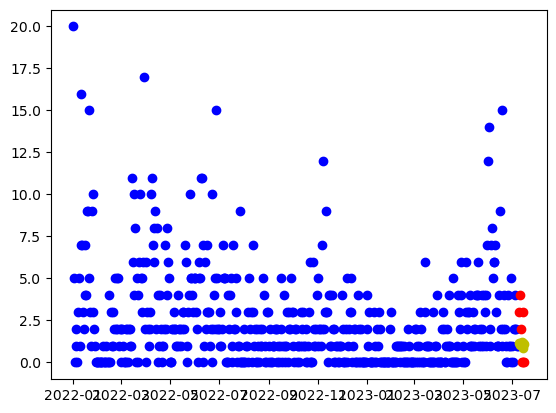

17:02:31 - cmdstanpy - INFO - Chain [1] start processing
17:02:31 - cmdstanpy - INFO - Chain [1] done processing


[3 4 2 0 0 3 0]
---
[1.14488986 1.01067294 1.07070362 1.19909174 1.16393082 0.88161983
 1.07652906]
SMAPE_lr: 1.3978677174099279


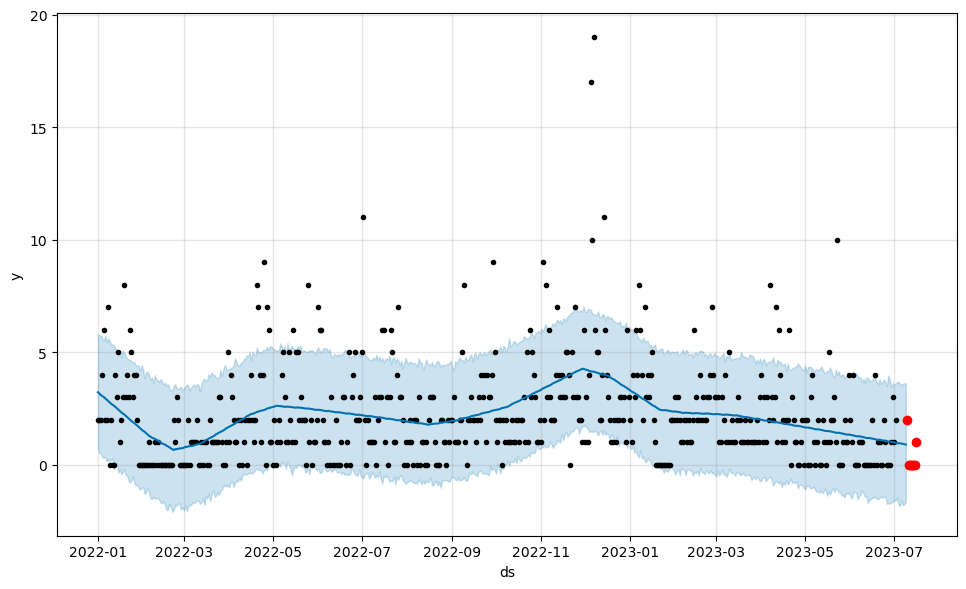

            ds      yhat  yhat_lower  yhat_upper
550 2023-07-05  0.969397   -1.817162    3.620650
551 2023-07-06  0.948777   -1.557985    3.541154
552 2023-07-07  0.941029   -1.784809    3.614916
553 2023-07-08  0.923554   -1.731290    3.623238
554 2023-07-09  0.904400   -1.643763    3.630585
[2 0 0 0 0 0 1]
---
[0.96851369 0.96164081 0.96939655 0.9487775  0.94102948 0.92355376
 0.90439983]
SMAPE: 1.5421929458958772


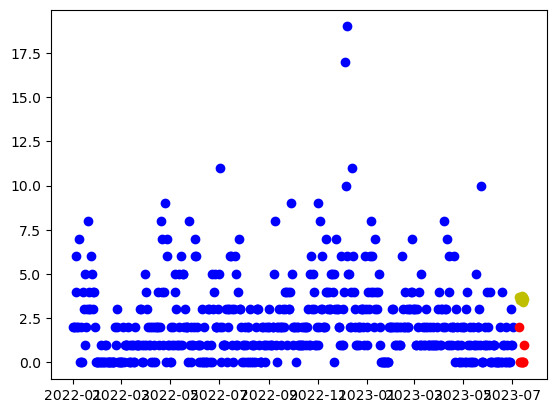

17:02:31 - cmdstanpy - INFO - Chain [1] start processing


[2 0 0 0 0 0 1]
---
[3.69654917 3.55700376 3.61170595 3.73476559 3.69427618 3.4066367
 3.59621744]
SMAPE_lr: 1.6750514529333407


17:02:32 - cmdstanpy - INFO - Chain [1] done processing


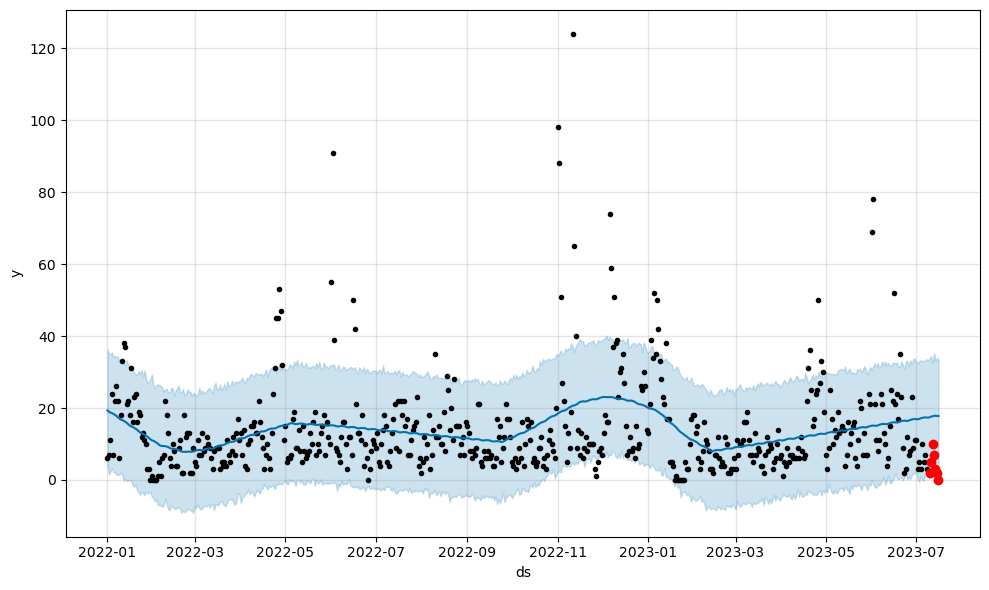

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  17.719322    0.920270   32.394272
558 2023-07-13  17.799500    0.993363   35.200621
559 2023-07-14  17.861327    2.359930   33.112813
560 2023-07-15  17.786515    1.892317   33.945404
561 2023-07-16  17.780830    1.715994   33.434818
[ 2  5 10  7  3  2  0]
---
[17.4010014  17.59457019 17.71932221 17.79950005 17.86132661 17.78651521
 17.78083022]
SMAPE: 1.3072638772401926


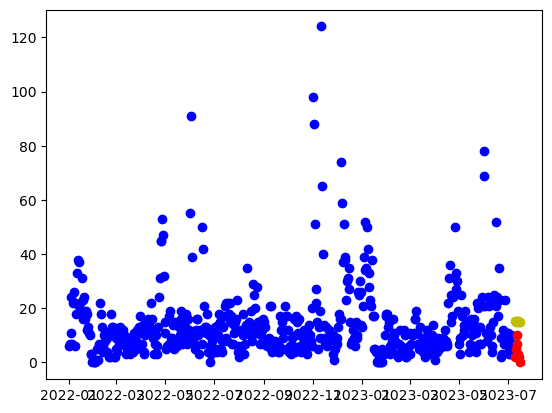

17:02:32 - cmdstanpy - INFO - Chain [1] start processing


[ 2  5 10  7  3  2  0]
---
[15.18249102 15.04458902 15.10093461 15.22563764 15.18679164 14.90079556
 15.09201971]
SMAPE_lr: 1.2214416729304496


17:02:33 - cmdstanpy - INFO - Chain [1] done processing


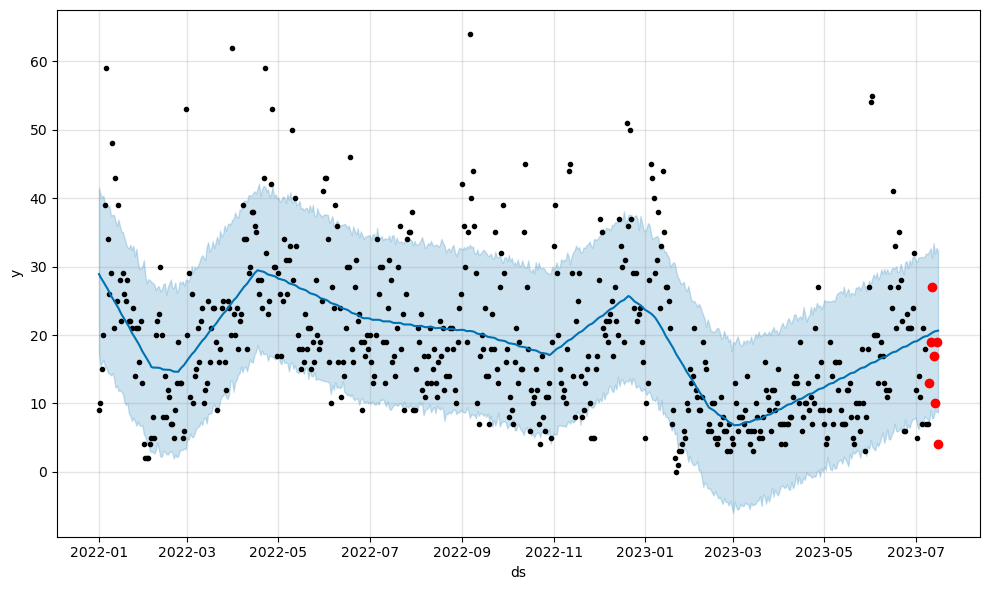

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  20.302664    7.801939   31.273719
558 2023-07-13  20.452790    7.946793   33.428083
559 2023-07-14  20.544720    9.009623   31.893850
560 2023-07-15  20.585368    8.757975   32.719612
561 2023-07-16  20.641643    8.687272   32.290287
[13 19 27 17 10 19  4]
---
[20.03006147 20.16963552 20.30266409 20.45279029 20.54472035 20.5853676
 20.64164258]
SMAPE: 0.4391692225554726


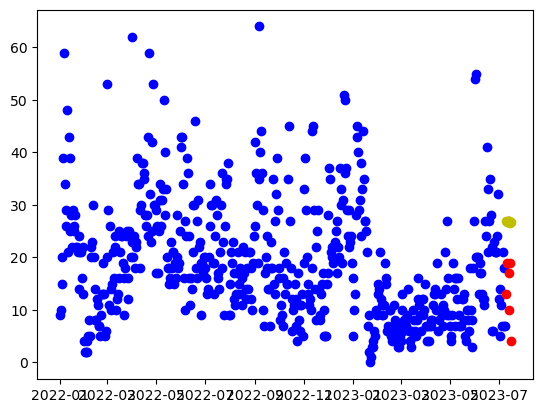

17:02:33 - cmdstanpy - INFO - Chain [1] start processing


[13 19 27 17 10 19  4]
---
[26.9735435  26.81029858 26.84130126 26.94066138 26.87647245 26.56513347
 26.73101469]
SMAPE_lr: 0.6035980535496756


17:02:34 - cmdstanpy - INFO - Chain [1] done processing


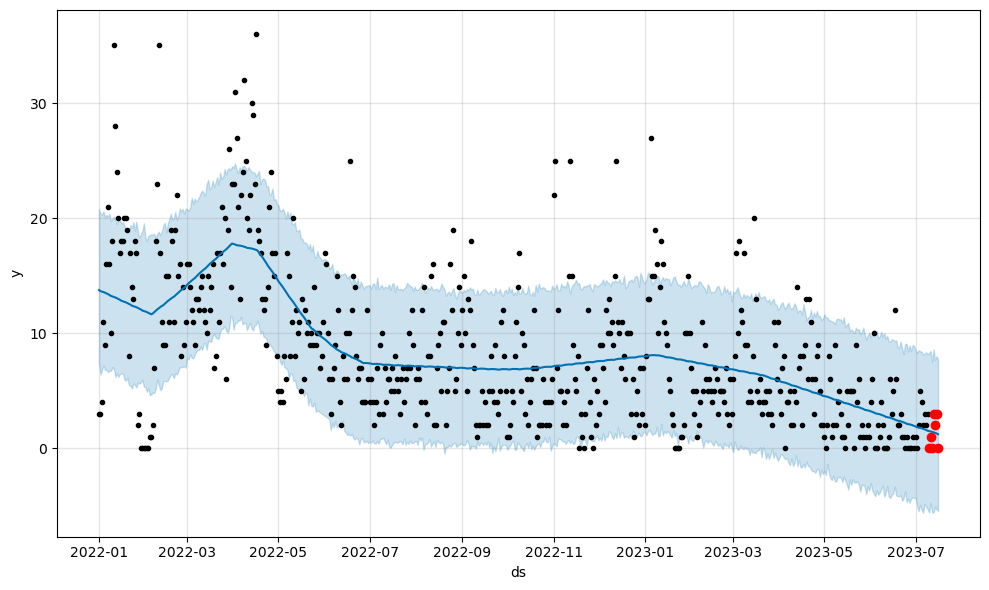

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  1.454355   -5.516101    7.543455
558 2023-07-13  1.405212   -5.568185    8.625486
559 2023-07-14  1.360799   -5.071219    7.689122
560 2023-07-15  1.307161   -5.287843    8.011994
561 2023-07-16  1.233142   -5.432665    7.727422
[0 1 0 3 2 3 0]
---
[1.50955367 1.4909769  1.45435522 1.40521179 1.36079939 1.30716134
 1.23314209]
SMAPE: 1.1835277347305129


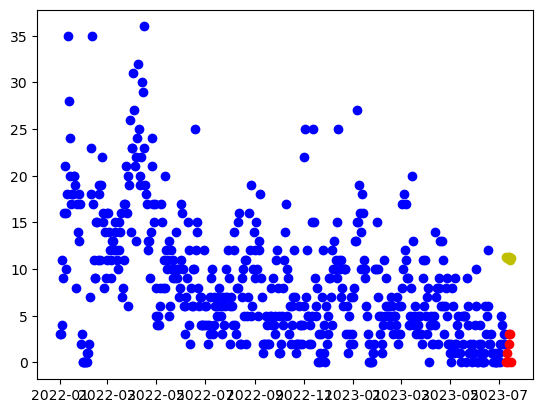

17:02:34 - cmdstanpy - INFO - Chain [1] start processing


[0 1 0 3 2 3 0]
---
[11.33015814 11.18064352 11.2253765  11.33846692 11.28800829 10.99039961
 11.17001114]
SMAPE_lr: 1.6249889920645793


17:02:35 - cmdstanpy - INFO - Chain [1] done processing


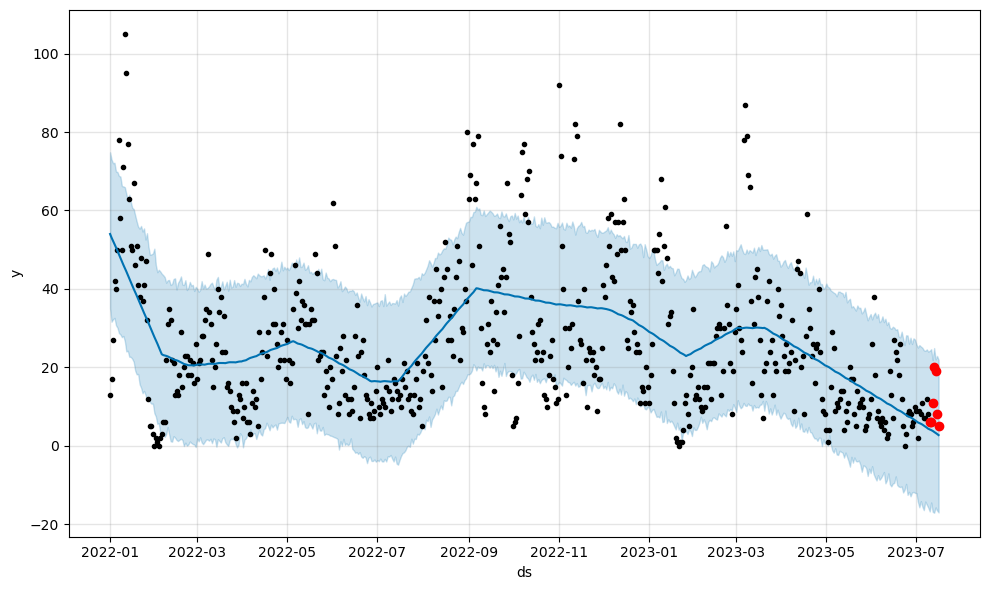

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  3.813628  -16.798013   21.903094
558 2023-07-13  3.558563  -17.061771   24.928016
559 2023-07-14  3.321214  -15.698265   22.034064
560 2023-07-15  3.025736  -16.493379   22.918836
561 2023-07-16  2.736851  -16.973942   21.943552
[ 6  6 11 20 19  8  5]
---
[4.19480335 4.01754959 3.81362797 3.55856259 3.32121367 3.02573628
 2.73685105]
SMAPE: 0.8583044590768957


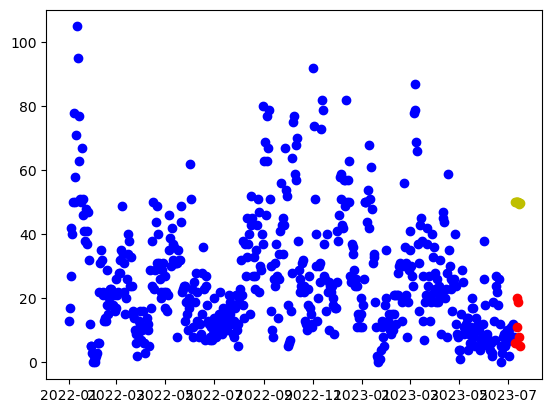

17:02:35 - cmdstanpy - INFO - Chain [1] start processing


[ 6  6 11 20 19  8  5]
---
[50.25946649 50.06037497 50.05553105 50.11904457 50.01900905 49.67182346
 49.80185809]
SMAPE_lr: 1.3232517489566606


17:02:36 - cmdstanpy - INFO - Chain [1] done processing


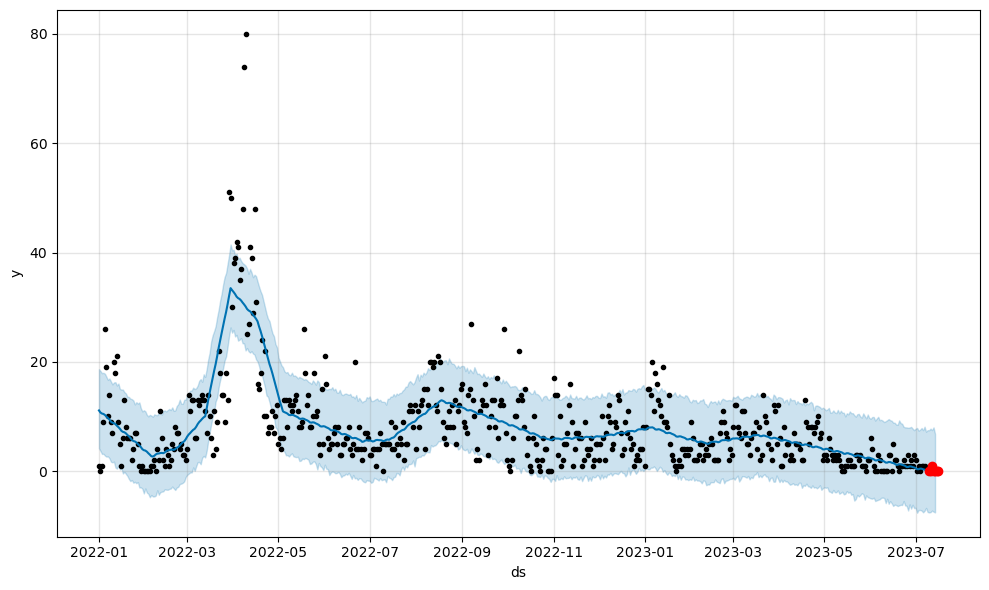

            ds      yhat  yhat_lower  yhat_upper
555 2023-07-10 -0.065619   -7.580171    7.469871
556 2023-07-11  0.040657   -7.515589    7.768664
557 2023-07-12  0.031175   -7.231868    7.488896
558 2023-07-13 -0.078997   -7.433412    7.998251
559 2023-07-14 -0.150725   -7.572863    6.808258
[0 0 1 0 0 0 0]
---
[ 0.14102331 -0.0599858  -0.06561889  0.04065702  0.03117451 -0.0789966
 -0.15072498]
SMAPE: 2.0


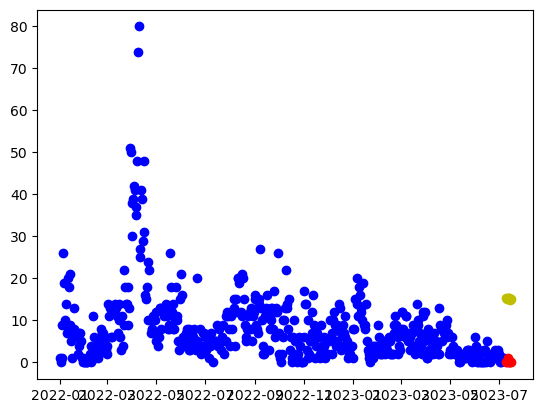

17:02:37 - cmdstanpy - INFO - Chain [1] start processing


[0 0 1 0 0 0 0]
---
[15.36399915 15.20384312 15.23793468 15.34038368 15.27928365 14.97103355
 15.14000366]
SMAPE_lr: 1.9648090362018251


17:02:37 - cmdstanpy - INFO - Chain [1] done processing


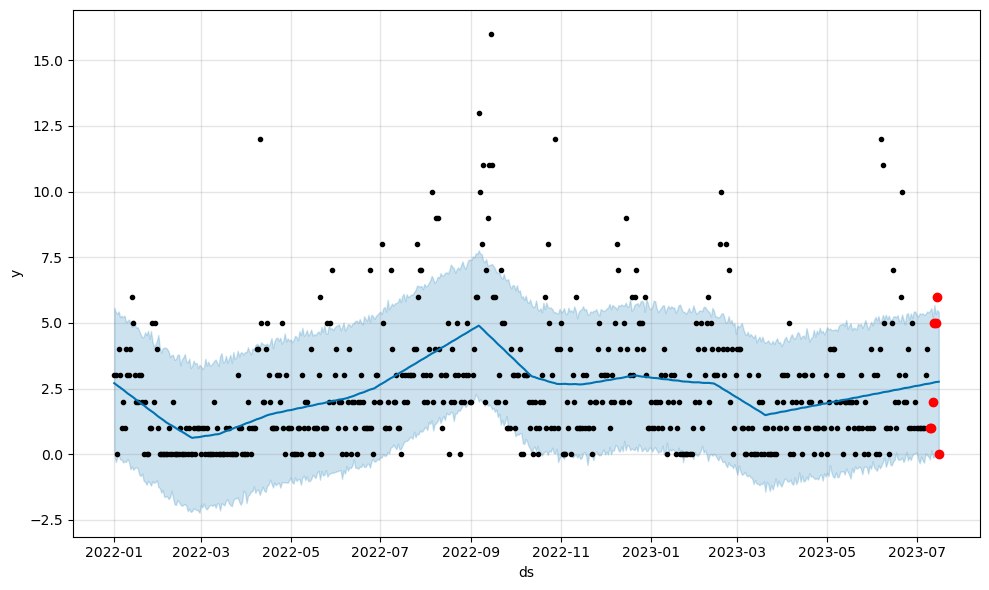

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  2.724363   -0.120781    5.209762
558 2023-07-13  2.732050   -0.114294    5.679163
559 2023-07-14  2.747235    0.121866    5.330278
560 2023-07-15  2.750747    0.058852    5.487471
561 2023-07-16  2.759592    0.038797    5.410804
[1 1 2 5 5 6 0]
---
[2.69186322 2.70666254 2.72436288 2.73205041 2.7472346  2.75074657
 2.75959172]
SMAPE: 0.8649819718000986


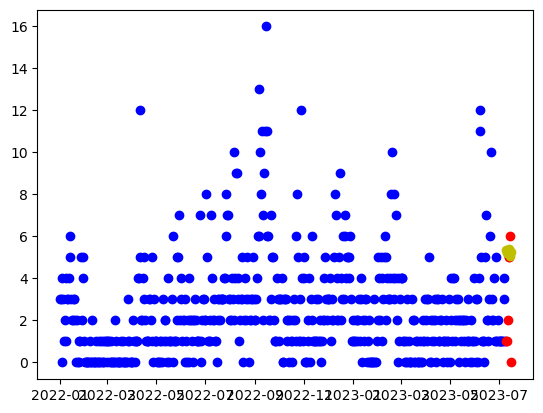

17:02:38 - cmdstanpy - INFO - Chain [1] start processing


[1 1 2 5 5 6 0]
---
[5.35686097 5.21414271 5.26567203 5.3855588  5.34189653 5.05108419
 5.23749207]
SMAPE_lr: 0.8482996959464023


17:02:38 - cmdstanpy - INFO - Chain [1] done processing


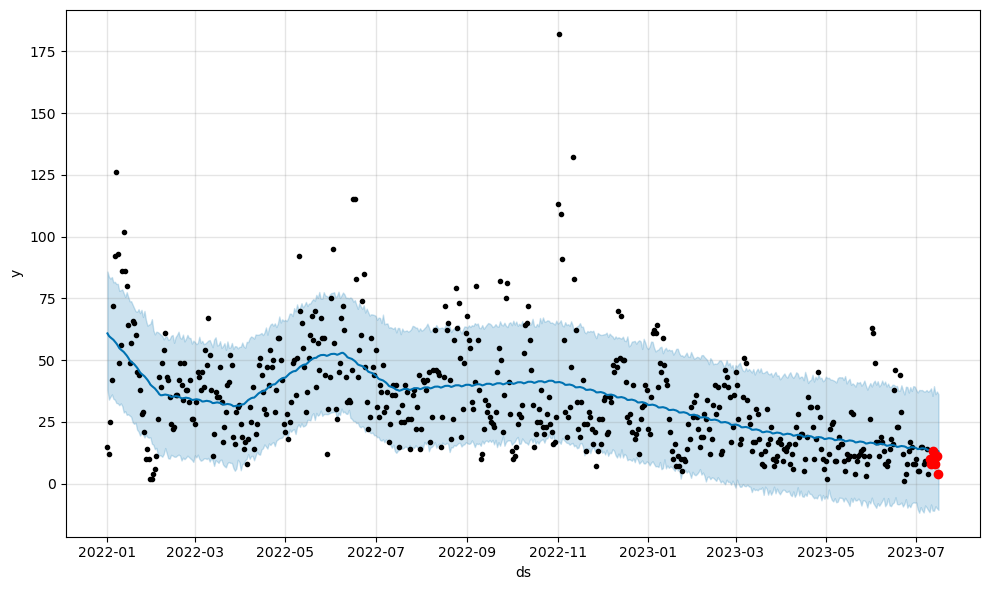

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  13.863725  -10.911876   35.506654
558 2023-07-13  13.776971  -11.009079   39.440516
559 2023-07-14  13.695734   -9.166057   36.188951
560 2023-07-15  13.449867   -9.991236   37.279525
561 2023-07-16  13.049090  -10.643674   36.129851
[10  8 13 10  8 11  4]
---
[13.56659395 13.73658157 13.86372476 13.77697058 13.69573391 13.44986676
 13.04909046]
SMAPE: 0.4285002853061379


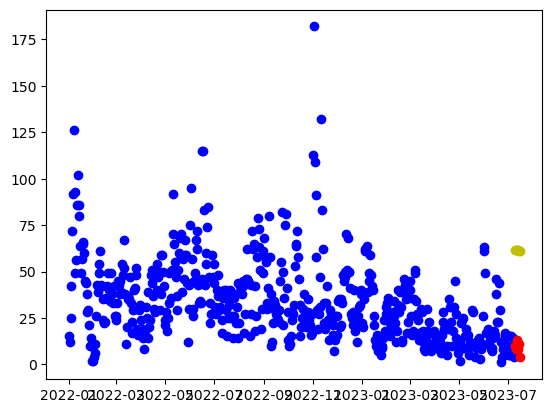

17:02:38 - cmdstanpy - INFO - Chain [1] start processing


[10  8 13 10  8 11  4]
---
[61.65881332 61.43574914 61.40693255 61.44647341 61.32246522 60.95130697
 61.05736893]
SMAPE_lr: 1.4861642876121155


17:02:39 - cmdstanpy - INFO - Chain [1] done processing


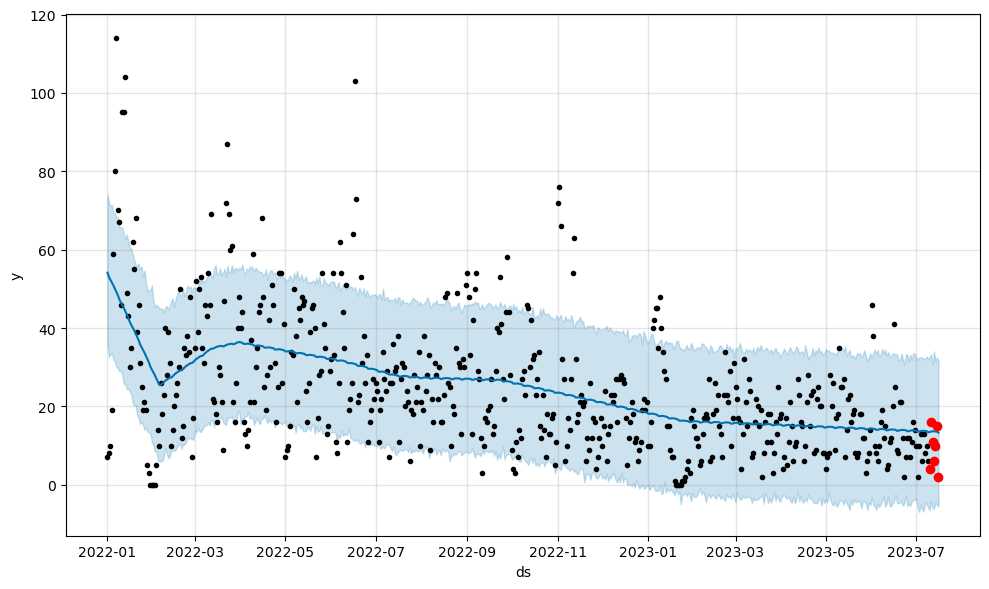

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  13.651497   -6.041321   30.854318
558 2023-07-13  13.646116   -6.055007   34.044714
559 2023-07-14  13.610017   -4.561025   31.488688
560 2023-07-15  13.572209   -5.059886   32.499666
561 2023-07-16  13.307878   -5.524250   31.621683
[ 4 16 11  6 10 15  2]
---
[13.46049891 13.58073528 13.65149666 13.64611608 13.61001713 13.57220899
 13.3078777 ]
SMAPE: 0.5891227065233535


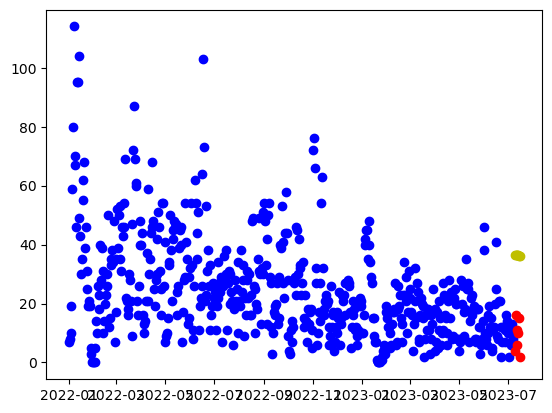

17:02:40 - cmdstanpy - INFO - Chain [1] start processing


[ 4 16 11  6 10 15  2]
---
[36.51733671 36.33535142 36.34761372 36.42823347 36.34530418 36.01522482
 36.16236567]
SMAPE_lr: 1.2340614150221654


17:02:40 - cmdstanpy - INFO - Chain [1] done processing


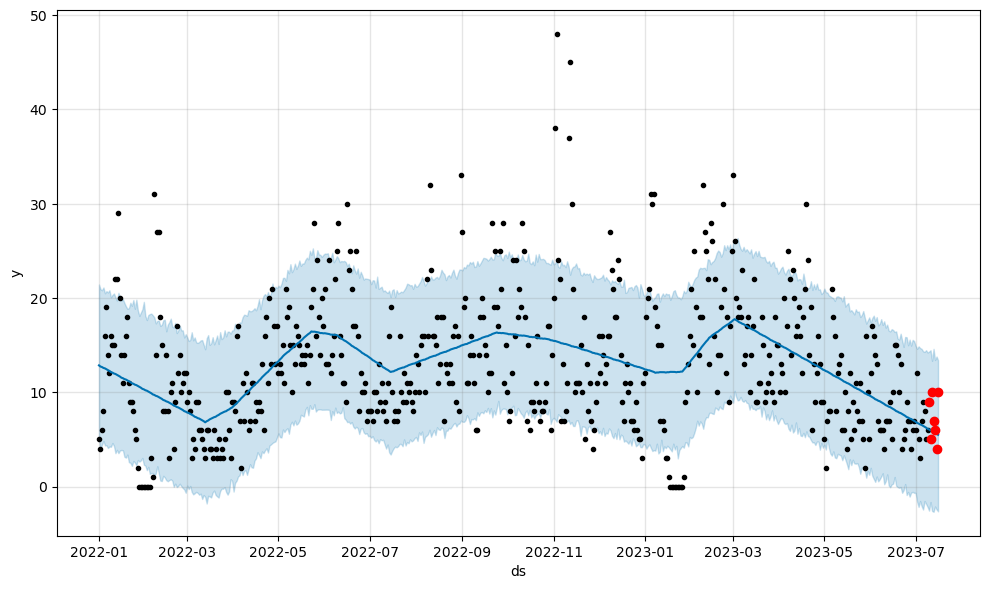

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  5.903894   -2.584873   13.336650
558 2023-07-13  5.809836   -2.682511   14.602835
559 2023-07-14  5.714424   -2.120445   13.421186
560 2023-07-15  5.615704   -2.424478   13.789303
561 2023-07-16  5.487843   -2.629916   13.397995
[ 9  5 10  7  6  4 10]
---
[6.05702765 5.95771936 5.90389406 5.80983552 5.71442371 5.61570399
 5.48784297]
SMAPE: 0.31916042281924667


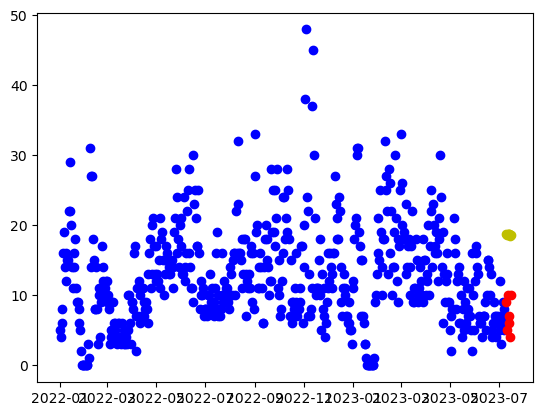

17:02:40 - cmdstanpy - INFO - Chain [1] start processing


[ 9  5 10  7  6  4 10]
---
[18.84117562 18.69083076 18.73473348 18.84699365 18.79570477 18.49726583
 18.6760471 ]
SMAPE_lr: 0.9019145016983005


17:02:41 - cmdstanpy - INFO - Chain [1] done processing


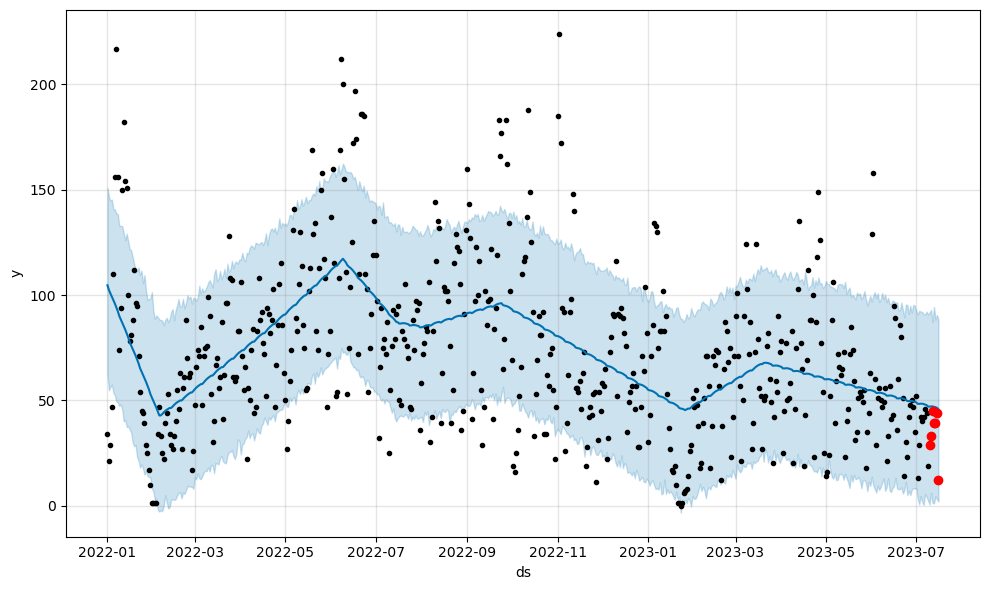

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  47.075987    1.244190   87.165735
558 2023-07-13  46.930724    1.079597   94.405109
559 2023-07-14  46.692113    4.380053   88.301783
560 2023-07-15  46.420814    3.016110   90.506094
561 2023-07-16  45.737718    1.909035   88.445507
[29 33 45 39 39 44 12]
---
[47.00780959 47.09892557 47.0759874  46.93072374 46.69211339 46.42081367
 45.73771819]
SMAPE: 0.35104069195997284


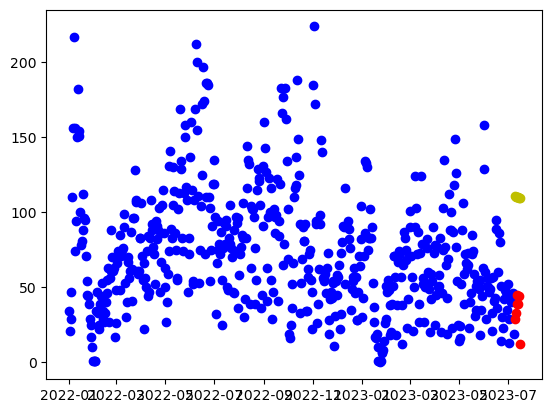

17:02:42 - cmdstanpy - INFO - Chain [1] start processing


[29 33 45 39 39 44 12]
---
[110.73032395 110.47441255 110.41274874 110.41944238 110.26258697
 109.8585815  109.93179625]
SMAPE_lr: 1.0664070726987764


17:02:42 - cmdstanpy - INFO - Chain [1] done processing


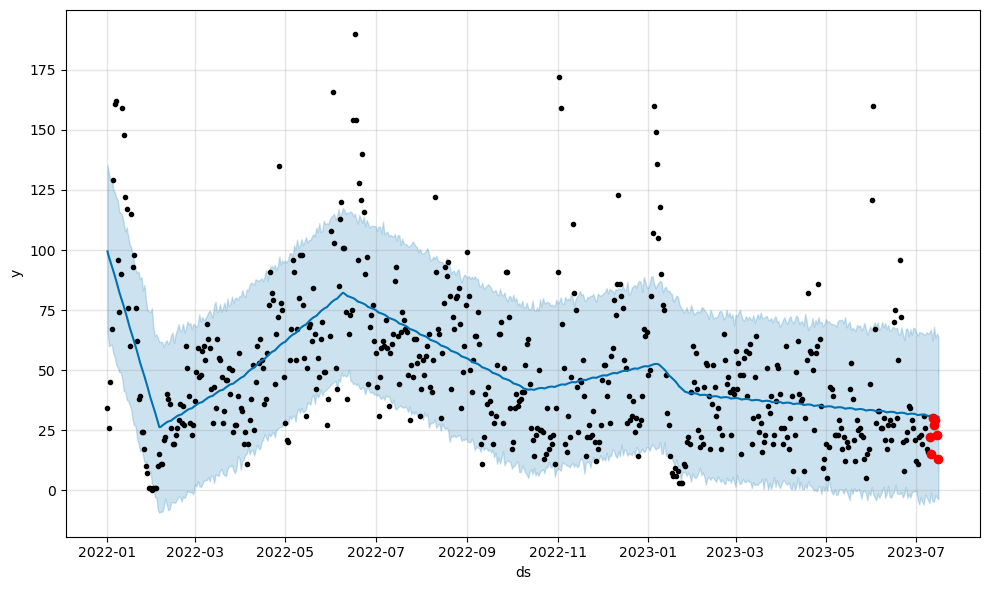

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  31.076924   -4.724161   62.351254
558 2023-07-13  31.039408   -4.776776   68.123585
559 2023-07-14  30.940509   -2.114242   63.443518
560 2023-07-15  30.737589   -3.135127   65.174398
561 2023-07-16  30.448250   -3.788121   63.809044
[22 15 30 27 29 23 13]
---
[30.94359196 30.99173327 31.07692368 31.03940811 30.94050911 30.73758892
 30.44824975]
SMAPE: 0.33766138587407113


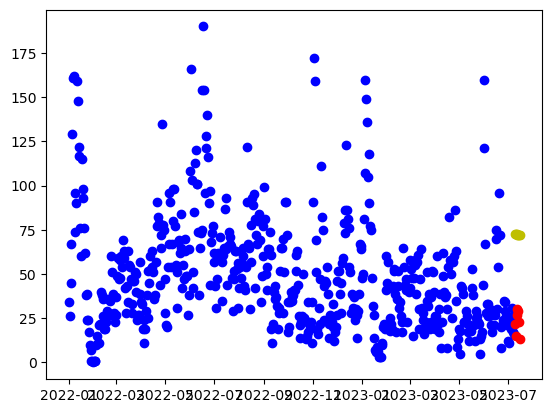

17:02:43 - cmdstanpy - INFO - Chain [1] start processing


[22 15 30 27 29 23 13]
---
[72.5856842  72.36943772 72.34743882 72.39379738 72.27660689 71.91226633
 72.02514599]
SMAPE_lr: 1.0567922683496638


17:02:43 - cmdstanpy - INFO - Chain [1] done processing


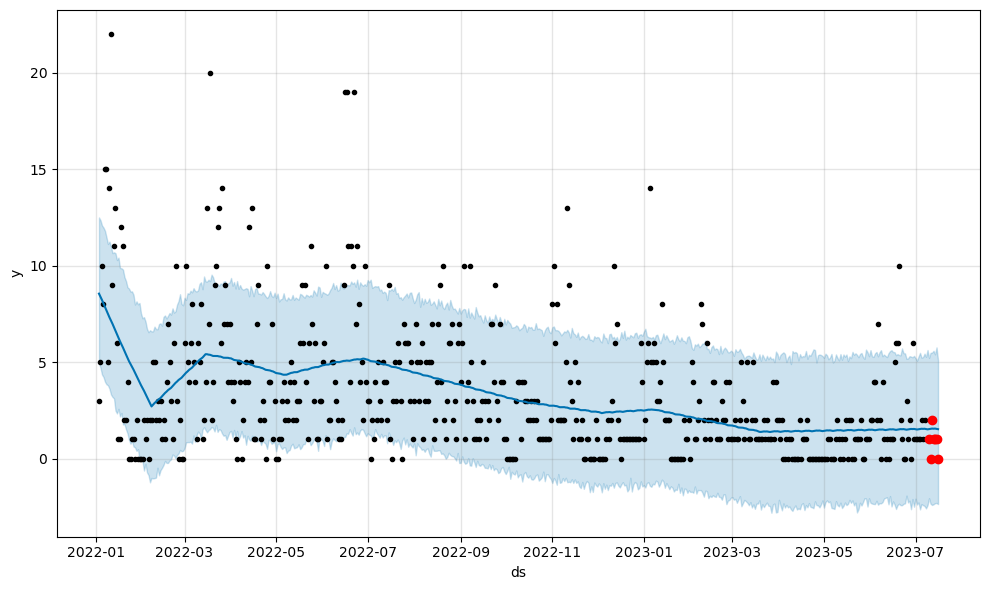

            ds      yhat  yhat_lower  yhat_upper
555 2023-07-12  1.563697   -2.392239    5.496932
556 2023-07-13  1.558017   -2.355000    5.593252
557 2023-07-14  1.564307   -2.298900    5.408909
558 2023-07-15  1.551804   -2.287624    5.768612
559 2023-07-16  1.533595   -2.347421    5.103529
[1 0 2 1 1 1 0]
---
[1.53769278 1.55224937 1.56369727 1.55801748 1.56430662 1.55180424
 1.53359453]
SMAPE: 0.8539313521025579


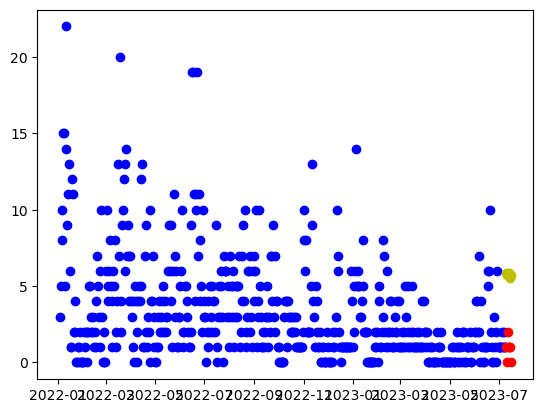

17:02:44 - cmdstanpy - INFO - Chain [1] start processing


[1 0 2 1 1 1 0]
---
[5.85409586 5.70898818 5.75812808 5.87562543 5.82957373 5.53637197
 5.72039042]
SMAPE_lr: 1.5151167338367302


17:02:44 - cmdstanpy - INFO - Chain [1] done processing


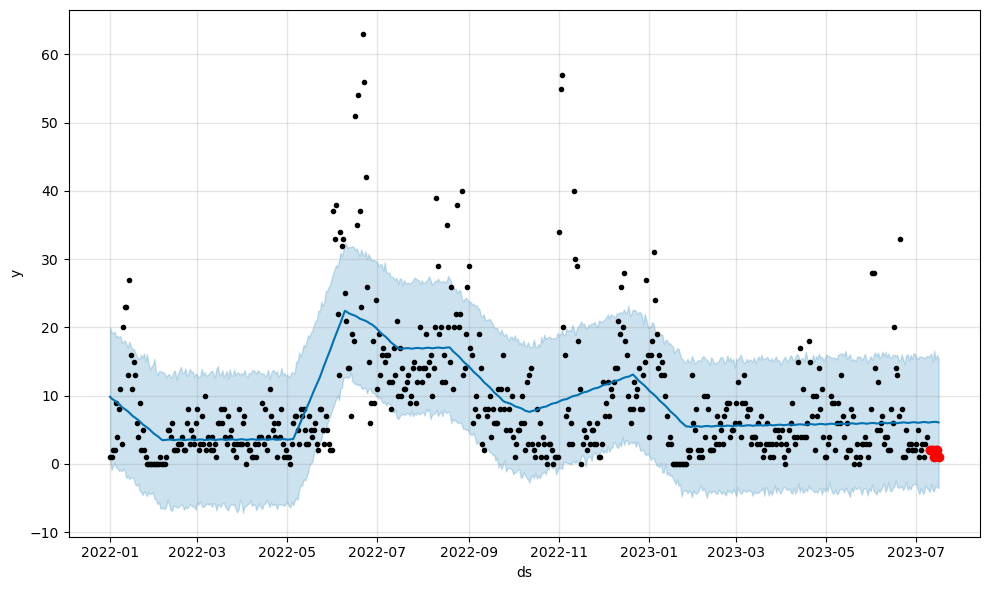

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  6.164305   -3.896479   14.993985
558 2023-07-13  6.176706   -3.953059   16.619429
559 2023-07-14  6.155838   -3.127792   15.289800
560 2023-07-15  6.143328   -3.387913   15.960226
561 2023-07-16  6.088954   -3.532115   15.463969
[2 2 2 1 2 2 1]
---
[6.09085966 6.13173929 6.16430478 6.1767056  6.15583818 6.14332766
 6.0889539 ]
SMAPE: 1.1375209369438009


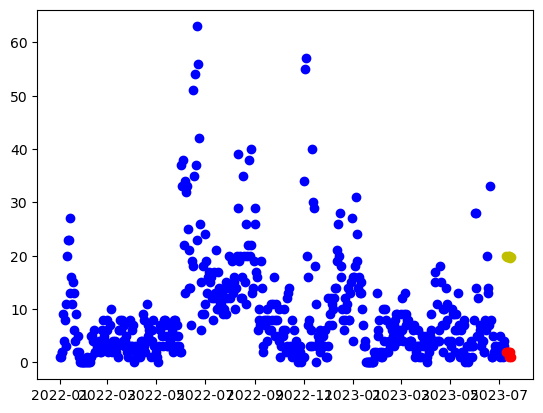

17:02:45 - cmdstanpy - INFO - Chain [1] start processing


[2 2 2 1 2 2 1]
---
[20.00448956 19.83885239 19.86746281 19.96443068 19.89784951 19.58411827
 19.74760724]
SMAPE_lr: 1.6835299468307152


17:02:45 - cmdstanpy - INFO - Chain [1] done processing


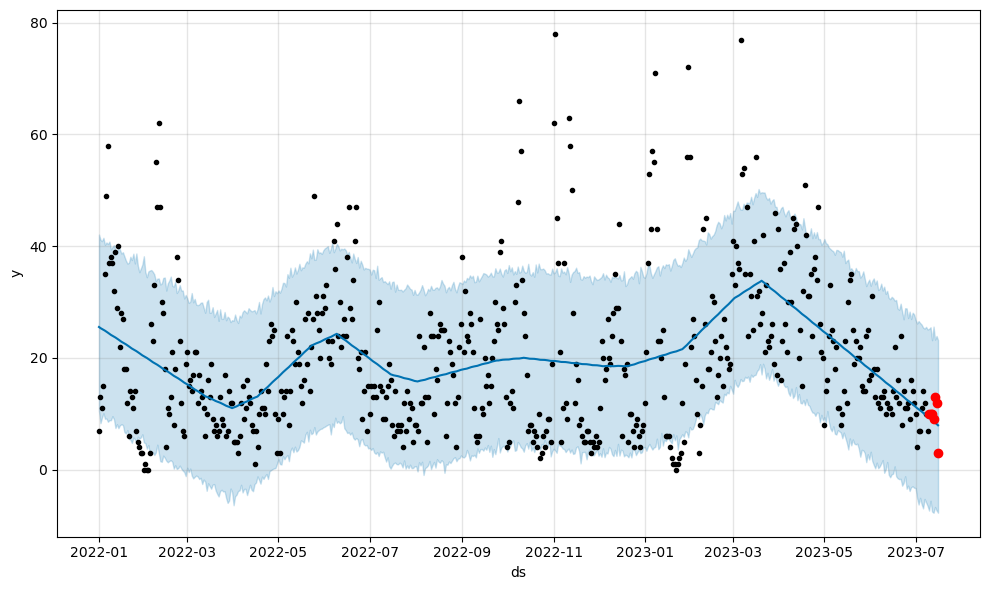

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  8.877932   -7.492940   23.178840
558 2023-07-13  8.658087   -7.719688   25.615682
559 2023-07-14  8.421336   -6.684955   23.284086
560 2023-07-15  8.185183   -7.303897   23.932208
561 2023-07-16  7.942343   -7.713026   23.197335
[10 10 10  9 13 12  3]
---
[9.28281217 9.09222938 8.87793161 8.65808746 8.42133599 8.18518308
 7.94234316]
SMAPE: 0.29084178265200133


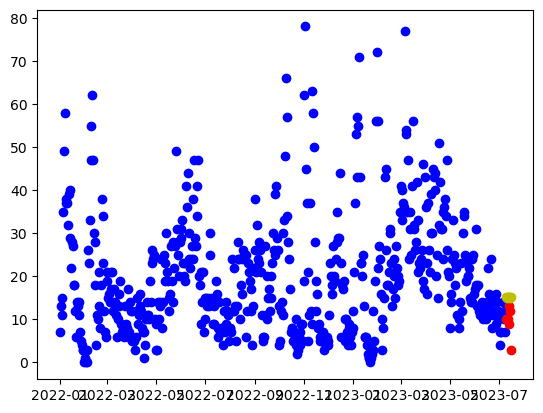

17:02:46 - cmdstanpy - INFO - Chain [1] start processing
17:02:46 - cmdstanpy - INFO - Chain [1] done processing


[10 10 10  9 13 12  3]
---
[15.1706521  15.05019661 15.12398871 15.26613826 15.24473876 14.97618919
 15.18485984]
SMAPE_lr: 0.49401625204330607


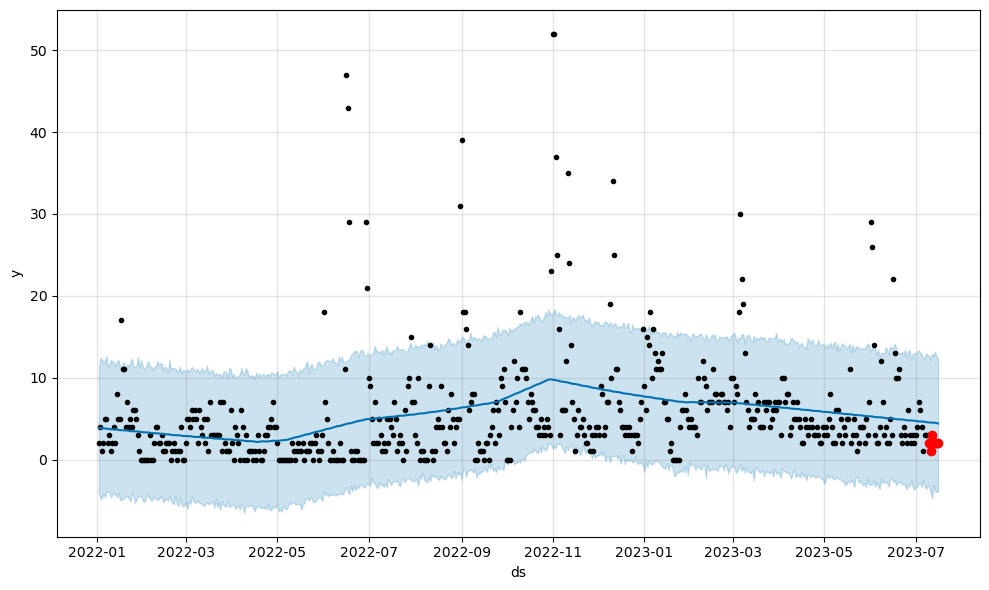

            ds      yhat  yhat_lower  yhat_upper
556 2023-07-12  4.520085   -4.727292   12.922700
557 2023-07-13  4.522325   -3.117407   12.625491
558 2023-07-14  4.490059   -3.875178   13.199060
559 2023-07-15  4.446515   -3.979414   12.484743
560 2023-07-16  4.409442   -3.869212   12.328153
[2 1 3 2 2 2 2]
---
[4.53125117 4.51715549 4.52008531 4.52232478 4.49005914 4.44651501
 4.40944228]
SMAPE: 0.7865759902523386


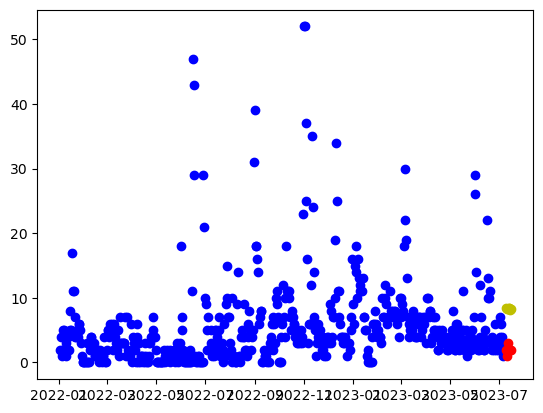

17:02:46 - cmdstanpy - INFO - Chain [1] start processing


[2 1 3 2 2 2 2]
---
[8.41426299 8.27385017 8.32768494 8.44987716 8.40852033 8.12001343
 8.30872675]
SMAPE_lr: 1.2343480425840012


17:02:47 - cmdstanpy - INFO - Chain [1] done processing


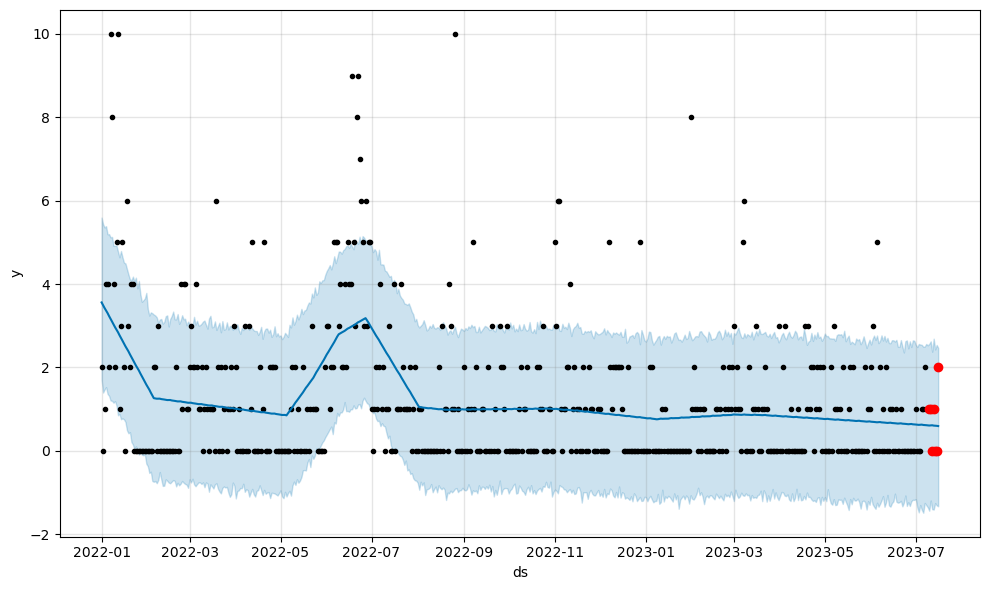

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  0.612611   -1.401004    2.377349
558 2023-07-13  0.604894   -1.409571    2.690677
559 2023-07-14  0.603343   -1.254730    2.431460
560 2023-07-15  0.599297   -1.308115    2.540216
561 2023-07-16  0.594291   -1.331318    2.470654
[1 1 0 1 0 0 2]
---
[0.6068252  0.61085079 0.61261128 0.60489393 0.60334283 0.59929673
 0.59429149]
SMAPE: 1.2212301281501556


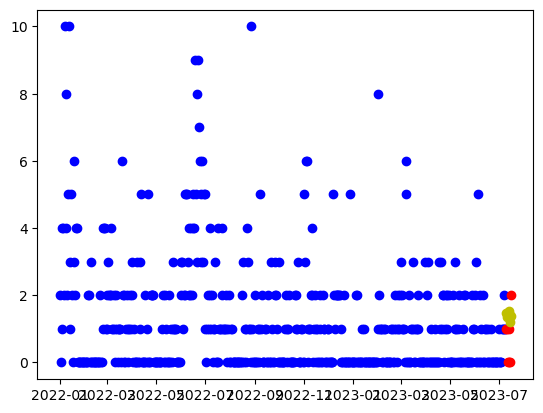

17:02:47 - cmdstanpy - INFO - Chain [1] start processing


[1 1 0 1 0 0 2]
---
[1.47852082 1.34098032 1.39768741 1.52275195 1.48426744 1.19863287
 1.39021851]
SMAPE_lr: 1.06451544987285


17:02:48 - cmdstanpy - INFO - Chain [1] done processing


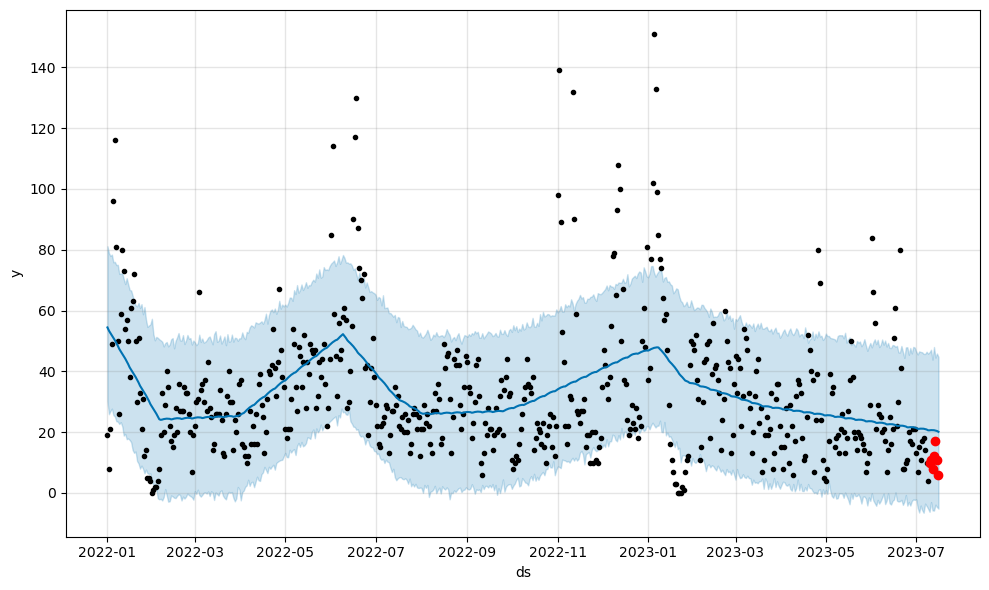

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  20.672068   -5.753413   43.863955
558 2023-07-13  20.642221   -5.794406   48.014777
559 2023-07-14  20.530614   -3.853611   44.521720
560 2023-07-15  20.393381   -4.636280   45.875476
561 2023-07-16  20.121607   -5.148928   44.745862
[10 11  8 12 17 11  6]
---
[20.61001751 20.67372902 20.67206847 20.64222065 20.53061361 20.3933814
 20.12160678]
SMAPE: 0.6550448984652137


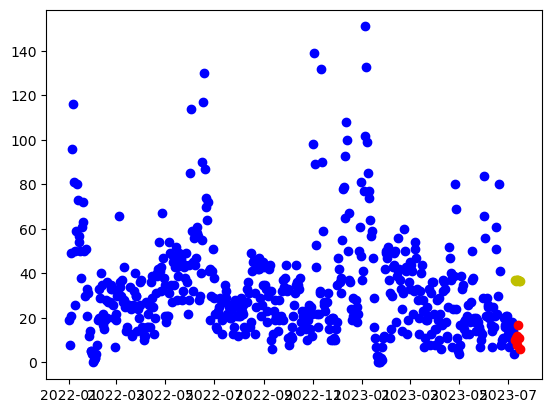

17:02:48 - cmdstanpy - INFO - Chain [1] start processing


[10 11  8 12 17 11  6]
---
[36.95480772 36.80252958 36.84449903 36.95482593 36.90160378 36.60123157
 36.77807957]
SMAPE_lr: 1.1123788741714757


17:02:49 - cmdstanpy - INFO - Chain [1] done processing


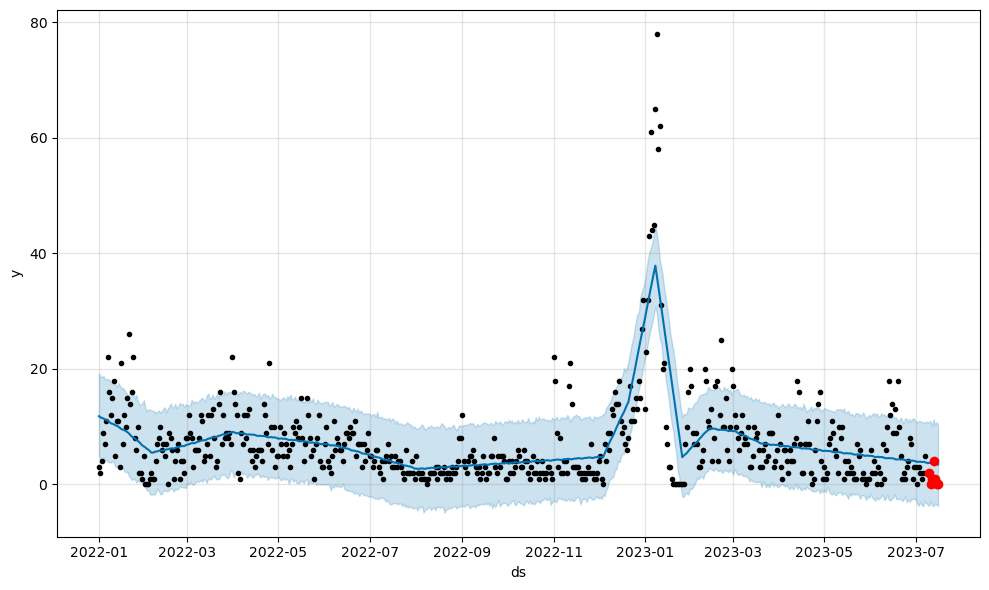

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  3.686657   -3.637103   10.084387
558 2023-07-13  3.708224   -3.729201   11.294464
559 2023-07-14  3.676096   -3.285369   10.349923
560 2023-07-15  3.589706   -3.496142   10.808121
561 2023-07-16  3.487868   -3.722513   10.350990
[2 0 1 4 1 0 0]
---
[3.73080705 3.74559963 3.68665671 3.70822378 3.67609603 3.58970601
 3.48786827]
SMAPE: 1.28154856145115


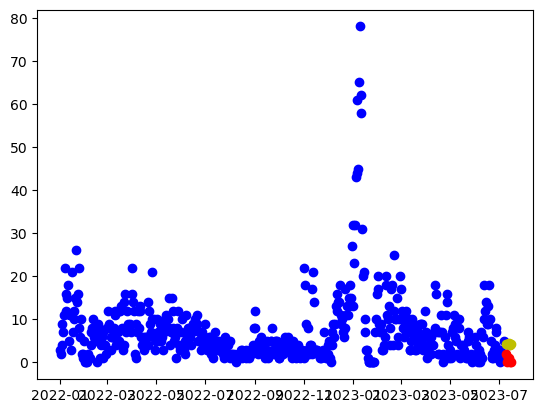

17:02:50 - cmdstanpy - INFO - Chain [1] start processing


[2 0 1 4 1 0 0]
---
[4.3528014  4.22439472 4.29023562 4.42443397 4.39508328 4.11858252
 4.31930198]
SMAPE_lr: 1.3348499787472967


17:02:50 - cmdstanpy - INFO - Chain [1] done processing


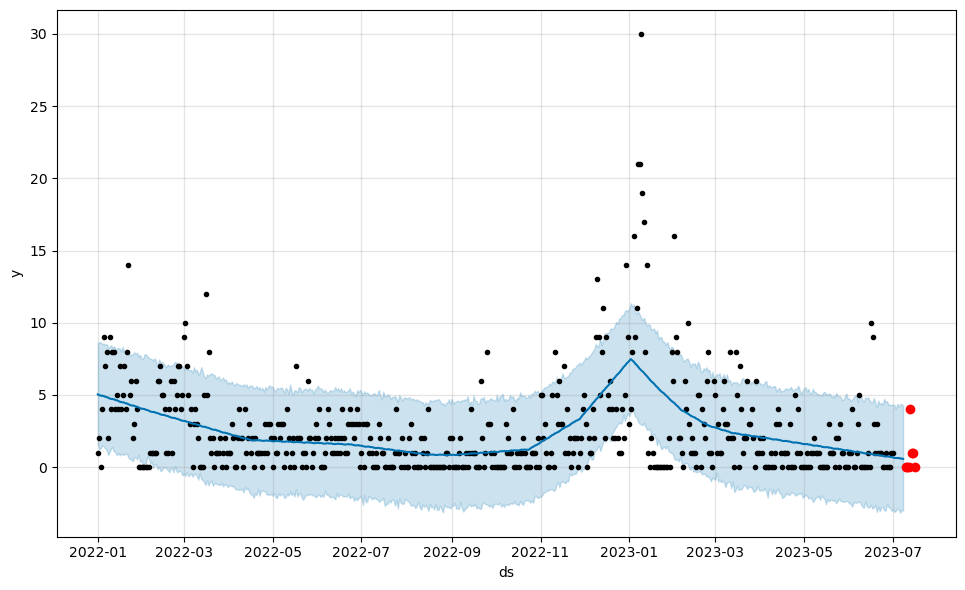

            ds      yhat  yhat_lower  yhat_upper
549 2023-07-04  0.629968   -2.890279    4.383917
550 2023-07-05  0.637725   -2.886172    4.203246
551 2023-07-06  0.600947   -3.159607    4.348243
552 2023-07-07  0.600845   -2.971692    4.389736
553 2023-07-08  0.568154   -3.003844    4.237642
[0 0 0 4 1 1 0]
---
[0.64440835 0.62931704 0.62996828 0.63772534 0.60094707 0.60084499
 0.56815357]
SMAPE: 1.4924526578840844


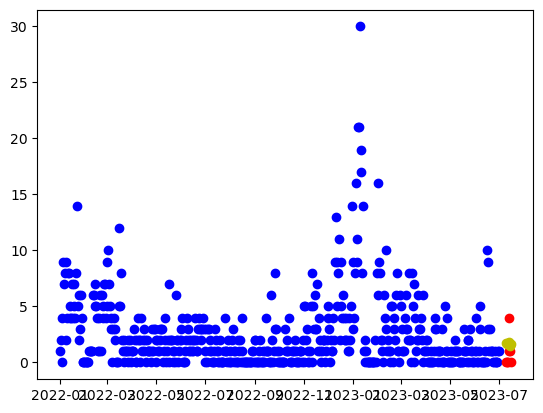

17:02:51 - cmdstanpy - INFO - Chain [1] start processing


[0 0 0 4 1 1 0]
---
[1.75054873 1.61626674 1.67623234 1.80455539 1.7693294  1.48695334
 1.68179749]
SMAPE_lr: 1.3862384377999304


17:02:51 - cmdstanpy - INFO - Chain [1] done processing


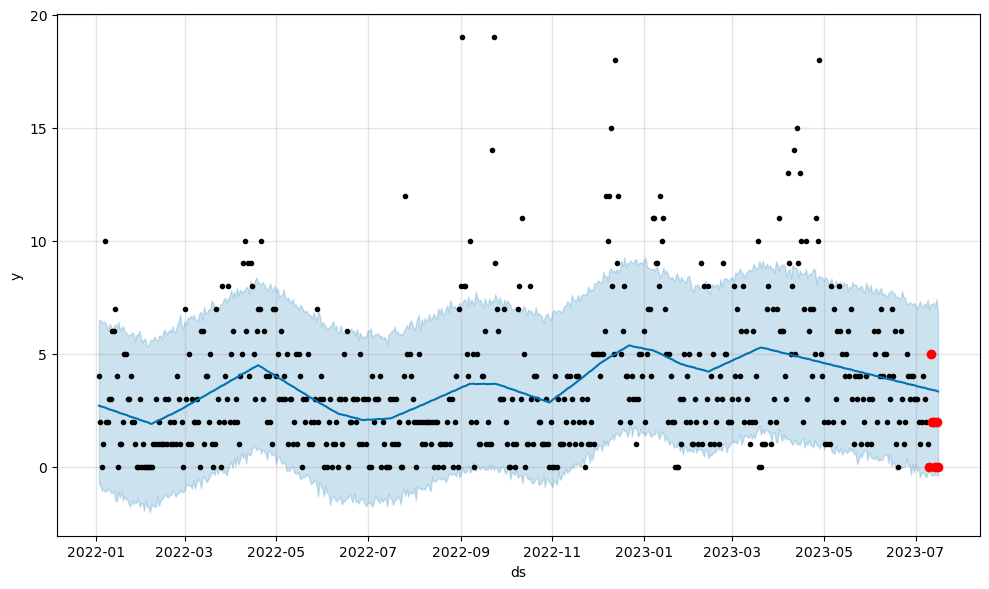

            ds      yhat  yhat_lower  yhat_upper
555 2023-07-12  3.407016   -0.392124    7.185345
556 2023-07-13  3.391425   -0.367874    7.267720
557 2023-07-14  3.381214   -0.329845    7.074401
558 2023-07-15  3.361149   -0.335101    7.411883
559 2023-07-16  3.331972   -0.396194    6.761235
[0 5 2 2 0 2 0]
---
[3.43254159 3.41828176 3.40701577 3.39142505 3.38121363 3.36114899
 3.33197173]
SMAPE: 1.1314524766935794


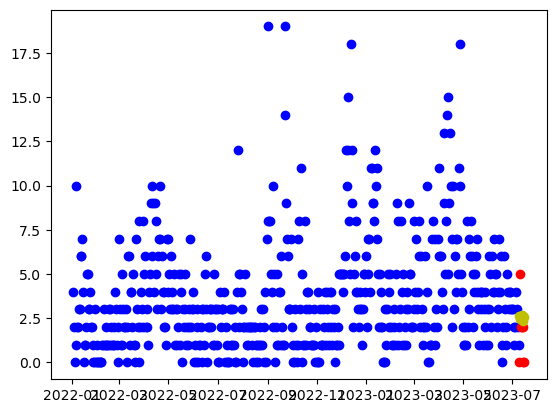

17:02:52 - cmdstanpy - INFO - Chain [1] start processing


[0 5 2 2 0 2 0]
---
[2.60305916 2.47111413 2.53341668 2.66407668 2.63118764 2.35114853
 2.54832964]
SMAPE_lr: 1.0512101130710818


17:02:52 - cmdstanpy - INFO - Chain [1] done processing


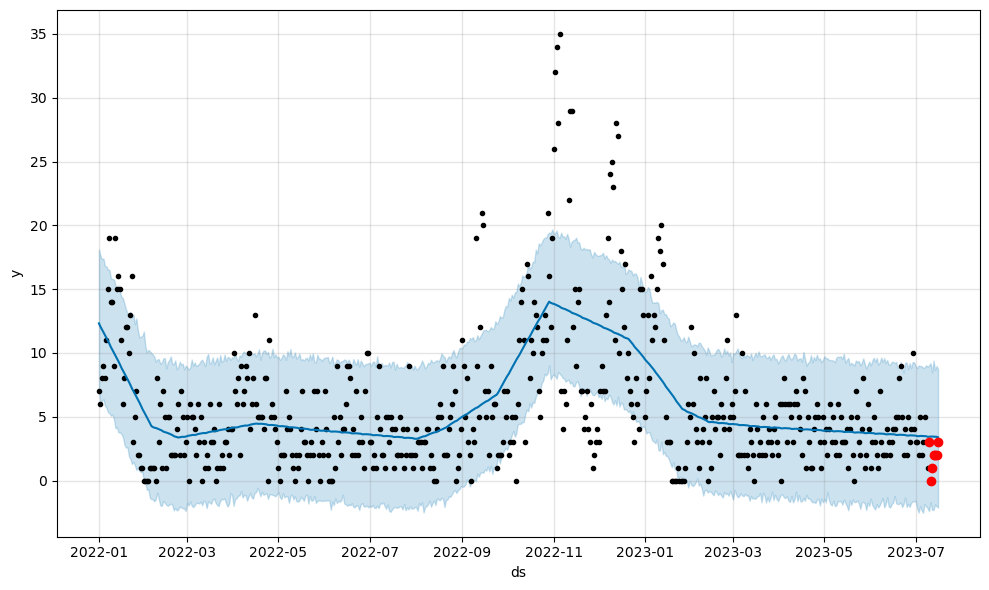

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  3.447016   -2.301799    8.492368
558 2023-07-13  3.440582   -2.310657    9.400189
559 2023-07-14  3.440871   -1.863872    8.660092
560 2023-07-15  3.425096   -2.019023    8.972995
561 2023-07-16  3.384988   -2.112570    8.741949
[3 0 1 2 2 2 3]
---
[3.43063889 3.44355689 3.4470156  3.44058192 3.44087132 3.42509601
 3.38498812]
SMAPE: 0.7056619314084231


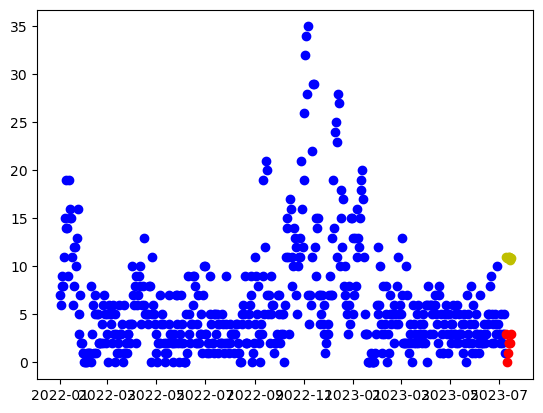

17:02:53 - cmdstanpy - INFO - Chain [1] start processing


[3 0 1 2 2 2 3]
---
[10.98617344 10.83804426 10.88416266 10.99863851 10.94956531 10.65334205
 10.83433901]
SMAPE_lr: 1.438935157578111


17:02:53 - cmdstanpy - INFO - Chain [1] done processing


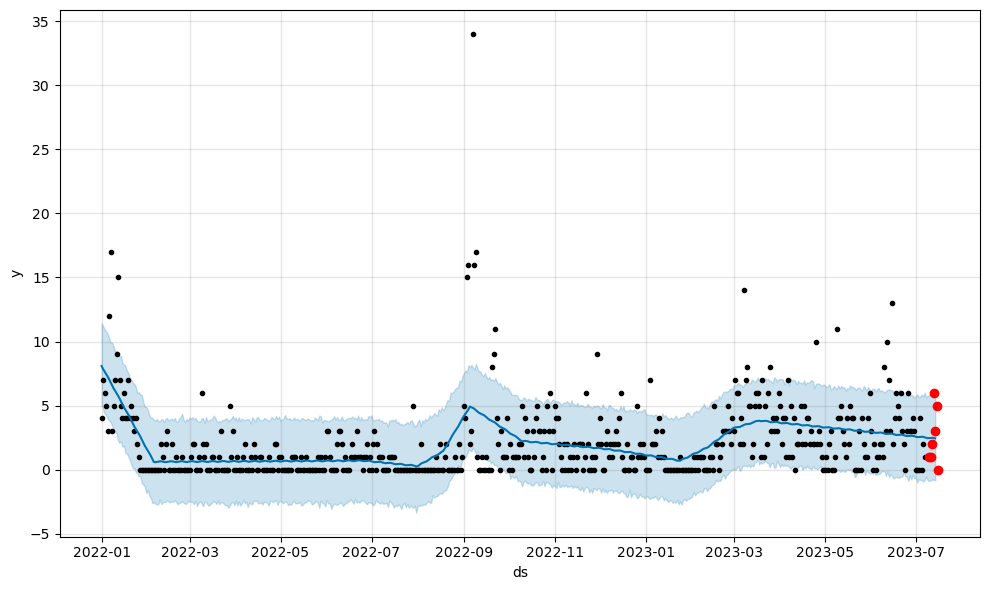

            ds      yhat  yhat_lower  yhat_upper
555 2023-07-10  2.469809   -0.872798    5.802792
556 2023-07-11  2.470346   -0.846632    5.889602
557 2023-07-12  2.489236   -0.779252    5.752236
558 2023-07-13  2.479097   -0.774411    6.052377
559 2023-07-14  2.444001   -0.844732    5.468418
[1 1 2 6 3 5 0]
---
[2.49673852 2.45631432 2.46980867 2.47034594 2.48923646 2.47909714
 2.44400108]
SMAPE: 0.8003741851274044


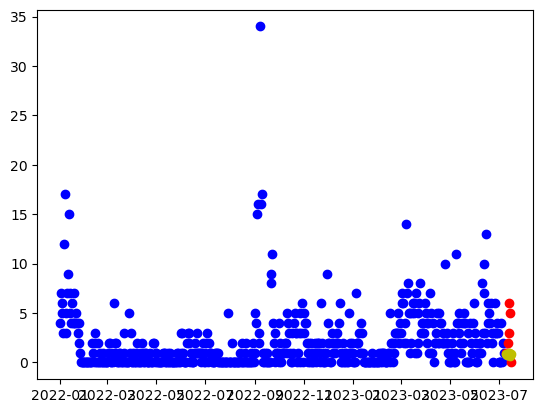

17:02:54 - cmdstanpy - INFO - Chain [1] start processing


[1 1 2 6 3 5 0]
---
[0.90023382 0.76823657 0.83048692 0.96109471 0.92815345 0.64806213
 0.84519103]
SMAPE_lr: 1.0338793246166393


17:02:54 - cmdstanpy - INFO - Chain [1] done processing


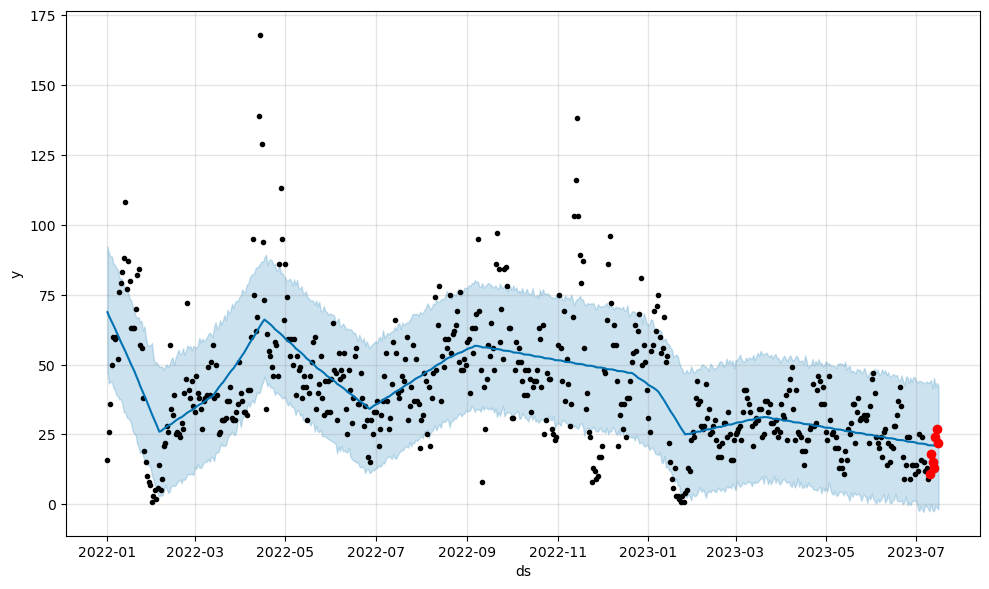

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  21.098971   -2.188734   41.537041
558 2023-07-13  21.052290   -2.402665   45.224072
559 2023-07-14  20.905679   -0.583150   42.048069
560 2023-07-15  20.807135   -1.258613   43.468021
561 2023-07-16  20.539645   -1.730253   42.240003
[11 18 15 13 24 27 22]
---
[21.13976298 21.13606853 21.09897128 21.05229021 20.90567896 20.80713509
 20.53964501]
SMAPE: 0.29537622128104835


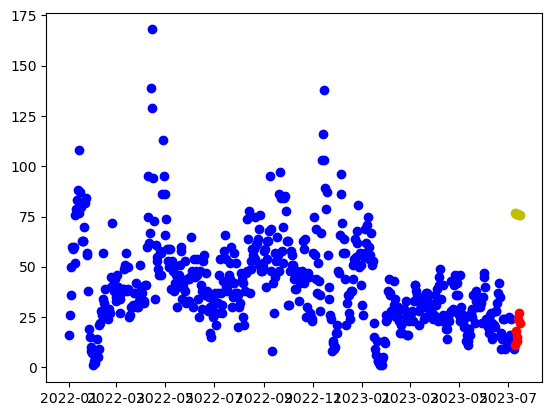

17:02:55 - cmdstanpy - INFO - Chain [1] start processing


[11 18 15 13 24 27 22]
---
[76.65133307 76.41159978 76.36611408 76.38898583 76.24830853 75.86048117
 75.94987402]
SMAPE_lr: 1.2272800518739848


17:02:55 - cmdstanpy - INFO - Chain [1] done processing


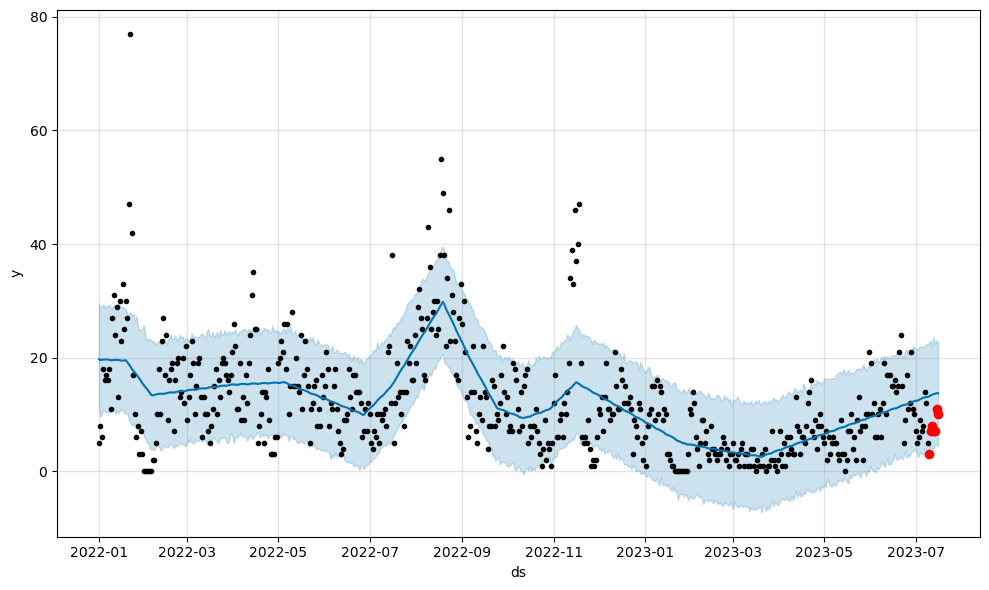

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  13.464399    3.824339   21.924838
558 2023-07-13  13.570441    3.860482   23.576468
559 2023-07-14  13.639443    4.716893   22.391438
560 2023-07-15  13.731777    4.603040   23.037575
561 2023-07-16  13.725530    4.506797   22.708499
[ 3  7  8  7  7 11 10]
---
[13.19771436 13.35399004 13.46439884 13.57044117 13.63944255 13.73177706
 13.72553012]
SMAPE: 0.6014035515795187


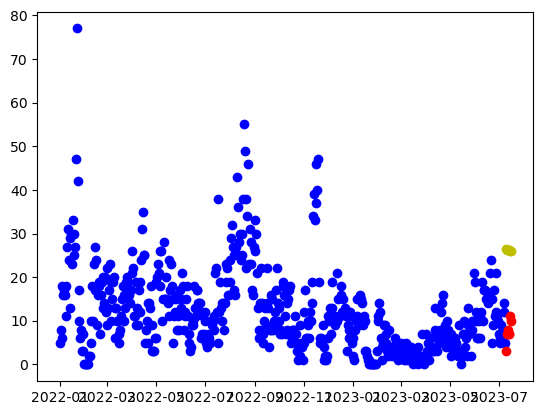

17:02:56 - cmdstanpy - INFO - Chain [1] start processing


[ 3  7  8  7  7 11 10]
---
[26.40767258 26.22983624 26.2462475  26.3310162  26.25223586 25.92630545
 26.07759526]
SMAPE_lr: 1.1189324529393108


17:02:56 - cmdstanpy - INFO - Chain [1] done processing


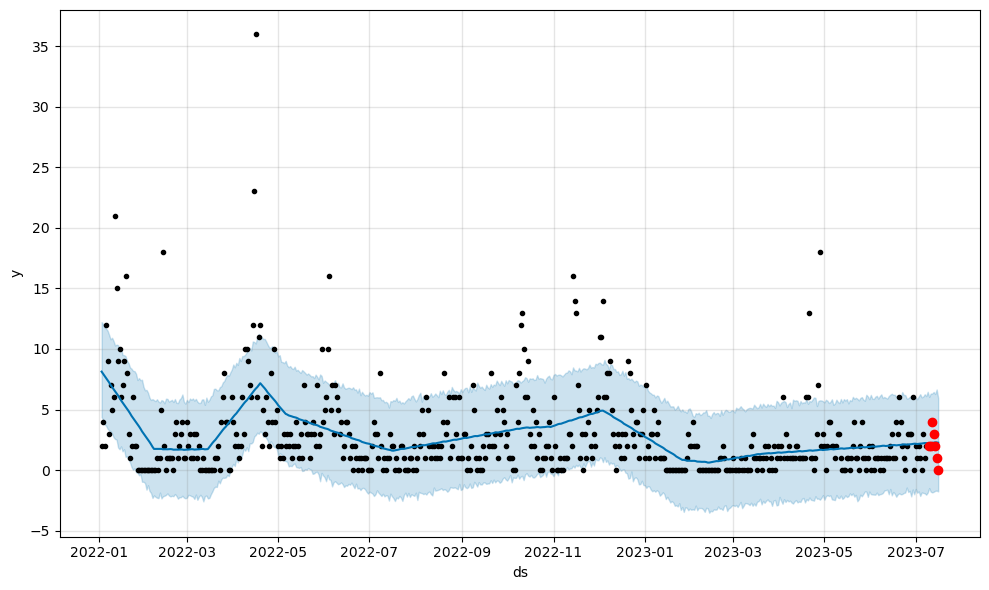

            ds      yhat  yhat_lower  yhat_upper
555 2023-07-12  2.248508   -1.841134    6.324454
556 2023-07-13  2.270327   -1.786047    6.451810
557 2023-07-14  2.290320   -1.709923    6.278028
558 2023-07-15  2.288243   -1.690513    6.658052
559 2023-07-16  2.265916   -1.755916    5.964656
[2 2 4 3 2 1 0]
---
[2.2265173  2.24062542 2.24850764 2.27032723 2.29032029 2.28824281
 2.26591632]
SMAPE: 0.5681523582841205


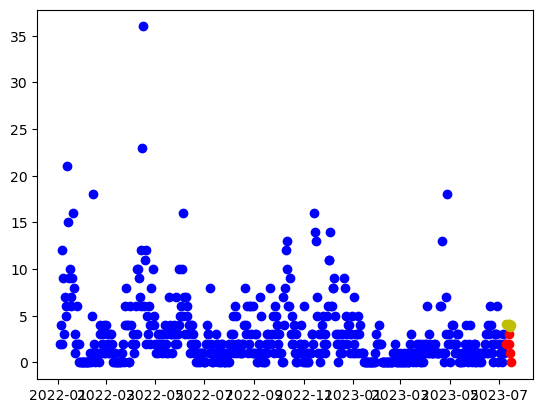

17:02:57 - cmdstanpy - INFO - Chain [1] start processing


[2 2 4 3 2 1 0]
---
[4.12414669 3.9833923  4.0368855  4.15873615 4.11703775 3.82818929
 4.01656105]
SMAPE_lr: 0.793325199941563


17:02:57 - cmdstanpy - INFO - Chain [1] done processing


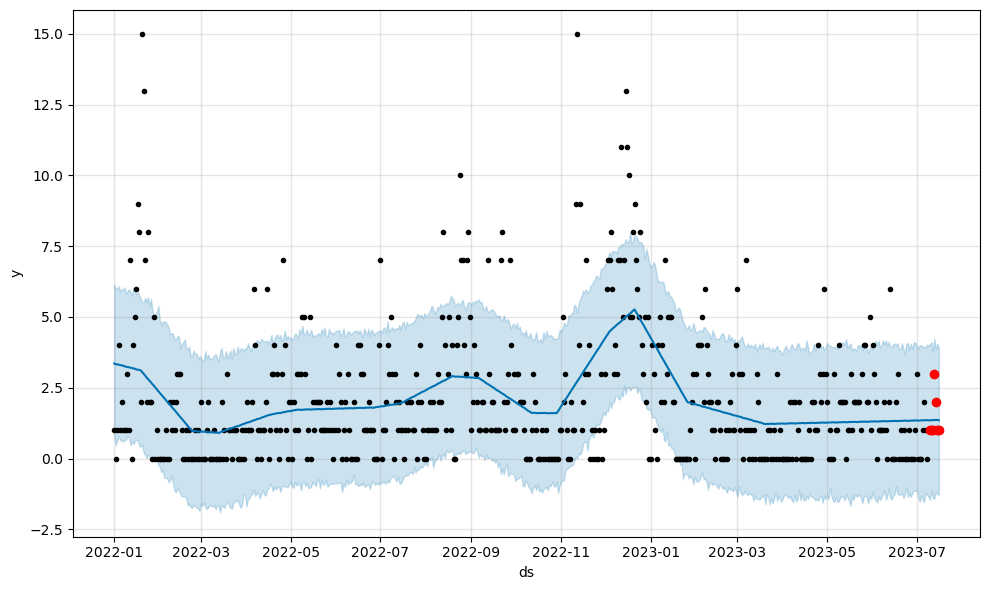

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  1.356788   -1.407616    3.782921
558 2023-07-13  1.358056   -1.414645    4.227405
559 2023-07-14  1.363435   -1.187430    3.873176
560 2023-07-15  1.361409   -1.256107    4.059436
561 2023-07-16  1.353142   -1.290441    3.929117
[1 1 1 3 2 1 1]
---
[1.35213903 1.35697076 1.35678795 1.35805604 1.36343538 1.36140902
 1.35314214]
SMAPE: 0.37762634905970877


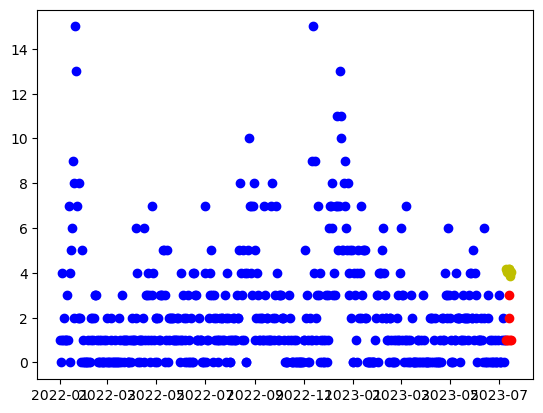

17:02:58 - cmdstanpy - INFO - Chain [1] start processing


[1 1 1 3 2 1 1]
---
[4.16124711 4.02008634 4.07317316 4.19461743 4.15251265 3.86325781
 4.05122318]
SMAPE_lr: 1.0081652359476259


17:02:58 - cmdstanpy - INFO - Chain [1] done processing


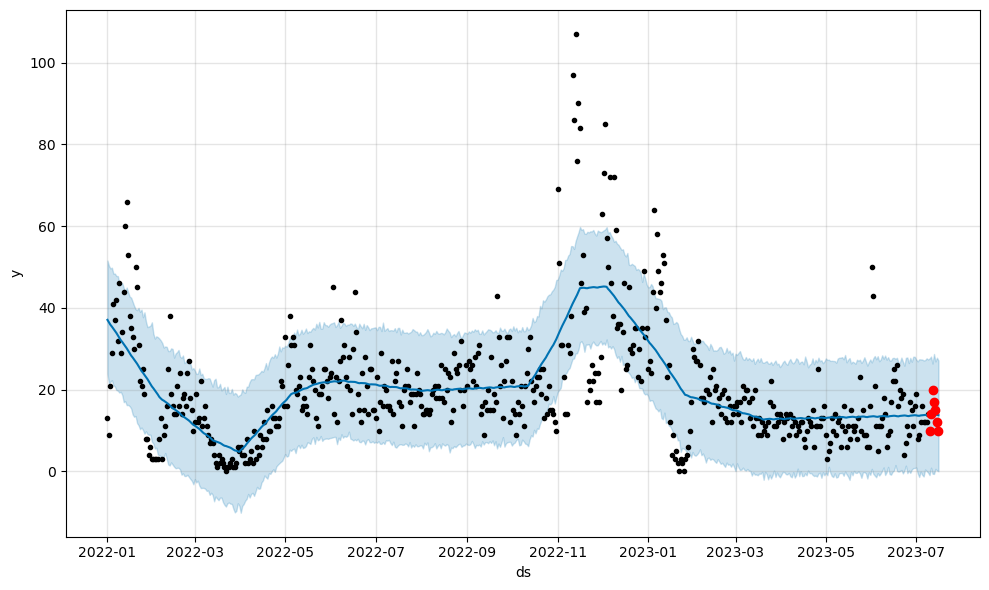

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  13.798430   -0.550299   26.391354
558 2023-07-13  13.838344   -0.611596   28.731796
559 2023-07-14  13.876359    0.636009   26.903251
560 2023-07-15  13.839472    0.244569   27.818623
561 2023-07-16  13.759251    0.037645   27.129935
[10 14 20 17 15 12 10]
---
[13.66622985 13.76325439 13.79842967 13.83834374 13.87635948 13.83947187
 13.75925128]
SMAPE: 0.20507856120693127


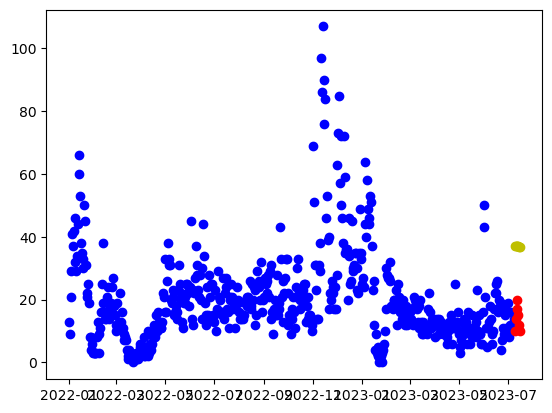

17:02:59 - cmdstanpy - INFO - Chain [1] start processing


[10 14 20 17 15 12 10]
---
[37.23928261 37.05996941 37.0749038  37.15819564 37.07793843 36.75053116
 36.9003441 ]
SMAPE_lr: 0.9156647849369184


17:02:59 - cmdstanpy - INFO - Chain [1] done processing


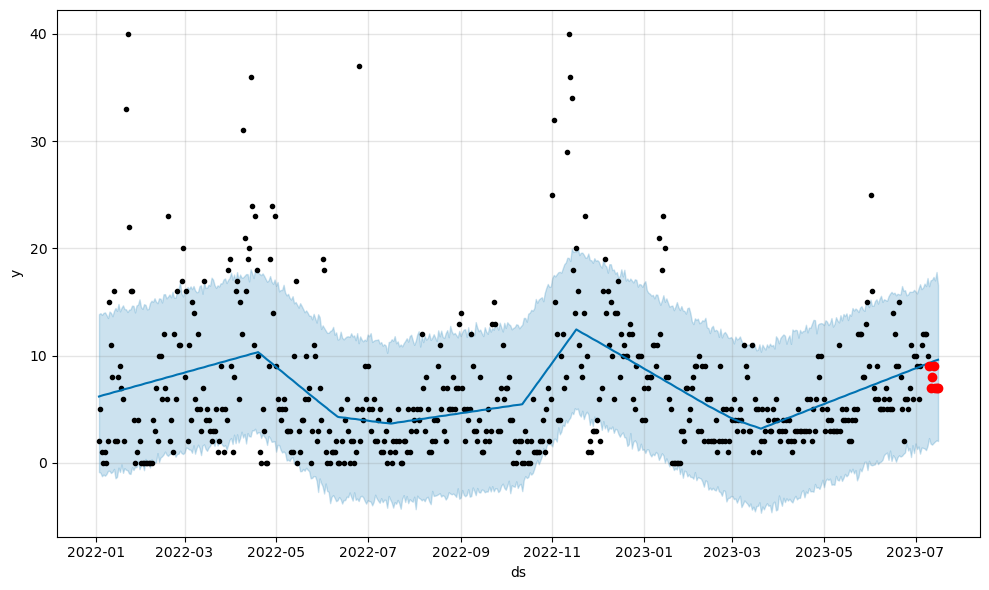

            ds      yhat  yhat_lower  yhat_upper
555 2023-07-12  9.414320    1.705311   17.077485
556 2023-07-13  9.481455    1.858312   17.343374
557 2023-07-14  9.530427    2.003698   17.020908
558 2023-07-15  9.588841    2.108404   17.804495
559 2023-07-16  9.621506    2.044262   16.576967
[9 7 8 9 7 7 7]
---
[9.29760086 9.36082822 9.41431965 9.48145454 9.53042713 9.58884055
 9.62150564]
SMAPE: 0.2099092726253855


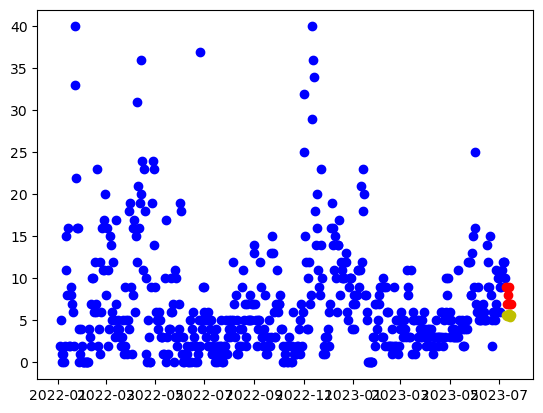

17:03:00 - cmdstanpy - INFO - Chain [1] start processing


[9 7 8 9 7 7 7]
---
[5.69911151 5.56552526 5.6261866  5.75520539 5.72067513 5.4389948
 5.6345347 ]
SMAPE_lr: 0.30485112358910055


17:03:00 - cmdstanpy - INFO - Chain [1] done processing


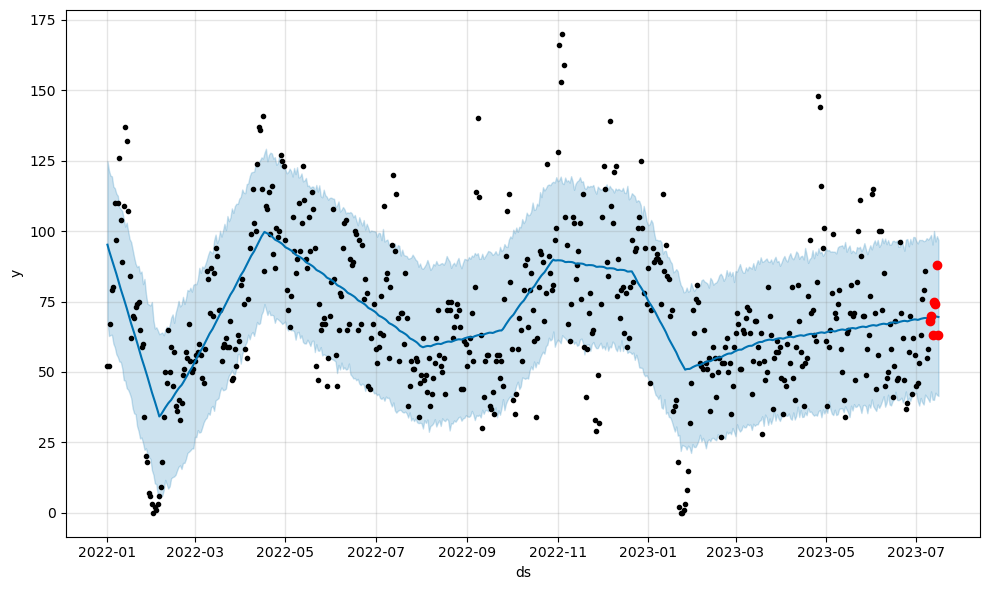

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  69.497082   40.173499   95.232440
558 2023-07-13  69.610514   40.081667  100.047315
559 2023-07-14  69.685320   42.626860   96.307549
560 2023-07-15  69.628014   41.845762   98.210547
561 2023-07-16  69.506942   41.464969   96.831757
[68 70 63 75 74 88 63]
---
[69.13522678 69.35499055 69.49708193 69.6105144  69.6853205  69.62801443
 69.50694172]
SMAPE: 0.08425691853940918


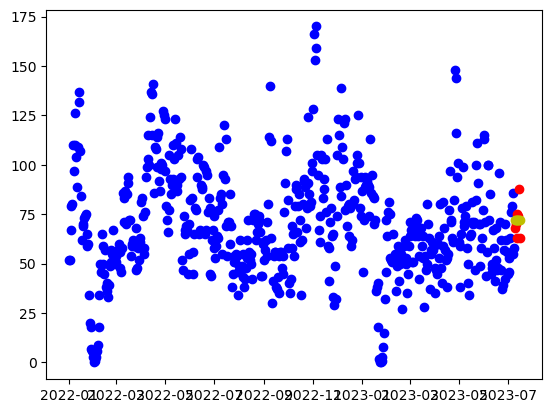

17:03:01 - cmdstanpy - INFO - Chain [1] start processing


[68 70 63 75 74 88 63]
---
[72.21401856 72.06384512 72.10791927 72.22035087 72.16923342 71.8709659
 72.0499186 ]
SMAPE_lr: 0.08894265489654893


17:03:01 - cmdstanpy - INFO - Chain [1] done processing


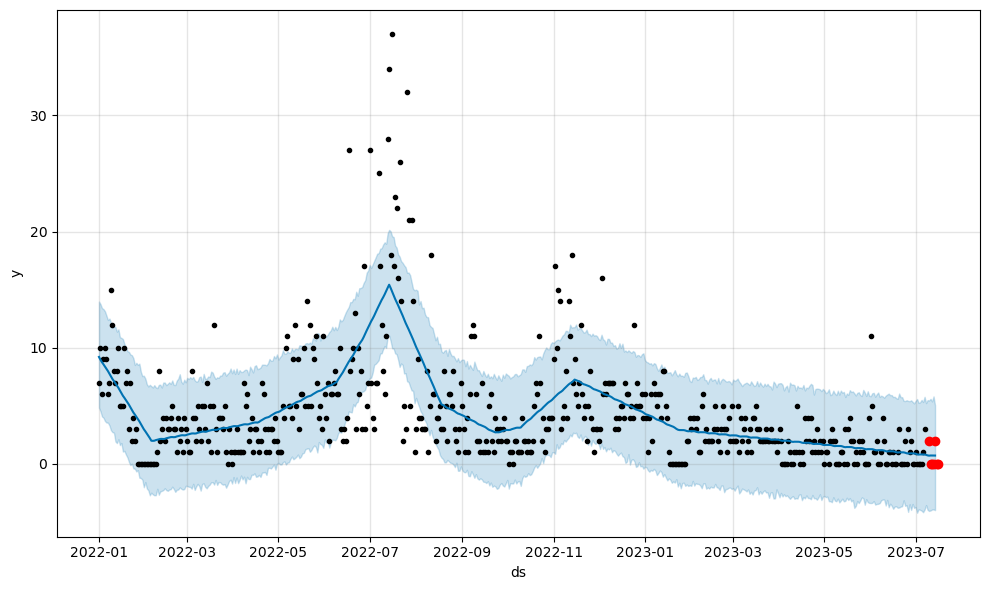

            ds      yhat  yhat_lower  yhat_upper
555 2023-07-10  0.717251   -4.041910    5.467004
556 2023-07-11  0.731735   -3.995208    5.604360
557 2023-07-12  0.728999   -3.919415    5.384955
558 2023-07-13  0.725557   -3.910936    5.817751
559 2023-07-14  0.726760   -3.969714    5.050738
[2 0 0 0 2 0 0]
---
[0.78826657 0.74114604 0.71725128 0.73173533 0.72899936 0.72555741
 0.72675976]
SMAPE: 1.6858062221613186


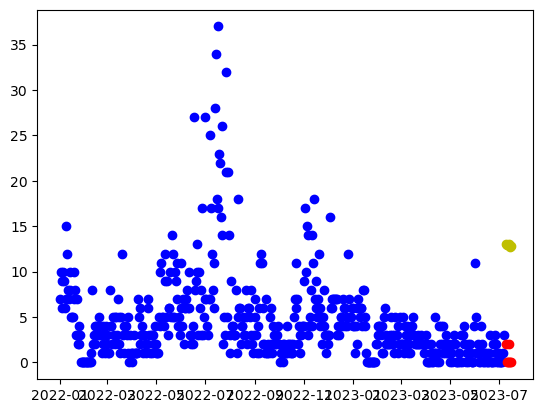

17:03:02 - cmdstanpy - INFO - Chain [1] start processing


[2 0 0 0 2 0 0]
---
[13.06048699 12.90031707 12.93439474 13.03682986 12.97571593 12.66745194
 12.83640817]
SMAPE_lr: 1.8478015015146558


17:03:02 - cmdstanpy - INFO - Chain [1] done processing


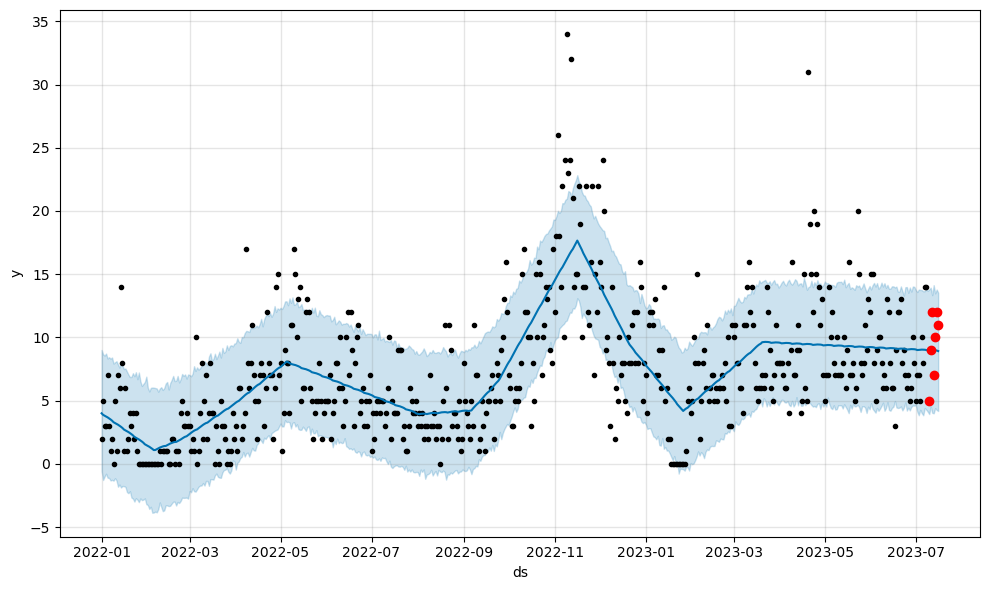

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  8.990443    4.032749   13.341480
558 2023-07-13  8.985602    3.992053   14.131506
559 2023-07-14  8.979591    4.404858   13.480571
560 2023-07-15  8.960487    4.262810   13.782475
561 2023-07-16  8.915853    4.174839   13.535618
[ 5  9 12  7 10 12 11]
---
[8.96448732 8.97748989 8.99044265 8.98560216 8.97959131 8.96048677
 8.91585283]
SMAPE: 0.24461772730152917


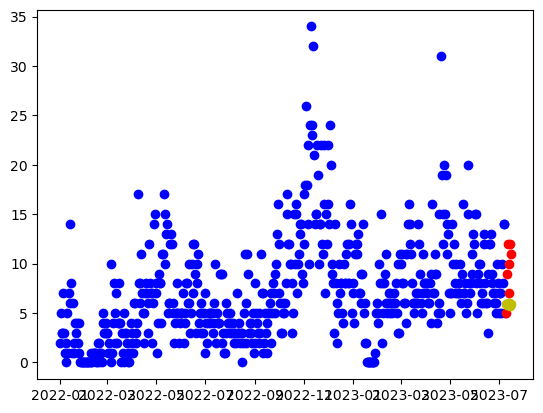

17:03:03 - cmdstanpy - INFO - Chain [1] start processing


[ 5  9 12  7 10 12 11]
---
[5.92893895 5.80016549 5.86563962 5.9994712  5.96975374 5.69288621
 5.89323889]
SMAPE_lr: 0.4664769702507762


17:03:03 - cmdstanpy - INFO - Chain [1] done processing


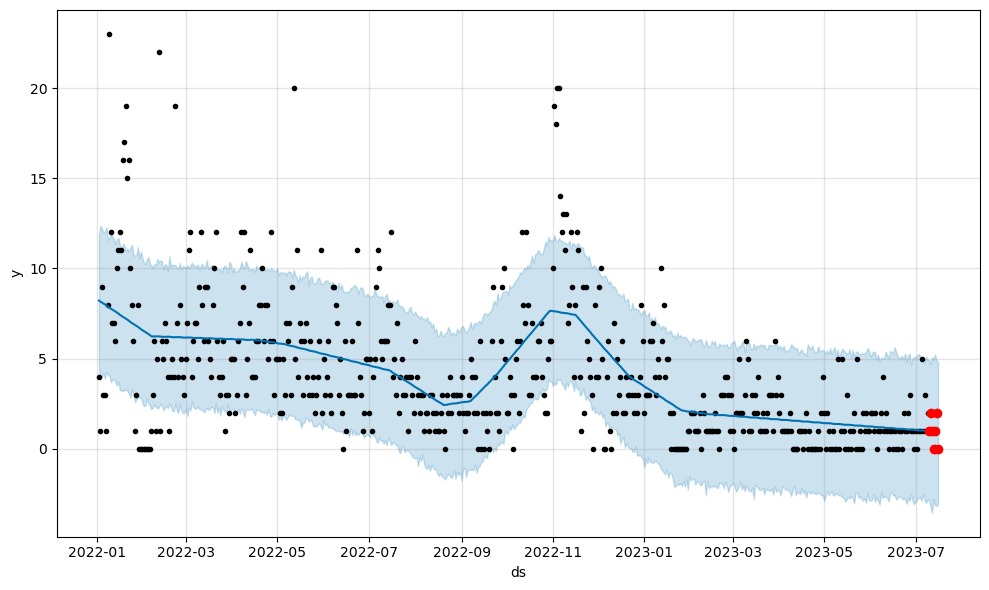

            ds      yhat  yhat_lower  yhat_upper
556 2023-07-12  0.976839   -3.540719    5.081711
557 2023-07-13  0.976884   -2.755302    4.935469
558 2023-07-14  0.970293   -3.129199    5.243437
559 2023-07-15  0.959927   -3.156753    4.888687
560 2023-07-16  0.940427   -3.084362    4.808901
[1 2 1 0 1 2 0]
---
[0.97940076 0.98114607 0.97683934 0.97688391 0.97029276 0.9599266
 0.94042663]
SMAPE: 0.7801003158183644


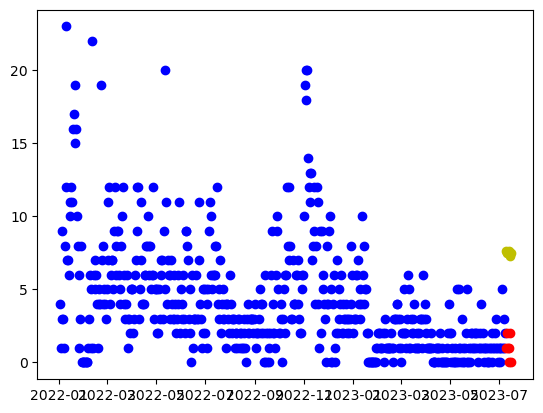

17:03:04 - cmdstanpy - INFO - Chain [1] start processing


[1 2 1 0 1 2 0]
---
[7.63157181 7.48350397 7.52968371 7.64422091 7.59520905 7.29904714
 7.48010543]
SMAPE_lr: 1.5569122322655689


17:03:04 - cmdstanpy - INFO - Chain [1] done processing


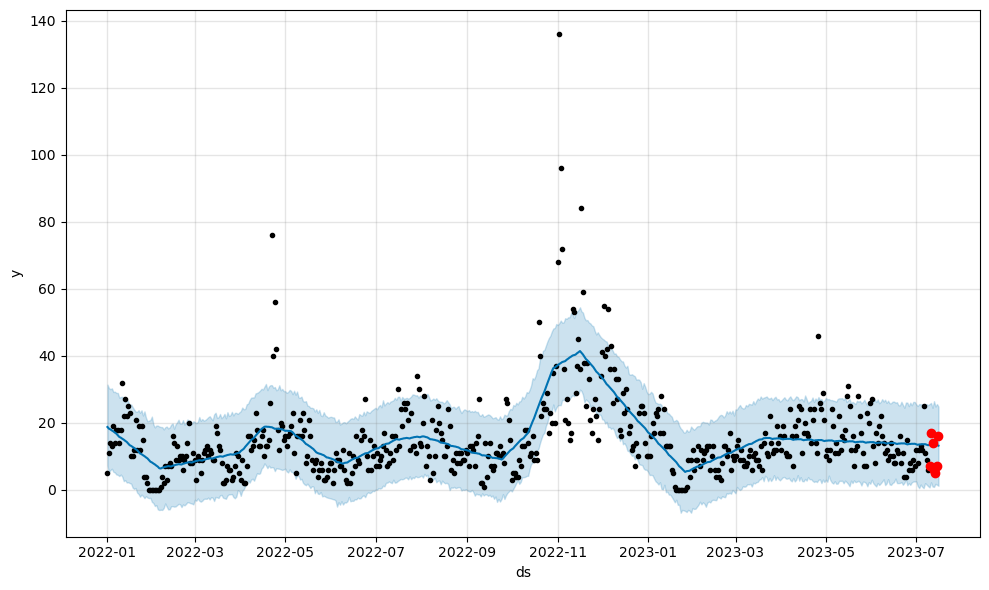

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  13.523404    1.015339   24.500901
558 2023-07-13  13.501746    0.902986   26.480827
559 2023-07-14  13.526887    1.824915   24.882681
560 2023-07-15  13.377684    1.543345   25.618991
561 2023-07-16  13.211355    1.241419   24.841962
[ 7 17 14  6  5  7 16]
---
[13.44752278 13.46436099 13.52340426 13.50174647 13.5268867  13.37768377
 13.21135458]
SMAPE: 0.48629927705695464


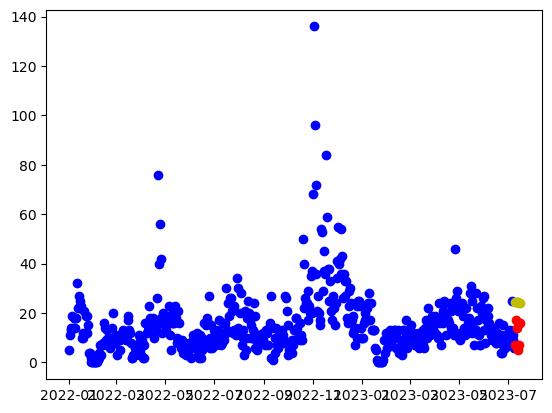

17:03:05 - cmdstanpy - INFO - Chain [1] start processing


[ 7 17 14  6  5  7 16]
---
[24.43872726 24.28293148 24.32138328 24.42819253 24.37145274 24.06756288
 24.24089324]
SMAPE_lr: 0.8627892460276498


17:03:05 - cmdstanpy - INFO - Chain [1] done processing


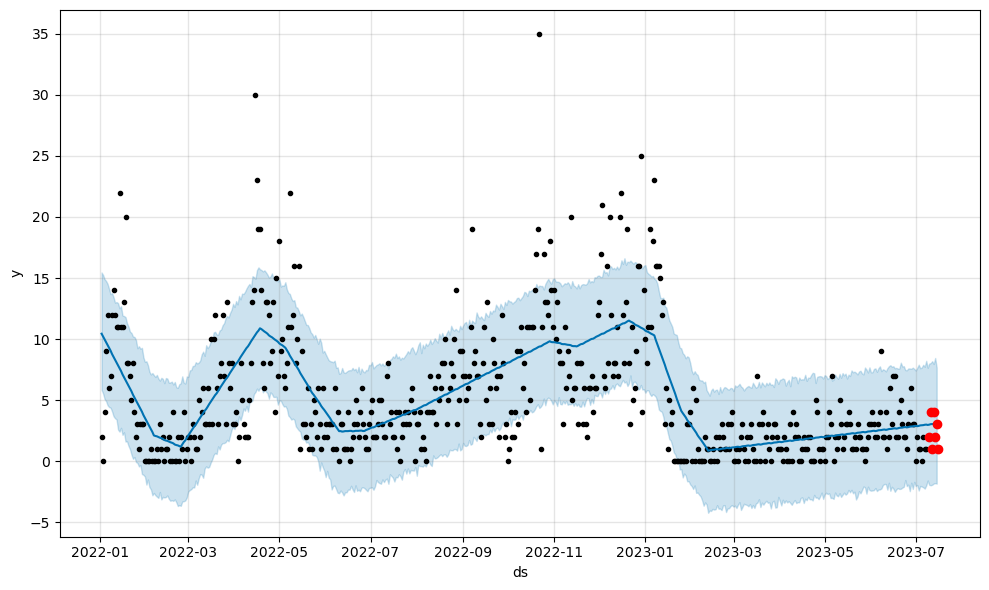

            ds      yhat  yhat_lower  yhat_upper
555 2023-07-11  3.022991   -1.985426    8.025973
556 2023-07-12  3.036004   -1.942954    8.183599
557 2023-07-13  3.044699   -1.843717    7.955054
558 2023-07-14  3.073641   -1.810044    8.446373
559 2023-07-15  3.087963   -1.848597    7.663342
[2 4 1 4 2 3 1]
---
[2.95930629 2.98254935 3.0229905  3.03600361 3.04469903 3.07364135
 3.08796284]
SMAPE: 0.48828210922925536


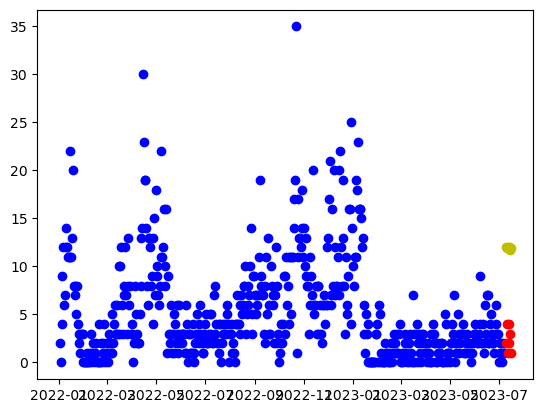

17:03:06 - cmdstanpy - INFO - Chain [1] start processing
17:03:06 - cmdstanpy - INFO - Chain [1] done processing


[2 4 1 4 2 3 1]
---
[12.0748822  11.92041693 11.96019925 12.06833902 12.01292974 11.7103704
 11.88503127]
SMAPE_lr: 1.3464483533389138


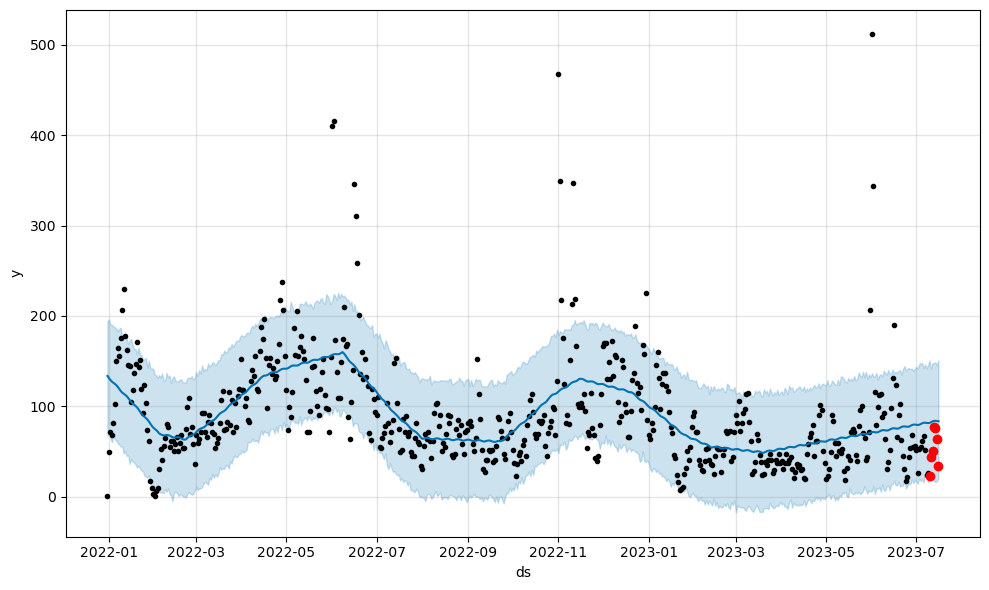

            ds       yhat  yhat_lower  yhat_upper
558 2023-07-12  83.185891   19.491074  147.602473
559 2023-07-13  83.772771   17.678811  147.754191
560 2023-07-14  83.843006   16.038128  148.507960
561 2023-07-15  83.674559   17.116008  145.478774
562 2023-07-16  83.385759   20.264299  150.833797
[23 44 51 77 76 64 34]
---
[81.55196348 82.38947691 83.18589051 83.77277074 83.84300635 83.67455945
 83.38575876]
SMAPE: 0.49964662886749583


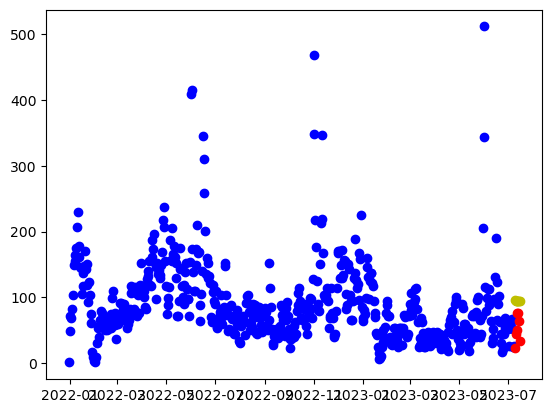

17:03:07 - cmdstanpy - INFO - Chain [1] start processing


[23 44 51 77 76 64 34]
---
[95.35041952 95.16202202 95.16787211 95.24207964 95.15273813 94.81624656
 94.9569752 ]
SMAPE_lr: 0.6187665404740608


17:03:07 - cmdstanpy - INFO - Chain [1] done processing


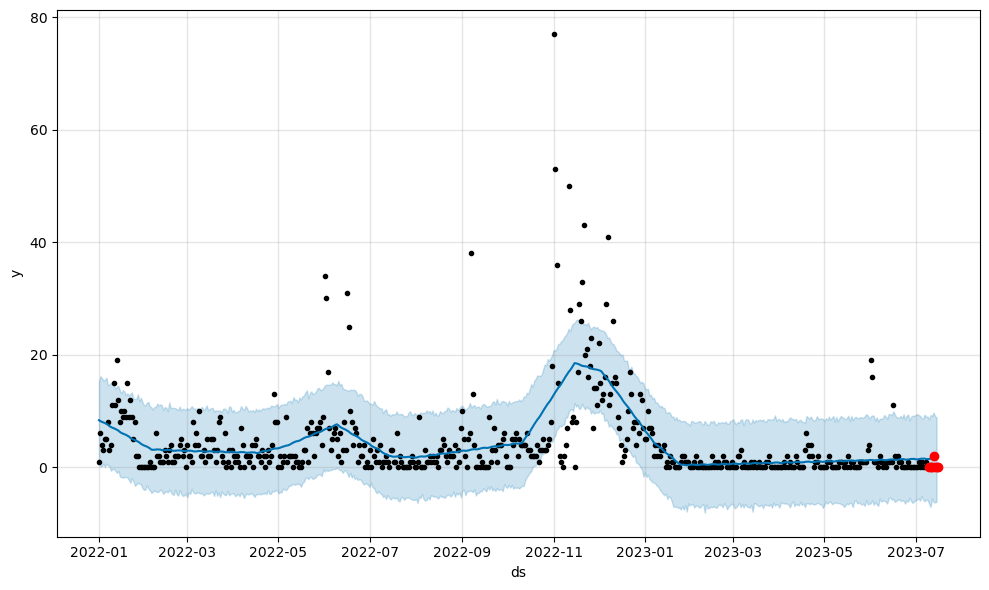

            ds      yhat  yhat_lower  yhat_upper
556 2023-07-11  1.529090   -7.054825    9.291728
557 2023-07-12  1.576550   -5.535622    9.105573
558 2023-07-13  1.583440   -6.206096    9.703522
559 2023-07-14  1.585813   -6.237671    9.076221
560 2023-07-15  1.512855   -6.155061    8.888297
[0 0 0 2 0 0 0]
---
[1.44622107 1.47653206 1.52908984 1.57655029 1.58344022 1.58581335
 1.5128549 ]
SMAPE: 1.7481131798411664


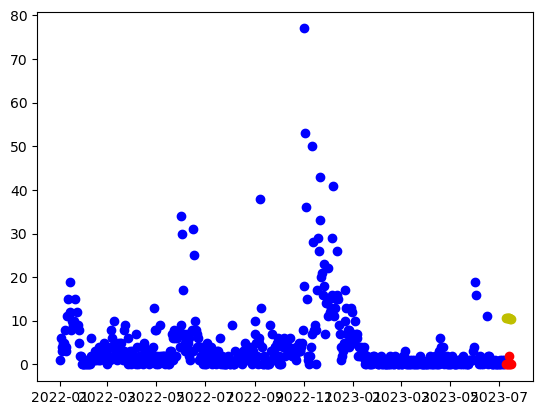

17:03:08 - cmdstanpy - INFO - Chain [1] start processing


[0 0 0 2 0 0 0]
---
[10.71861081 10.56541895 10.60647469 10.71588787 10.66175201 10.36046608
 10.53640036]
SMAPE_lr: 1.9101236850510617


17:03:08 - cmdstanpy - INFO - Chain [1] done processing


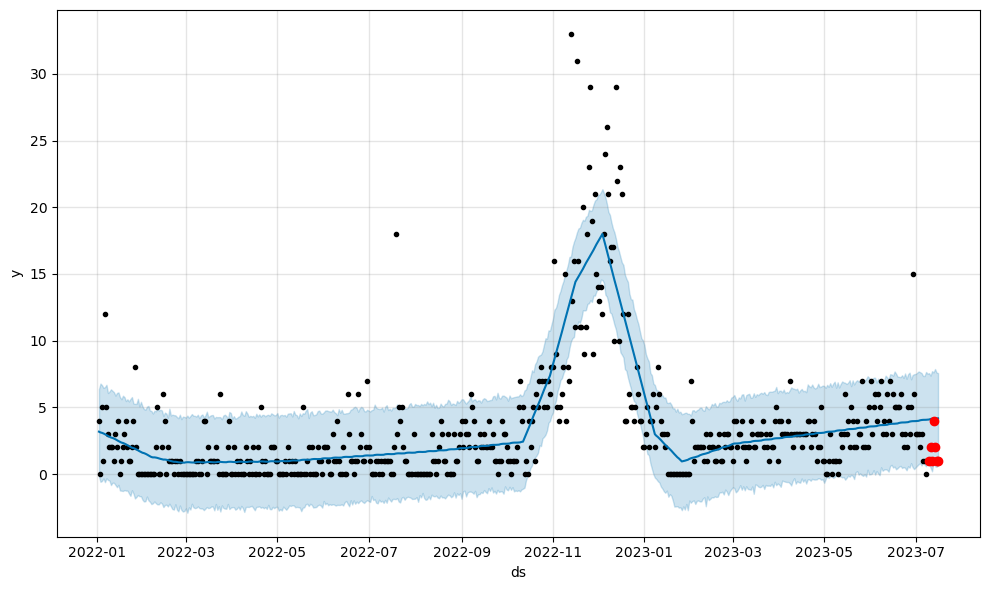

            ds      yhat  yhat_lower  yhat_upper
556 2023-07-12  4.148892    0.204556    7.715849
557 2023-07-13  4.160943    0.892877    7.620553
558 2023-07-14  4.159965    0.580648    7.874665
559 2023-07-15  4.165959    0.540152    7.609059
560 2023-07-16  4.176351    0.662257    7.568229
[1 2 1 4 2 1 1]
---
[4.08787322 4.12734919 4.14889186 4.16094318 4.15996516 4.16595851
 4.1763507 ]
SMAPE: 0.9035739737531859


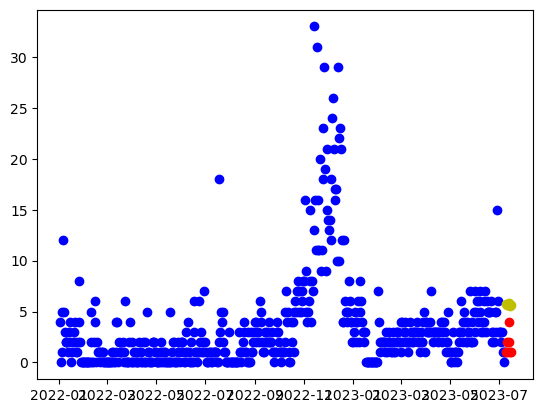

17:03:09 - cmdstanpy - INFO - Chain [1] start processing


[1 2 1 4 2 1 1]
---
[5.78999236 5.65053878 5.70533279 5.82848424 5.78808666 5.500539
 5.69021157]
SMAPE_lr: 1.1286180360659541


17:03:09 - cmdstanpy - INFO - Chain [1] done processing


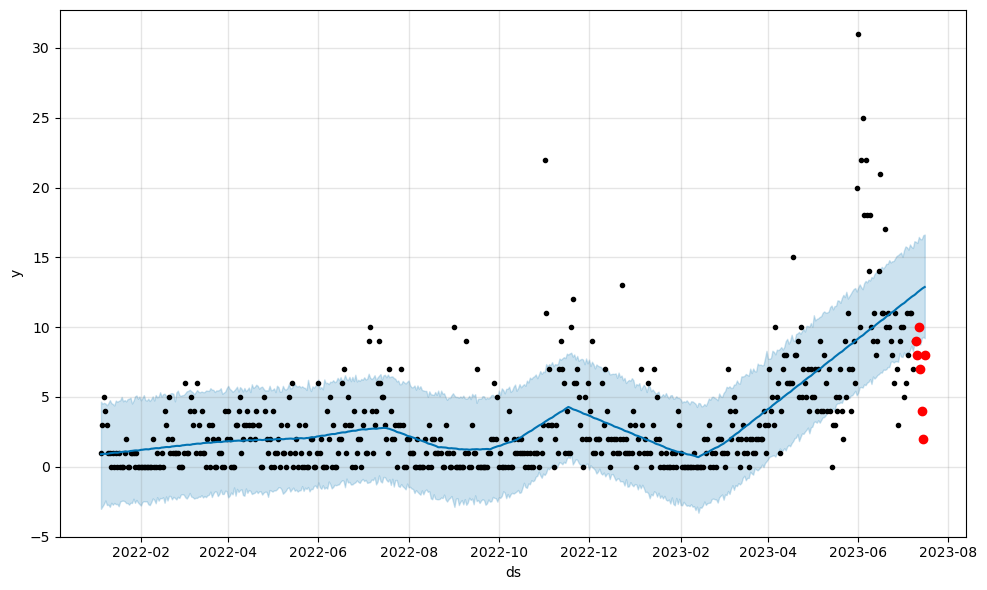

            ds       yhat  yhat_lower  yhat_upper
553 2023-07-12  12.563935    9.031008   16.460369
554 2023-07-13  12.651425    8.750534   16.298836
555 2023-07-14  12.736981    9.204386   16.297789
556 2023-07-15  12.810466    9.301847   16.582099
557 2023-07-16  12.873437    9.209274   16.631442
[ 9  8 10  7  4  2  8]
---
[12.3834396  12.484574   12.56393547 12.65142536 12.73698141 12.81046615
 12.87343718]
SMAPE: 0.6467936153151106


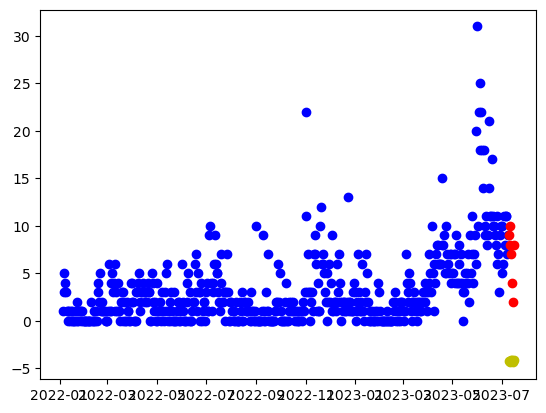

17:03:10 - cmdstanpy - INFO - Chain [1] start processing
17:03:10 - cmdstanpy - INFO - Chain [1] done processing


[ 9  8 10  7  4  2  8]
---
[0. 0. 0. 0. 0. 0. 0.]
SMAPE_lr: 2.0


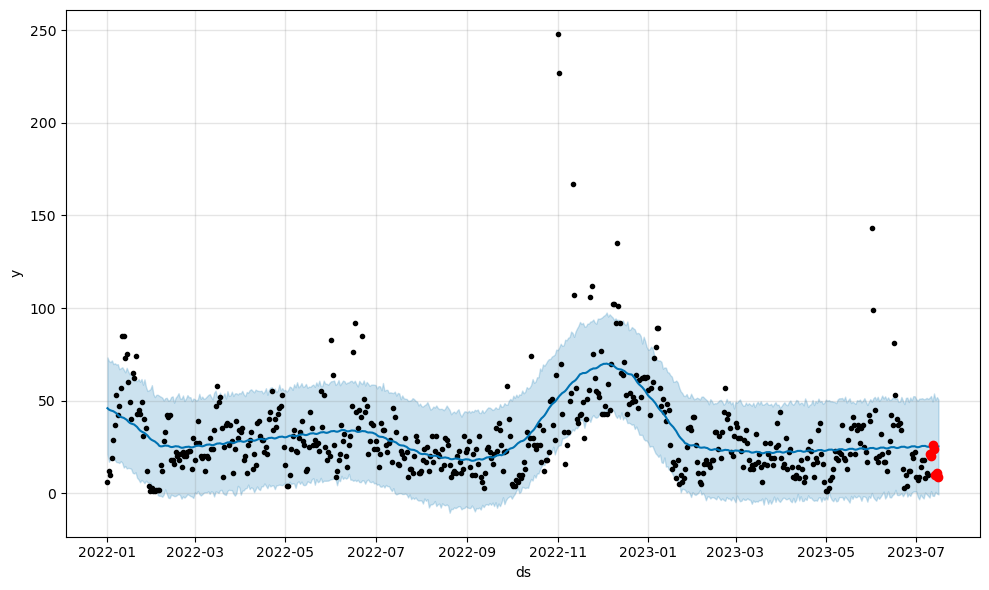

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  25.744875   -1.372607   49.544084
558 2023-07-13  25.729339   -1.472501   53.876288
559 2023-07-14  25.782312    0.759540   50.401671
560 2023-07-15  25.450155   -0.227901   51.911848
561 2023-07-16  25.256974   -0.675318   50.526061
[21 20 26 24 10 11  9]
---
[25.16462865 25.42858475 25.74487474 25.72933934 25.78231182 25.45015546
 25.25697381]
SMAPE: 0.44613581248815193


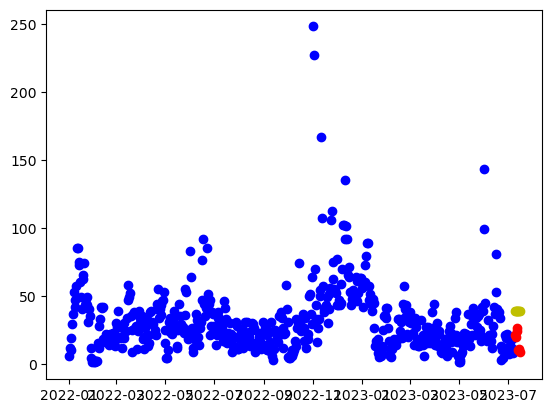

17:03:11 - cmdstanpy - INFO - Chain [1] start processing


[21 20 26 24 10 11  9]
---
[39.08660353 38.93032626 38.96829658 39.07462435 39.01740307 38.71303173
 38.8858806 ]
SMAPE_lr: 0.8098273115846496


17:03:11 - cmdstanpy - INFO - Chain [1] done processing


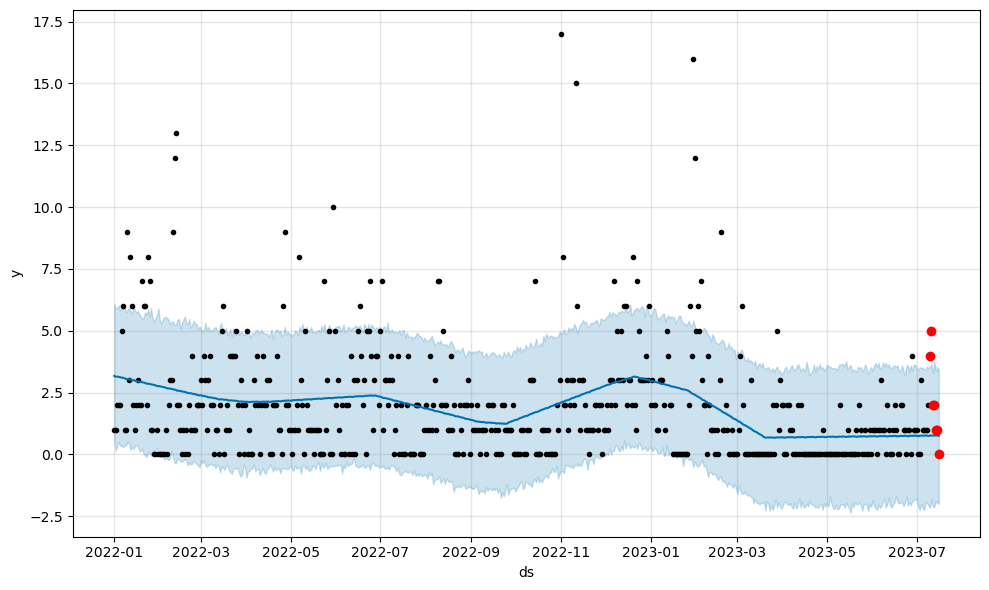

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  0.766410   -2.111579    3.280501
558 2023-07-13  0.764663   -2.114540    3.747683
559 2023-07-14  0.771392   -1.882483    3.384254
560 2023-07-15  0.767281   -1.955690    3.533417
561 2023-07-16  0.751770   -2.000434    3.428225
[4 5 2 2 1 1 0]
---
[0.75974855 0.76710518 0.76641033 0.7646632  0.77139188 0.76728109
 0.75177044]
SMAPE: 1.0194910634281567


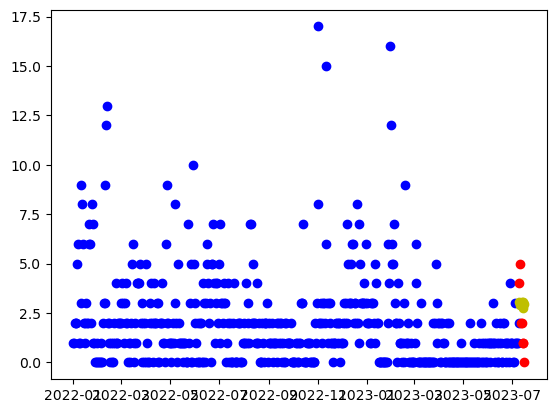

17:03:12 - cmdstanpy - INFO - Chain [1] start processing


[4 5 2 2 1 1 0]
---
[3.03858846 2.89876579 2.95319071 3.07597308 3.0352064  2.74728966
 2.93659314]
SMAPE_lr: 0.7936196900449162


17:03:12 - cmdstanpy - INFO - Chain [1] done processing


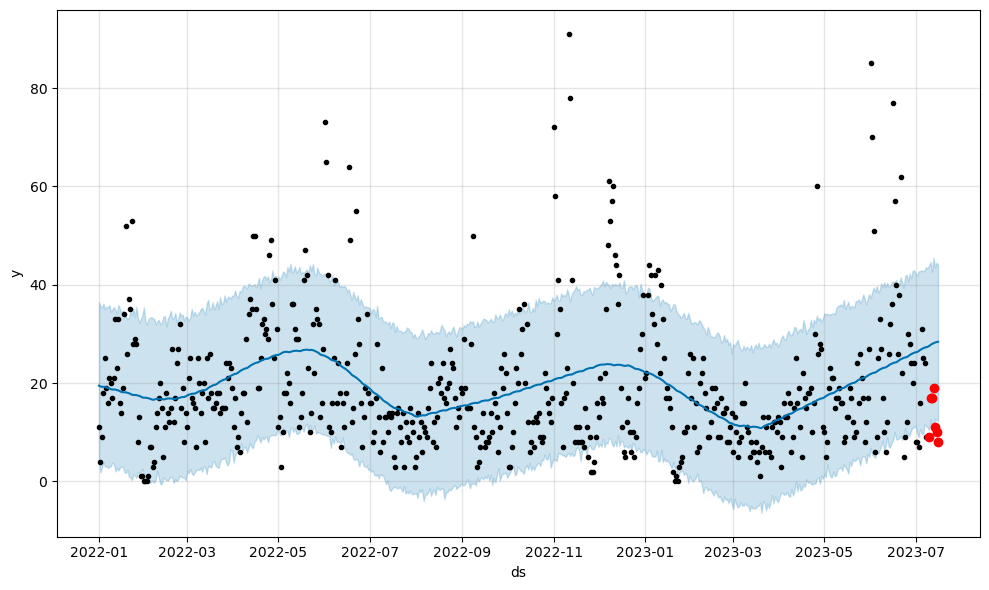

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  27.951551   11.137327   42.639755
558 2023-07-13  28.089758   11.268441   45.506596
559 2023-07-14  28.236705   12.721308   43.501966
560 2023-07-15  28.334123   12.425569   44.494863
561 2023-07-16  28.386614   12.307268   44.023404
[ 9 17 17 19 11 10  8]
---
[27.52088078 27.75183425 27.95155147 28.08975767 28.23670543 28.33412251
 28.38661424]
SMAPE: 0.760541841921121


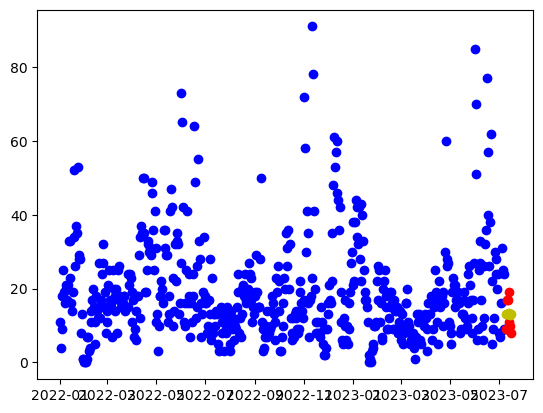

17:03:13 - cmdstanpy - INFO - Chain [1] start processing
17:03:13 - cmdstanpy - INFO - Chain [1] done processing


[ 9 17 17 19 11 10  8]
---
[13.19940121 13.07656787 13.14798212 13.28775382 13.26397647 12.99304906
 13.19934187]
SMAPE_lr: 0.3122971906998017


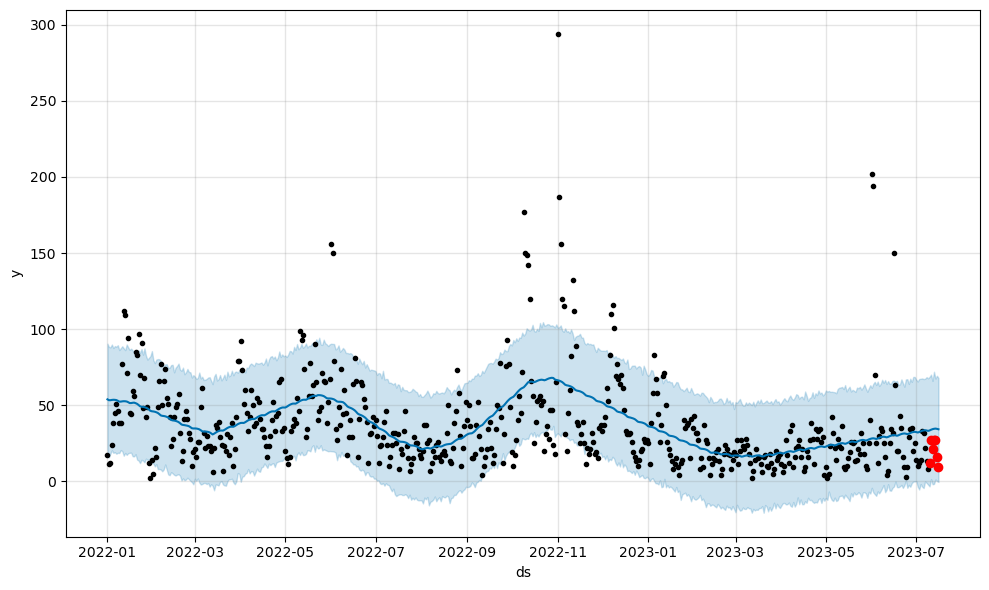

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  34.192580   -2.027451   65.923587
558 2023-07-13  34.438440   -1.796866   71.956577
559 2023-07-14  34.565319    1.143132   67.448679
560 2023-07-15  34.401489    0.093363   69.305688
561 2023-07-16  34.130777   -0.506229   67.881961
[12 27 21 27 27 16  9]
---
[33.34951191 33.81301061 34.19257961 34.43843999 34.56531902 34.40148873
 34.13077683]
SMAPE: 0.5753012347747358


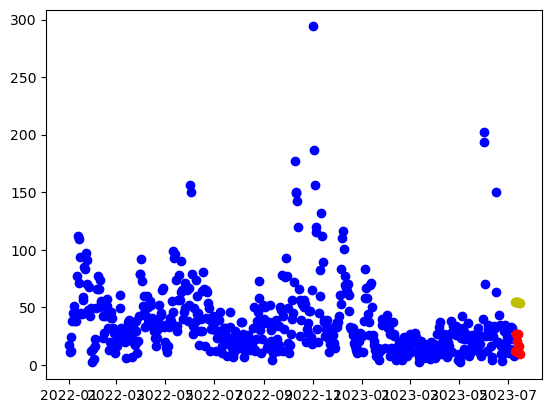

17:03:14 - cmdstanpy - INFO - Chain [1] start processing
17:03:14 - cmdstanpy - INFO - Chain [1] done processing


[12 27 21 27 27 16  9]
---
[54.38885046 54.19631815 54.19803344 54.26810616 54.17462985 53.83400347
 53.9705973 ]
SMAPE_lr: 0.9546104315257818


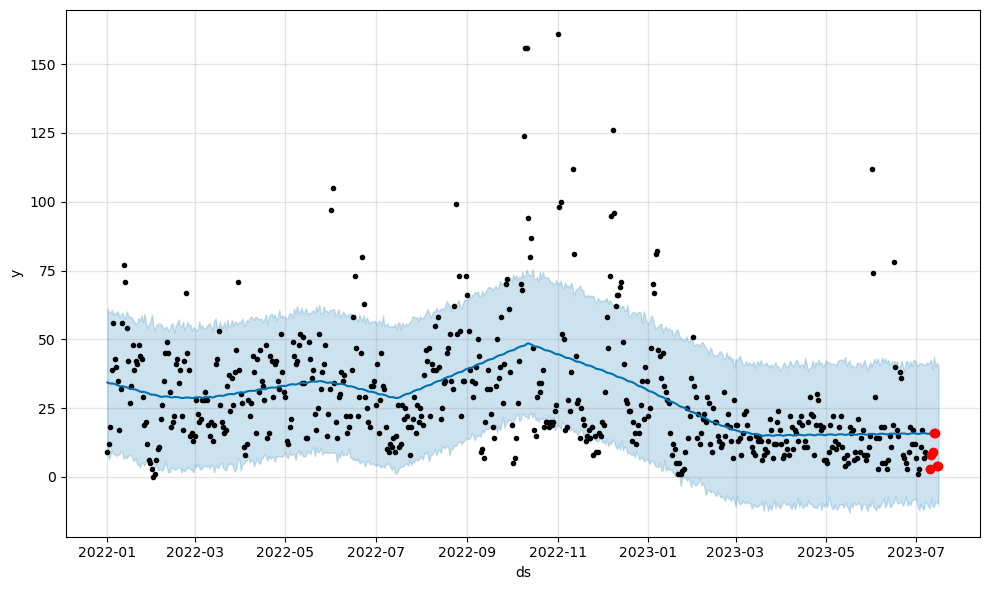

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  15.905352  -10.778686   39.215412
558 2023-07-13  15.918151  -10.777141   43.575159
559 2023-07-14  15.898902   -8.707667   40.124747
560 2023-07-15  15.796787   -9.449957   41.443751
561 2023-07-16  15.667044   -9.850748   40.482502
[ 3  8  9 16 16  4  4]
---
[15.66182775 15.83364325 15.90535238 15.91815147 15.89890207 15.7967874
 15.66704418]
SMAPE: 0.7083679302180942


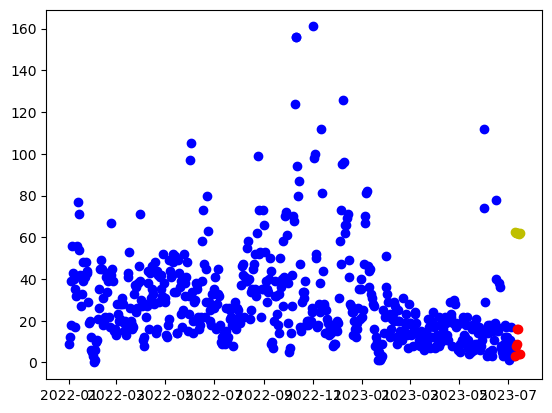

17:03:15 - cmdstanpy - INFO - Chain [1] start processing


[ 3  8  9 16 16  4  4]
---
[62.48961414 62.26094292 62.2265193  62.26045311 62.13083789 61.75407259
 61.85452752]
SMAPE_lr: 1.5332397762584293


17:03:15 - cmdstanpy - INFO - Chain [1] done processing


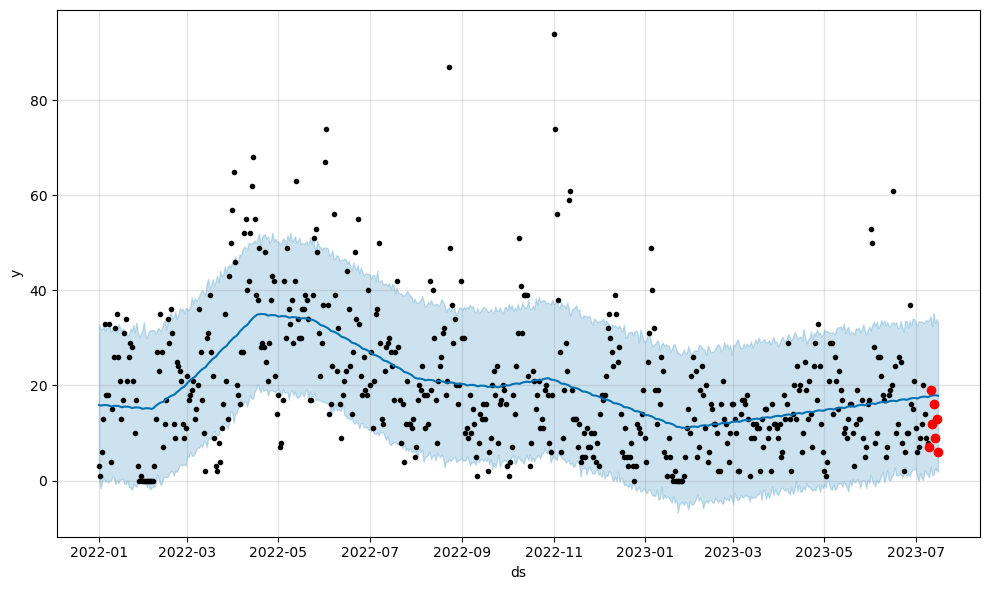

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  17.872509    1.148173   32.482190
558 2023-07-13  17.924997    1.193607   35.248724
559 2023-07-14  17.957477    2.525639   33.141130
560 2023-07-15  17.923513    2.100007   33.997858
561 2023-07-16  17.838450    1.845064   33.391645
[ 7 19 12 16  9 13  6]
---
[17.64838319 17.8069438  17.8725091  17.92499651 17.95747703 17.92351269
 17.83844994]
SMAPE: 0.48738939667398656


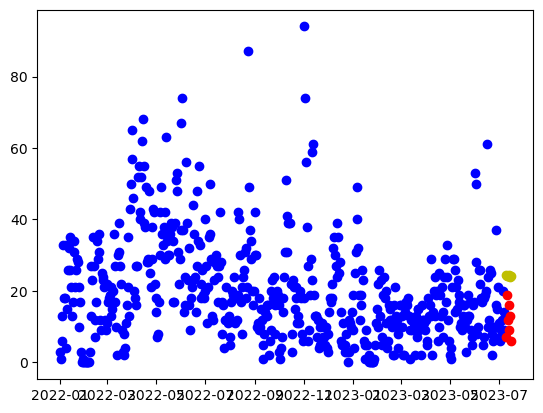

17:03:16 - cmdstanpy - INFO - Chain [1] start processing


[ 7 19 12 16  9 13  6]
---
[24.38609774 24.22906635 24.26628255 24.37185619 24.31388079 24.00875533
 24.18085008]
SMAPE_lr: 0.7371561337974629


17:03:16 - cmdstanpy - INFO - Chain [1] done processing


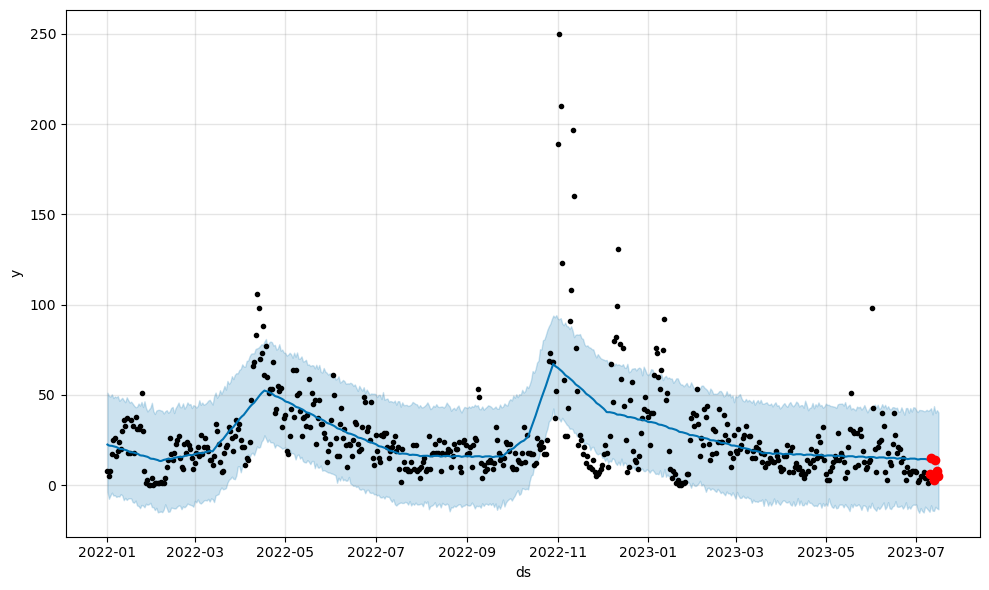

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  14.262490  -14.134073   39.184265
558 2023-07-13  14.308420  -14.294045   43.783008
559 2023-07-14  14.243128  -11.977072   40.023736
560 2023-07-15  14.055316  -12.854391   41.528509
561 2023-07-16  13.750912  -13.404558   40.211895
[ 6 15  5  3 14  8  5]
---
[14.05780403 14.24479332 14.26249048 14.3084201  14.24312772 14.05531588
 13.75091169]
SMAPE: 0.6604597960336055


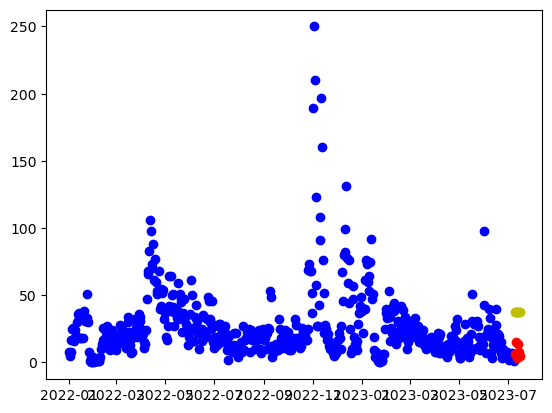

17:03:17 - cmdstanpy - INFO - Chain [1] start processing


[ 6 15  5  3 14  8  5]
---
[37.87229383 37.70287204 37.72769785 37.82088109 37.75051529 37.43299943
 37.59270378]
SMAPE_lr: 1.328062785954078


17:03:17 - cmdstanpy - INFO - Chain [1] done processing


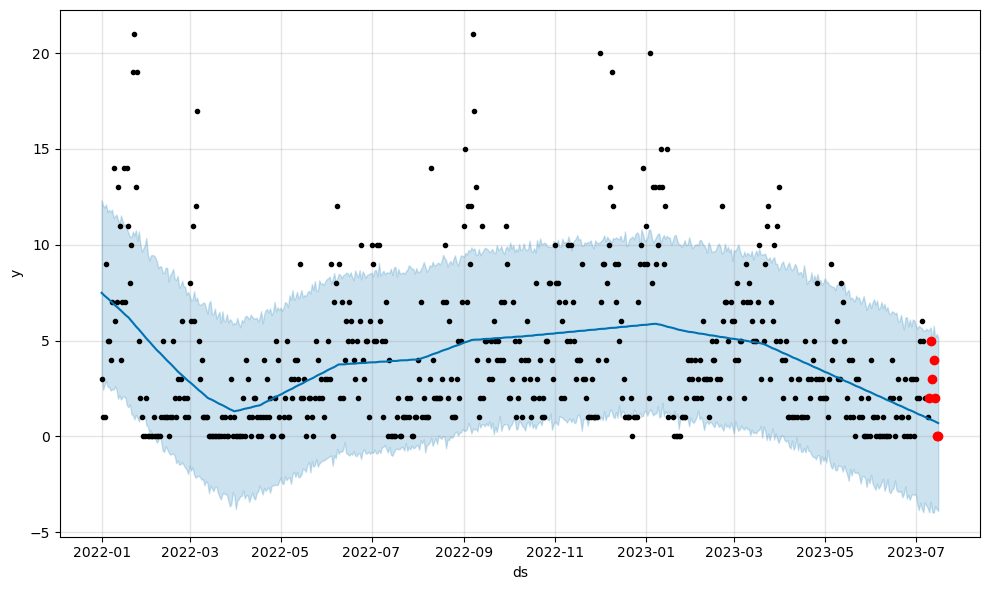

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  0.843599   -3.953386    5.034044
558 2023-07-13  0.809465   -3.989543    5.781086
559 2023-07-14  0.772399   -3.651271    5.127476
560 2023-07-15  0.732694   -3.805909    5.343245
561 2023-07-16  0.692233   -3.895096    5.153304
[2 5 3 4 2 0 0]
---
[0.89922011 0.87468845 0.84359877 0.80946496 0.77239944 0.7326942
 0.69223283]
SMAPE: 1.3568904470500096


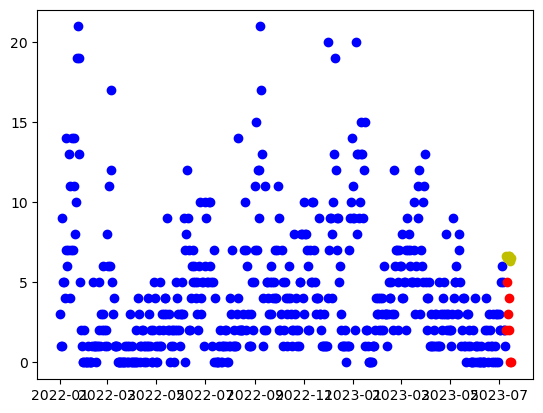

17:03:18 - cmdstanpy - INFO - Chain [1] start processing


[2 5 3 4 2 0 0]
---
[6.64918207 6.50709421 6.55925394 6.67977112 6.63673925 6.34655732
 6.5335956 ]
SMAPE_lr: 1.0938908227376578


17:03:18 - cmdstanpy - INFO - Chain [1] done processing


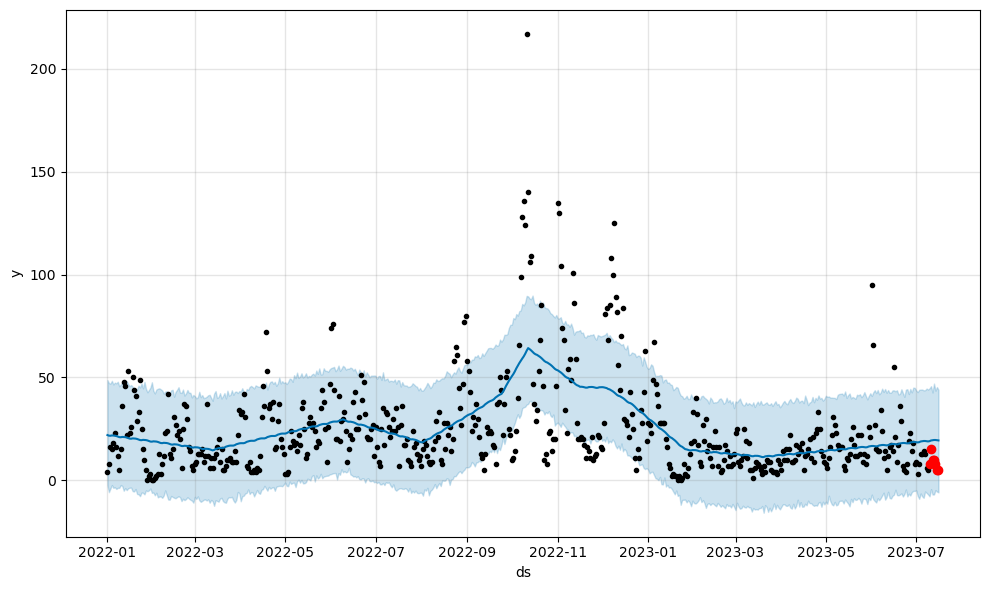

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  19.493540   -6.931477   42.685020
558 2023-07-13  19.585597   -6.890890   47.013794
559 2023-07-14  19.586485   -4.797313   43.577170
560 2023-07-15  19.504742   -5.502300   45.314227
561 2023-07-16  19.384923   -5.885168   44.008747
[ 8 15 10 10  8  5  5]
---
[19.02487382 19.35245668 19.49353998 19.58559729 19.5864845  19.50474154
 19.3849233 ]
SMAPE: 0.7949616377143846


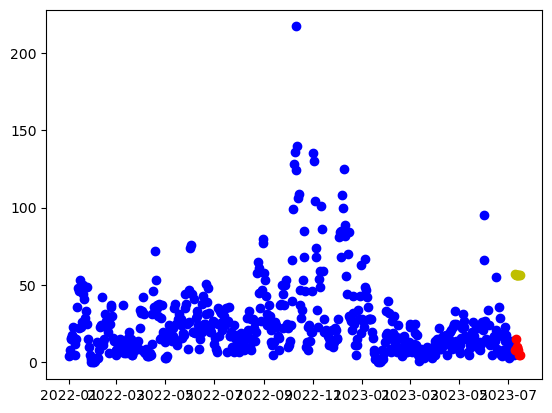

17:03:19 - cmdstanpy - INFO - Chain [1] start processing


[ 8 15 10 10  8  5  5]
---
[56.88027675 56.66290397 56.63977879 56.68501104 56.56669426 56.20122741
 56.31298077]
SMAPE_lr: 1.474407995658812


17:03:19 - cmdstanpy - INFO - Chain [1] done processing


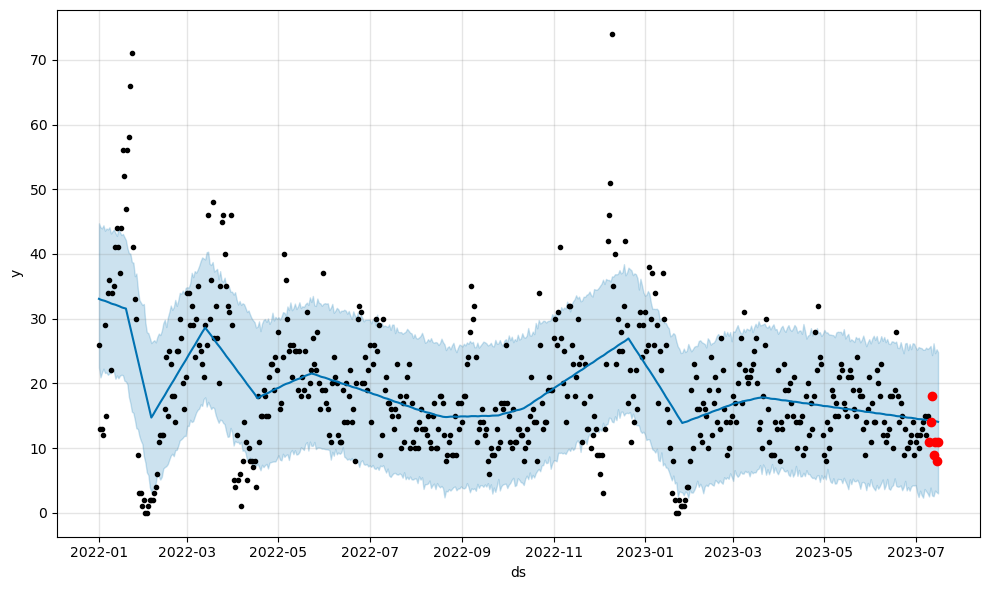

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  14.230742    2.673861   24.373447
558 2023-07-13  14.197419    2.556740   26.193035
559 2023-07-14  14.171687    3.426769   24.663921
560 2023-07-15  14.116402    3.182014   25.272556
561 2023-07-16  14.053826    2.992244   24.822961
[11 14 18  9 11  8 11]
---
[14.2498975  14.24578078 14.23074168 14.19741858 14.17168663 14.11640166
 14.05382618]
SMAPE: 0.286530360805255


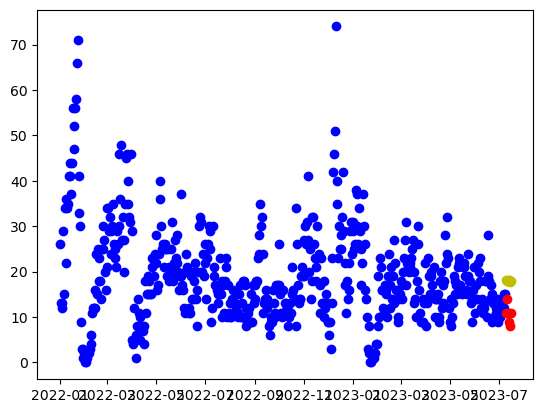

17:03:20 - cmdstanpy - INFO - Chain [1] start processing


[11 14 18  9 11  8 11]
---
[18.09485158 17.95673404 18.0128641  18.1373516  18.09829005 17.81207844
 18.00308705]
SMAPE_lr: 0.44864846681743215


17:03:20 - cmdstanpy - INFO - Chain [1] done processing


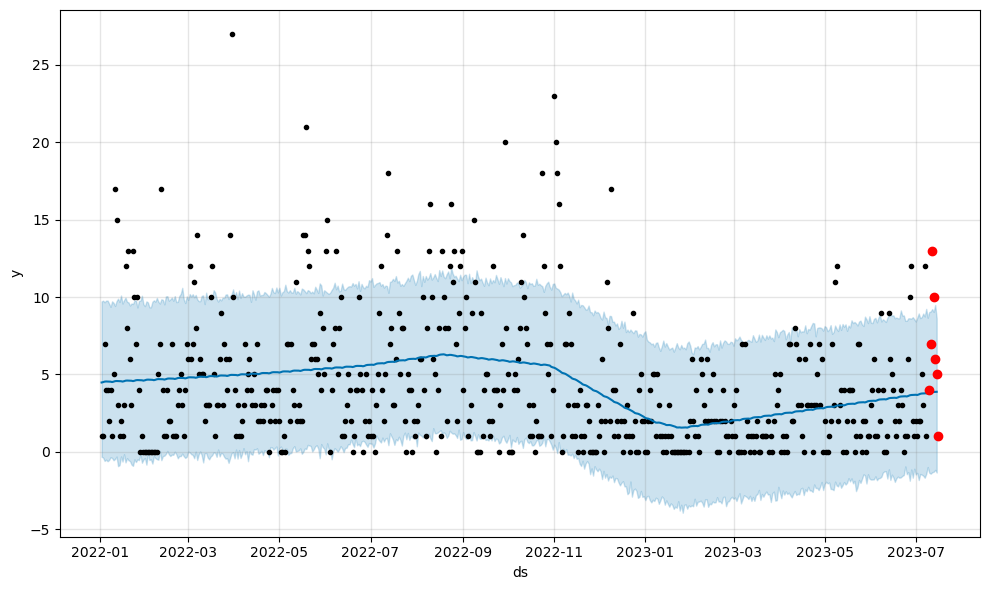

            ds      yhat  yhat_lower  yhat_upper
555 2023-07-11  3.847127   -1.409967    9.068650
556 2023-07-12  3.866718   -1.316047    9.223795
557 2023-07-13  3.871631   -1.284555    9.040670
558 2023-07-14  3.882698   -1.165026    9.490761
559 2023-07-15  3.881621   -1.332700    8.631983
[ 4  7 13 10  6  5  1]
---
[3.77260872 3.80466386 3.84712722 3.86671754 3.87163073 3.88269755
 3.88162089]
SMAPE: 0.6406494906320654


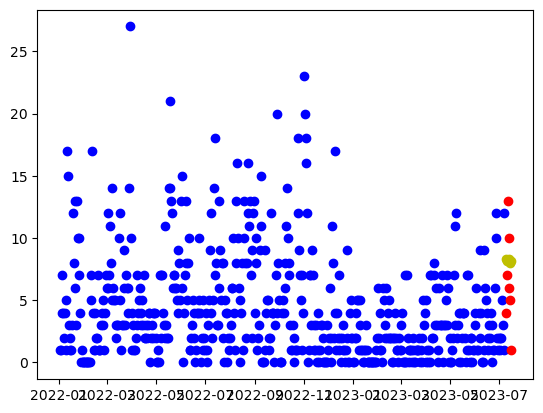

17:03:21 - cmdstanpy - INFO - Chain [1] start processing


[ 4  7 13 10  6  5  1]
---
[8.2979514  8.14998901 8.19627421 8.31091685 8.26201045 7.96595399
 8.14711774]
SMAPE_lr: 0.546563574090478


17:03:21 - cmdstanpy - INFO - Chain [1] done processing


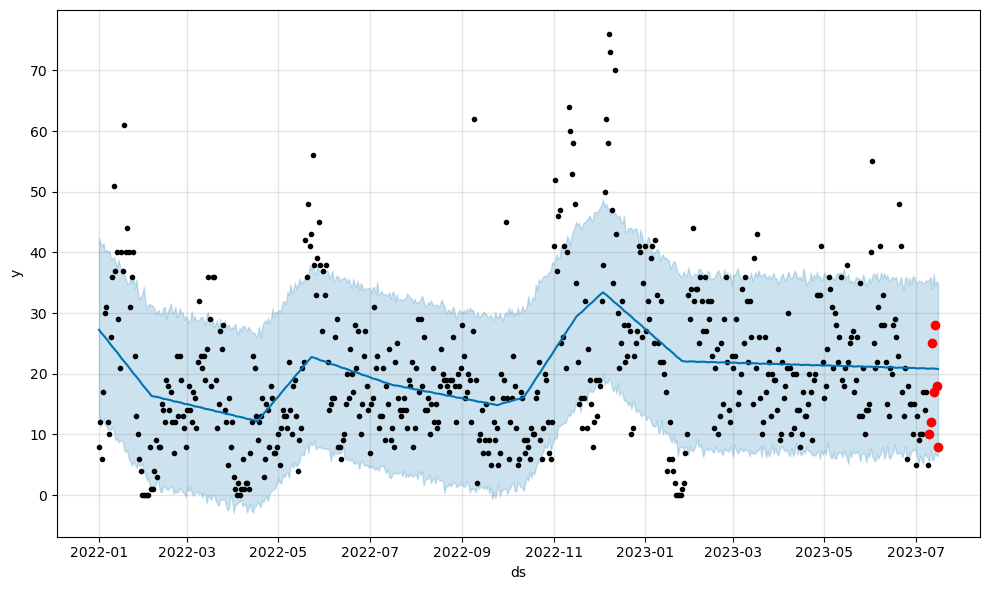

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  20.855819    5.816598   33.993454
558 2023-07-13  20.863546    5.817982   36.441765
559 2023-07-14  20.855964    6.970308   34.509739
560 2023-07-15  20.804294    6.571855   35.270414
561 2023-07-16  20.766929    6.385008   34.781040
[10 12 25 17 28 18  8]
---
[20.83299043 20.87363104 20.85581901 20.86354592 20.85596412 20.80429429
 20.76692899]
SMAPE: 0.42171097755684495


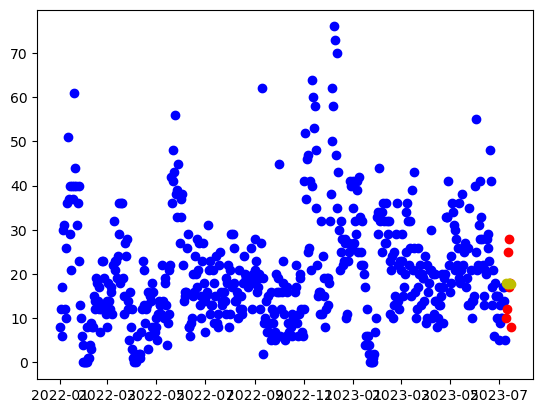

17:03:22 - cmdstanpy - INFO - Chain [1] start processing


[10 12 25 17 28 18  8]
---
[17.86704804 17.74157695 17.81035345 17.94748739 17.92107229 17.64750713
 17.85116218]
SMAPE_lr: 0.3659580432001741


17:03:22 - cmdstanpy - INFO - Chain [1] done processing


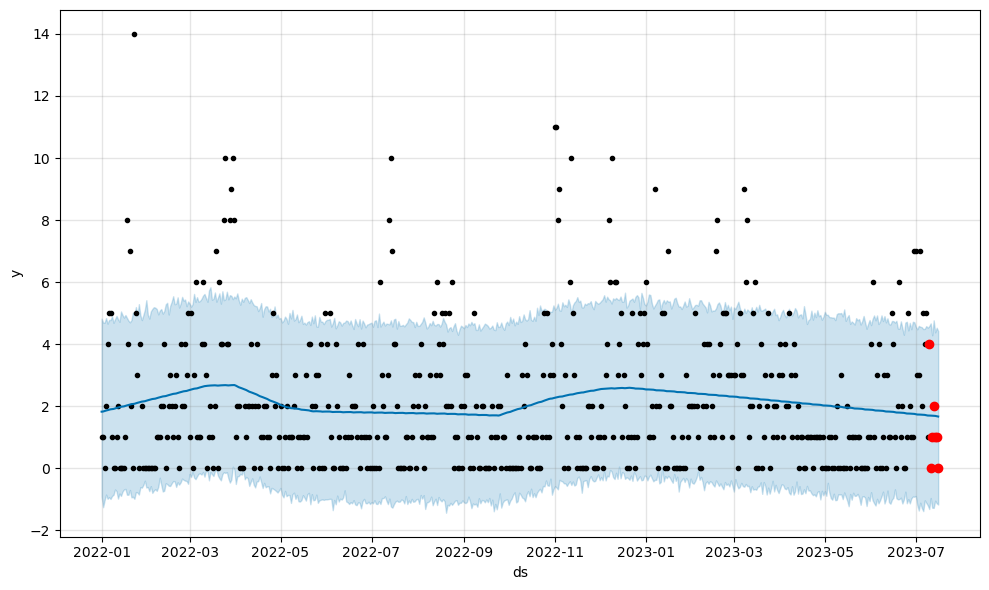

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  1.695252   -1.271651    4.287015
558 2023-07-13  1.690498   -1.277657    4.768835
559 2023-07-14  1.688056   -1.046643    4.381642
560 2023-07-15  1.678839   -1.128257    4.530434
561 2023-07-16  1.667692   -1.169541    4.426834
[4 0 1 2 1 1 0]
---
[1.69714761 1.69755985 1.69525226 1.69049774 1.68805609 1.67883888
 1.66769154]
SMAPE: 0.9301160916300951


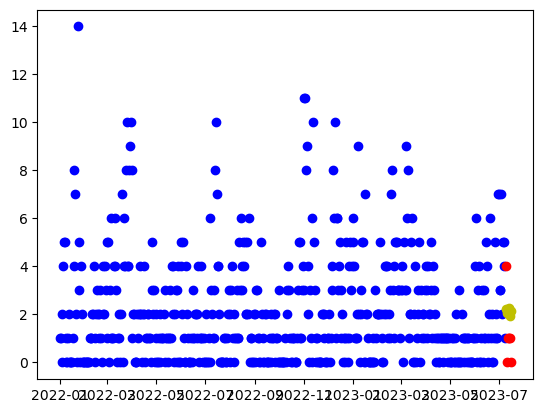

17:03:23 - cmdstanpy - INFO - Chain [1] start processing


[4 0 1 2 1 1 0]
---
[2.20899088 2.07280417 2.13086505 2.25728338 2.22015266 1.93587188
 2.12881131]
SMAPE_lr: 0.9736484418309754


17:03:23 - cmdstanpy - INFO - Chain [1] done processing


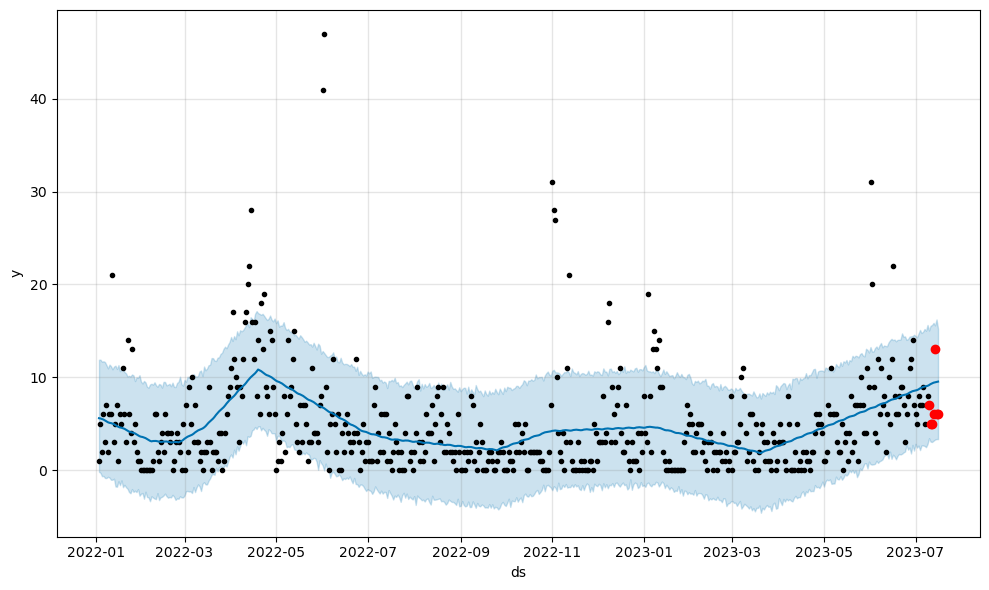

            ds      yhat  yhat_lower  yhat_upper
555 2023-07-12  9.342941    3.023893   15.627143
556 2023-07-13  9.416047    3.163588   15.863192
557 2023-07-14  9.453322    3.281005   15.595914
558 2023-07-15  9.494802    3.344611   16.232074
559 2023-07-16  9.533022    3.332252   15.236667
[ 7  5  5  6 13  6  6]
---
[9.15348598 9.26234524 9.3429407  9.41604677 9.45332235 9.49480182
 9.53302219]
SMAPE: 0.4478591862844522


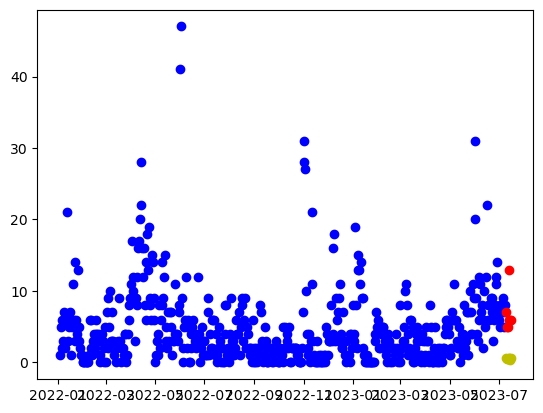

17:03:24 - cmdstanpy - INFO - Chain [1] start processing


[ 7  5  5  6 13  6  6]
---
[0.58579883 0.45946585 0.52738046 0.66365251 0.63637552 0.36194847
 0.56474163]
SMAPE_lr: 1.6880145502602648


17:03:24 - cmdstanpy - INFO - Chain [1] done processing


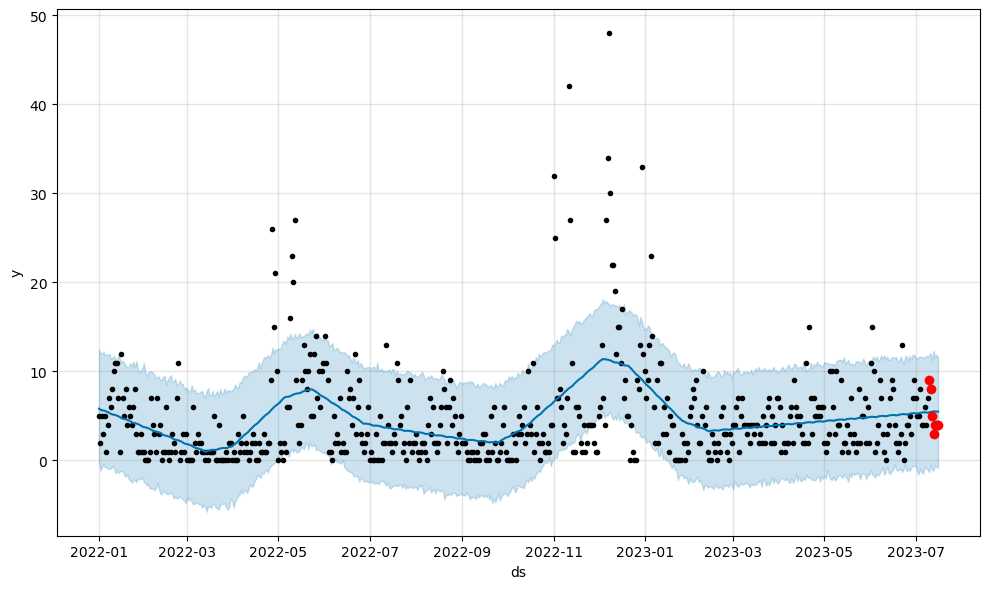

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  5.474538   -1.111070   11.254288
558 2023-07-13  5.496344   -1.092041   12.331279
559 2023-07-14  5.511714   -0.565184   11.490641
560 2023-07-15  5.495812   -0.735073   11.877271
561 2023-07-16  5.471217   -0.826562   11.607933
[9 8 5 3 4 4 4]
---
[5.3823688  5.44923511 5.47453792 5.49634436 5.5117139  5.49581175
 5.47121691]
SMAPE: 0.35774276392191595


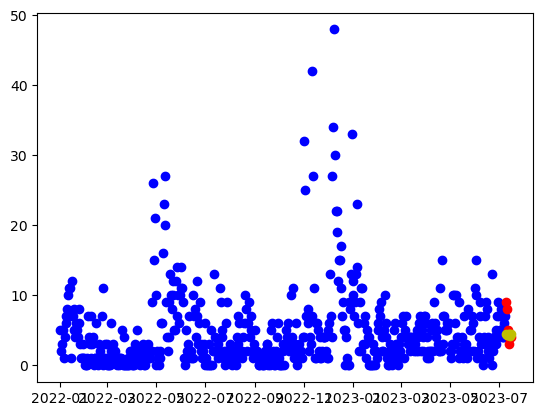

17:03:25 - cmdstanpy - INFO - Chain [1] start processing


[9 8 5 3 4 4 4]
---
[4.49910787 4.36472763 4.42459498 4.55281978 4.51749553 4.23502122
 4.42976713]
SMAPE_lr: 0.29552892629857913


17:03:25 - cmdstanpy - INFO - Chain [1] done processing


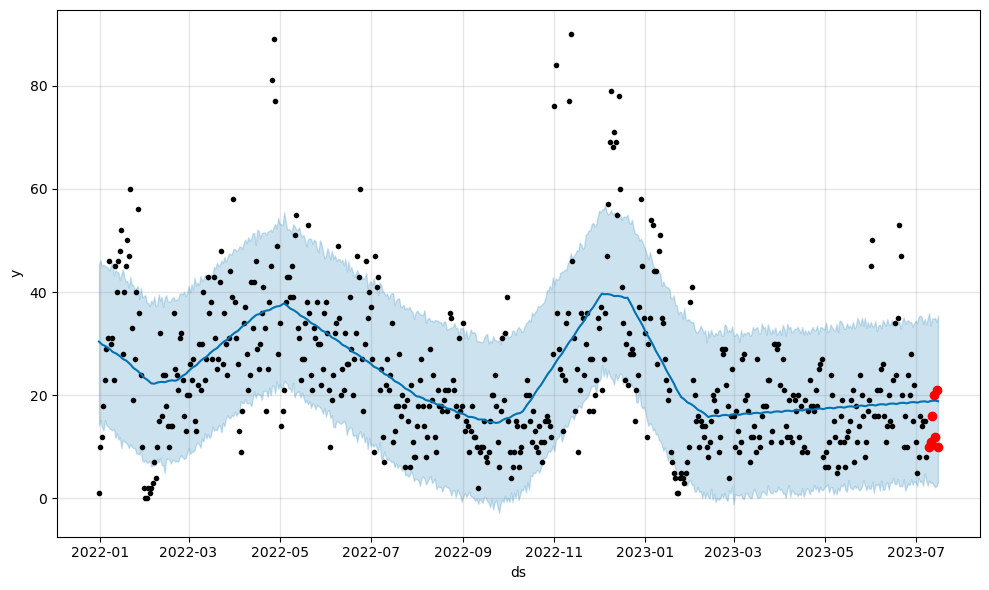

            ds       yhat  yhat_lower  yhat_upper
558 2023-07-12  18.921546    3.151968   34.869819
559 2023-07-13  18.935972    2.572413   34.776507
560 2023-07-14  18.957566    2.173970   34.967331
561 2023-07-15  18.897409    2.399115   34.175257
562 2023-07-16  18.843258    3.215632   35.428462
[10 11 16 20 12 21 10]
---
[18.76917703 18.87214125 18.92154585 18.9359716  18.95756573 18.89740895
 18.84325826]
SMAPE: 0.36096272835579846


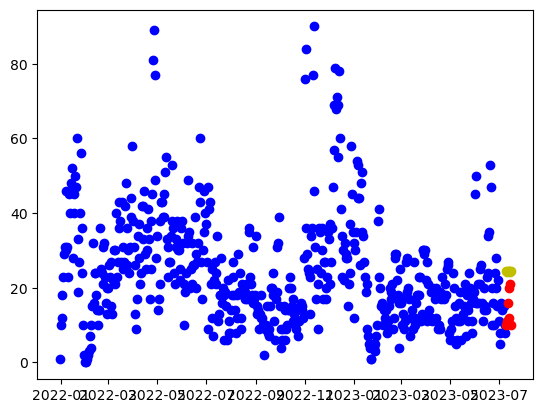

17:03:26 - cmdstanpy - INFO - Chain [1] start processing


[10 11 16 20 12 21 10]
---
[24.51197774 24.36659137 24.41545259 24.53267126 24.48634089 24.19286045
 24.37660022]
SMAPE_lr: 0.5541485473454663


17:03:26 - cmdstanpy - INFO - Chain [1] done processing


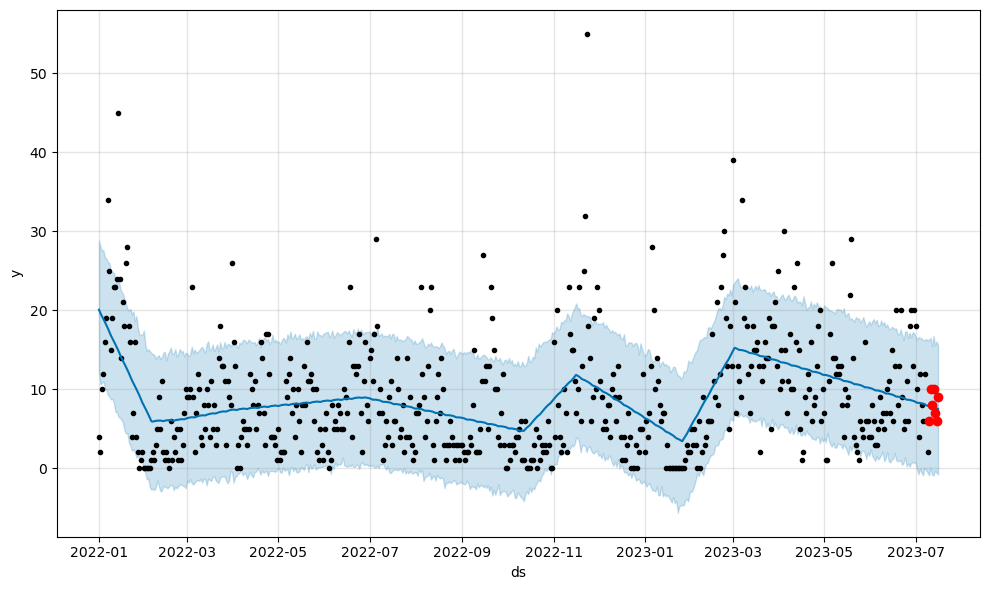

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  7.823585   -0.834215   15.421960
558 2023-07-13  7.771420   -0.916308   16.757898
559 2023-07-14  7.712649   -0.276373   15.572873
560 2023-07-15  7.616743   -0.581866   16.060450
561 2023-07-16  7.508839   -0.770565   15.576502
[ 6 10  8 10  7  6  9]
---
[7.88201311 7.87111981 7.82358471 7.77142038 7.71264893 7.61674257
 7.50883939]
SMAPE: 0.18535492150384072


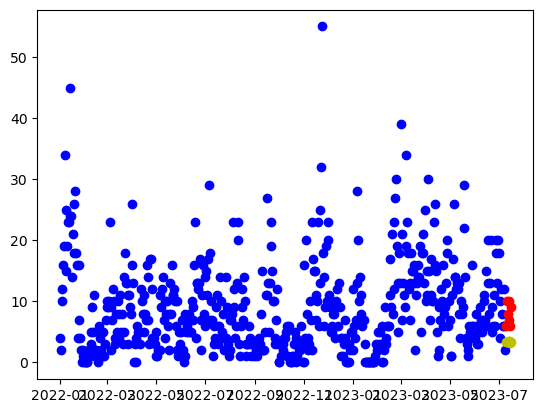

17:03:27 - cmdstanpy - INFO - Chain [1] start processing


[ 6 10  8 10  7  6  9]
---
[3.39672578 3.27577015 3.34906212 3.49071153 3.4688119  3.1997622
 3.40793272]
SMAPE_lr: 0.7909217245097303


17:03:27 - cmdstanpy - INFO - Chain [1] done processing


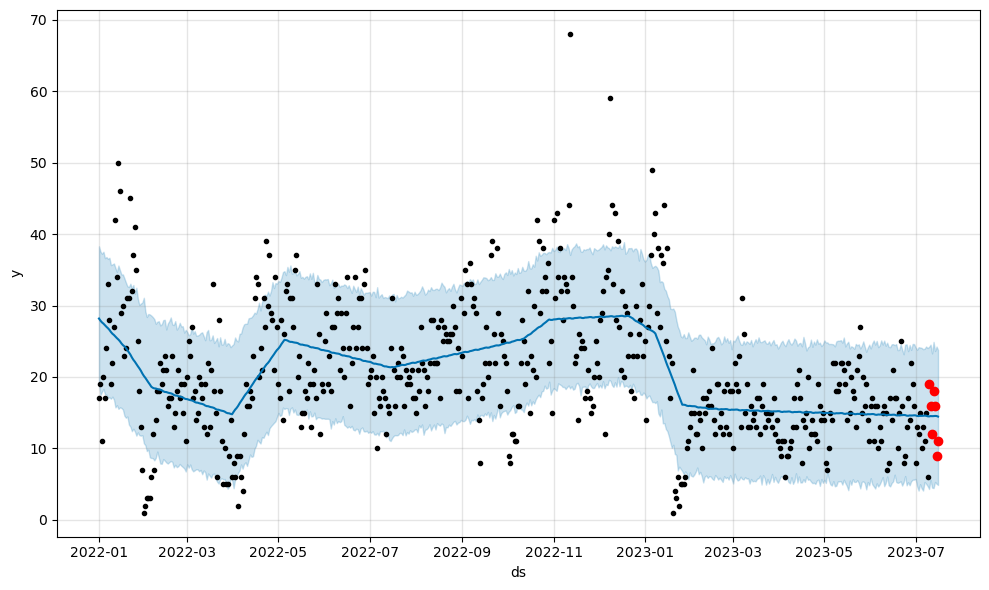

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  14.520099    4.515030   23.300882
558 2023-07-13  14.527495    4.456777   24.912389
559 2023-07-14  14.551472    5.319252   23.634851
560 2023-07-15  14.539142    5.062152   24.256270
561 2023-07-16  14.459707    4.891917   23.782806
[19 16 12 18 16  9 11]
---
[14.48334782 14.53087284 14.520099   14.52749519 14.55147165 14.53914229
 14.45970681]
SMAPE: 0.2295463790374543


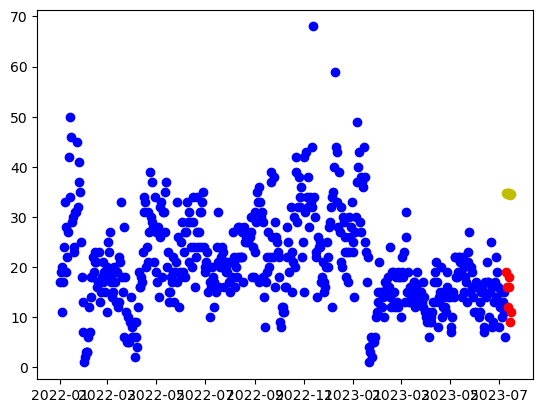

17:03:28 - cmdstanpy - INFO - Chain [1] start processing


[19 16 12 18 16  9 11]
---
[34.86354608 34.68874732 34.70819615 34.79600243 34.72025966 34.39736682
 34.55169421]
SMAPE_lr: 0.8396744095533408


17:03:28 - cmdstanpy - INFO - Chain [1] done processing


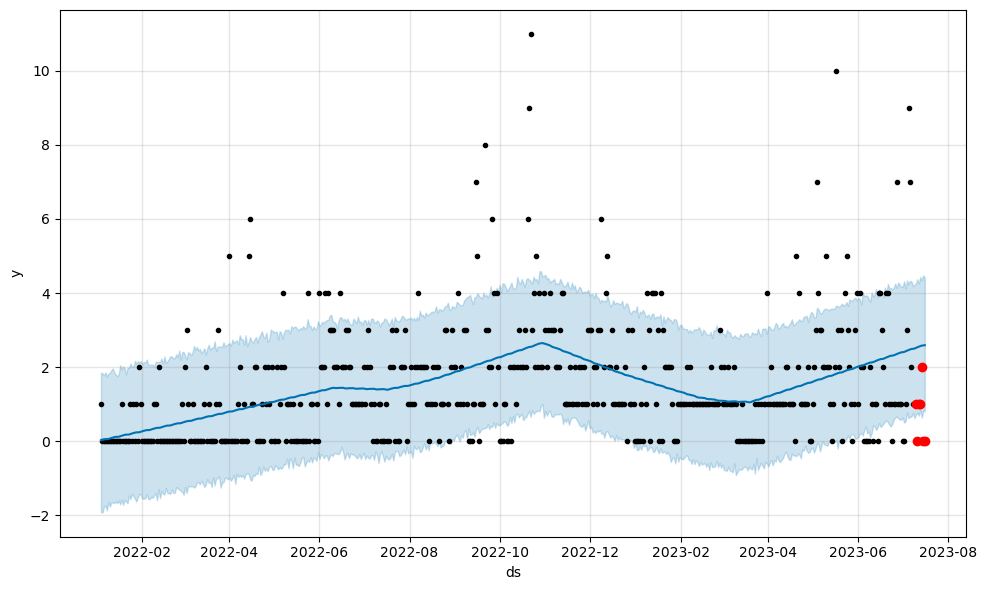

            ds      yhat  yhat_lower  yhat_upper
554 2023-07-12  2.550559    0.684413    4.257190
555 2023-07-13  2.564827    0.835108    4.437345
556 2023-07-14  2.579302    0.630264    4.350993
557 2023-07-15  2.583199    0.826612    4.478285
558 2023-07-16  2.590415    0.800864    4.418111
[1 0 1 1 2 0 0]
---
[2.51704828 2.53421868 2.55055919 2.5648265  2.57930202 2.58319892
 2.59041473]
SMAPE: 1.26671916897957


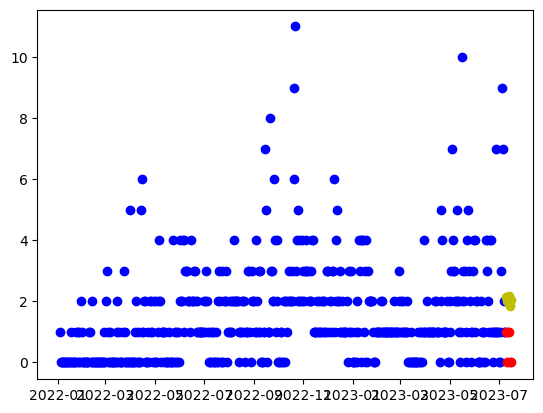

17:03:29 - cmdstanpy - INFO - Chain [1] start processing


[1 0 1 1 2 0 0]
---
[2.14073028 2.00386725 2.06125182 2.18699383 2.14918679 1.86422969
 2.05649281]
SMAPE_lr: 1.1766522741841716


17:03:29 - cmdstanpy - INFO - Chain [1] done processing


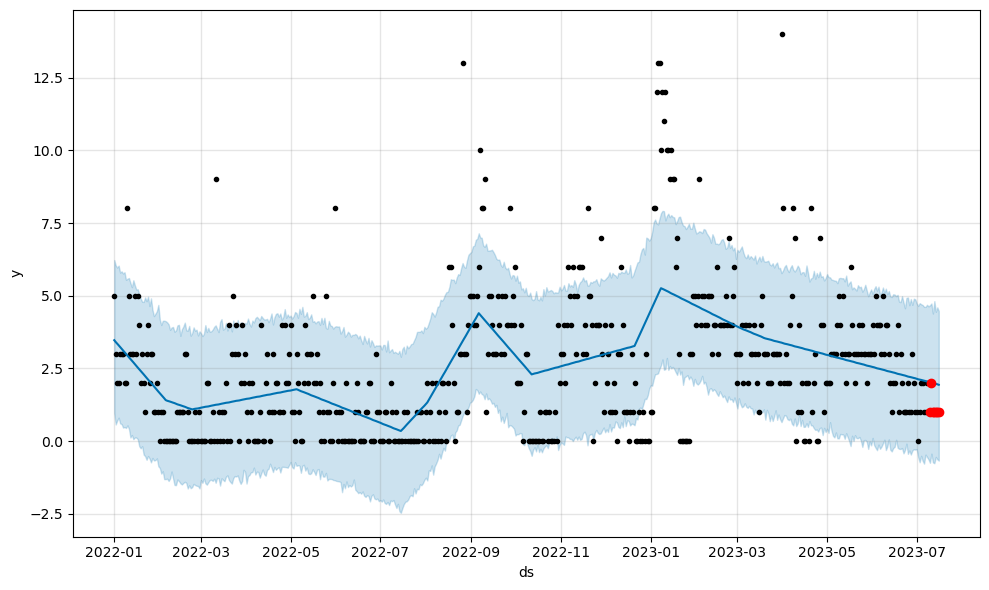

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  1.997922   -0.727686    4.390007
558 2023-07-13  1.985923   -0.757143    4.815004
559 2023-07-14  1.974250   -0.540817    4.448769
560 2023-07-15  1.957502   -0.624033    4.601848
561 2023-07-16  1.939709   -0.666775    4.479533
[1 2 1 1 1 1 1]
---
[2.02396564 2.01230153 1.99792213 1.98592299 1.97424954 1.95750171
 1.93970906]
SMAPE: 0.5644914281544359


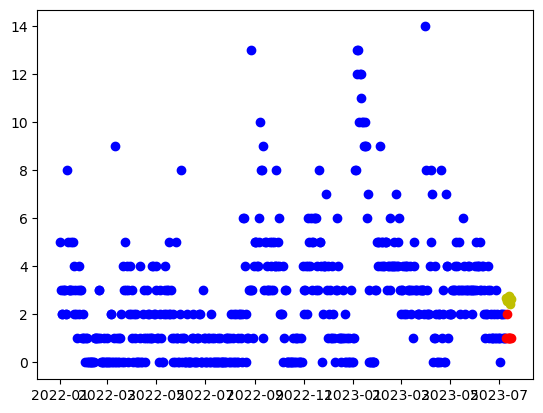

17:03:30 - cmdstanpy - INFO - Chain [1] start processing


[1 2 1 1 1 1 1]
---
[2.70100363 2.56621418 2.62567232 2.75348791 2.71775445 2.43487093
 2.62920762]
SMAPE_lr: 0.8079543248807123


17:03:30 - cmdstanpy - INFO - Chain [1] done processing


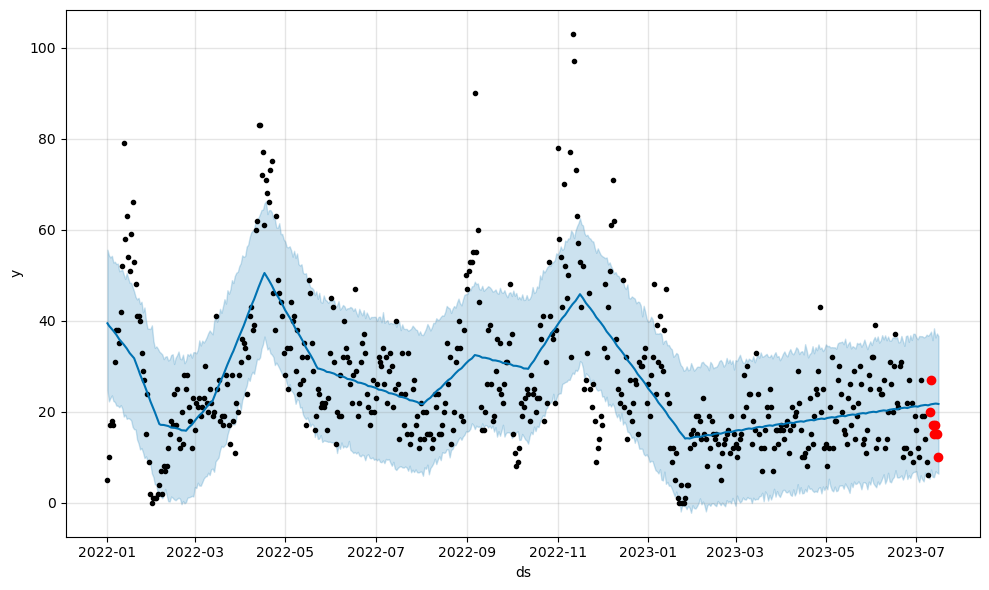

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  21.692184    5.699553   35.727853
558 2023-07-13  21.735752    5.627159   38.335515
559 2023-07-14  21.790724    6.925165   36.310078
560 2023-07-15  21.763684    6.632470   37.201783
561 2023-07-16  21.706714    6.399486   36.609248
[20 27 17 15 17 15 10]
---
[21.5105923  21.63212421 21.69218431 21.73575196 21.79072378 21.76368366
 21.70671375]
SMAPE: 0.32231199219603907


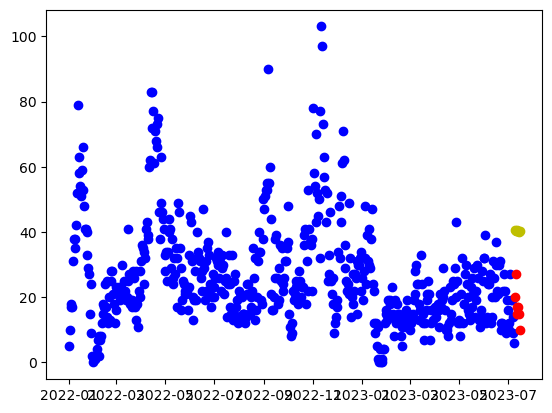

[20 27 17 15 17 15 10]
---
[40.556316   40.37699895 40.39192948 40.47521746 40.39495639 40.06754526
 40.21735435]
SMAPE_lr: 0.8198162409947926


17:03:31 - cmdstanpy - INFO - Chain [1] start processing
17:03:31 - cmdstanpy - INFO - Chain [1] done processing


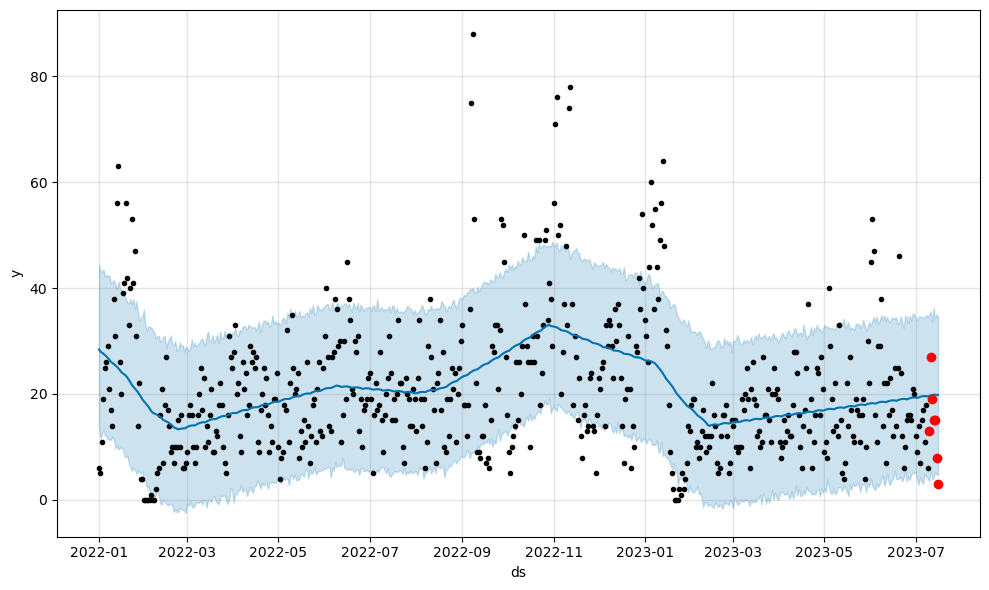

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  19.809188    3.983242   33.634073
558 2023-07-13  19.871104    4.038483   36.264243
559 2023-07-14  19.867011    5.263552   34.235036
560 2023-07-15  19.859595    4.886089   35.082460
561 2023-07-16  19.792257    4.657996   34.539467
[13 27 19 15 15  8  3]
---
[19.61288128 19.73238485 19.80918787 19.87110363 19.86701111 19.85959519
 19.79225672]
SMAPE: 0.5202445682257072


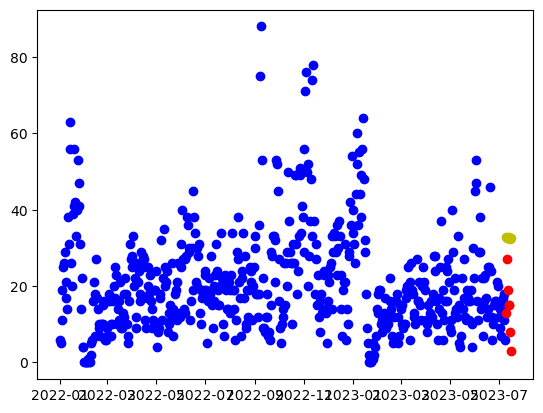

17:03:32 - cmdstanpy - INFO - Chain [1] start processing


[13 27 19 15 15  8  3]
---
[32.7968164  32.63106349 32.65955817 32.7564103  32.68971338 32.3758664
 32.53923964]
SMAPE_lr: 0.8482181115719579


17:03:32 - cmdstanpy - INFO - Chain [1] done processing


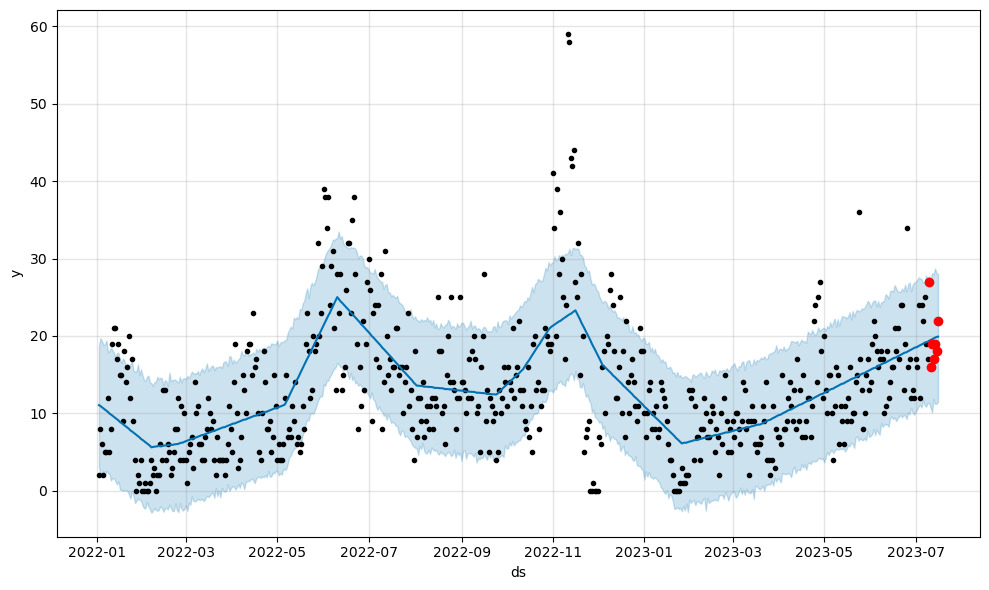

            ds       yhat  yhat_lower  yhat_upper
556 2023-07-12  19.574735   10.134187   28.112047
557 2023-07-13  19.676272   11.854339   27.956656
558 2023-07-14  19.791868   11.224973   28.719487
559 2023-07-15  19.873046   11.255375   28.110537
560 2023-07-16  19.914265   11.487551   28.025741
[27 16 19 17 19 18 22]
---
[19.37296442 19.4733119  19.57473514 19.67627202 19.79186764 19.87304623
 19.91426529]
SMAPE: 0.13425298528242172


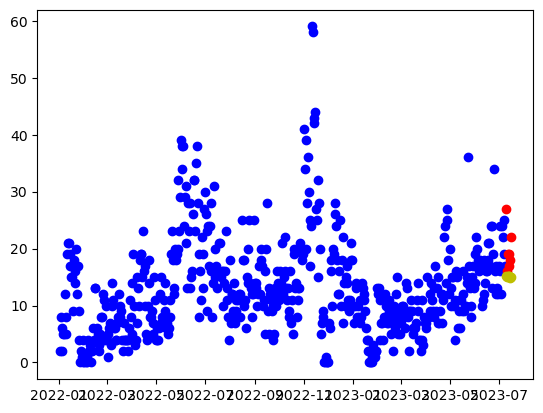

17:03:33 - cmdstanpy - INFO - Chain [1] start processing


[27 16 19 17 19 18 22]
---
[15.20355839 15.0625423  15.1157738  15.23736274 15.19540264 14.90629248
 15.09440253]
SMAPE_lr: 0.24847506149106663


17:03:33 - cmdstanpy - INFO - Chain [1] done processing


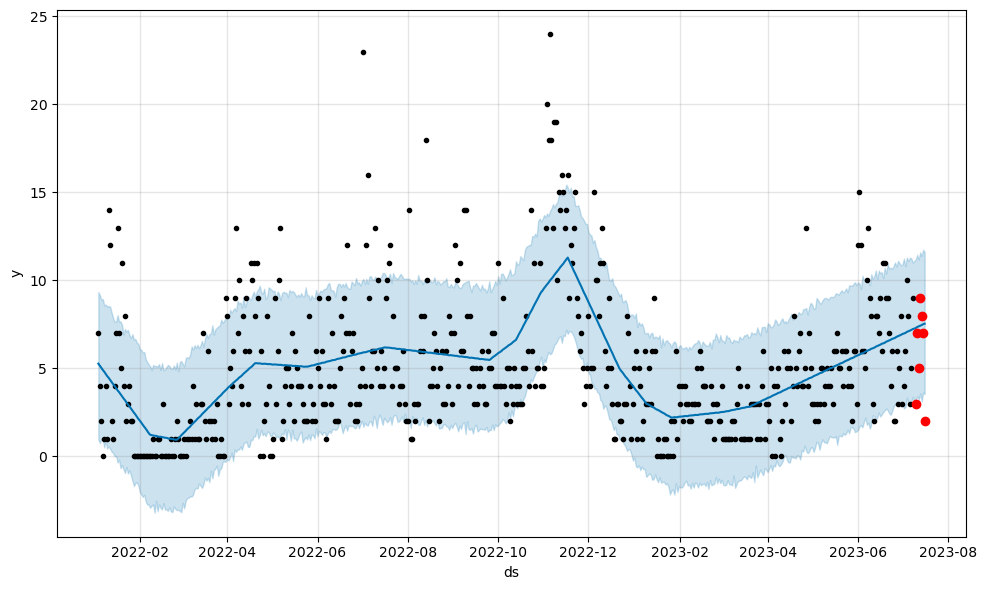

            ds      yhat  yhat_lower  yhat_upper
554 2023-07-12  7.383847    3.220799   11.191045
555 2023-07-13  7.425788    3.567084   11.594003
556 2023-07-14  7.458300    3.120585   11.383970
557 2023-07-15  7.510029    3.619425   11.739339
558 2023-07-16  7.535499    3.543321   11.615237
[3 7 5 9 8 7 2]
---
[7.28935312 7.3475619  7.38384687 7.42578789 7.45829997 7.51002882
 7.53549881]
SMAPE: 0.3943255315991065


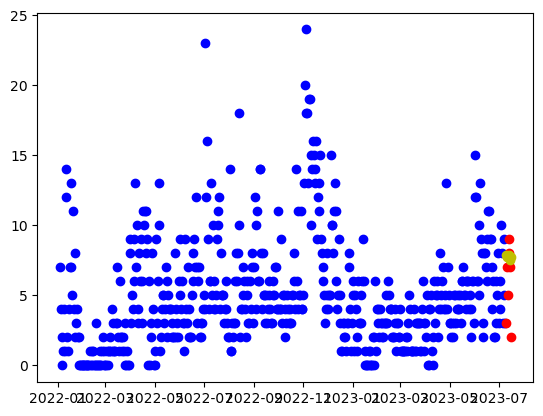

17:03:34 - cmdstanpy - INFO - Chain [1] start processing


[3 7 5 9 8 7 2]
---
[7.862597   7.71995821 7.77156701 7.89153326 7.84795046 7.55721759
 7.74370495]
SMAPE_lr: 0.4047257586380466


17:03:34 - cmdstanpy - INFO - Chain [1] done processing


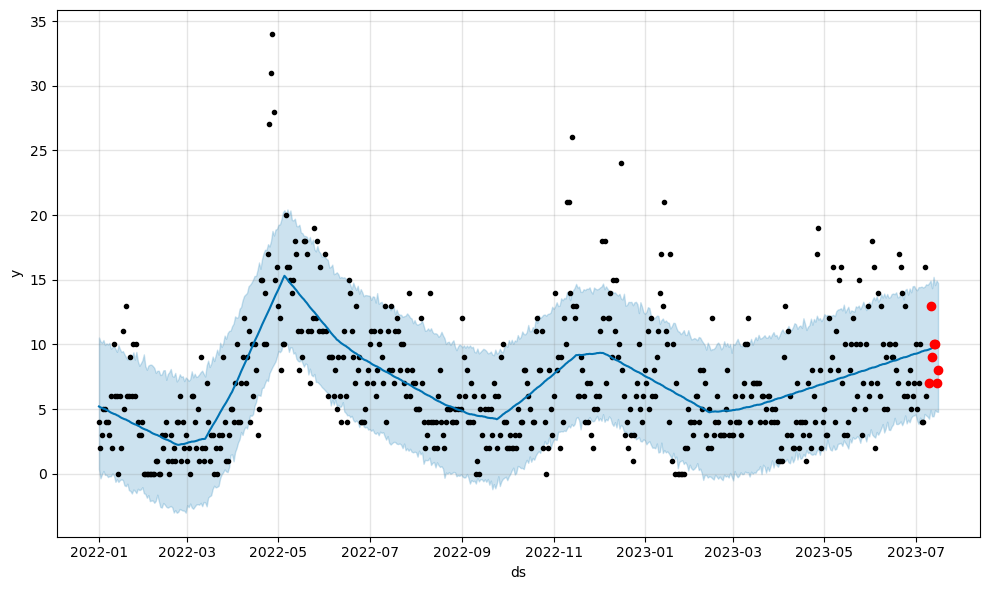

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  9.714048    4.437095   14.345279
558 2023-07-13  9.742065    4.440927   15.219348
559 2023-07-14  9.788497    4.919166   14.579325
560 2023-07-15  9.800948    4.803544   14.938048
561 2023-07-16  9.826766    4.780446   14.744029
[ 7 13  9 10 10  7  8]
---
[9.60346167 9.65209667 9.71404806 9.74206453 9.7884968  9.80094811
 9.82676607]
SMAPE: 0.18162715982850552


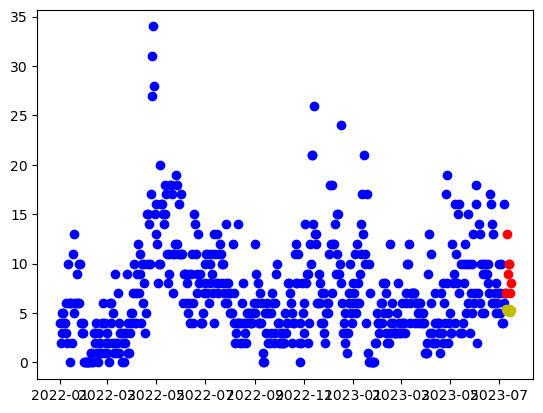

17:03:35 - cmdstanpy - INFO - Chain [1] start processing


[ 7 13  9 10 10  7  8]
---
[5.36445324 5.23242731 5.29464898 5.42522809 5.39225816 5.11213816
 5.30923838]
SMAPE_lr: 0.5061402135199907


17:03:35 - cmdstanpy - INFO - Chain [1] done processing


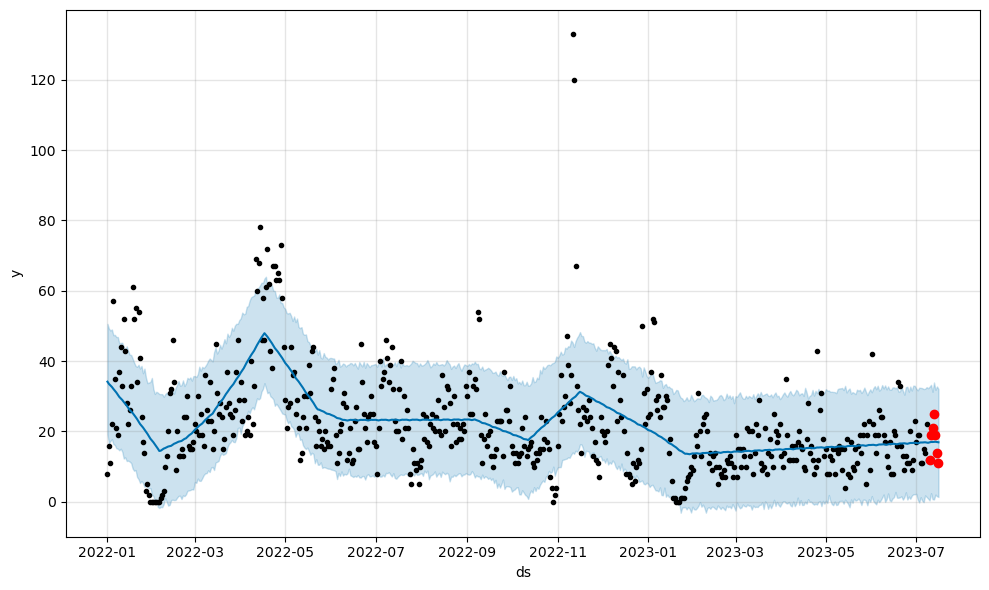

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  17.012340    0.749201   31.285414
558 2023-07-13  17.055107    0.674046   33.935647
559 2023-07-14  17.077234    2.070354   31.842175
560 2023-07-15  17.015649    1.603839   32.804094
561 2023-07-16  16.928906    1.376561   32.083509
[12 19 21 25 19 14 11]
---
[16.91041864 17.02274422 17.01233955 17.05510723 17.07723356 17.01564933
 16.92890588]
SMAPE: 0.251820161413611


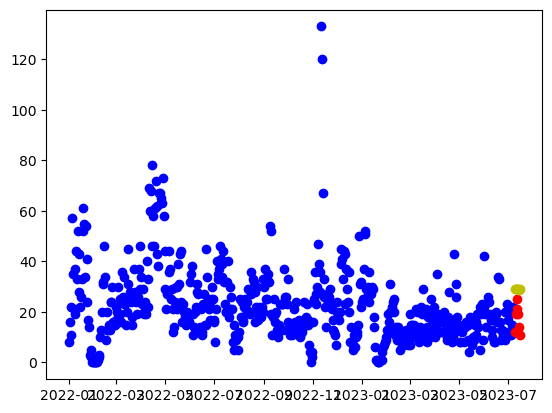

17:03:36 - cmdstanpy - INFO - Chain [1] start processing


[12 19 21 25 19 14 11]
---
[29.26595595 29.10214699 29.13258561 29.23138169 29.16662871 28.85472568
 29.02004286]
SMAPE_lr: 0.5361842030504466


17:03:36 - cmdstanpy - INFO - Chain [1] done processing


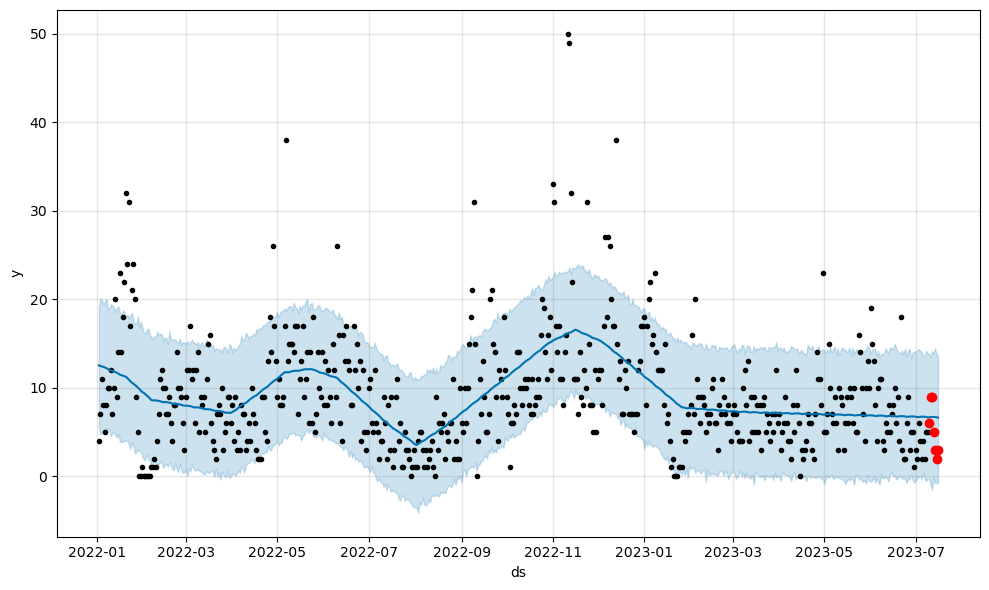

            ds      yhat  yhat_lower  yhat_upper
556 2023-07-12  6.691903   -1.514423   14.148569
557 2023-07-13  6.700361   -0.091164   13.891290
558 2023-07-14  6.682924   -0.763967   14.445841
559 2023-07-15  6.670380   -0.812822   13.807131
560 2023-07-16  6.618655   -0.709695   13.645894
[6 9 9 5 3 2 3]
---
[6.6507869  6.68564166 6.69190336 6.70036085 6.68292426 6.67037961
 6.61865488]
SMAPE: 0.5104646876848616


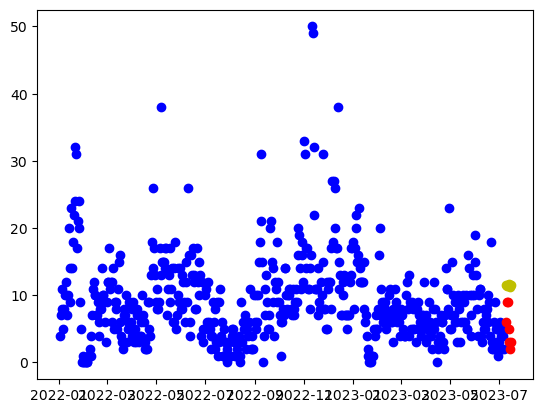

17:03:37 - cmdstanpy - INFO - Chain [1] start processing


[6 9 9 5 3 2 3]
---
[11.58934262 11.44623173 11.49736844 11.61686258 11.57280769 11.28160273
 11.46761798]
SMAPE_lr: 0.8085250206493763


17:03:37 - cmdstanpy - INFO - Chain [1] done processing


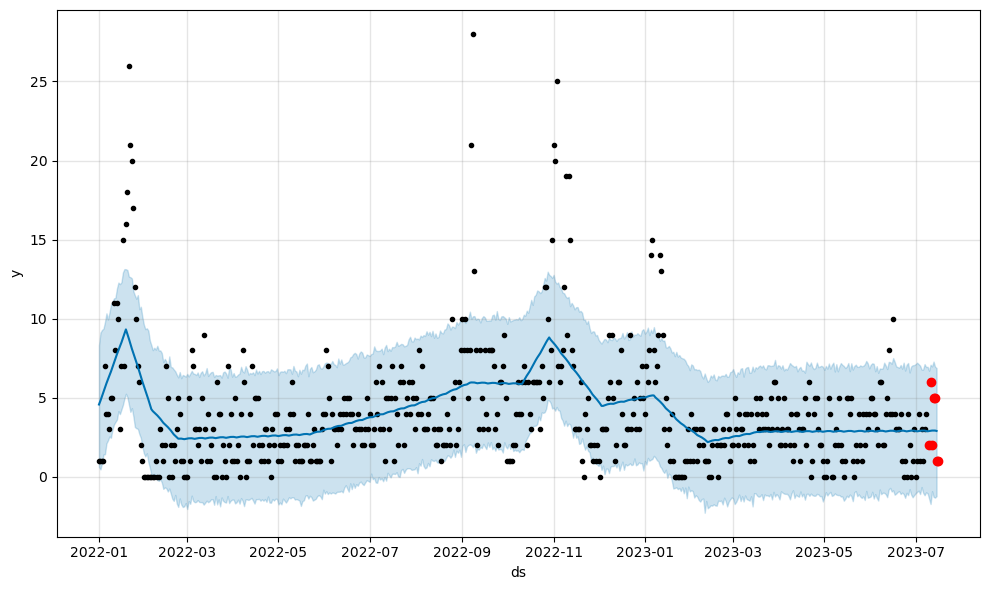

            ds      yhat  yhat_lower  yhat_upper
556 2023-07-11  2.911608   -1.712980    7.093732
557 2023-07-12  2.930384   -0.901302    6.985129
558 2023-07-13  2.933320   -1.263296    7.289856
559 2023-07-14  2.929610   -1.311328    6.965070
560 2023-07-15  2.907395   -1.212748    6.884246
[2 6 2 5 5 1 1]
---
[2.88435614 2.89997647 2.9116077  2.93038384 2.93331974 2.92960987
 2.90739526]
SMAPE: 0.6330436697489044


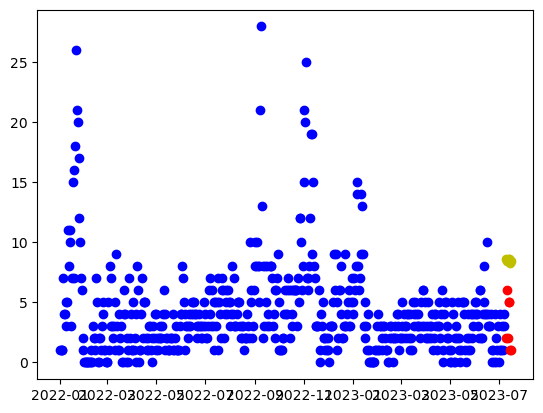

[2 6 2 5 5 1 1]
---
[8.63366665 8.48603361 8.53264816 8.64762015 8.5990431  8.30331599
 8.48480909]
SMAPE_lr: 1.006218757606303


17:03:38 - cmdstanpy - INFO - Chain [1] start processing
17:03:38 - cmdstanpy - INFO - Chain [1] done processing


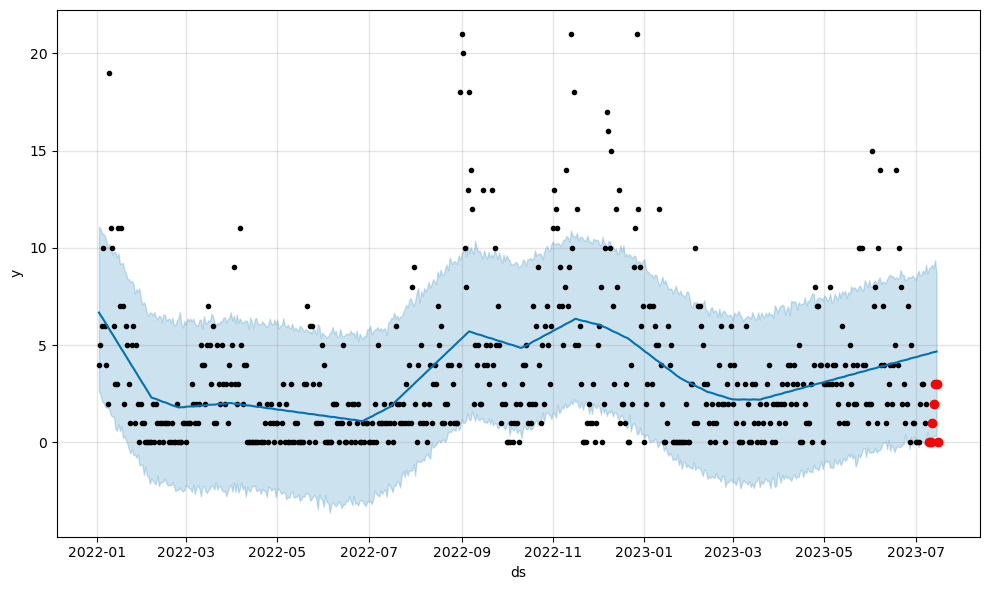

            ds      yhat  yhat_lower  yhat_upper
555 2023-07-11  4.598818    0.172718    8.999848
556 2023-07-12  4.620082    0.241545    9.135237
557 2023-07-13  4.641342    0.318669    8.943197
558 2023-07-14  4.655076    0.359283    9.373405
559 2023-07-15  4.675799    0.333201    8.670295
[0 0 1 2 3 3 0]
---
[4.54541609 4.56452193 4.59881834 4.62008221 4.64134168 4.65507639
 4.67579947]
SMAPE: 1.2770181783728787


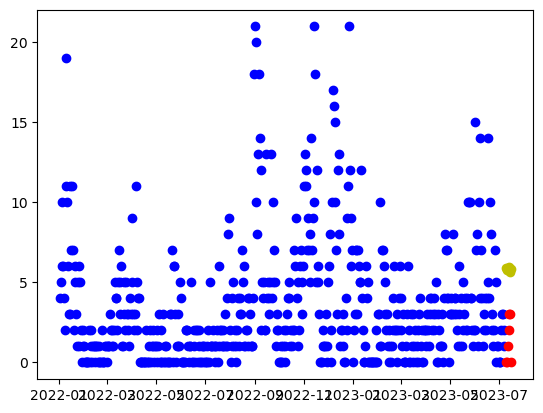

17:03:39 - cmdstanpy - INFO - Chain [1] start processing


[0 0 1 2 3 3 0]
---
[5.93407273 5.79307413 5.84632312 5.96792955 5.92598694 5.63689426
 5.8250218 ]
SMAPE_lr: 1.3825631960322826


17:03:39 - cmdstanpy - INFO - Chain [1] done processing


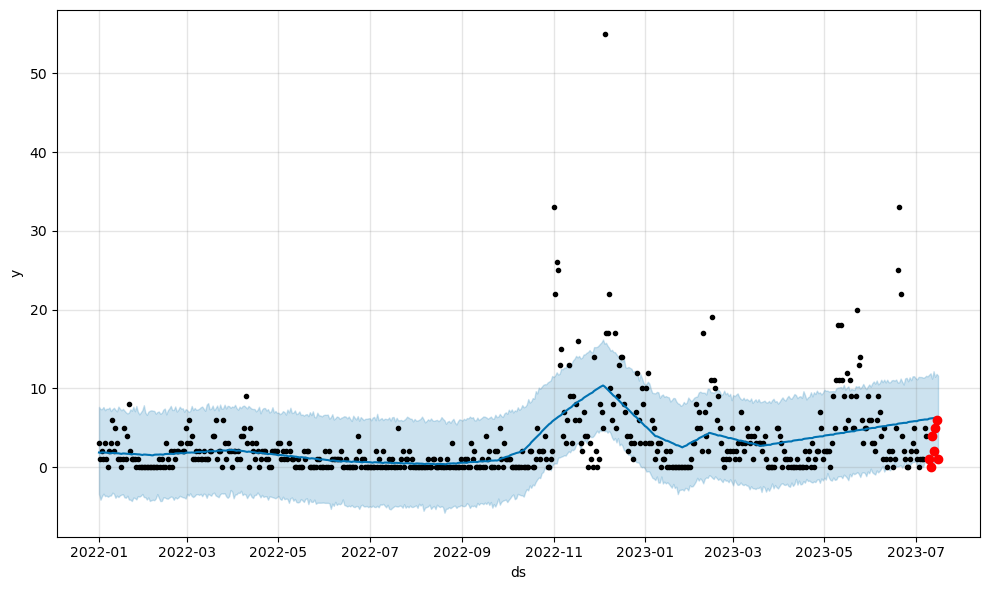

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  6.195061    0.459336   11.228925
558 2023-07-13  6.218926    0.480695   12.172398
559 2023-07-14  6.254117    0.961452   11.461454
560 2023-07-15  6.255648    0.828868   11.837842
561 2023-07-16  6.262025    0.776984   11.606789
[1 0 4 2 5 6 1]
---
[6.14069269 6.17711734 6.19506067 6.21892593 6.25411669 6.25564752
 6.26202502]
SMAPE: 0.9444086782788635


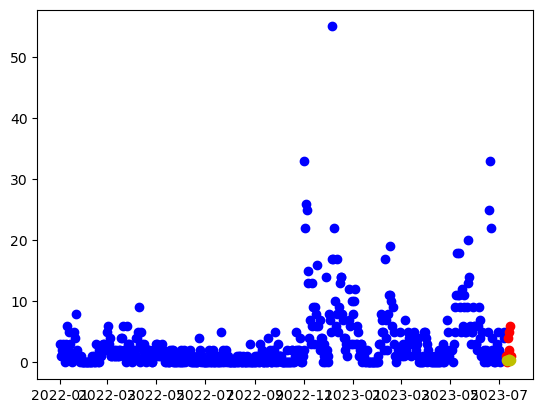

17:03:40 - cmdstanpy - INFO - Chain [1] start processing


[1 0 4 2 5 6 1]
---
[0.44564745 0.31898628 0.3865727  0.52251656 0.49491138 0.22015614
 0.42262111]
SMAPE_lr: 1.4136747883577723


17:03:40 - cmdstanpy - INFO - Chain [1] done processing


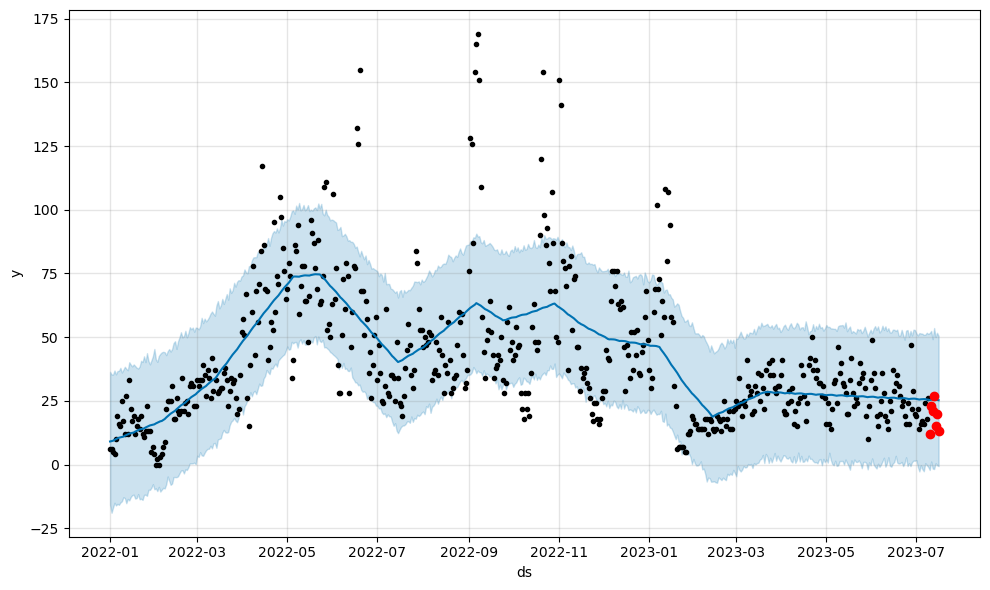

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  25.466970   -1.593756   49.216369
558 2023-07-13  25.502893   -1.749918   53.590931
559 2023-07-14  25.489530    0.519130   50.057361
560 2023-07-15  25.367557   -0.272106   51.720364
561 2023-07-16  25.264189   -0.613826   50.480389
[12 23 21 27 15 20 13]
---
[25.32997587 25.43194704 25.46697005 25.50289283 25.48952985 25.36755702
 25.2641893 ]
SMAPE: 0.351382724258257


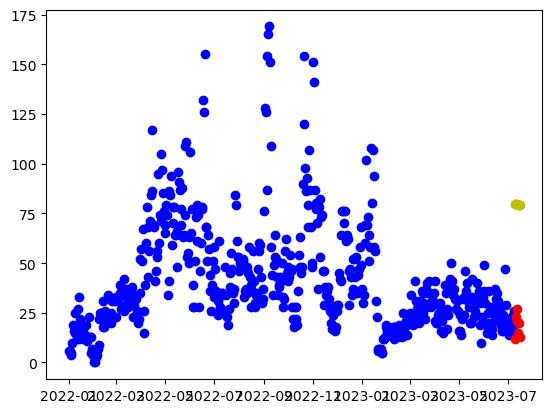

17:03:41 - cmdstanpy - INFO - Chain [1] start processing


[12 23 21 27 15 20 13]
---
[79.84667048 79.59736613 79.54230937 79.55561005 79.4053617  79.00796327
 79.08778506]
SMAPE_lr: 1.2462006763576228


17:03:41 - cmdstanpy - INFO - Chain [1] done processing


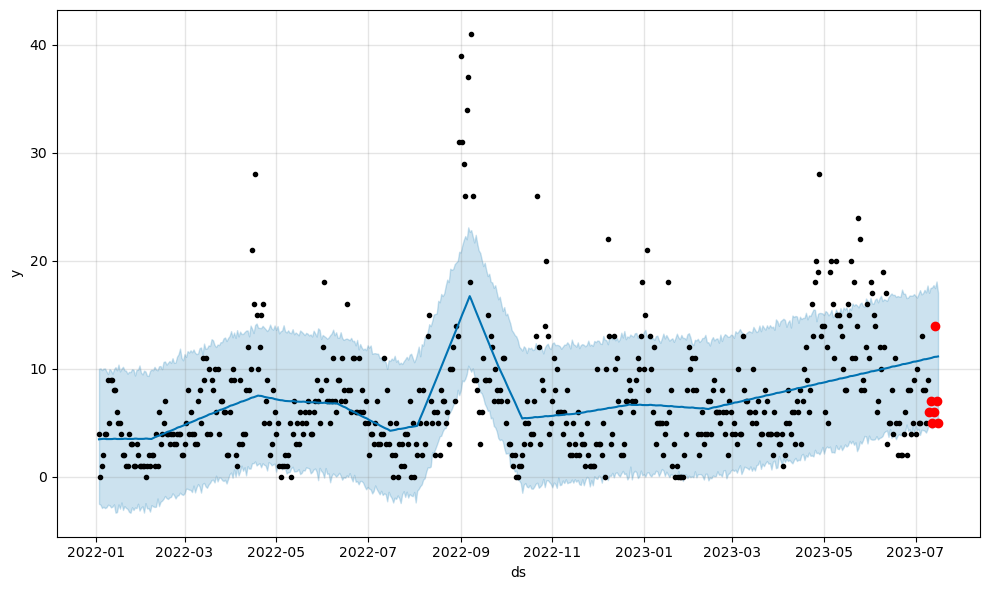

            ds       yhat  yhat_lower  yhat_upper
555 2023-07-12  11.020844    4.496431   17.523991
556 2023-07-13  11.076120    4.604201   17.747639
557 2023-07-14  11.105059    4.722970   17.468227
558 2023-07-15  11.112552    4.764473   18.084554
559 2023-07-16  11.141945    4.725137   17.043217
[ 6  7  5  6 14  7  5]
---
[10.93924427 10.98446233 11.02084384 11.07611963 11.10505934 11.11255173
 11.1419449 ]
SMAPE: 0.5454508197555658


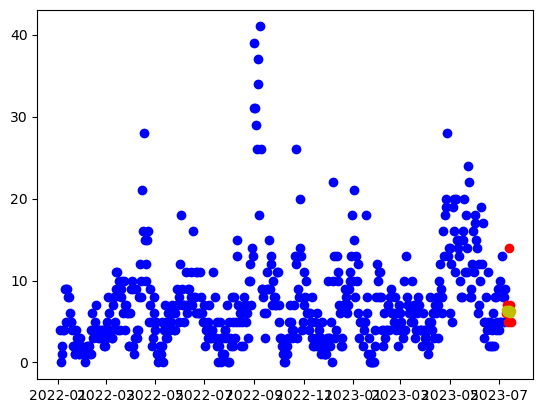

17:03:42 - cmdstanpy - INFO - Chain [1] start processing


[ 6  7  5  6 14  7  5]
---
[6.34716881 6.21554412 6.27816703 6.40914738 6.37657868 6.09685992
 6.29436137]
SMAPE_lr: 0.22613314454559272


17:03:42 - cmdstanpy - INFO - Chain [1] done processing


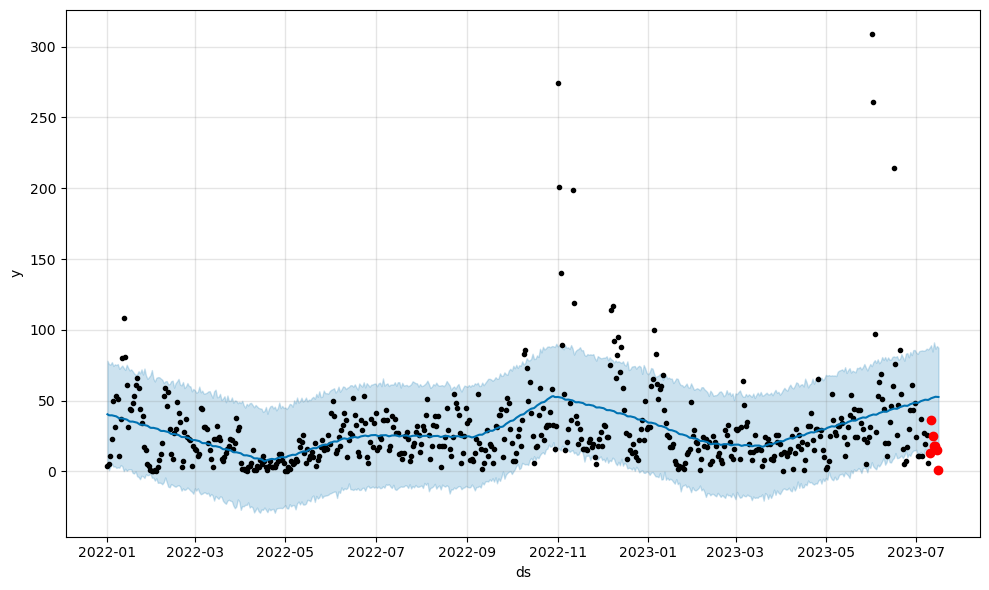

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  52.011580   14.632482   84.664397
558 2023-07-13  52.411134   15.016271   91.129880
559 2023-07-14  52.701680   18.210543   86.637332
560 2023-07-15  52.604116   17.238383   88.530477
561 2023-07-16  52.541601   16.796184   87.303185
[13 36 25 18 18 15  1]
---
[50.97718546 51.63080515 52.01158009 52.41113375 52.70167962 52.60411603
 52.54160054]
SMAPE: 1.0346127696706815


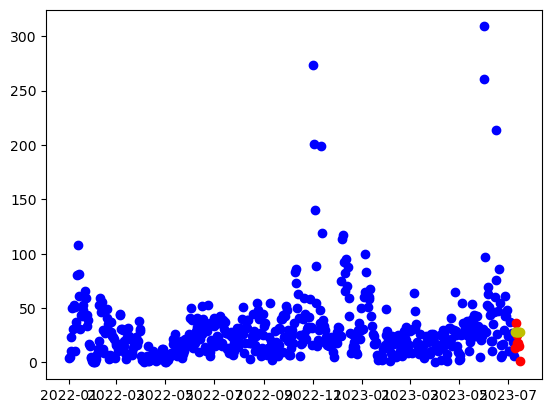

17:03:43 - cmdstanpy - INFO - Chain [1] start processing


[13 36 25 18 18 15  1]
---
[27.93974707 27.81646774 27.887436   28.02676171 28.00253837 27.73116497
 27.93701178]
SMAPE_lr: 0.6319580439200723


17:03:43 - cmdstanpy - INFO - Chain [1] done processing


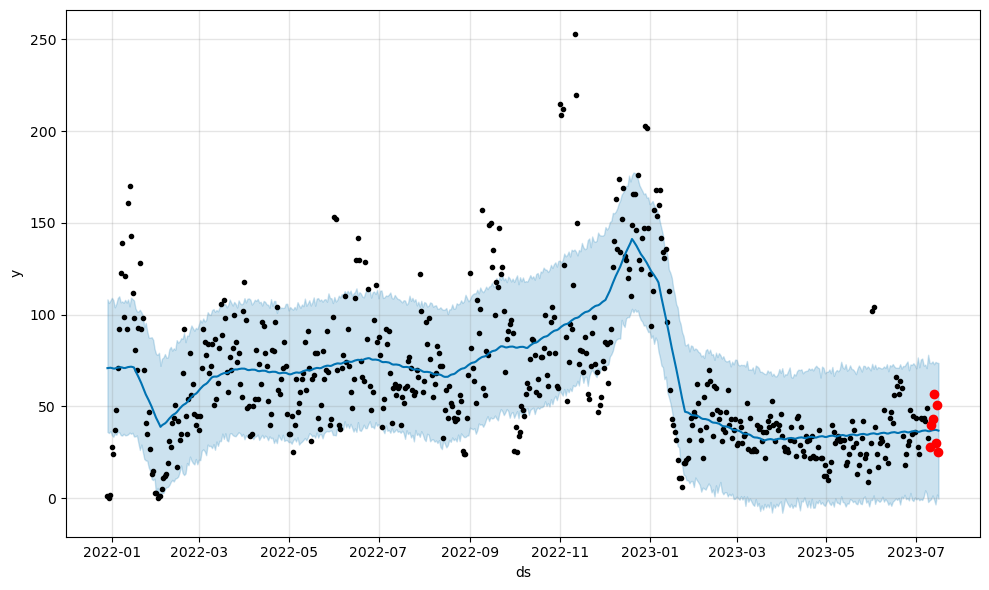

            ds       yhat  yhat_lower  yhat_upper
560 2023-07-12  37.061631    1.516099   74.579126
561 2023-07-13  37.196854   -0.658489   72.998584
562 2023-07-14  37.272005   -3.354313   74.301474
563 2023-07-15  37.117959    2.015002   73.845180
564 2023-07-16  36.849475   -0.270243   73.695750
[28 40 43 57 30 51 25]
---
[36.52942855 36.81181169 37.06163094 37.19685424 37.27200506 37.11795928
 36.84947475]
SMAPE: 0.26151796270877675


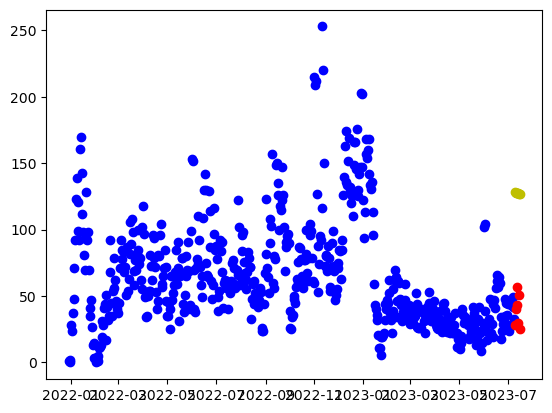

17:03:44 - cmdstanpy - INFO - Chain [1] start processing


[28 40 43 57 30 51 25]
---
[128.17754443 127.85857622 127.7338556  127.67749242 127.45758021
 126.99051792 127.00067585]
SMAPE_lr: 1.0745076057913805


17:03:44 - cmdstanpy - INFO - Chain [1] done processing


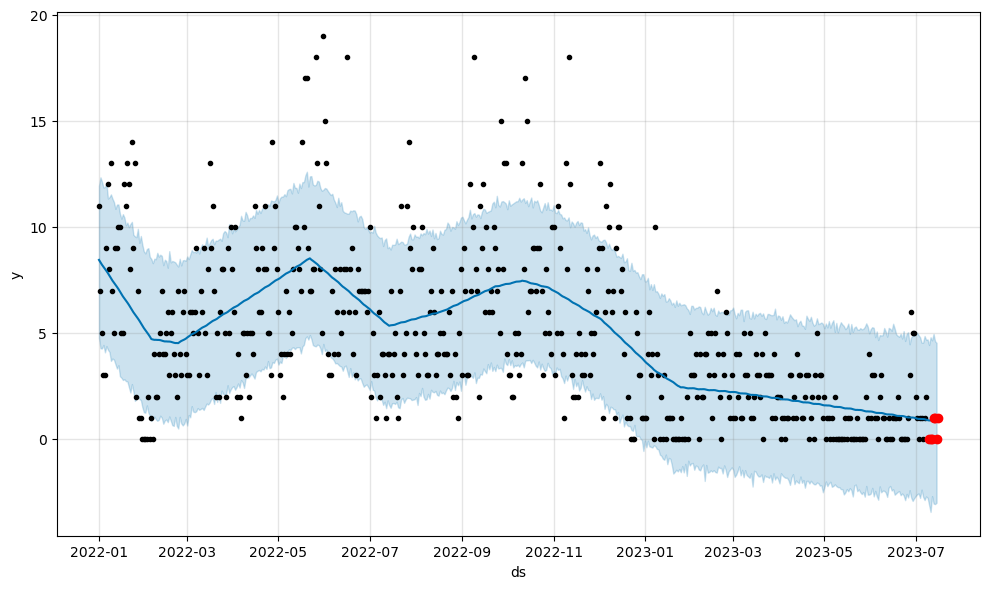

            ds      yhat  yhat_lower  yhat_upper
556 2023-07-11  0.874881   -3.439769    4.795380
557 2023-07-12  0.869451   -2.695102    4.650233
558 2023-07-13  0.869406   -3.045955    4.950618
559 2023-07-14  0.860399   -3.071377    4.612697
560 2023-07-15  0.838265   -3.005749    4.532984
[0 0 0 1 1 0 1]
---
[0.88845085 0.87335443 0.87488084 0.86945051 0.86940594 0.86039926
 0.83826466]
SMAPE: 1.2079069404029574


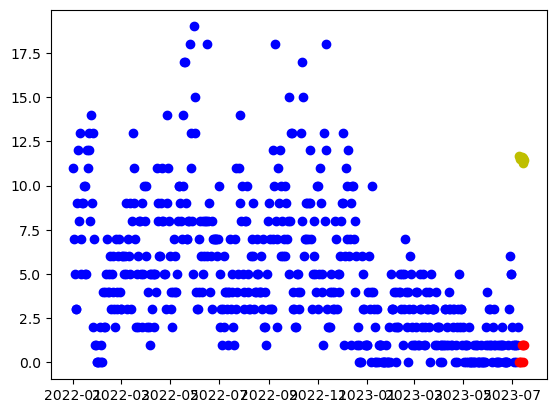

[0 0 0 1 1 0 1]
---
[11.65999903 11.50333814 11.54092484 11.64686899 11.58926409 11.28450913
 11.45697438]
SMAPE_lr: 1.8635542686314641


17:03:45 - cmdstanpy - INFO - Chain [1] start processing
17:03:45 - cmdstanpy - INFO - Chain [1] done processing


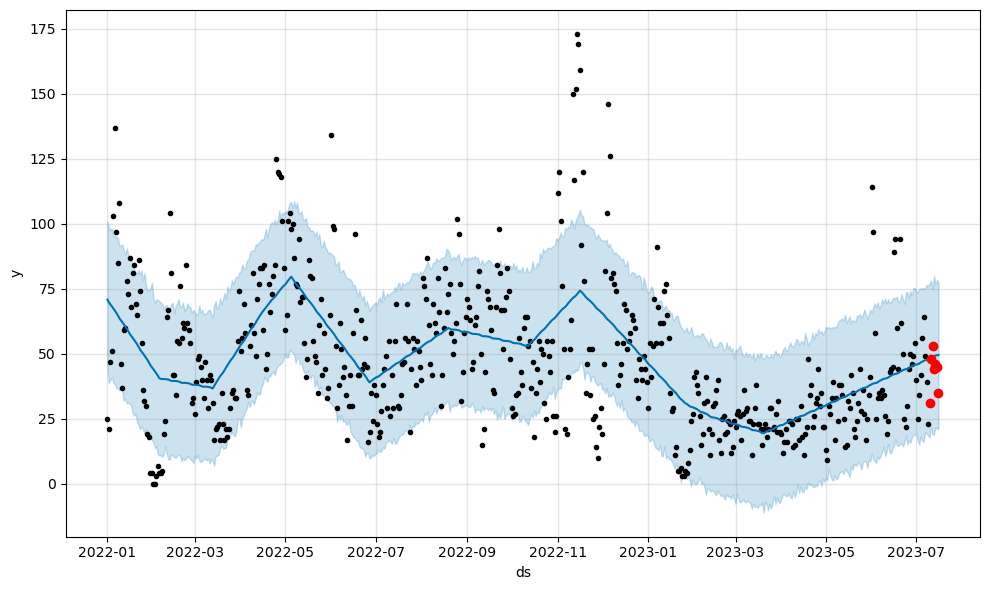

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  48.752535   18.969379   74.891229
558 2023-07-13  49.039809   19.056989   79.953630
559 2023-07-14  49.320551   21.838018   76.360016
560 2023-07-15  49.448158   21.234879   78.441475
561 2023-07-16  49.536046   21.054586   77.289109
[31 48 53 44 46 45 35]
---
[48.02964313 48.44056435 48.75253513 49.03980943 49.32055137 49.4481576
 49.53604644]
SMAPE: 0.16281333598383477


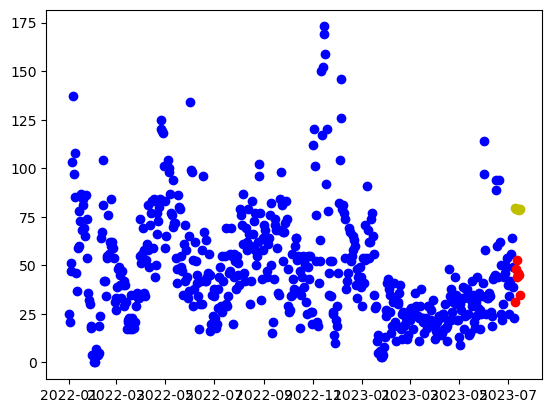

17:03:46 - cmdstanpy - INFO - Chain [1] start processing


[31 48 53 44 46 45 35]
---
[79.46694996 79.23197031 79.19123824 79.21886363 79.08293997 78.69986624
 78.79401273]
SMAPE_lr: 0.5971279503192409


17:03:46 - cmdstanpy - INFO - Chain [1] done processing


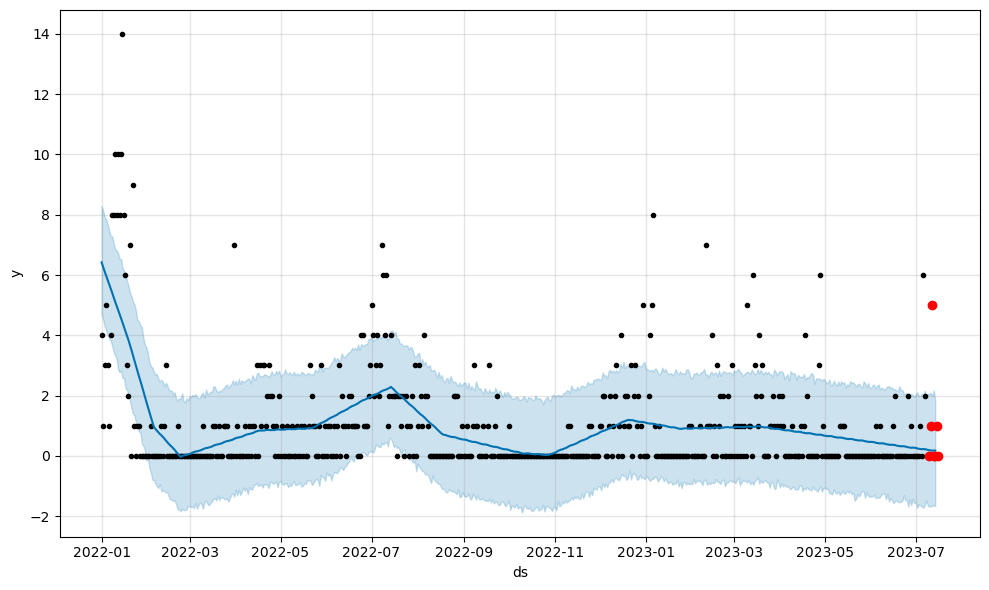

            ds      yhat  yhat_lower  yhat_upper
555 2023-07-10  0.186752   -1.684639    2.050925
556 2023-07-11  0.179854   -1.675366    2.092310
557 2023-07-12  0.170008   -1.659988    1.992505
558 2023-07-13  0.176226   -1.643495    2.174799
559 2023-07-14  0.170971   -1.668451    1.862694
[0 1 5 0 0 1 0]
---
[0.21301113 0.19496165 0.18675234 0.17985396 0.17000788 0.17622613
 0.17097104]
SMAPE: 1.8005816922701177


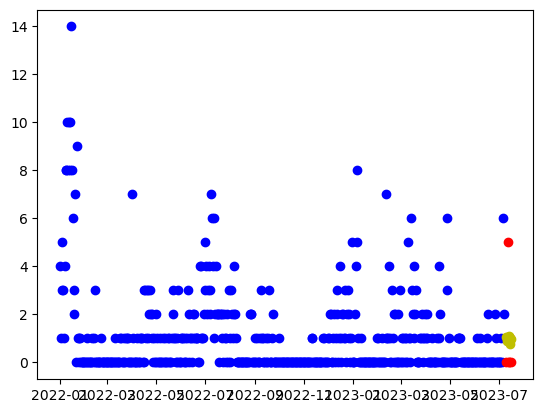

17:03:47 - cmdstanpy - INFO - Chain [1] start processing


[0 1 5 0 0 1 0]
---
[1.04777714 0.91091759 0.96830563 1.09405111 1.05624755 0.77129392
 0.96356051]
SMAPE_lr: 1.3860723165942732


17:03:47 - cmdstanpy - INFO - Chain [1] done processing


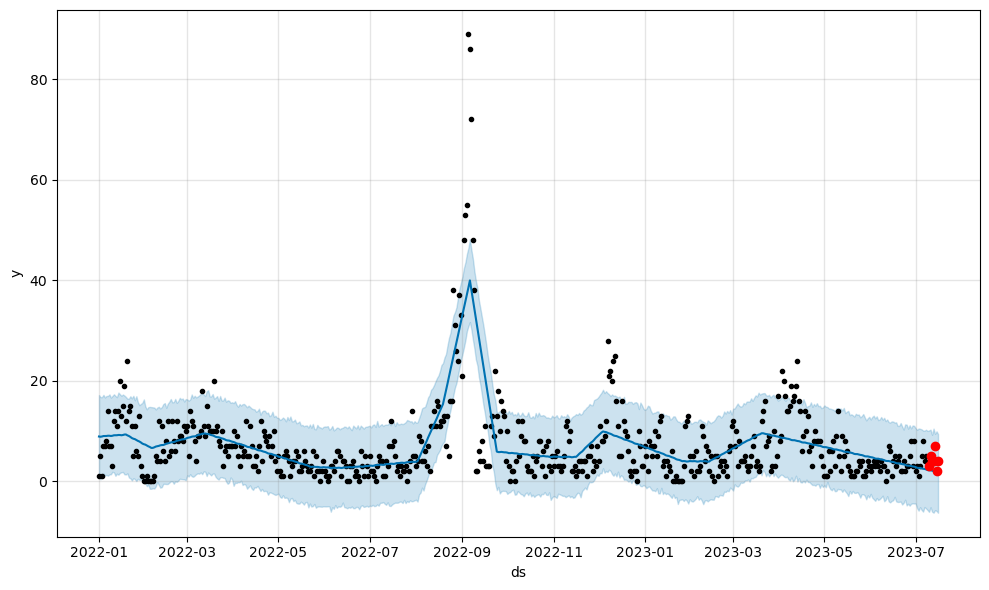

            ds      yhat  yhat_lower  yhat_upper
557 2023-07-12  2.125216   -6.031167    9.250290
558 2023-07-13  2.040190   -6.242779   10.488893
559 2023-07-14  2.001615   -5.747025    9.434175
560 2023-07-15  1.909705   -5.891663    9.948767
561 2023-07-16  1.773417   -6.257455    9.409148
[3 5 4 4 7 2 4]
---
[2.19621199 2.20045261 2.12521551 2.04019014 2.0016152  1.90970539
 1.77341674]
SMAPE: 0.6108741999873268


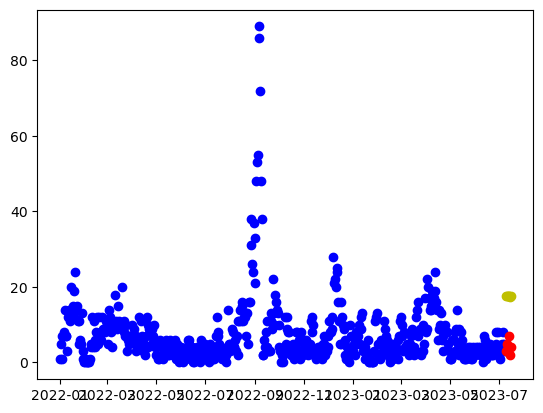

17:03:48 - cmdstanpy - INFO - Chain [1] start processing


[3 5 4 4 7 2 4]
---
[17.72956747 17.56762735 17.59993481 17.70059973 17.6377156  17.3276814
 17.49486742]
SMAPE_lr: 1.2517278404492829


17:03:48 - cmdstanpy - INFO - Chain [1] done processing


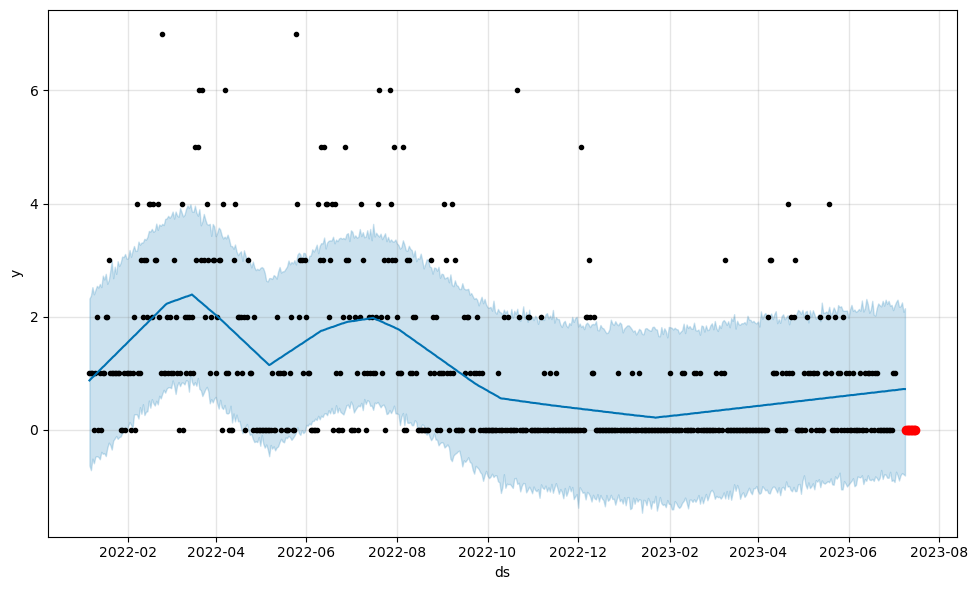

            ds      yhat  yhat_lower  yhat_upper
545 2023-07-05  0.712390   -0.896195    2.177571
546 2023-07-06  0.713997   -0.805671    2.184370
547 2023-07-07  0.718365   -0.764569    2.253158
548 2023-07-08  0.721526   -0.784733    2.088433
549 2023-07-09  0.720463   -0.808196    2.150931
[0 0 0 0 0 0 0]
---
[0.70378447 0.70621403 0.71238999 0.71399721 0.7183649  0.72152614
 0.72046345]
SMAPE: 2.0


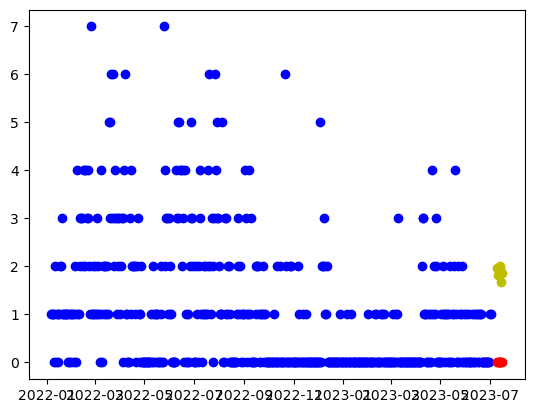

[0 0 0 0 0 0 0]
---
[1.96509745 1.82563487 1.88041987 2.00356233 1.96315574 1.67559908
 1.86526264]
SMAPE_lr: 2.0


17:03:49 - cmdstanpy - INFO - Chain [1] start processing
17:03:49 - cmdstanpy - INFO - Chain [1] done processing


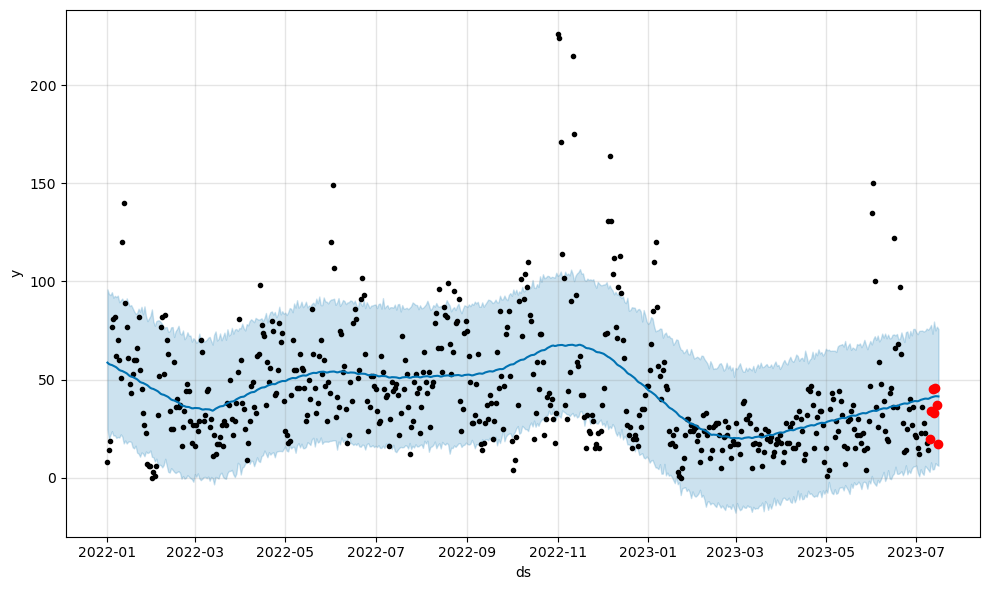

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  41.163603    4.281015   73.382690
558 2023-07-13  41.375709    4.477565   79.580151
559 2023-07-14  41.567480    7.534353   75.052362
560 2023-07-15  41.539739    6.643772   76.988888
561 2023-07-16  41.453742    6.183135   75.753586
[20 34 45 33 46 37 17]
---
[40.49078579 40.91914018 41.16360325 41.37570935 41.56748021 41.5397391
 41.45374216]
SMAPE: 0.31857106642818017


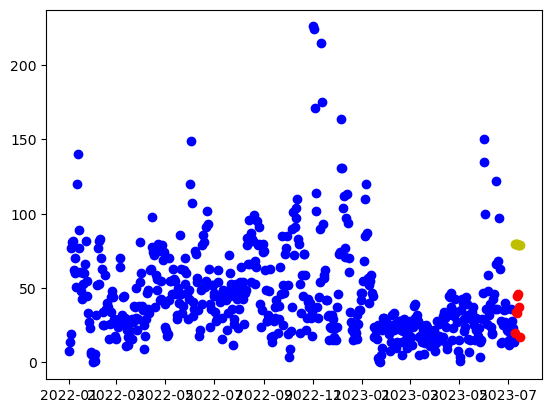

17:03:50 - cmdstanpy - INFO - Chain [1] start processing


[20 34 45 33 46 37 17]
---
[79.74472341 79.50560162 79.46072742 79.48421067 79.34414487 78.95692901
 79.04693337]
SMAPE_lr: 0.8468221115502105


17:03:50 - cmdstanpy - INFO - Chain [1] done processing


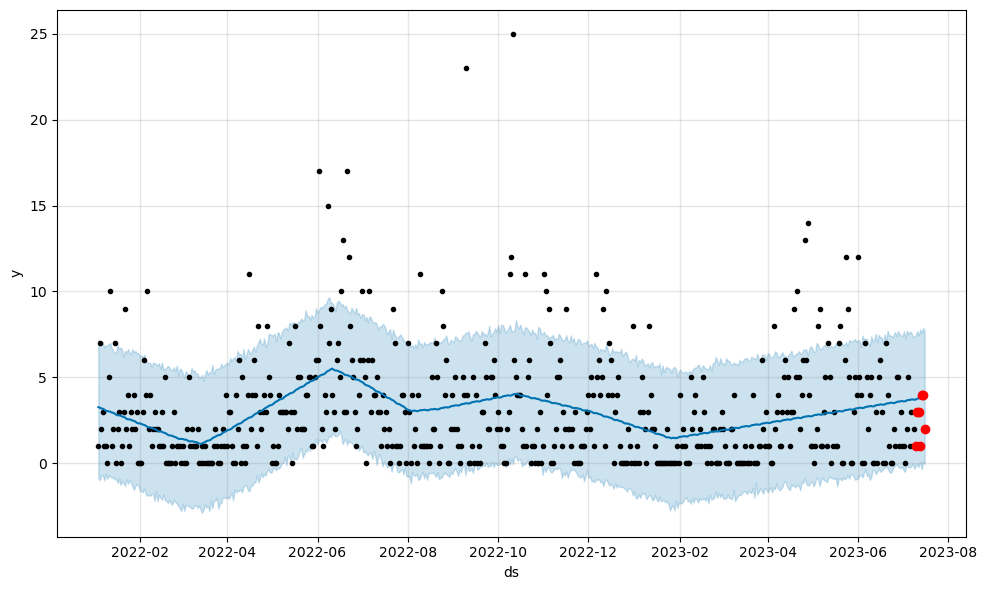

            ds      yhat  yhat_lower  yhat_upper
554 2023-07-12  3.778825   -0.223291    7.438846
555 2023-07-13  3.779882    0.070346    7.793531
556 2023-07-14  3.810459   -0.369866    7.594204
557 2023-07-15  3.809423    0.097434    7.873604
558 2023-07-16  3.791434   -0.046416    7.700386
[1 3 3 1 4 4 2]
---
[3.70862649 3.75497676 3.77882467 3.77988179 3.81045914 3.80942293
 3.79143373]
SMAPE: 0.4975656854175589


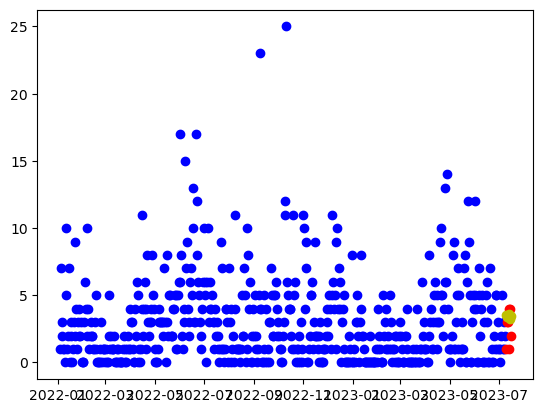

17:03:51 - cmdstanpy - INFO - Chain [1] start processing


[1 3 3 1 4 4 2]
---
[3.52633249 3.3885524  3.44501991 3.56984486 3.53112077 3.24524661
 3.43659267]
SMAPE_lr: 0.4802955561053323


17:03:51 - cmdstanpy - INFO - Chain [1] done processing


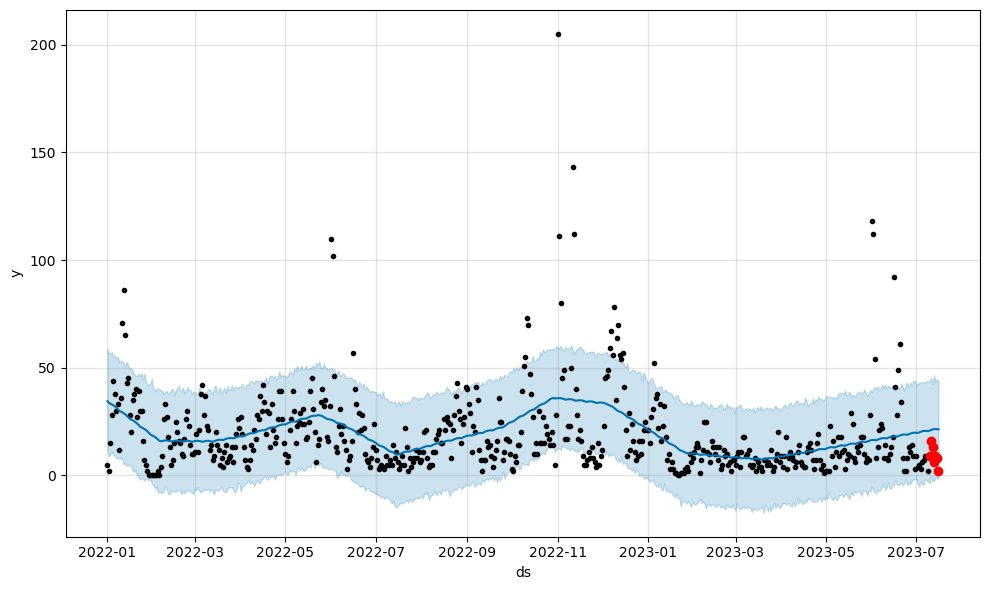

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  21.310595   -2.745492   42.324987
558 2023-07-13  21.503546   -2.562687   46.421791
559 2023-07-14  21.524003   -0.684477   43.363989
560 2023-07-15  21.494983   -1.265361   44.634362
561 2023-07-16  21.389923   -1.614774   43.806288
[ 9 16 13  6  9  8  2]
---
[20.79391063 21.10205024 21.31059495 21.50354605 21.52400269 21.49498255
 21.38992314]
SMAPE: 0.8674554453053378


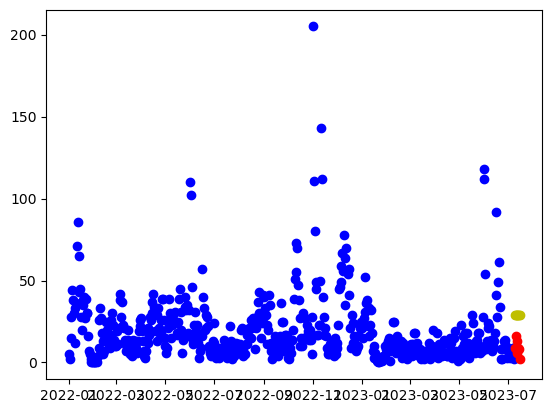

17:03:52 - cmdstanpy - INFO - Chain [1] start processing


[ 9 16 13  6  9  8  2]
---
[29.15134263 28.98662368 29.01615232 29.1140384  29.04837544 28.73556242
 28.89996961]
SMAPE_lr: 1.090926232882844


17:03:52 - cmdstanpy - INFO - Chain [1] done processing


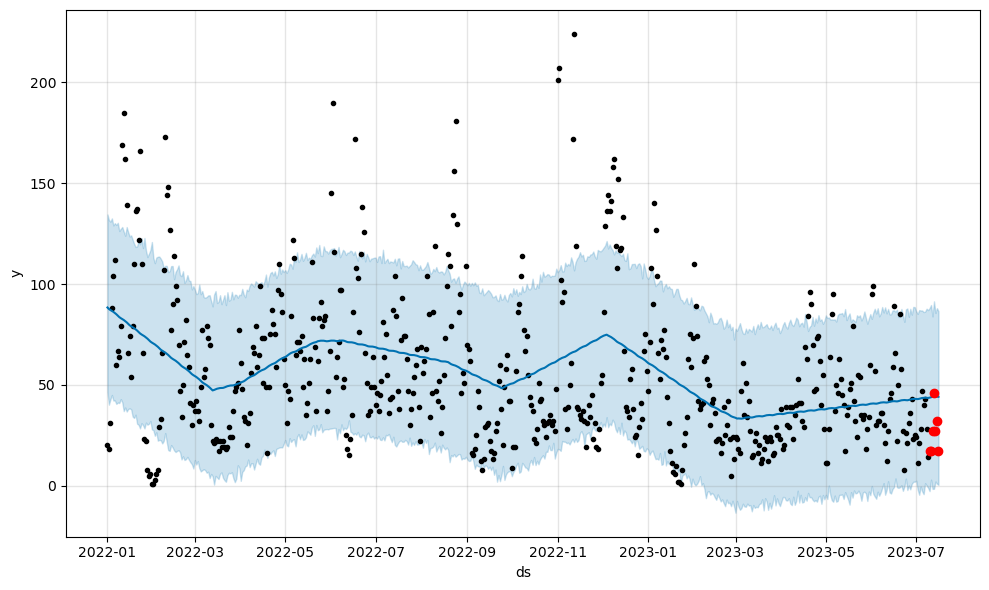

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  44.053479   -1.597733   83.932469
558 2023-07-13  44.131425   -1.539040   91.418752
559 2023-07-14  44.192408    2.068650   85.638128
560 2023-07-15  44.152283    0.960001   88.029262
561 2023-07-16  44.070645    0.414654   86.525079
[17 17 27 46 27 32 17]
---
[43.6411886  43.86063047 44.05347923 44.13142482 44.19240796 44.1522827
 44.07064507]
SMAPE: 0.5673573867203155


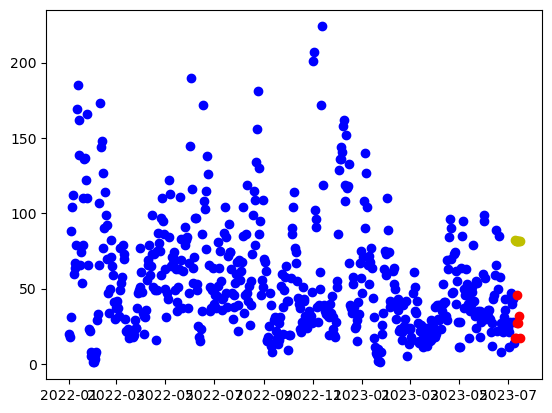

17:03:53 - cmdstanpy - INFO - Chain [1] start processing
17:03:53 - cmdstanpy - INFO - Chain [1] done processing


[17 17 27 46 27 32 17]
---
[82.02792599 81.80517843 81.77667846 81.81653594 81.69284437 81.32200273
 81.42838131]
SMAPE_lr: 1.0540958204368749


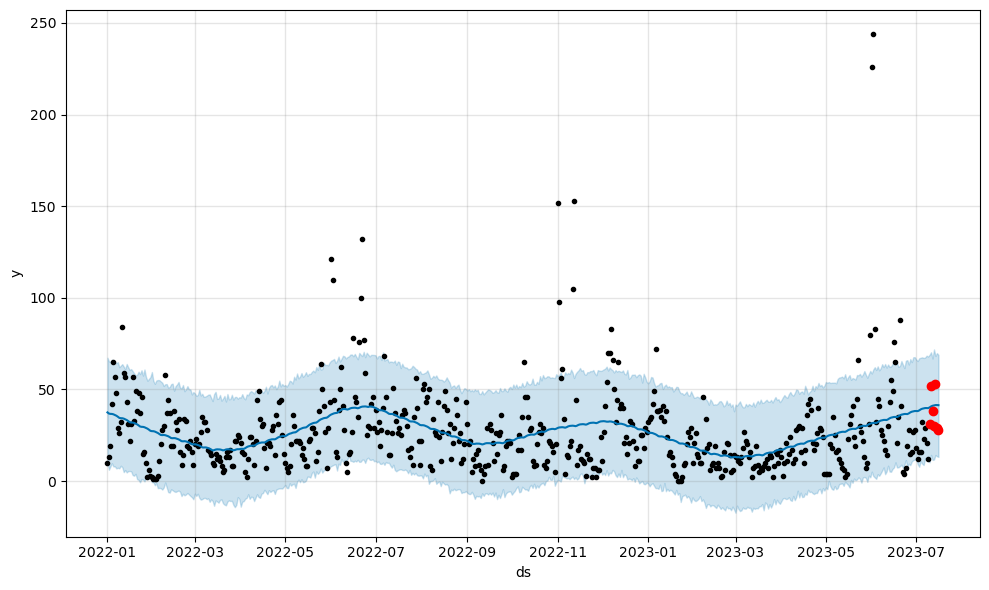

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  41.107818   11.585965   66.896873
558 2023-07-13  41.289979   11.755675   71.869879
559 2023-07-14  41.479359   14.237944   68.281593
560 2023-07-15  41.495525   13.563820   69.870012
561 2023-07-16  41.436085   13.204508   68.890637
[31 52 38 30 53 29 28]
---
[40.2018359  40.74488957 41.10781751 41.28997871 41.47935918 41.49552478
 41.43608533]
SMAPE: 0.26883948133096863


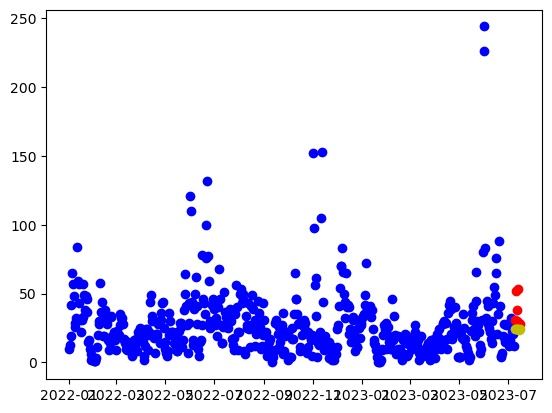

17:03:53 - cmdstanpy - INFO - Chain [1] start processing


[31 52 38 30 53 29 28]
---
[24.1593483  24.02627787 24.08745504 24.21698964 24.18297521 23.9018107
 24.09786642]
SMAPE_lr: 0.3906682698504404


17:03:54 - cmdstanpy - INFO - Chain [1] done processing


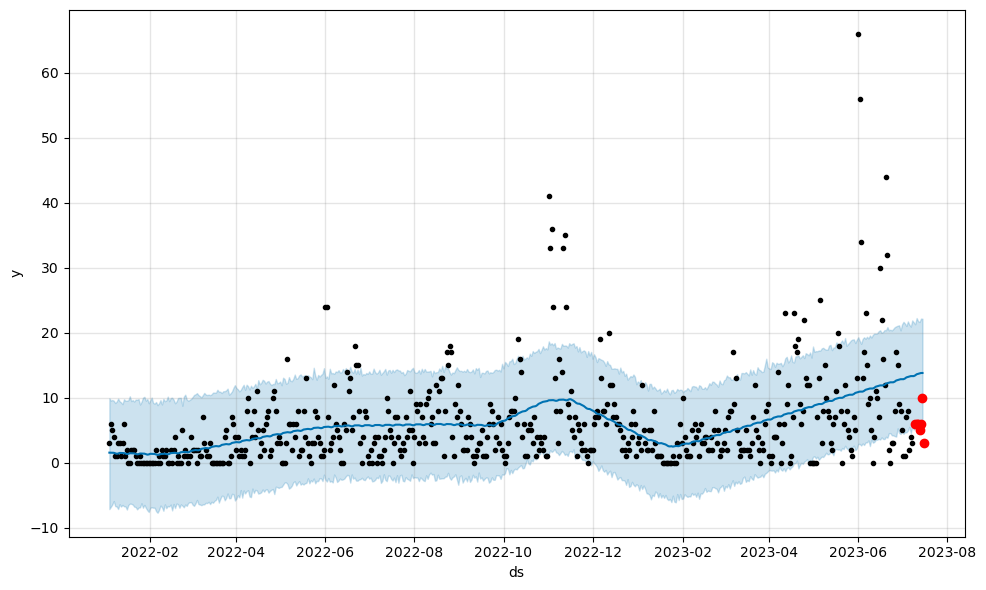

            ds       yhat  yhat_lower  yhat_upper
553 2023-07-11  13.596670    5.745435   22.255726
554 2023-07-12  13.665774    4.996810   21.773545
555 2023-07-13  13.735954    5.885455   21.649149
556 2023-07-14  13.795385    5.950602   22.177097
557 2023-07-15  13.797487    5.654604   22.148912
[ 6  6  6  5  6 10  3]
---
[13.31991888 13.42489051 13.59666971 13.66577369 13.73595426 13.79538549
 13.79748666]
SMAPE: 0.8020867653928452


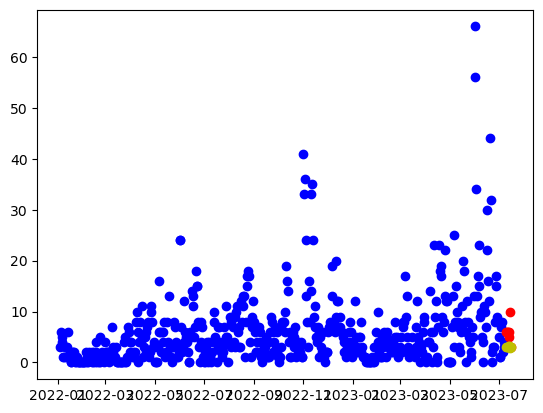

17:03:54 - cmdstanpy - INFO - Chain [1] start processing


[ 6  6  6  5  6 10  3]
---
[3.08842659 2.96334979 3.03252058 3.17004882 3.14402802 2.87085715
 3.07490649]
SMAPE_lr: 0.5972062683236448


17:03:55 - cmdstanpy - INFO - Chain [1] done processing


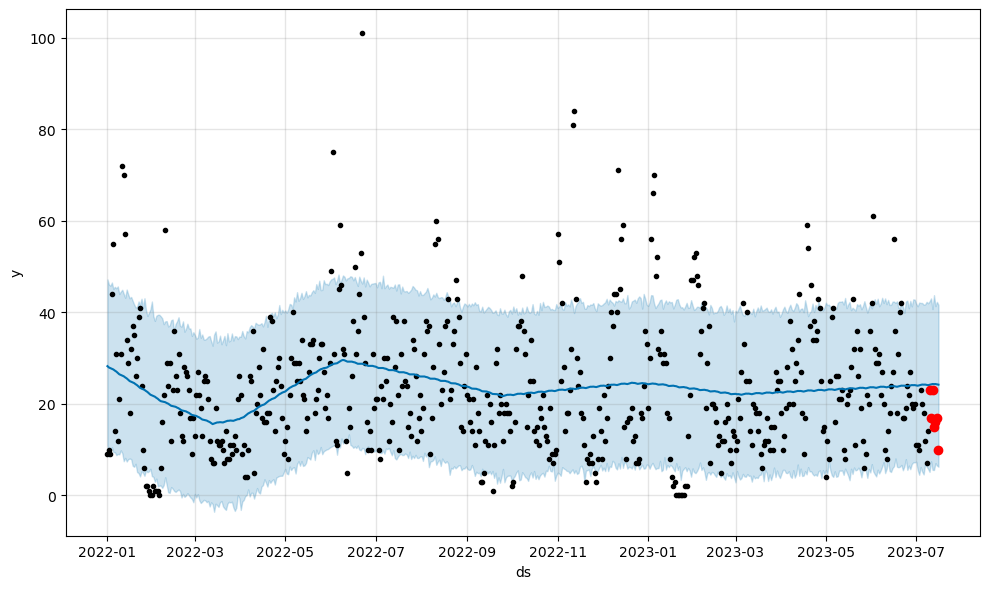

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  24.337607    5.597728   40.707982
558 2023-07-13  24.319802    5.572020   43.750962
559 2023-07-14  24.334534    7.058045   41.348054
560 2023-07-15  24.265931    6.535446   42.277485
561 2023-07-16  24.203233    6.282395   41.630830
[23 17 23 15 16 17 10]
---
[24.1755267  24.26346359 24.33760733 24.31980197 24.33453446 24.26593059
 24.20323262]
SMAPE: 0.3611994269125896


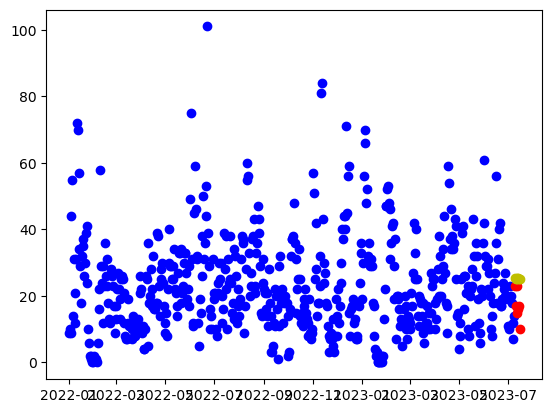

17:03:55 - cmdstanpy - INFO - Chain [1] start processing


[23 17 23 15 16 17 10]
---
[25.26864099 25.12798884 25.18158428 25.30353716 25.26194101 24.97319478
 25.16166878]
SMAPE_lr: 0.39613933310084887


17:03:56 - cmdstanpy - INFO - Chain [1] done processing


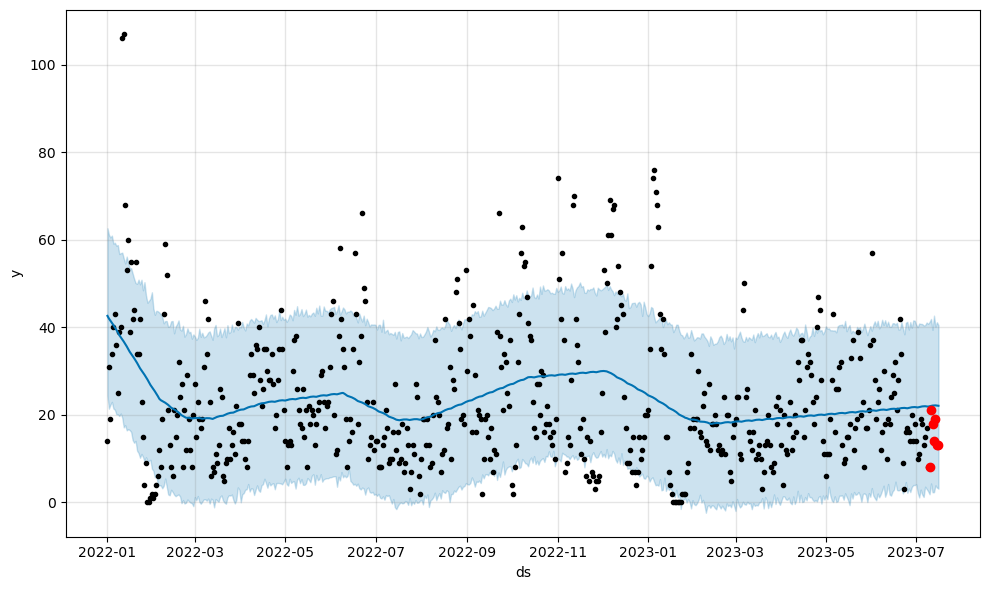

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  22.116031    2.312631   39.415453
558 2023-07-13  22.147968    2.336216   42.661112
559 2023-07-14  22.161961    3.888546   40.141028
560 2023-07-15  22.118645    3.381924   41.152387
561 2023-07-16  22.072397    3.134520   40.489041
[ 8 21 18 14 19 13 13]
---
[21.96515453 22.06487045 22.11603108 22.1479681  22.16196131 22.11864523
 22.07239696]
SMAPE: 0.4039797393874701


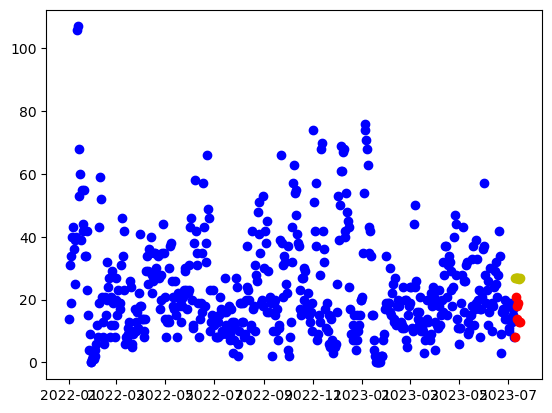

17:03:56 - cmdstanpy - INFO - Chain [1] start processing


[ 8 21 18 14 19 13 13]
---
[27.02847727 26.88034949 26.92646931 27.04094657 26.99187479 26.69565295
 26.87665132]
SMAPE_lr: 0.5855029463319631


17:03:57 - cmdstanpy - INFO - Chain [1] done processing


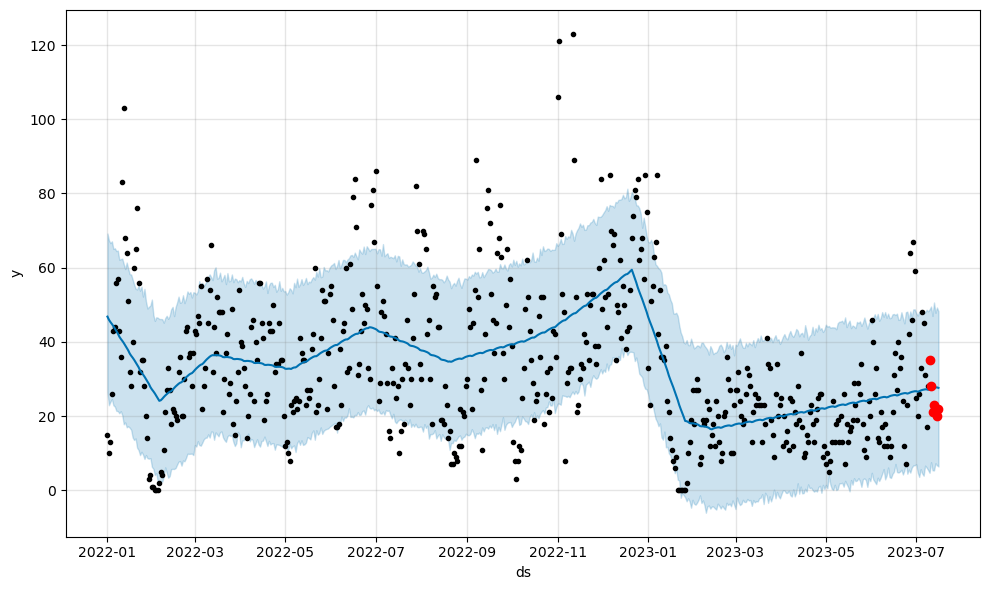

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  27.556682    5.402509   46.999925
558 2023-07-13  27.632791    5.362028   50.628007
559 2023-07-14  27.732654    7.289798   47.845935
560 2023-07-15  27.737808    6.756432   49.281112
561 2023-07-16  27.615398    6.429491   48.259487
[35 28 21 23 21 20 22]
---
[27.21146079 27.40900808 27.55668153 27.63279086 27.73265409 27.73780812
 27.61539771]
SMAPE: 0.22166087590845415


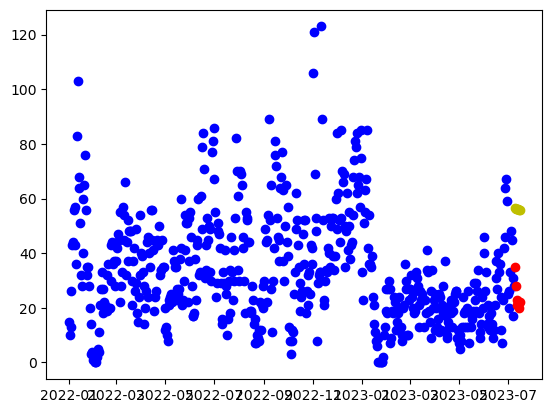

17:03:57 - cmdstanpy - INFO - Chain [1] start processing


[35 28 21 23 21 20 22]
---
[56.39983554 56.19492402 56.1842601  56.24195361 56.13609809 55.78309249
 55.90730712]
SMAPE_lr: 0.802077139473019


17:03:58 - cmdstanpy - INFO - Chain [1] done processing


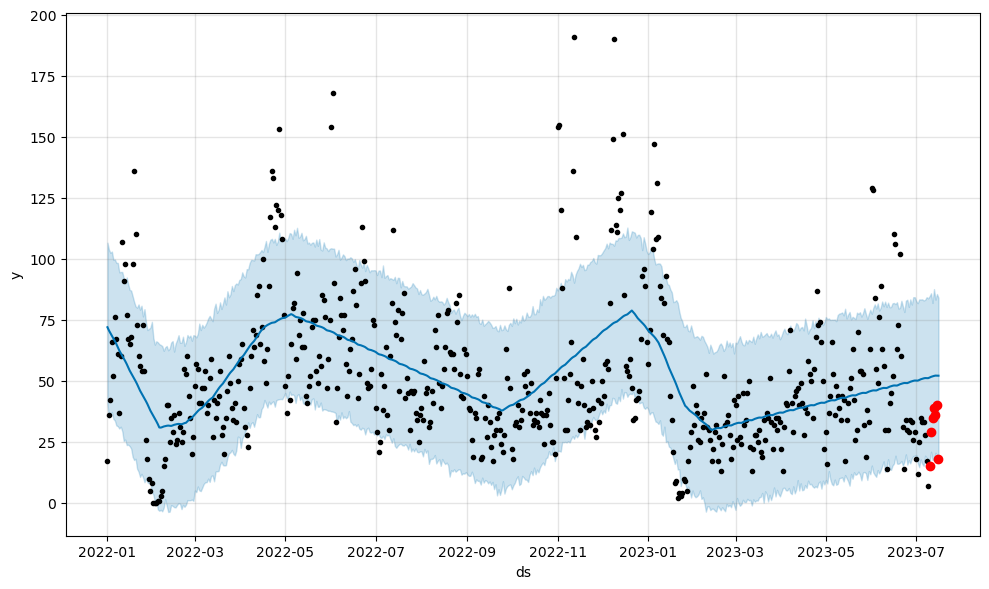

            ds       yhat  yhat_lower  yhat_upper
557 2023-07-12  51.861980   17.601016   81.930548
558 2023-07-13  52.046170   17.687446   87.607790
559 2023-07-14  52.175306   20.560857   83.280073
560 2023-07-15  52.144048   19.706087   85.590369
561 2023-07-16  52.133682   19.370120   84.059334
[15 29 35 39 36 40 18]
---
[51.36623215 51.66237966 51.86198003 52.04616985 52.17530636 52.14404846
 52.13368158]
SMAPE: 0.5623616085601713


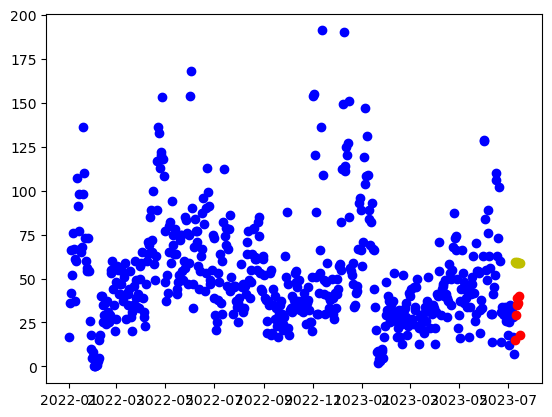

[15 29 35 39 36 40 18]
---
[59.21150389 59.04542703 59.07359776 59.17012594 59.10310508 58.78893415
 58.95198343]
SMAPE_lr: 0.6753306467049417


In [60]:
# use prophet to predict the data in ndf_gp_list
from prophet import Prophet

acc_cold_list = []
acc_cold_lr_list = []

for idx, group in enumerate(df_cold_gp_list):
    # continue when the number of rows in group is less than 10
    if len(group) < 10:
        continue
        
    m = Prophet(seasonality_prior_scale=0.001,changepoint_prior_scale=0.9)
    m.fit(group)
    future = m.make_future_dataframe(periods=7)
    forecast = m.predict(future)
    
    # plot in a small window
    m.plot(forecast)
    
    # plot the true data in Next 7 Days
    # find the key: start_city_id
    start_city_id = group['start_city_id'].values[0]
    df_new = df_gp_dict[start_city_id]
    df_new = df_new[df_new['ds'] >= cold_season_valid]
    df_new = df_new[df_new['ds'] < (cold_season_valid + pd.Timedelta(days=7))]
    
    # plot the df_new in the same window
    plt.plot(df_new['ds'], df_new['y'], 'ro')
    
    plt.savefig('./figs/cold_season/{}.png'.format(start_city_id))
    plt.show()
    print(forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail())
    
    
    # calculate the accuracy of the prediction in these 7 days by 1 - MAPE
    # MAPE = mean(abs(y-yhat)/y)
    y = df_new['y'].values
    print(y)
    print('---')
    yhat = forecast['yhat'].values[-7:]
    print(yhat)
    SMAPE = np.mean(np.abs(y-yhat)/ ((np.abs(y)+np.abs(yhat)) / 2.0))
    
    accuracy = SMAPE
    print('SMAPE: {}'.format(accuracy))
    acc_cold_list.append(accuracy)
    
    
    # test noisy linear regression
    # the values of x and y in 1 month
    min_date = min(group['ds'])
    
    history_len = 360
    x = np.array([(pd.to_datetime(t) - min_date).days for t in group['ds']][-history_len:])
    y = np.array(group['y'].values[-history_len:])
    
    # model by LR
    model = LinearRegression()
    model.fit(x.reshape(-1, 1), y)

    # get w and b
    slope = model.coef_[0]
    intercept = model.intercept_

    # predict 
    future_x = np.arange(y[-1], y[-1]+7)
    future_prediction = model.predict(future_x.reshape(-1, 1))

    # add random noise
    np.random.seed(0)
    random_noise = np.random.normal(0, 1, size=len(future_x))
    future_prediction_with_noise = future_prediction + 0.1 * random_noise
    
    
    plt.plot(group['ds'], group['y'], 'bo')
    plt.plot(df_new['ds'], df_new['y'], 'ro')
    plt.plot(df_new['ds'], future_prediction_with_noise, 'yo')
    
    plt.savefig('./figs/lr/cold_season/{}.png'.format(start_city_id))
    plt.show()
    
    future_prediction_with_noise = np.clip(future_prediction_with_noise, 0, None)
    
    y = df_new['y'].values
    print(y)
    print('---')
    yhat = future_prediction_with_noise
    print(future_prediction_with_noise)
    SMAPE_lr = np.mean(np.abs(y-future_prediction_with_noise)/ ((np.abs(y)+np.abs(future_prediction_with_noise)) / 2.0) )
    
    accuracy_lr = SMAPE_lr
    print('SMAPE_lr: {}'.format(accuracy_lr))
    acc_cold_lr_list.append(accuracy_lr)


In [61]:
# Print the accuracy of cold season
print(np.mean(acc_cold_list))
print(np.mean(acc_cold_lr_list))

0.6938795588443629
1.0019565400837505
